# Translational mapping

In this notebook we explicitely model the link between the regulatory and structural embeddings of the U2OS cells and evaluate their generalizability.

---


## 0. Enviromental setup

We first load the required packages and define a number of helper functions.

In [131]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import torch
from torch import nn
from torch.optim import Adam
import sys
from tqdm.notebook import tqdm
from yellowbrick.cluster.elbow import kelbow_visualizer
from yellowbrick.cluster import KElbowVisualizer
from torch.utils.data import DataLoader
import matplotlib as mpl
from sklearn.preprocessing import normalize

sys.path.append("../../..")

from src.utils.notebooks.translation.analysis import *
from src.data.datasets import IndexedTensorDataset
from src.utils.basic.io import get_genesets_from_gmt_file


seed = 1234

device = "cuda:0"

%load_ext nb_black

The nb_black extension is already loaded. To reload it, use:
  %reload_ext nb_black


<IPython.core.display.Javascript object>

In [132]:
from sklearn.preprocessing import normalize


def apply_norm(df):
    return pd.DataFrame(normalize(df), index=df.index, columns=df.columns)

<IPython.core.display.Javascript object>

In [133]:
def get_struct_nn_mean_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = np.array(list(img_embs.index))
    struct_nn.fit(np.array(img_embs))

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in struct_samples:
        struct_pred_input = np.array(img_embs.loc[target]).reshape(1, -1)
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[0]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn[1]]).reshape(1, -1)
        reg_nns = reg_samples[
            reg_nn.kneighbors(reg_pred_input, return_distance=False)[0]
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

In [134]:
def get_topk_acc_from_nn_dict(nn_dict, ks=list(range(50))):
    idc = []
    topk_dict = {}
    for target, nns in nn_dict.items():
        idc.append(target)
        for k in ks:
            if "top-{}".format(k) not in topk_dict:
                topk_dict["top-{}".format(k)] = []
            topk_dict["top-{}".format(k)].append(int(target in list(nns)[:k]))
    topk_result = pd.DataFrame(topk_dict, index=idc)
    return topk_result

<IPython.core.display.Javascript object>

In [135]:
def get_knn_hit_data(nn_dict):
    idc = []
    hits = []
    for k, v in nn_dict.items():
        idc.append(k)
        hits.append(np.where(v == k)[0])
    hit_results = pd.DataFrame(np.array(hits), columns=["knn_hit"], index=idc)
    return hit_results

<IPython.core.display.Javascript object>

In [136]:
def get_linear_comb_translation_dict(img_embs, node_embs, n_neighbors=5):
    nn_pred_dict = {}
    struct_samples = list(img_embs.index)
    struct_samples = np.array([cl_label.split("_")[0] for cl_label in struct_samples])
    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))
    struct_nn_dict = get_mean_knn_dict(img_embs, k=len(img_embs) - 1)

    for target in np.unique(struct_samples):
        struct_neighbors = struct_nn_dict[target][:n_neighbors]
        X = img_embs.loc[img_embs.index.isin(struct_neighbors)]
        x = img_embs.loc[struct_samples == target]
        alpha = np.matmul(np.array(x), np.linalg.pinv(np.array(X)))

        Y = node_embs.loc[X.index]
        y = np.matmul(alpha, np.array(Y))

        reg_nns = reg_samples[reg_nn.kneighbors(y, return_distance=False)][0]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

In [137]:
def get_struct_nn_centroid_translation_dict(img_embs, node_embs):
    nn_pred_dict = {}
    struct_nn = NearestNeighbors(n_neighbors=2)
    struct_samples = list(img_embs.index)
    struct_samples = np.array([cl_label.split("_")[0] for cl_label in struct_samples])

    reg_nn = NearestNeighbors(n_neighbors=len(node_embs))
    reg_samples = np.array(list(node_embs.index))
    reg_nn.fit(np.array(node_embs))

    for target in np.unique(struct_samples):
        struct_nn.fit(np.array(img_embs.loc[struct_samples != target]))
        struct_pred_input = np.array(img_embs.loc[struct_samples == target])
        struct_1nn = struct_samples[
            struct_nn.kneighbors(struct_pred_input, return_distance=False)[:, 1]
        ]
        reg_pred_input = np.array(node_embs.loc[struct_1nn]).mean(axis=0).reshape(1, -1)
        reg_nns = reg_samples[reg_nn.kneighbors(reg_pred_input, return_distance=False)][
            0
        ]
        nn_pred_dict[target] = reg_nns
    return nn_pred_dict

<IPython.core.display.Javascript object>

---

## 1. Read in data

Next, we read in the different data sets that we will use for the modelling and evaluation of the translational mappings. The first data set includes the regulatory embeddings of the 244 genes that are part of the inferred interactome.

In [144]:
node_embs_a1_b0_g0_na = pd.read_csv(
    "../../../data/ppi/embedding/lm_old_interactome/node_embs_a1_b0_g0_na.csv",
    index_col=0,
)

node_embs_a1_b0_g0_na = apply_norm(node_embs_a1_b0_g0_na)

node_embs_a1_b1_g0_na = pd.read_csv(
    "../../../data/ppi/embedding/lm_old_interactome/node_embs_a1_b1_g0_na.csv",
    index_col=0,
)
node_embs_a1_b1_g0_na = apply_norm(node_embs_a1_b1_g0_na)

node_embs_a1_b1_g1_cmap = pd.read_csv(
    "../../../data/ppi/embedding/lm_old_interactome/node_embs_a1_b1_g1_cmap.csv",
    index_col=0,
)
node_embs_a1_b1_g1_cmap = apply_norm(node_embs_a1_b1_g1_cmap)

node_embs_a1_b1_g1_phy = pd.read_csv(
    "../../../data/ppi/embedding/lm_old_interactome/node_embs_a1_b1_g1_phy.csv",
    index_col=0,
)
node_embs_a1_b1_g1_phy = apply_norm(node_embs_a1_b1_g1_phy)

<IPython.core.display.Javascript object>

After having loaded the regulatory embeddings, we will now load the structural embeddings defined by the embeddings of the images held-out during the different folds of the cross-validation. In particular we load a version, where in addition to the structural embeddings the corresponding gene labels are given indicating the respective experimental condition the encoded cell images come from as well as a cluster label. The latter was obtained by clustering the structural embeddings for each held-out fold individually using 4-means clustering on euclidean distances to capture the frequently observed multimodal distribution of the cell states in the different overexpression settings.

In [145]:
img_embs = pd.read_hdf(
    "../../../data/experiments/image_embeddings/specificity_target_emb_cv_strat/final_1024/all_test_latents_k3.h5"
)

<IPython.core.display.Javascript object>

In [146]:
node_embs_opts = [
    node_embs_a1_b0_g0_na,
    node_embs_a1_b1_g0_na,
    node_embs_a1_b1_g1_cmap,
    node_embs_a1_b1_g1_phy,
]
mean_img_node_embs_dicts = []
for node_embs in node_embs_opts:
    mean_img_node_embs_dict = {}
    for i in range(len(node_embs_opts)):
        filtered_img_embs = img_embs.loc[img_embs.fold == "fold_{}".format(i)]
        mean_img_embs = filtered_img_embs.groupby("labels").mean()
        mean_img_embs["labels"] = np.array(mean_img_embs.index)
        filtered_img_embs = mean_img_embs.loc[mean_img_embs.labels.isin(shared_targets)]
        filtered_node_embs = node_embs.loc[filtered_img_embs.labels]
        filtered_img_embs = filtered_img_embs.iloc[:, :-1]
        mean_img_node_embs_dict["fold{}".format(i)] = (
            filtered_img_embs.copy(),
            filtered_node_embs.copy(),
        )
    mean_img_node_embs_dicts.append(mean_img_node_embs_dict)

<IPython.core.display.Javascript object>

---

---

## 2. Translational analyses


We will now built translational maps in order to show that we can add additional value by translating to the regulatory space. To this end, we will compare the performance of different model and prediction approaches:

1. As a baseline we will consider the inference purely based on the structural space. To this end, we compute the weighted sum of the $k$ nearest neighbors for each target in the physical space and take the same combination of the corresponding neighbors in the regulatory space to obtain a prediction of the corresponding location in the regulatory space. We choose $k \in [1,3,5,10,20,N-1]$, where $N$ corresponds to the total number of covered regulators.
2. We fit a simple linear and non-linear model using the corresponding physical and regulatory embeddings.

We use both the population means as well as the cluster centroid data to establish the mapping. In the later case the prediction is given by the mean embedding of the translated regulatory embeddings.

All models are assessed using the top-k accuracy metric in a leave-one-condition out scheme.

---

### 2.1. Structural NN mean translation

As discussed earlier we will start by identifying the nearest neighbor for each of the 38 target genes covered in both the regulatory and physical space. We then look at the neighborhood of the corresponding gene in the regulatory space and assess the top-k accuracy of the prediction.

In [147]:
lin_comb_results_opts = []
for i in range(len(node_embs_opts)):
    node_embs = node_embs_opts[i]
    mean_img_node_embs_dict = mean_img_node_embs_dicts[i]
    img_embs_fold0, node_embs_fold0 = mean_img_node_embs_dict["fold0"]
    lin_comb_results = {"topk_acc": [], "k": [], "n": []}
    for n in [1, 2, 3, 5, 10, 20, len(img_embs_fold0) - 1]:
        lin_comb_nn_dict = get_linear_comb_translation_dict(
            img_embs_fold0, node_embs, n_neighbors=n
        )
        ks = list(range(51))
        lin_comb_nn_topk = get_topk_acc_from_nn_dict(lin_comb_nn_dict, ks=ks)
        lin_comb_result = lin_comb_nn_topk.mean()
        for k in ks:
            lin_comb_results["topk_acc"].append(lin_comb_result.loc["top-{}".format(k)])
            lin_comb_results["k"].append(k)
            lin_comb_results["n"].append(str(n))
    lin_comb_results = pd.DataFrame(lin_comb_results)
    lin_comb_results_opts.append(lin_comb_results.copy())

<IPython.core.display.Javascript object>

In [142]:
np.random.seed(seed)
random_lin_comb_results = {"topk_acc": [], "k": [], "n": []}
for b in tqdm(range(100)):
    for n in [1, 2, 3, 5, 10, 20, len(img_embs_fold0) - 1]:
        permuted_node_embs = pd.DataFrame(
            np.random.permutation(np.array(node_embs)),
            index=node_embs.index,
            columns=node_embs.columns,
        )
        permuted_img_embs = pd.DataFrame(
            np.random.permutation(np.array(img_embs_fold0)),
            index=img_embs_fold0.index,
            columns=img_embs_fold0.columns,
        )
        lin_comb_nn_dict = get_linear_comb_translation_dict(
            permuted_img_embs, permuted_node_embs, n_neighbors=n
        )
        ks = list(range(51))
        lin_comb_nn_topk = get_topk_acc_from_nn_dict(lin_comb_nn_dict, ks=ks)
        lin_comb_result = lin_comb_nn_topk.mean()
        for k in ks:
            random_lin_comb_results["topk_acc"].append(
                lin_comb_result.loc["top-{}".format(k)]
            )
            random_lin_comb_results["k"].append(k)
            random_lin_comb_results["n"].append(str(n))
random_lin_comb_results = pd.DataFrame(random_lin_comb_results)

  0%|          | 0/100 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

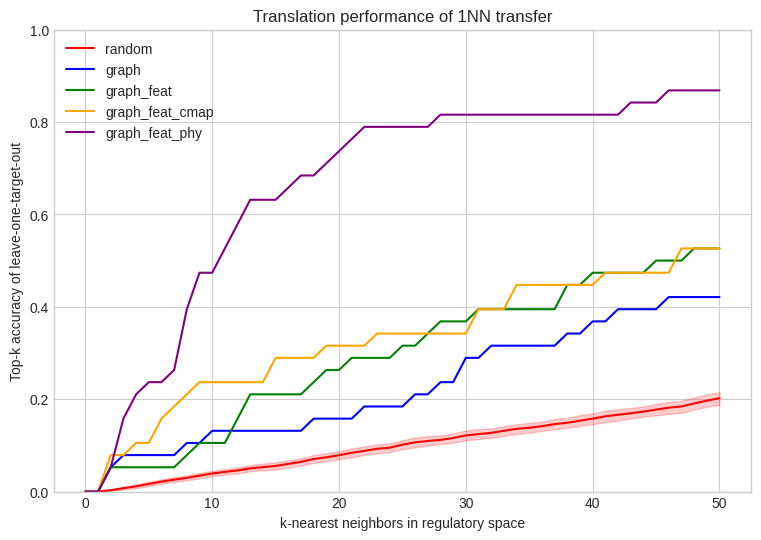

<IPython.core.display.Javascript object>

In [156]:
mpl.style.use("seaborn-whitegrid")
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
    color="red",
)

opts = ["graph", "graph_feat", "graph_feat_cmap", "graph_feat_phy"]
cols = ["blue", "green", "orange", "purple"]
for i in range(len(lin_comb_results_opts)):
    lin_comb_results = lin_comb_results_opts[i]
    col = cols[i]
    opt = opts[i]
    ax.plot(
        np.array(lin_comb_results.loc[lin_comb_results.n == "1", "k"]),
        np.array(lin_comb_results.loc[lin_comb_results.n == "1", "topk_acc"]),
        label=opt,
        color=col,
    )
ax.legend()
ax.set_title("Translation performance of 1NN transfer")
ax.set_xlabel("k-nearest neighbors in regulatory space")
ax.set_ylabel("Top-k accuracy of leave-one-target-out")
ax.set_ylim([0, 1])
plt.show()

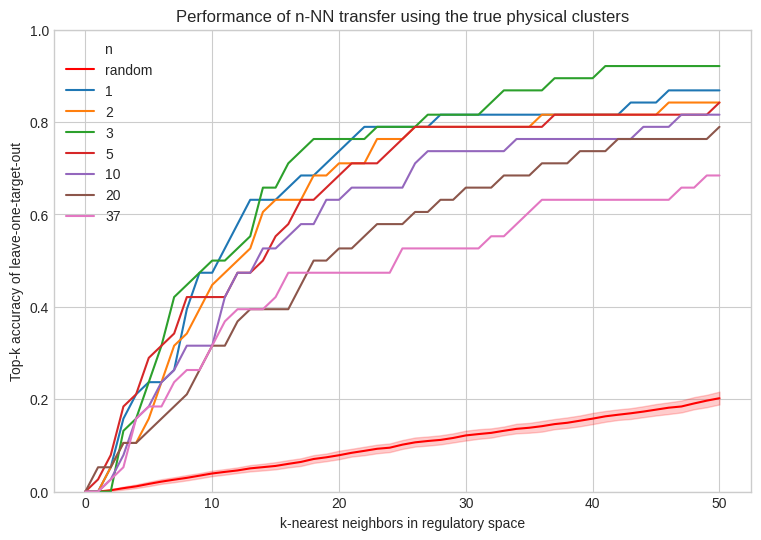

<IPython.core.display.Javascript object>

In [155]:
mpl.style.use("seaborn-whitegrid")
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
    color="red",
)
ax = sns.lineplot(data=lin_comb_results_opts[-1], x="k", y="topk_acc", ax=ax, hue="n")
ax.set_title("Performance of n-NN transfer using the true physical clusters")
ax.set_xlabel("k-nearest neighbors in regulatory space")
ax.set_ylabel("Top-k accuracy of leave-one-target-out")
ax.set_ylim([0, 1])
plt.show()

---

### 2.2. Linear mean translation

As a second setup, we will train a linear model in a leave-one-target out setting for 1000 epochs.

In [19]:
nn = NearestNeighbors(n_neighbors=len(node_embs)).fit(np.array(node_embs))
nn_clf = CustomKNNClassifier(
    clf=nn, samples=np.array(list(node_embs.index)), ks=[1, 3, 5, 10, 20, 50]
)

<IPython.core.display.Javascript object>

---

In [20]:
data_dicts = get_logo_data_dicts(
    data=img_embs_fold0,
    labels=node_embs_fold0,
    val_size=0,
    group_labels=np.array(list(node_embs_fold0.index)),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/38 [00:00<?, ?it/s]

ATF4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001820127183974192
train top-k accuracies: {1: 0.513514, 3: 0.756757, 5: 0.756757, 10: 0.810811, 20: 0.891892, 50: 0.891892}
train mean top-k accuracies: {1: 0.513514, 3: 0.756757, 5: 0.756757, 10: 0.810811, 20: 0.891892, 50: 0.891892}
test loss: 0.0029791195411235094
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


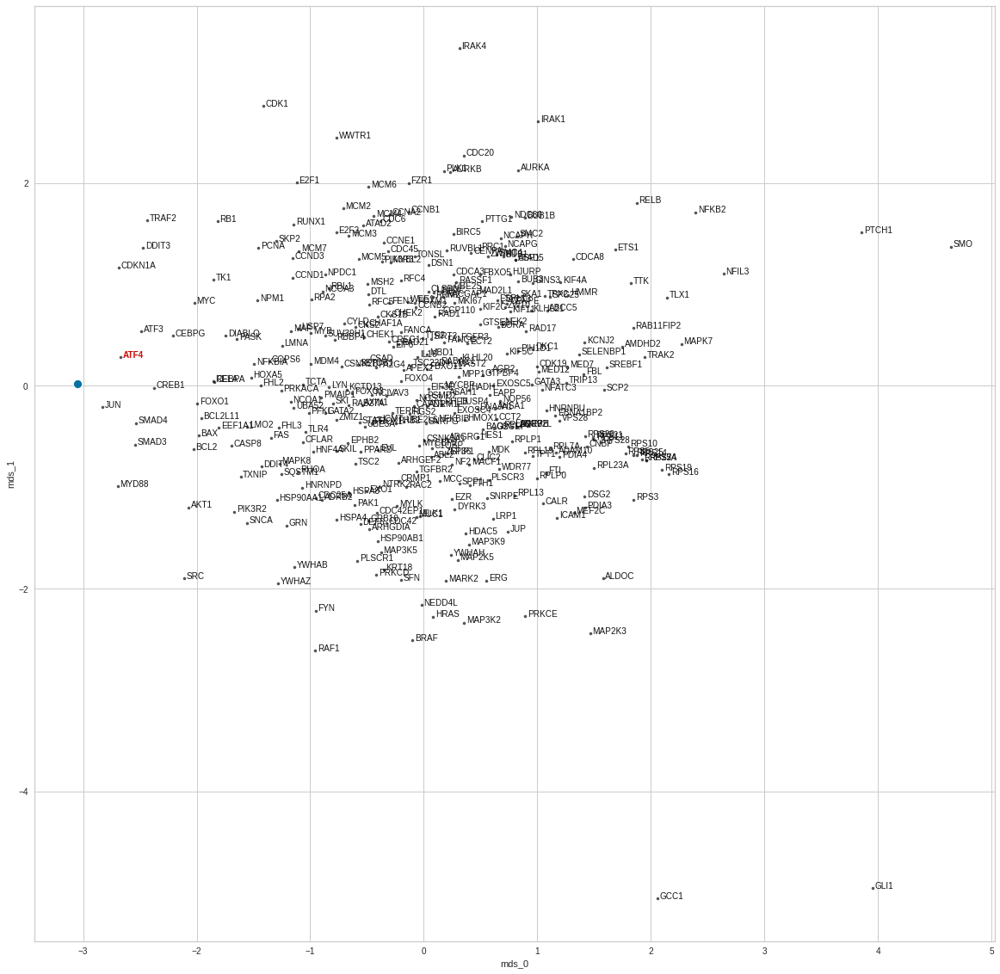

BAX
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0022314023855771565
train top-k accuracies: {1: 0.459459, 3: 0.648649, 5: 0.702703, 10: 0.783784, 20: 0.891892, 50: 0.891892}
train mean top-k accuracies: {1: 0.459459, 3: 0.648649, 5: 0.702703, 10: 0.783784, 20: 0.891892, 50: 0.891892}
test loss: 0.00391241954639554
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


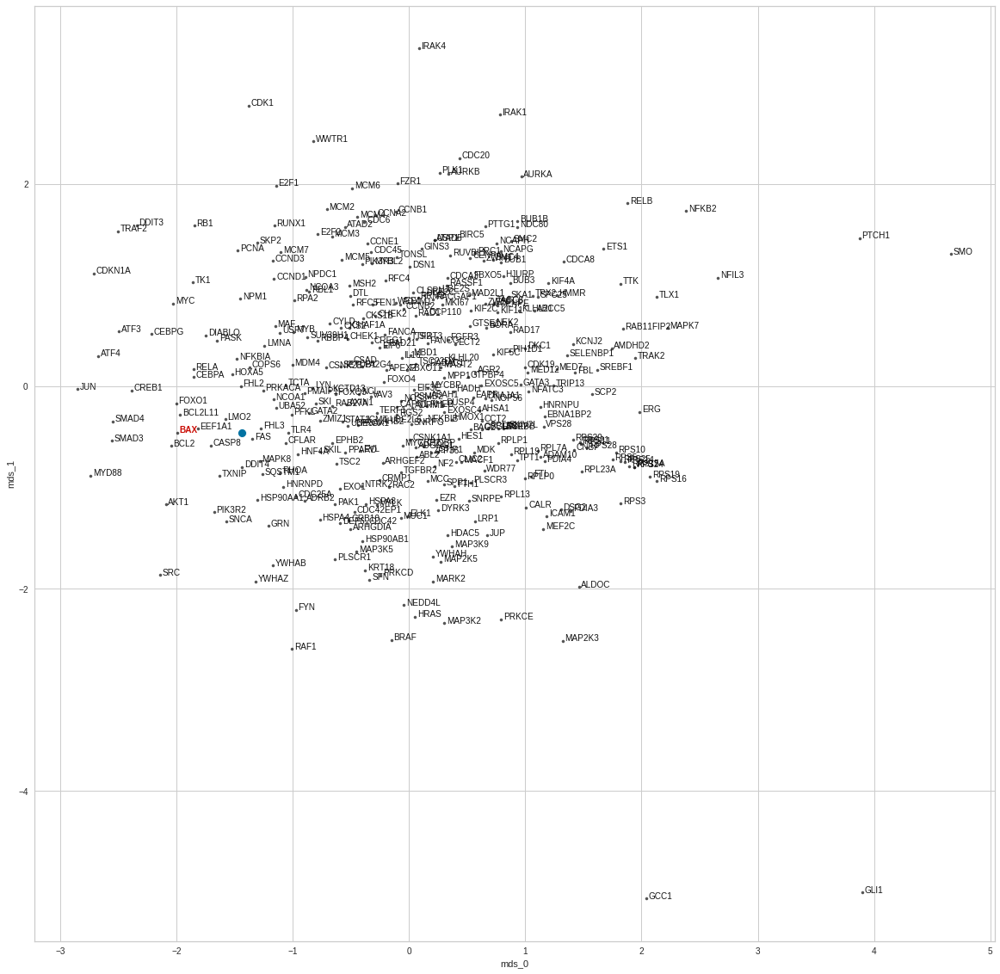

BCL2L11
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0023453137742959567
train top-k accuracies: {1: 0.324324, 3: 0.594595, 5: 0.621622, 10: 0.702703, 20: 0.756757, 50: 0.810811}
train mean top-k accuracies: {1: 0.324324, 3: 0.594595, 5: 0.621622, 10: 0.702703, 20: 0.756757, 50: 0.810811}
test loss: 0.004397834185510874
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


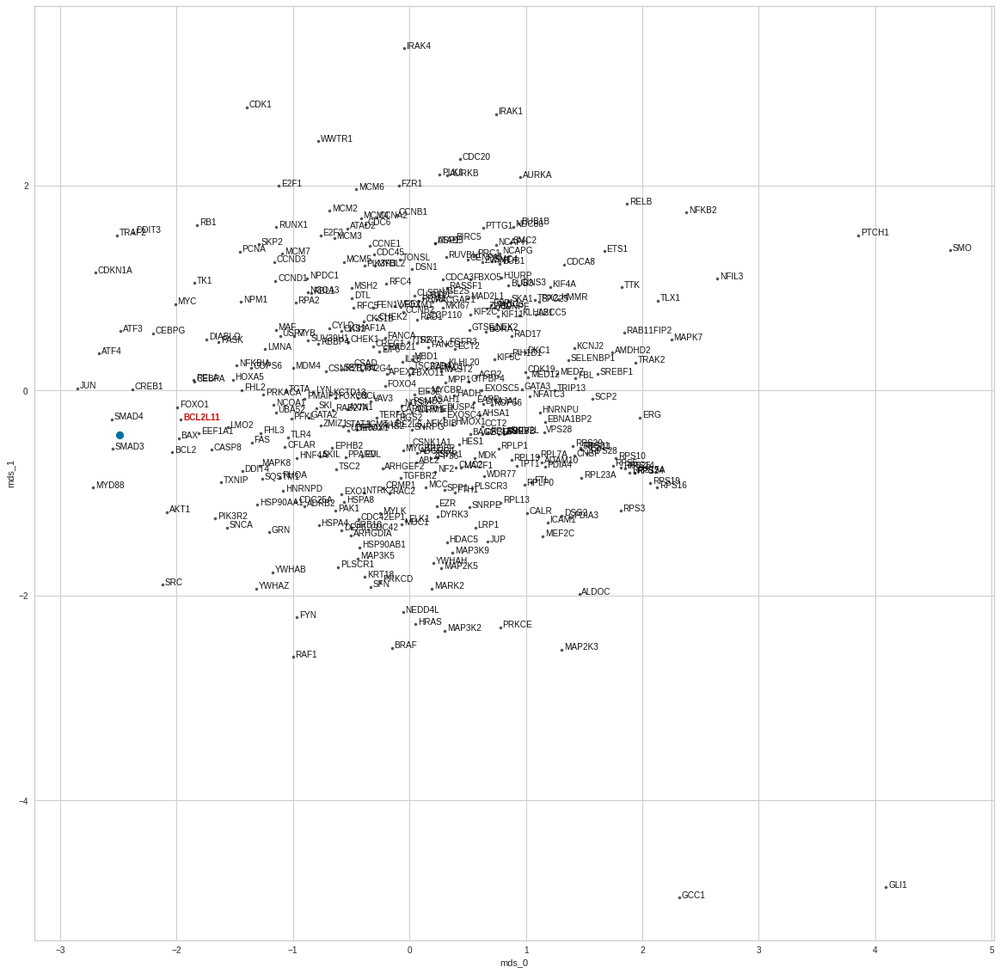

BRAF
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002407157375175204
train top-k accuracies: {1: 0.405405, 3: 0.648649, 5: 0.675676, 10: 0.72973, 20: 0.837838, 50: 0.918919}
train mean top-k accuracies: {1: 0.405405, 3: 0.648649, 5: 0.675676, 10: 0.72973, 20: 0.837838, 50: 0.918919}
test loss: 0.00835956446826458
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


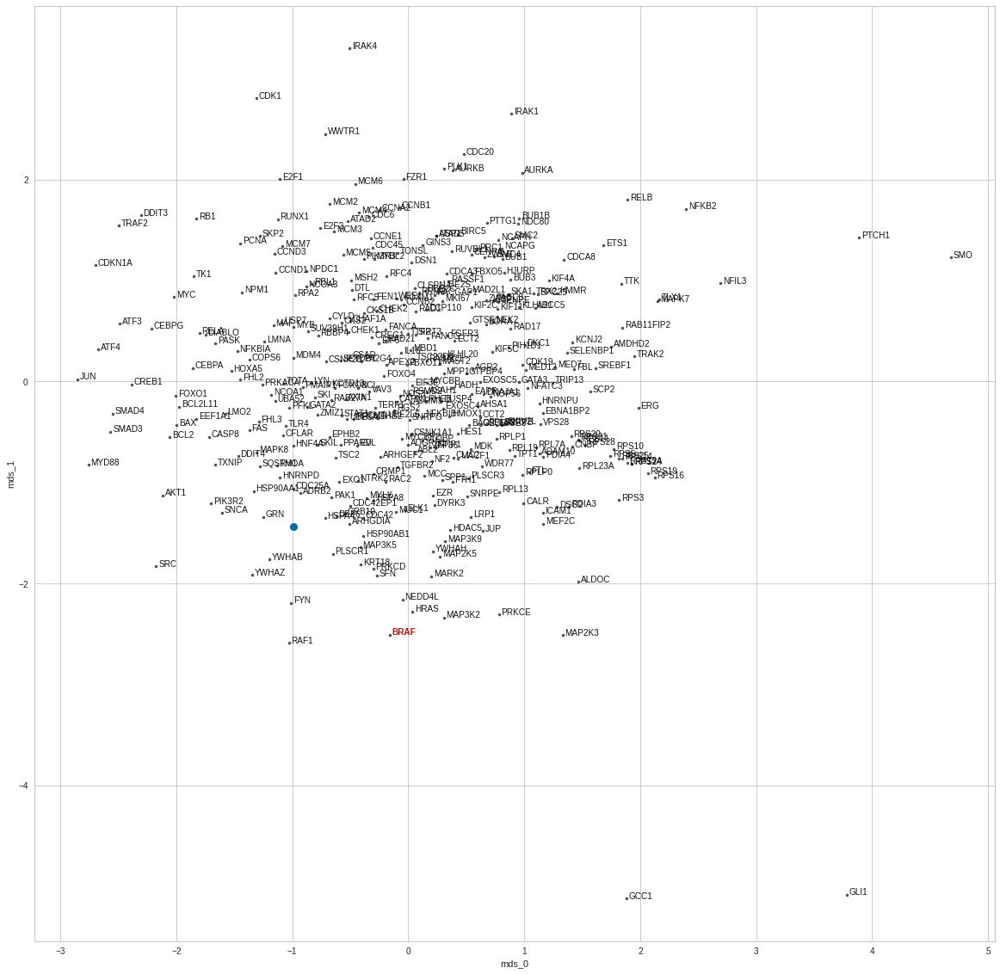

CASP8
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0021163434281039075
train top-k accuracies: {1: 0.432432, 3: 0.648649, 5: 0.702703, 10: 0.783784, 20: 0.891892, 50: 0.972973}
train mean top-k accuracies: {1: 0.432432, 3: 0.648649, 5: 0.702703, 10: 0.783784, 20: 0.891892, 50: 0.972973}
test loss: 0.007485104259103537
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


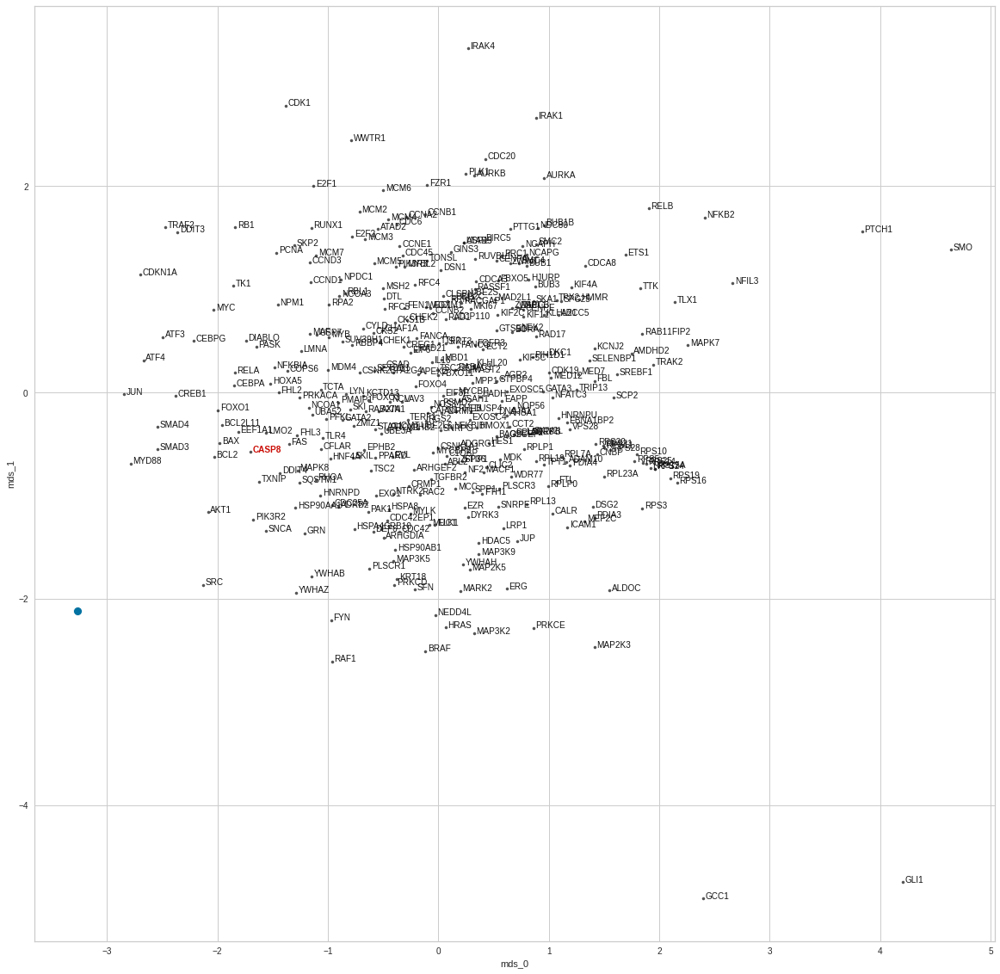

CDC42
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002220839916451557
train top-k accuracies: {1: 0.297297, 3: 0.540541, 5: 0.567568, 10: 0.702703, 20: 0.702703, 50: 0.72973}
train mean top-k accuracies: {1: 0.297297, 3: 0.540541, 5: 0.567568, 10: 0.702703, 20: 0.702703, 50: 0.72973}
test loss: 0.006439368240535259
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


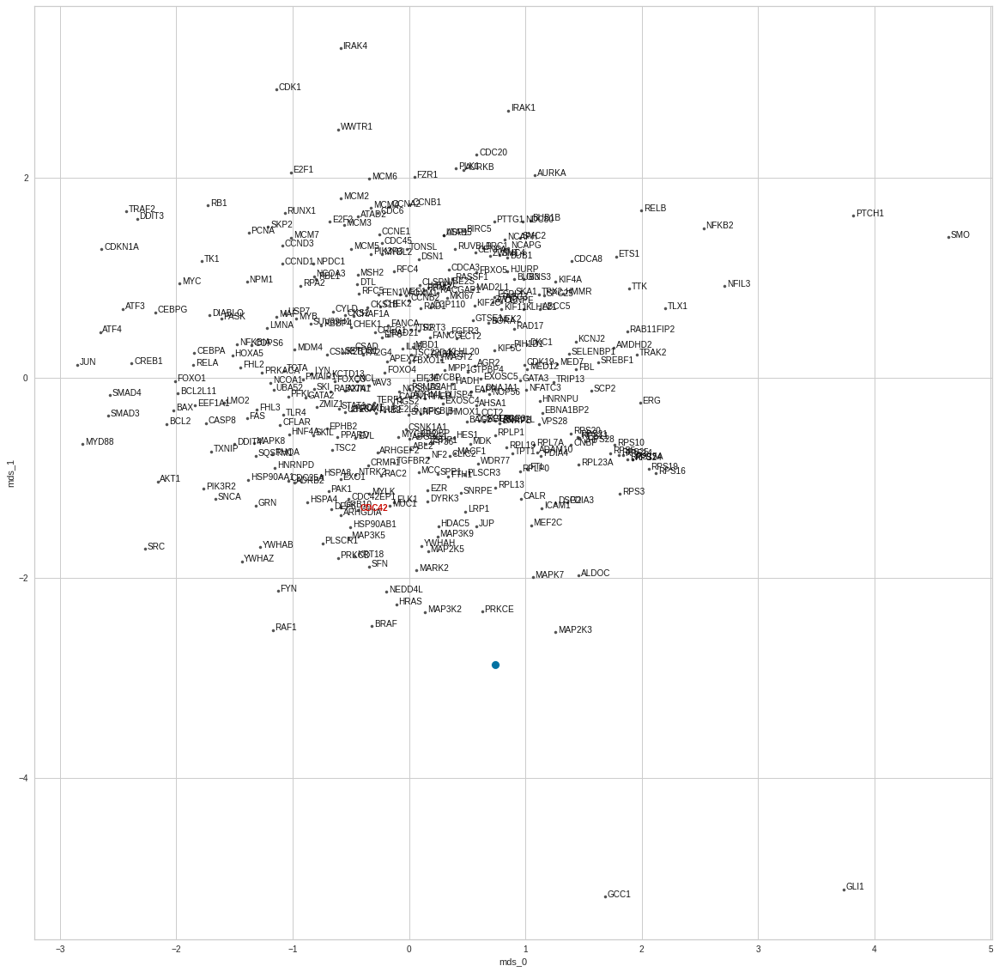

CDKN1A
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0018932769307866693
train top-k accuracies: {1: 0.513514, 3: 0.648649, 5: 0.702703, 10: 0.72973, 20: 0.810811, 50: 0.918919}
train mean top-k accuracies: {1: 0.513514, 3: 0.648649, 5: 0.702703, 10: 0.72973, 20: 0.810811, 50: 0.918919}
test loss: 0.01676059700548649
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


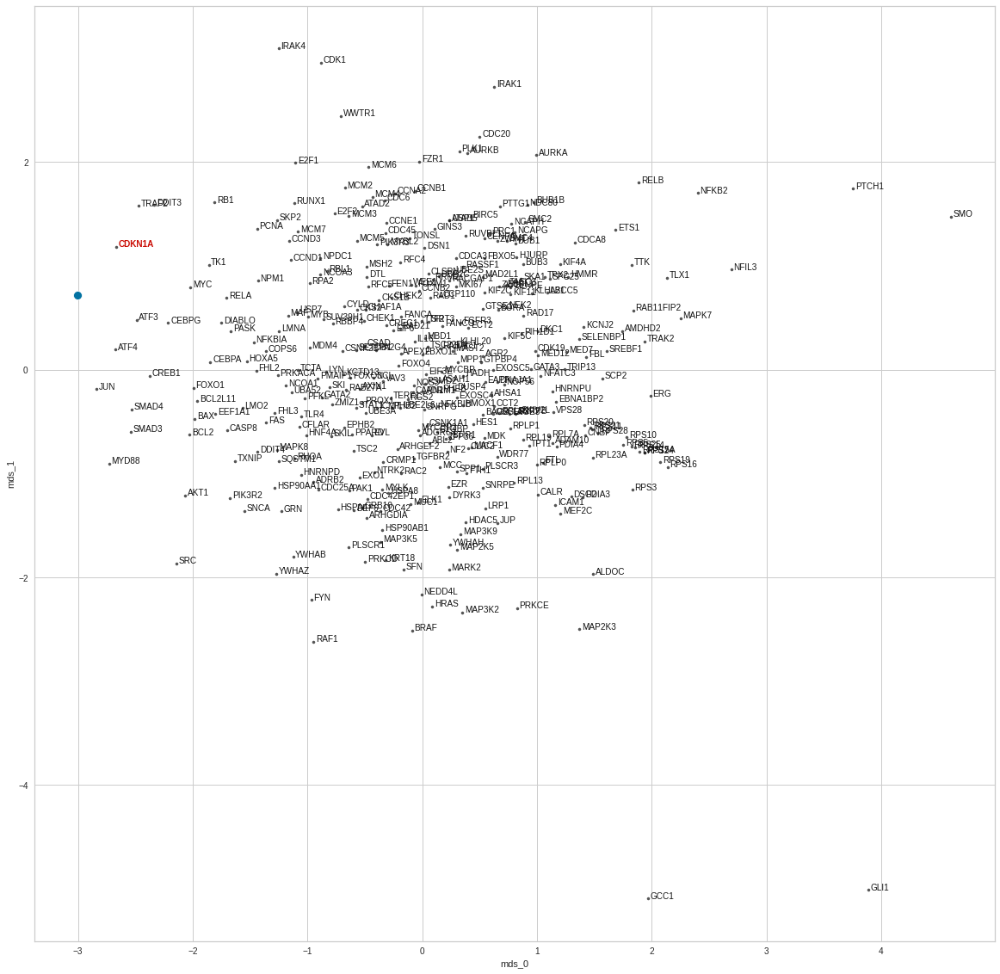

CEBPA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0020335822215152752
train top-k accuracies: {1: 0.486486, 3: 0.702703, 5: 0.783784, 10: 0.810811, 20: 0.837838, 50: 0.918919}
train mean top-k accuracies: {1: 0.486486, 3: 0.702703, 5: 0.783784, 10: 0.810811, 20: 0.837838, 50: 0.918919}
test loss: 0.010390328243374825
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


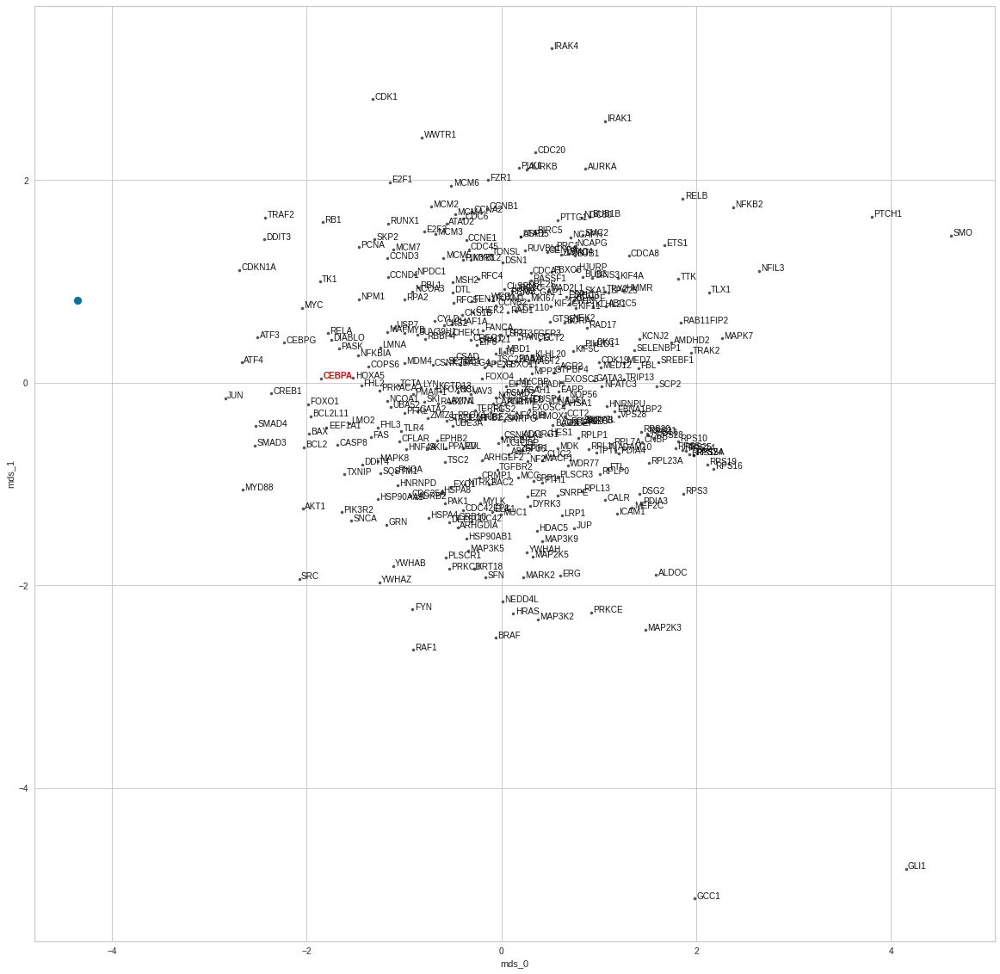

CREB1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0022957239589477714
train top-k accuracies: {1: 0.405405, 3: 0.513514, 5: 0.540541, 10: 0.648649, 20: 0.72973, 50: 0.783784}
train mean top-k accuracies: {1: 0.405405, 3: 0.513514, 5: 0.540541, 10: 0.648649, 20: 0.72973, 50: 0.783784}
test loss: 0.005632373504340649
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


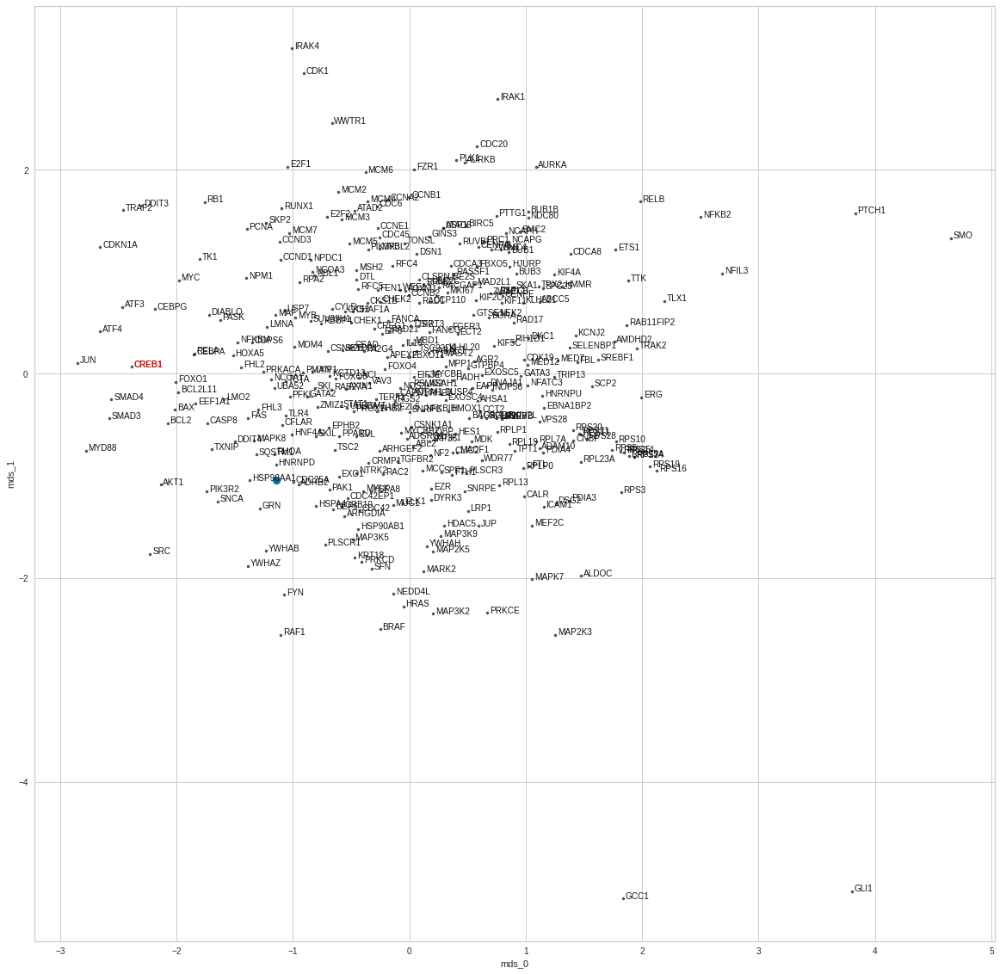

DIABLO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001695799672774769
train top-k accuracies: {1: 0.432432, 3: 0.675676, 5: 0.72973, 10: 0.810811, 20: 0.864865, 50: 0.945946}
train mean top-k accuracies: {1: 0.432432, 3: 0.675676, 5: 0.72973, 10: 0.810811, 20: 0.864865, 50: 0.945946}
test loss: 0.007490148767828941
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


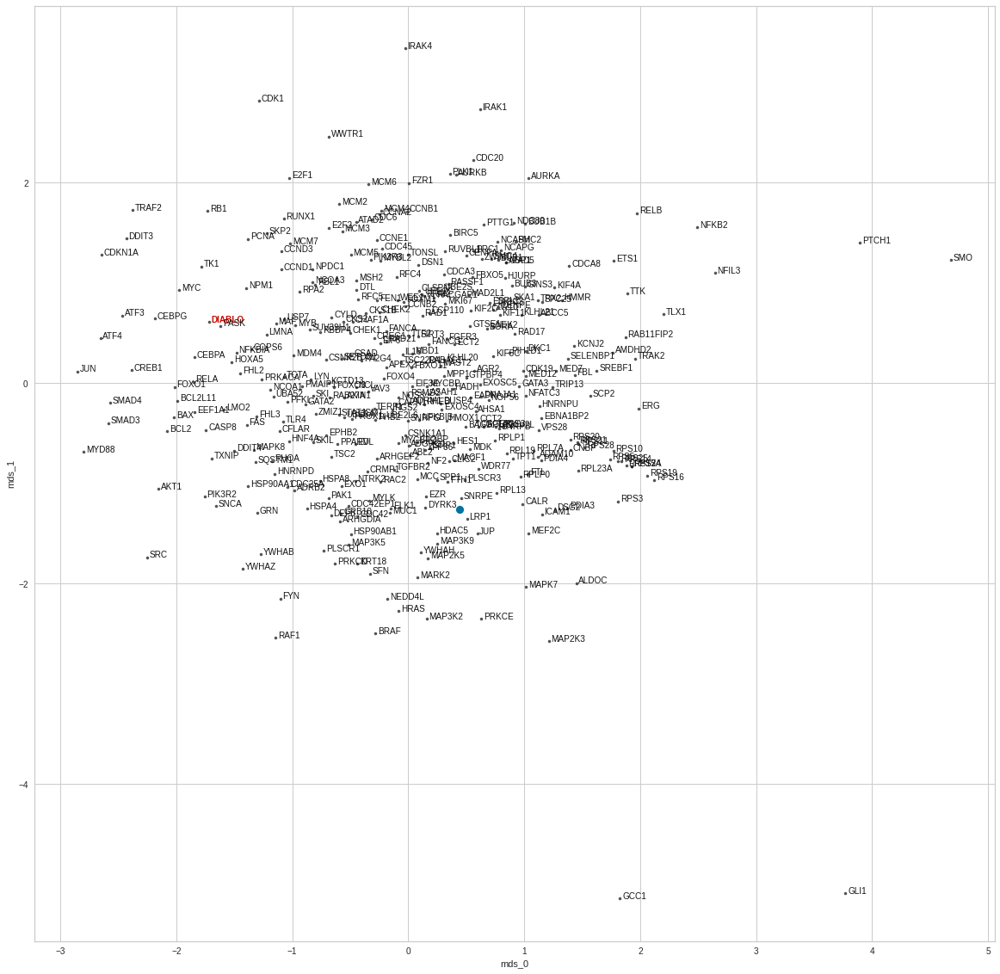

E2F1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0021133864978076637
train top-k accuracies: {1: 0.405405, 3: 0.621622, 5: 0.72973, 10: 0.756757, 20: 0.837838, 50: 0.891892}
train mean top-k accuracies: {1: 0.405405, 3: 0.621622, 5: 0.72973, 10: 0.756757, 20: 0.837838, 50: 0.891892}
test loss: 0.015594850294291973
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


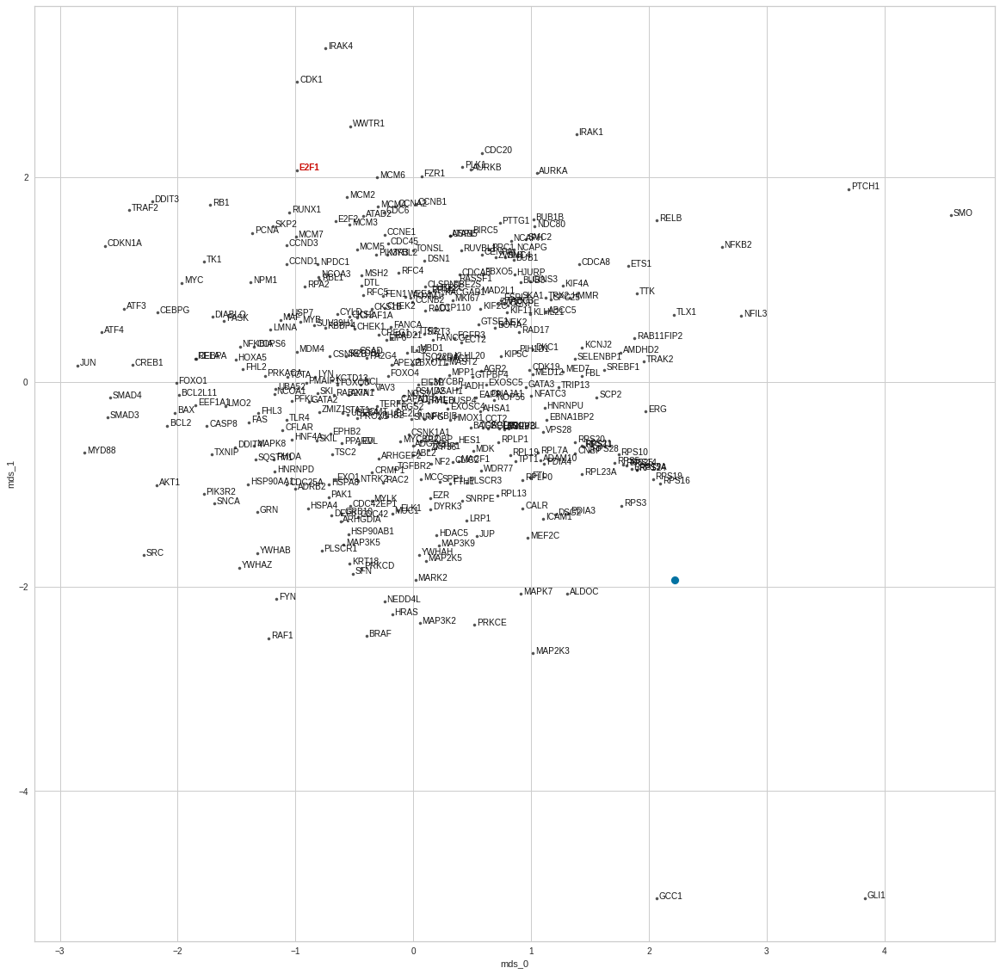

ELK1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002619662180517775
train top-k accuracies: {1: 0.324324, 3: 0.432432, 5: 0.594595, 10: 0.702703, 20: 0.72973, 50: 0.864865}
train mean top-k accuracies: {1: 0.324324, 3: 0.432432, 5: 0.594595, 10: 0.702703, 20: 0.72973, 50: 0.864865}
test loss: 0.010996812023222446
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


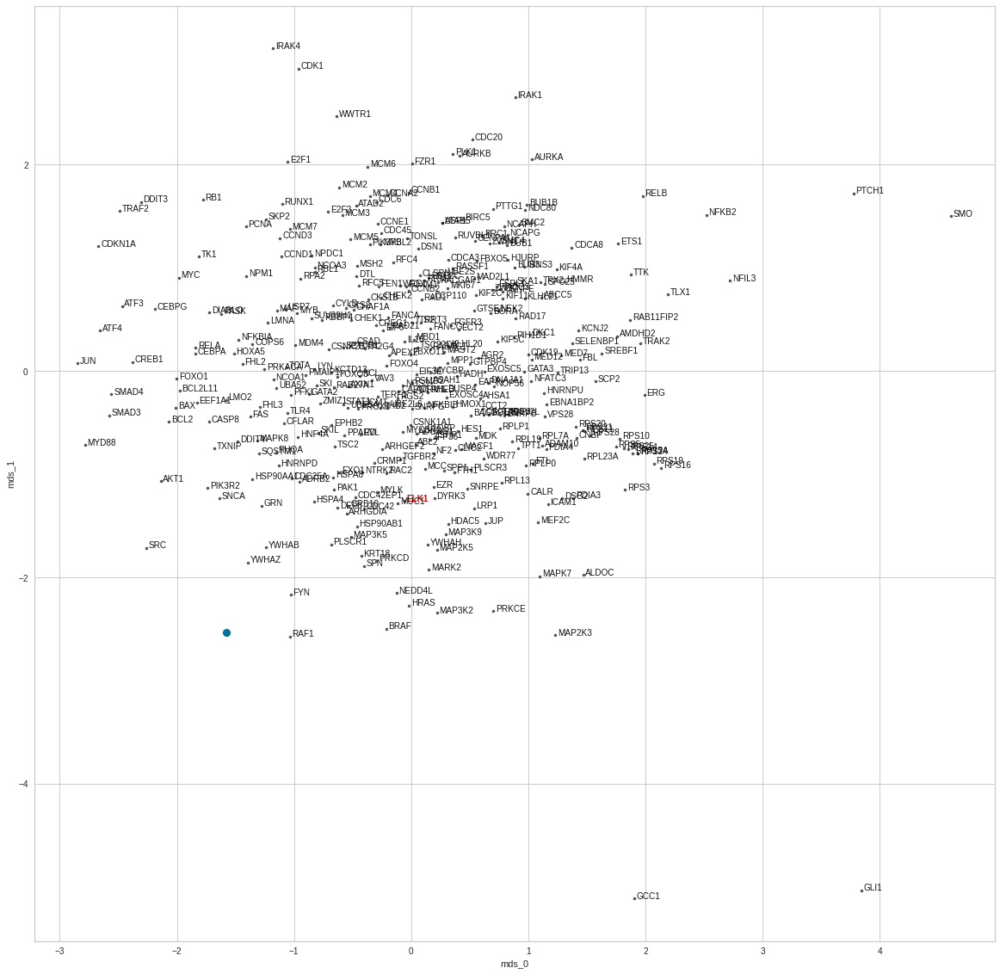

ERG
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0022971789239326842
train top-k accuracies: {1: 0.432432, 3: 0.675676, 5: 0.702703, 10: 0.783784, 20: 0.810811, 50: 0.891892}
train mean top-k accuracies: {1: 0.432432, 3: 0.675676, 5: 0.702703, 10: 0.783784, 20: 0.810811, 50: 0.891892}
test loss: 0.003951588179916143
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


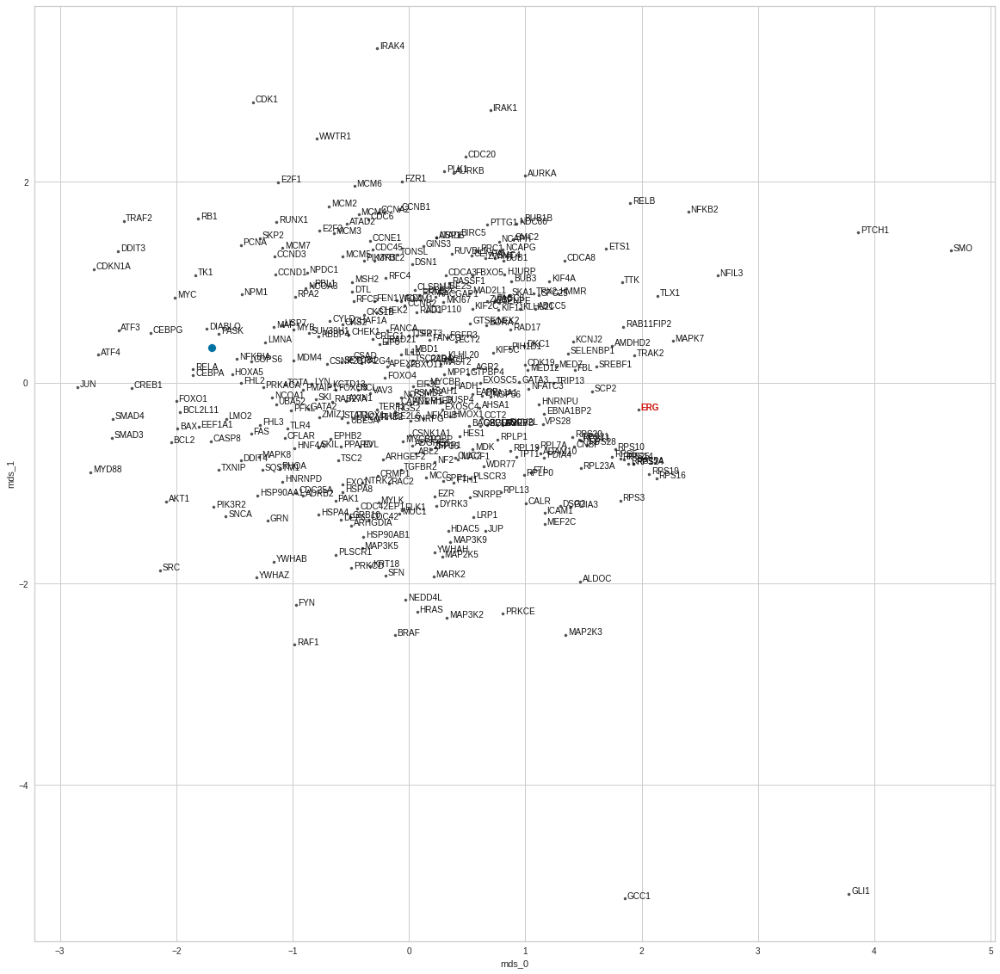

FGFR3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002602630836033338
train top-k accuracies: {1: 0.405405, 3: 0.648649, 5: 0.756757, 10: 0.783784, 20: 0.864865, 50: 0.891892}
train mean top-k accuracies: {1: 0.405405, 3: 0.648649, 5: 0.756757, 10: 0.783784, 20: 0.864865, 50: 0.891892}
test loss: 0.0045404392294585705
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


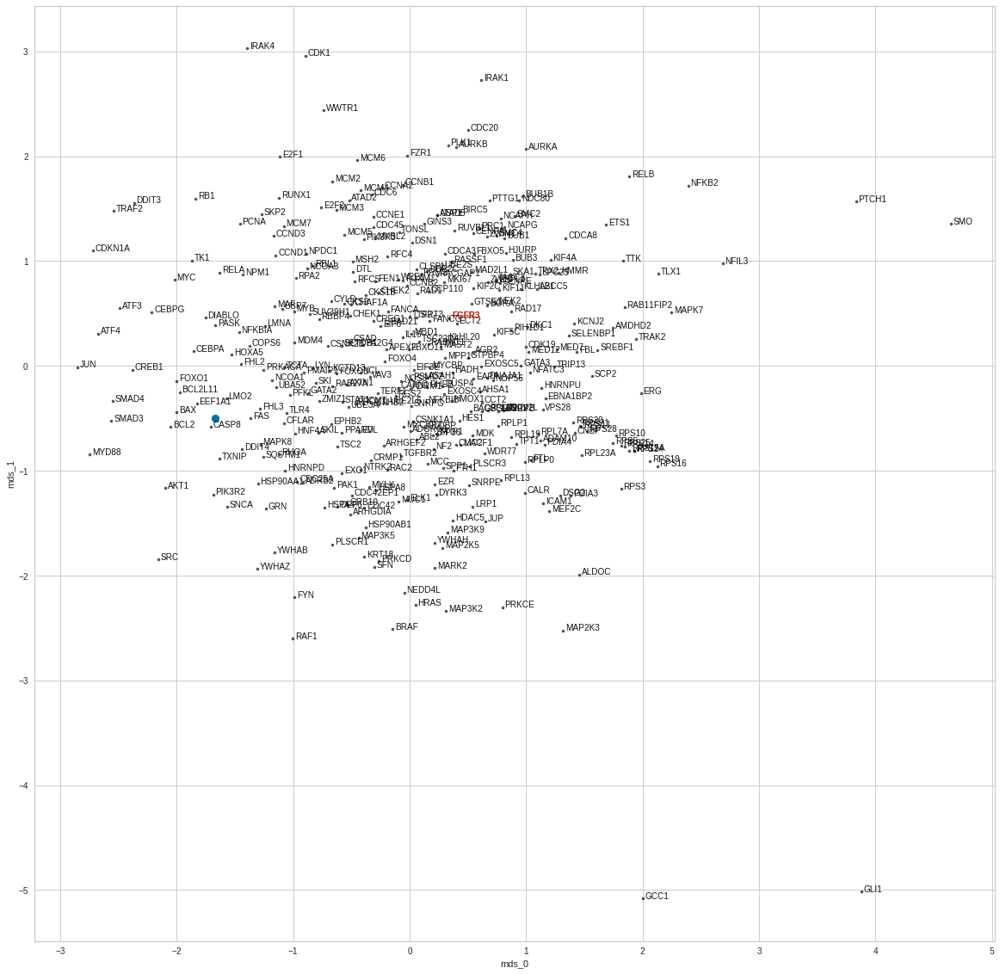

FOXO1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0019495094610327804
train top-k accuracies: {1: 0.567568, 3: 0.756757, 5: 0.783784, 10: 0.864865, 20: 0.864865, 50: 0.945946}
train mean top-k accuracies: {1: 0.567568, 3: 0.756757, 5: 0.783784, 10: 0.864865, 20: 0.864865, 50: 0.945946}
test loss: 0.01007772982120514
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


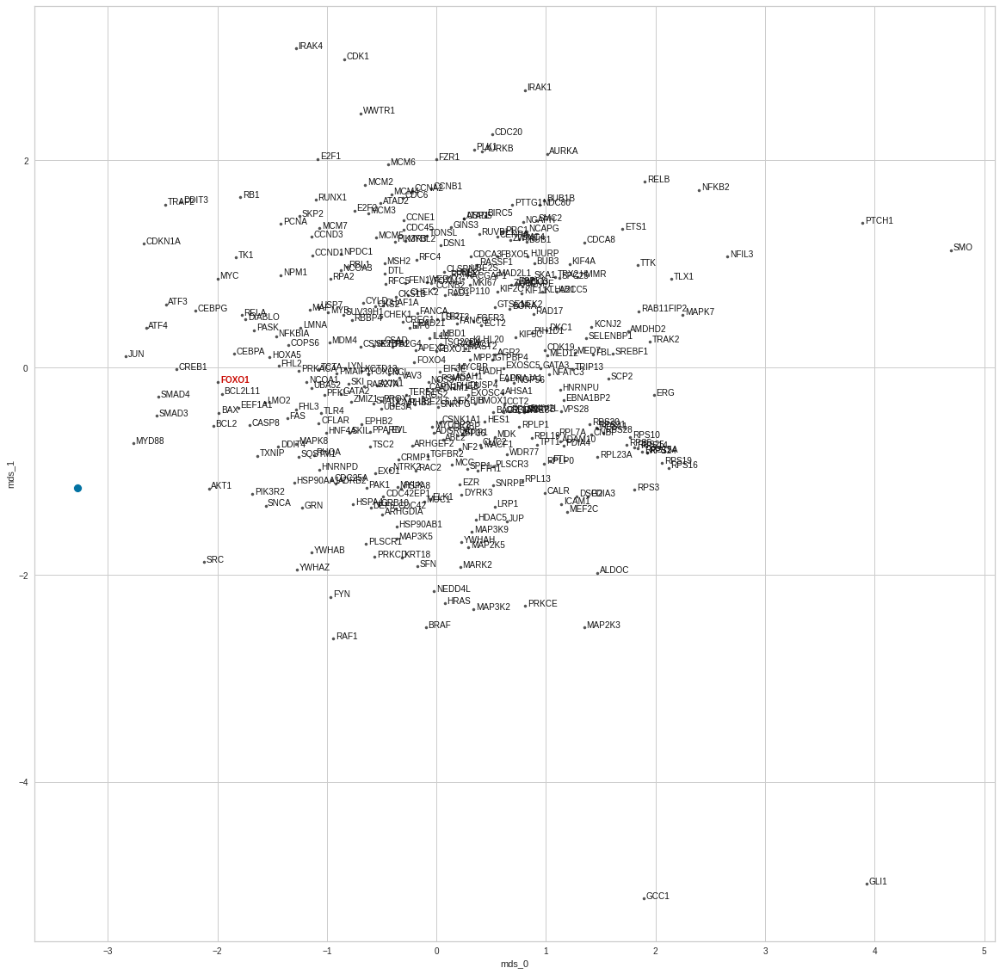

GLI1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0017108842699058555
train top-k accuracies: {1: 0.378378, 3: 0.594595, 5: 0.621622, 10: 0.756757, 20: 0.783784, 50: 0.918919}
train mean top-k accuracies: {1: 0.378378, 3: 0.594595, 5: 0.621622, 10: 0.756757, 20: 0.783784, 50: 0.918919}
test loss: 0.043549492955207825
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


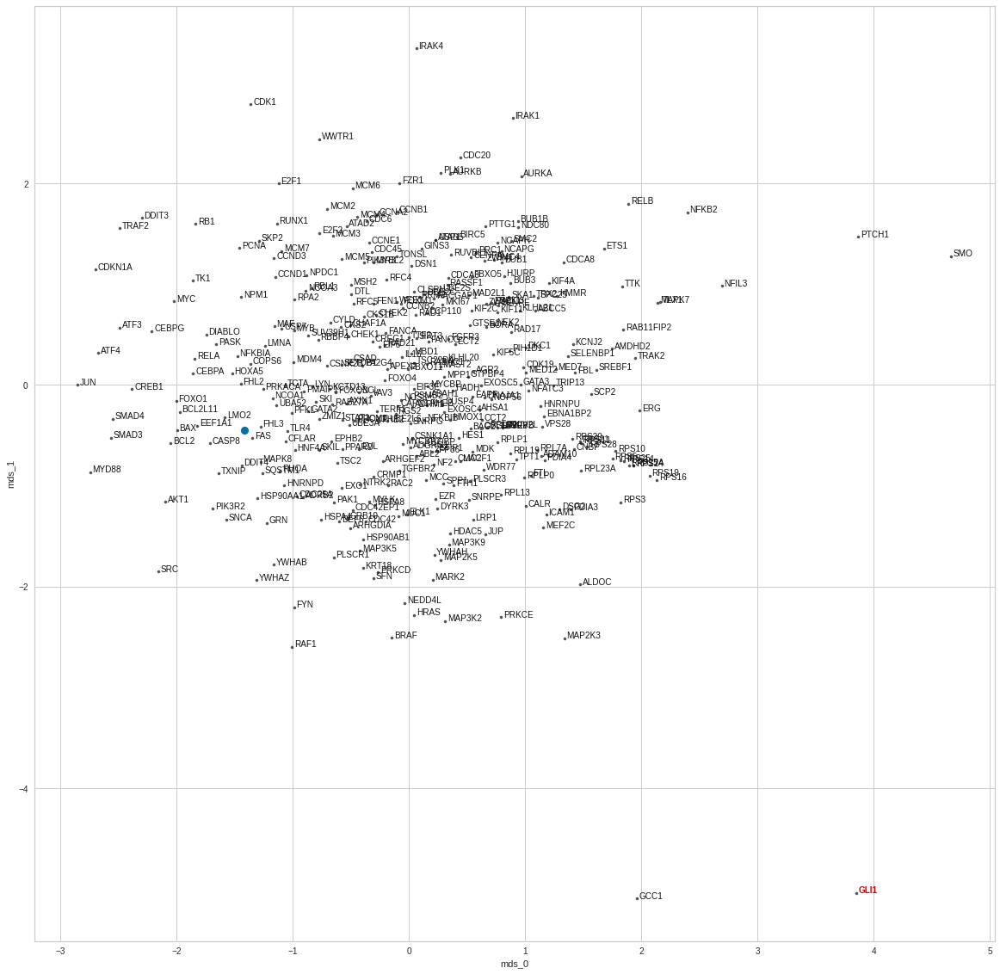

HRAS
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0019704580426568516
train top-k accuracies: {1: 0.486486, 3: 0.621622, 5: 0.675676, 10: 0.810811, 20: 0.864865, 50: 0.918919}
train mean top-k accuracies: {1: 0.486486, 3: 0.621622, 5: 0.675676, 10: 0.810811, 20: 0.864865, 50: 0.918919}
test loss: 0.013535180129110813
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


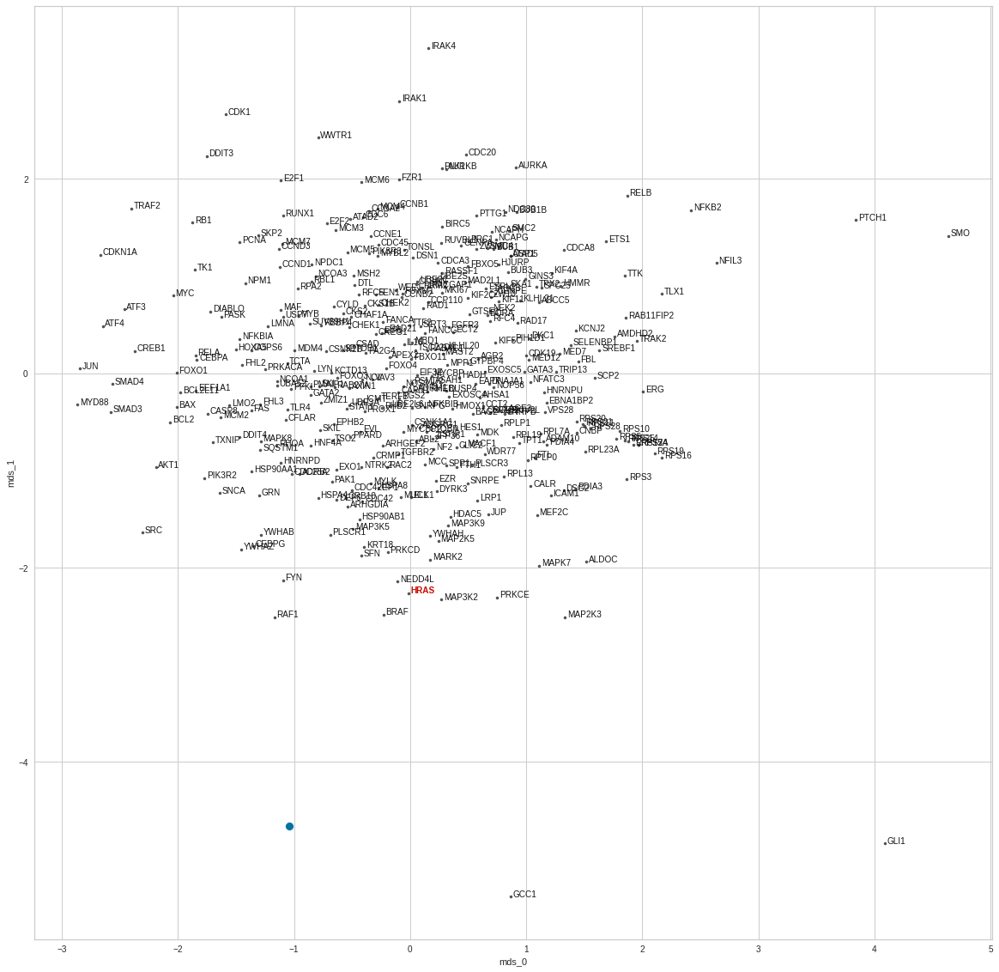

IRAK4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001814304366456093
train top-k accuracies: {1: 0.594595, 3: 0.783784, 5: 0.864865, 10: 0.891892, 20: 0.945946, 50: 0.945946}
train mean top-k accuracies: {1: 0.594595, 3: 0.783784, 5: 0.864865, 10: 0.891892, 20: 0.945946, 50: 0.945946}
test loss: 0.012615916319191456
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


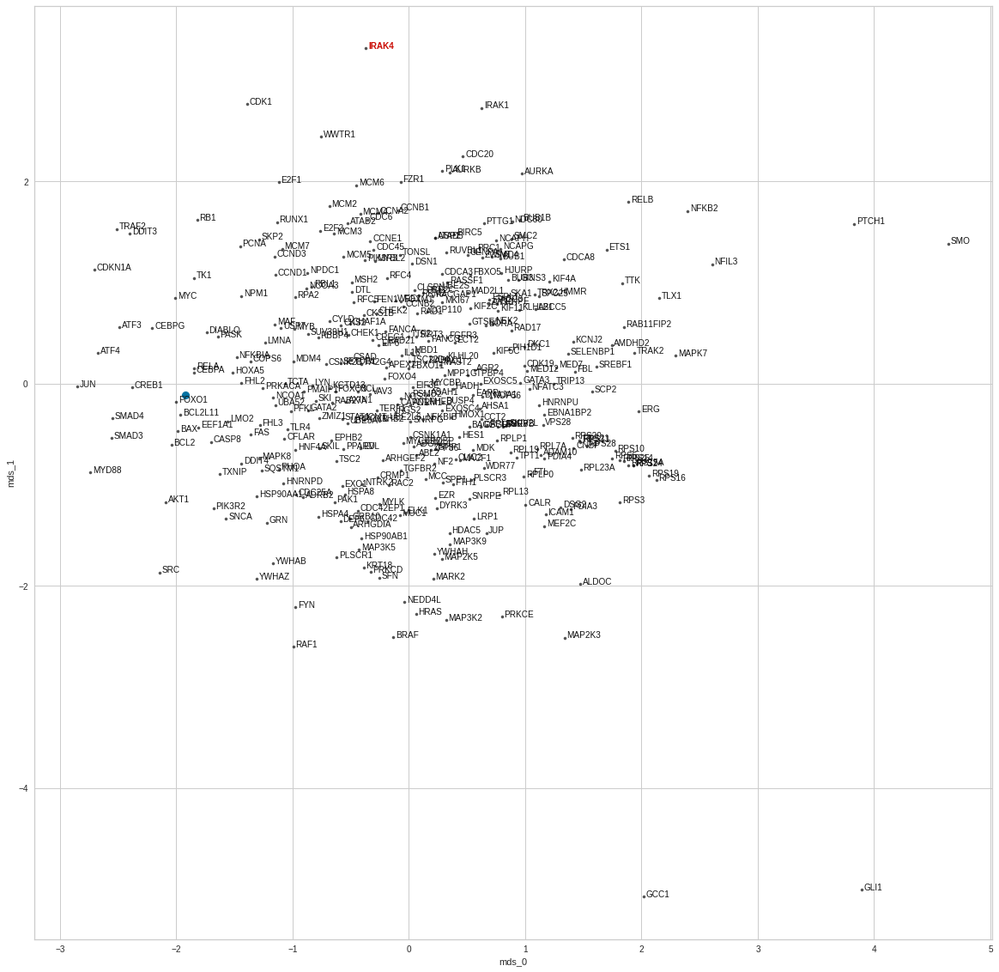

JUN
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002026316077398086
train top-k accuracies: {1: 0.405405, 3: 0.702703, 5: 0.72973, 10: 0.810811, 20: 0.864865, 50: 0.945946}
train mean top-k accuracies: {1: 0.405405, 3: 0.702703, 5: 0.72973, 10: 0.810811, 20: 0.864865, 50: 0.945946}
test loss: 0.01611367054283619
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


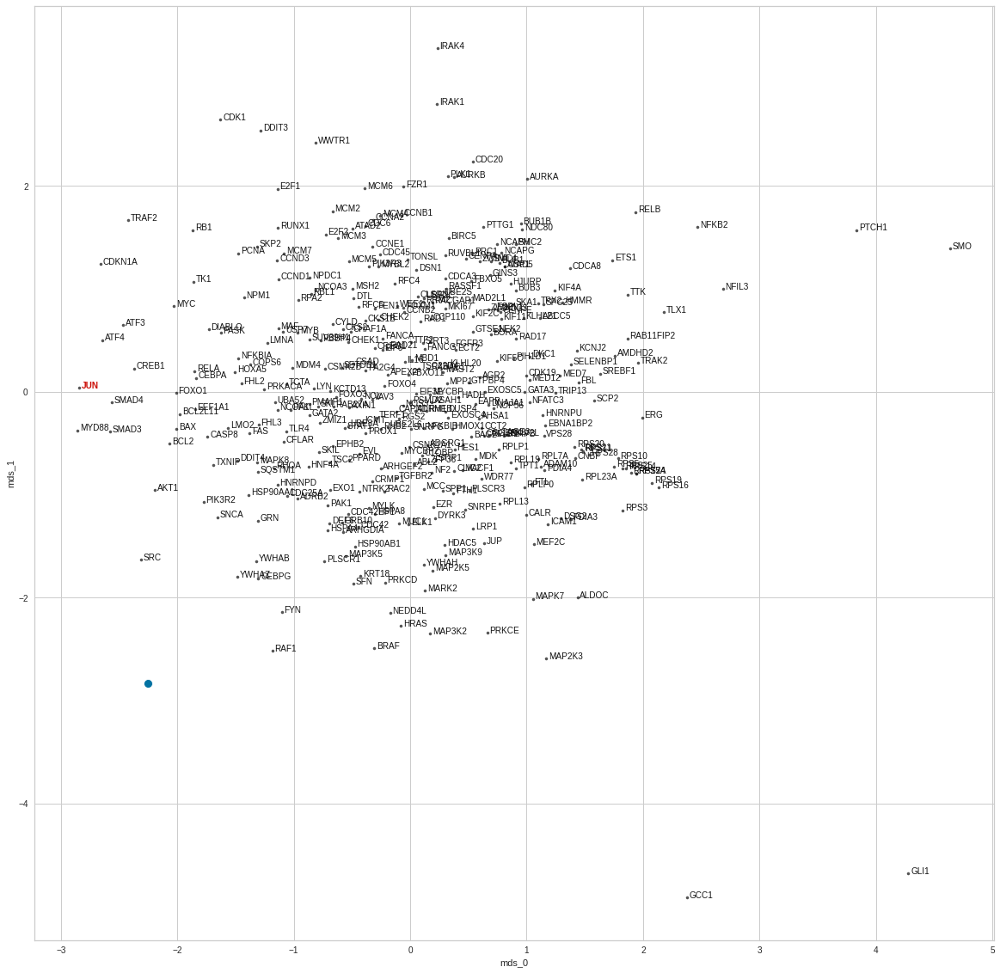

MAP2K3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002366469011994431
train top-k accuracies: {1: 0.297297, 3: 0.513514, 5: 0.567568, 10: 0.675676, 20: 0.675676, 50: 0.810811}
train mean top-k accuracies: {1: 0.297297, 3: 0.513514, 5: 0.567568, 10: 0.675676, 20: 0.675676, 50: 0.810811}
test loss: 0.00894647091627121
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


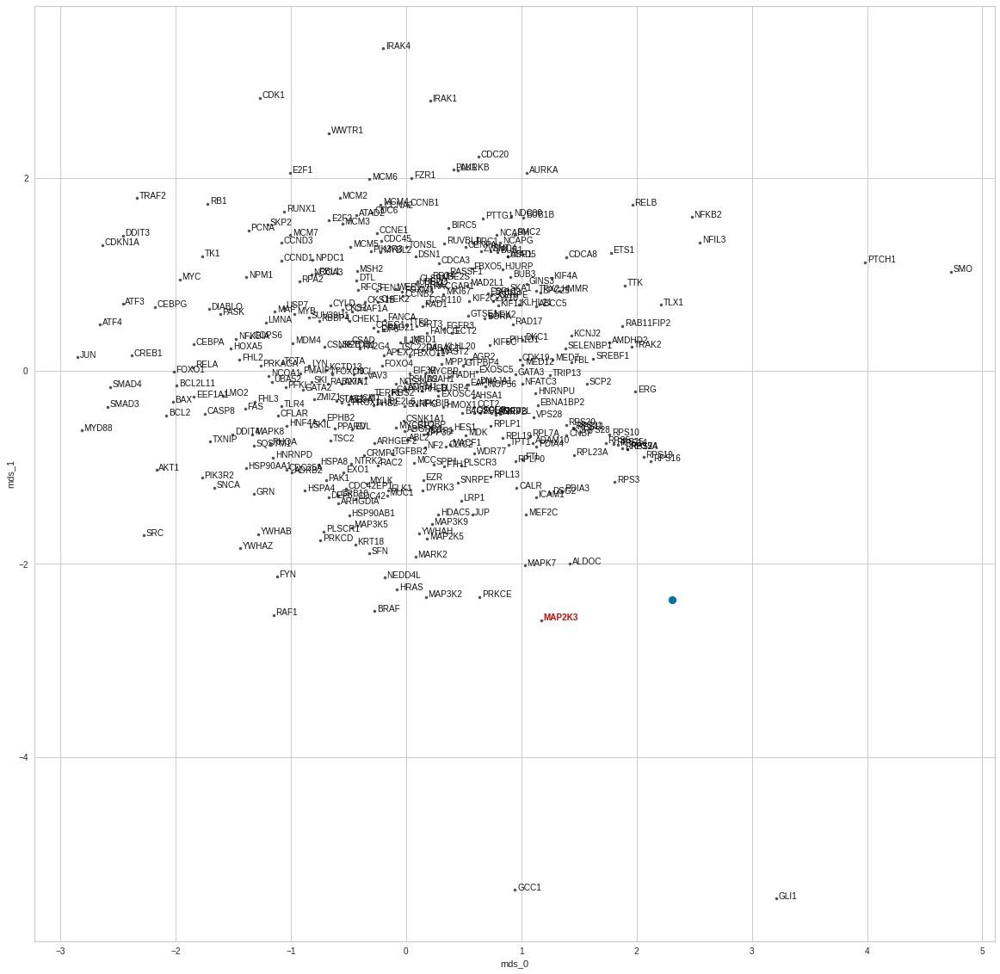

MAP3K2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0030620685098944485
train top-k accuracies: {1: 0.324324, 3: 0.486486, 5: 0.540541, 10: 0.594595, 20: 0.621622, 50: 0.702703}
train mean top-k accuracies: {1: 0.324324, 3: 0.486486, 5: 0.540541, 10: 0.594595, 20: 0.621622, 50: 0.702703}
test loss: 0.0028076577000319958
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


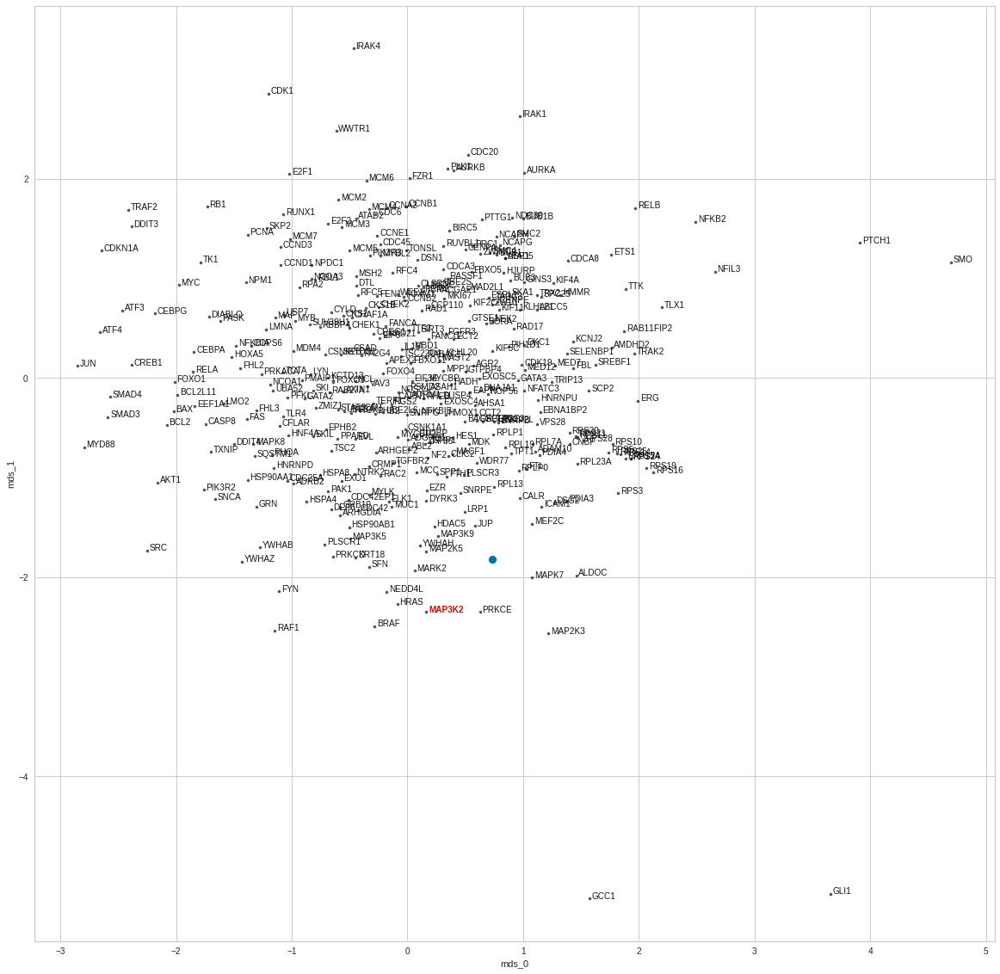

MAP3K5
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0016749105667947111
train top-k accuracies: {1: 0.513514, 3: 0.702703, 5: 0.810811, 10: 0.837838, 20: 0.864865, 50: 0.945946}
train mean top-k accuracies: {1: 0.513514, 3: 0.702703, 5: 0.810811, 10: 0.837838, 20: 0.864865, 50: 0.945946}
test loss: 0.003465131390839815
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


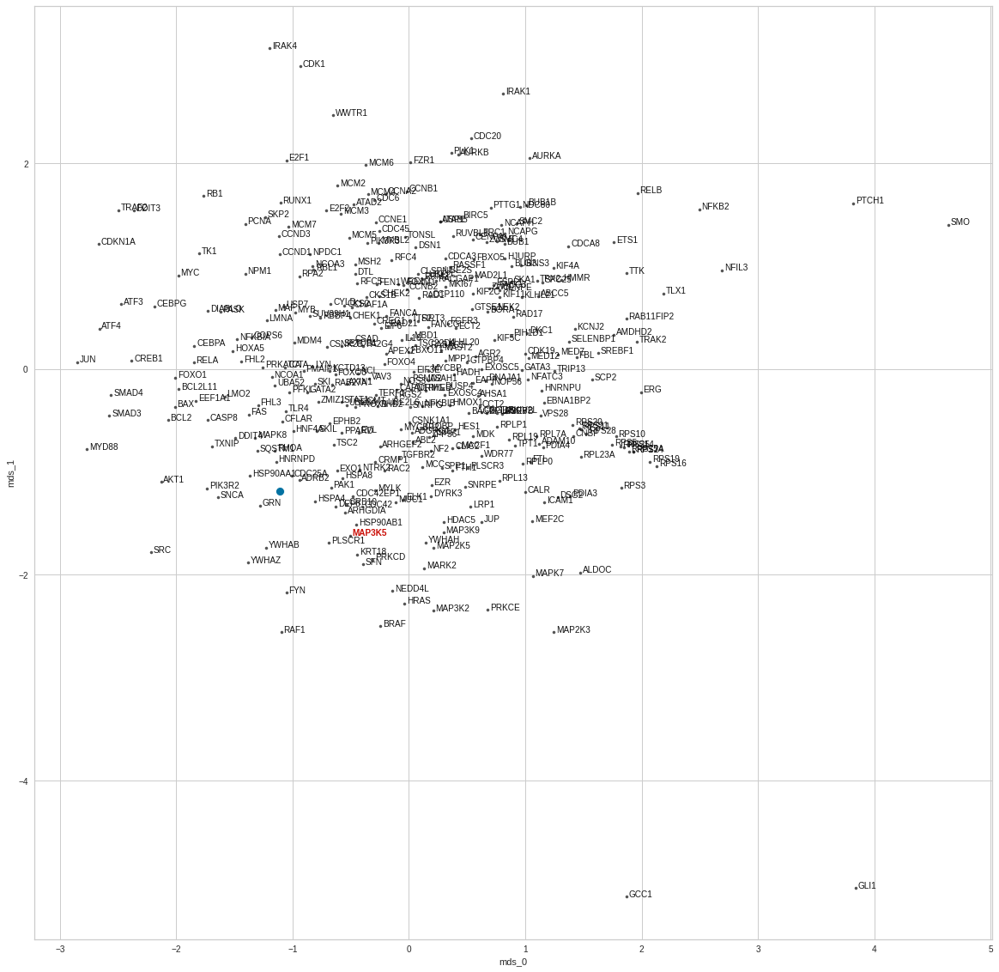

MAP3K9
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002450956594878556
train top-k accuracies: {1: 0.459459, 3: 0.621622, 5: 0.72973, 10: 0.783784, 20: 0.837838, 50: 0.918919}
train mean top-k accuracies: {1: 0.459459, 3: 0.621622, 5: 0.72973, 10: 0.783784, 20: 0.837838, 50: 0.918919}
test loss: 0.008732542395591736
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


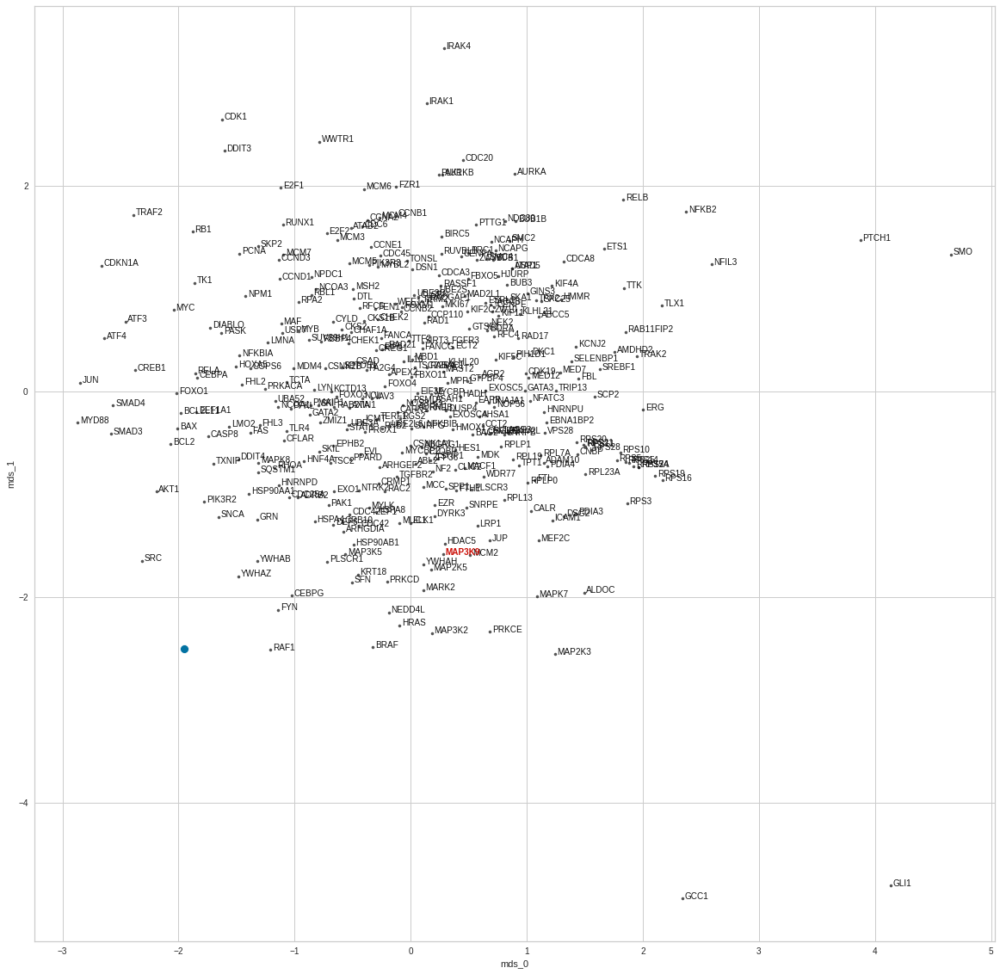

MAPK7
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001831277132009131
train top-k accuracies: {1: 0.513514, 3: 0.648649, 5: 0.675676, 10: 0.72973, 20: 0.810811, 50: 0.891892}
train mean top-k accuracies: {1: 0.513514, 3: 0.648649, 5: 0.675676, 10: 0.72973, 20: 0.810811, 50: 0.891892}
test loss: 0.007892044261097908
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


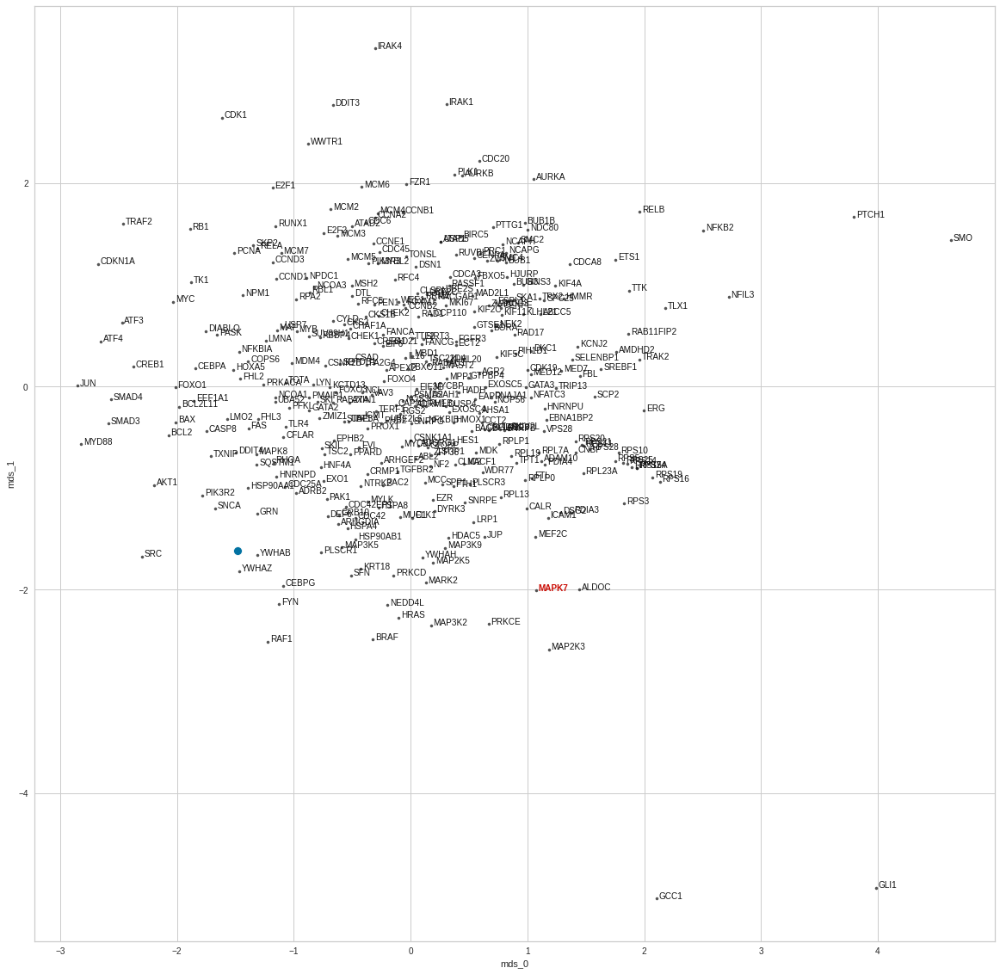

MYD88
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0027107871137559414
train top-k accuracies: {1: 0.351351, 3: 0.540541, 5: 0.594595, 10: 0.621622, 20: 0.648649, 50: 0.72973}
train mean top-k accuracies: {1: 0.351351, 3: 0.540541, 5: 0.594595, 10: 0.621622, 20: 0.648649, 50: 0.72973}
test loss: 0.011899381875991821
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


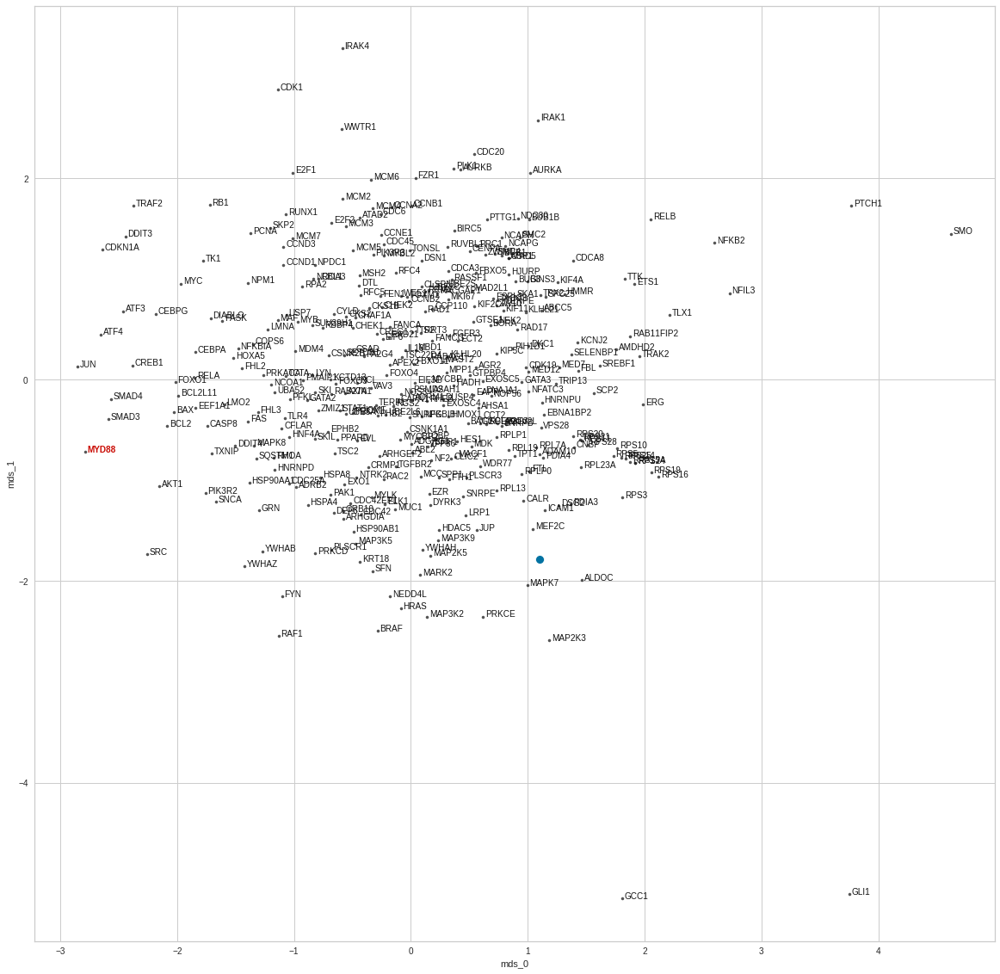

PIK3R2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0019496057427966513
train top-k accuracies: {1: 0.459459, 3: 0.621622, 5: 0.675676, 10: 0.756757, 20: 0.891892, 50: 0.918919}
train mean top-k accuracies: {1: 0.459459, 3: 0.621622, 5: 0.675676, 10: 0.756757, 20: 0.891892, 50: 0.918919}
test loss: 0.0021288730204105377
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


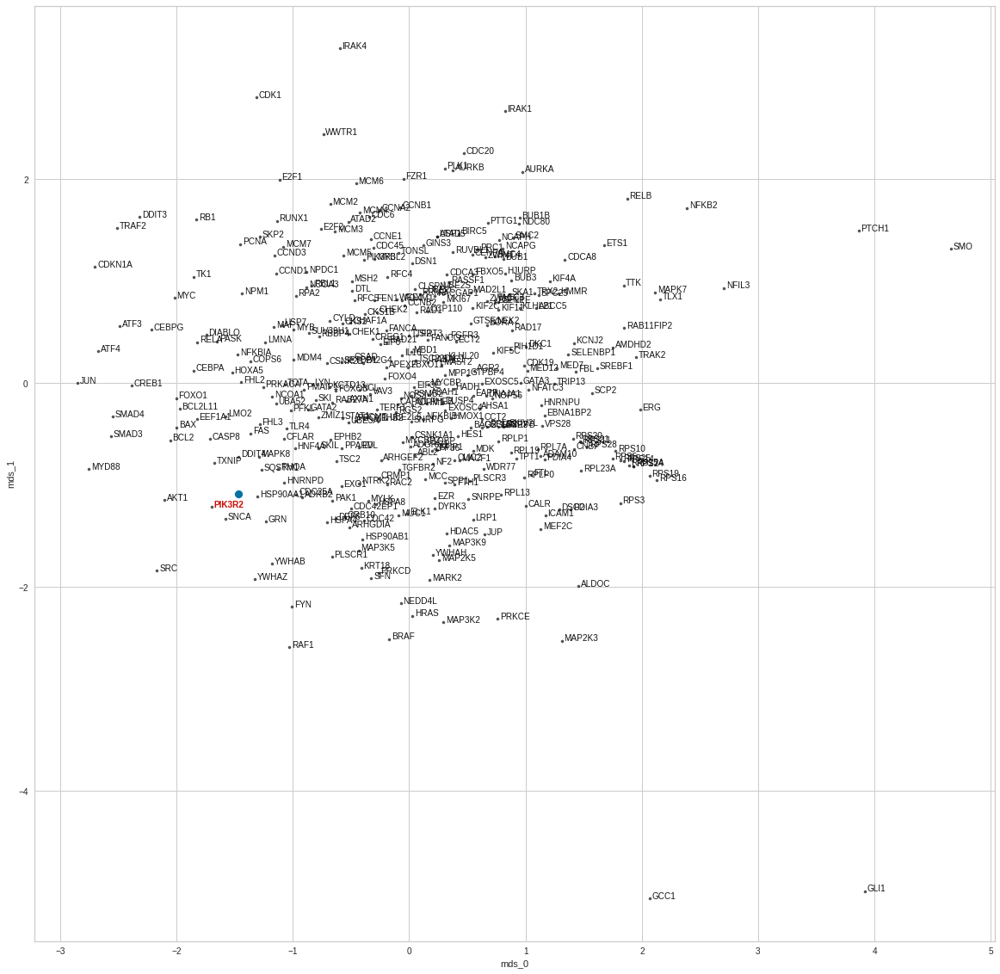

PRKACA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001880484862832
train top-k accuracies: {1: 0.459459, 3: 0.648649, 5: 0.702703, 10: 0.756757, 20: 0.783784, 50: 0.864865}
train mean top-k accuracies: {1: 0.459459, 3: 0.648649, 5: 0.702703, 10: 0.756757, 20: 0.783784, 50: 0.864865}
test loss: 0.01499839685857296
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


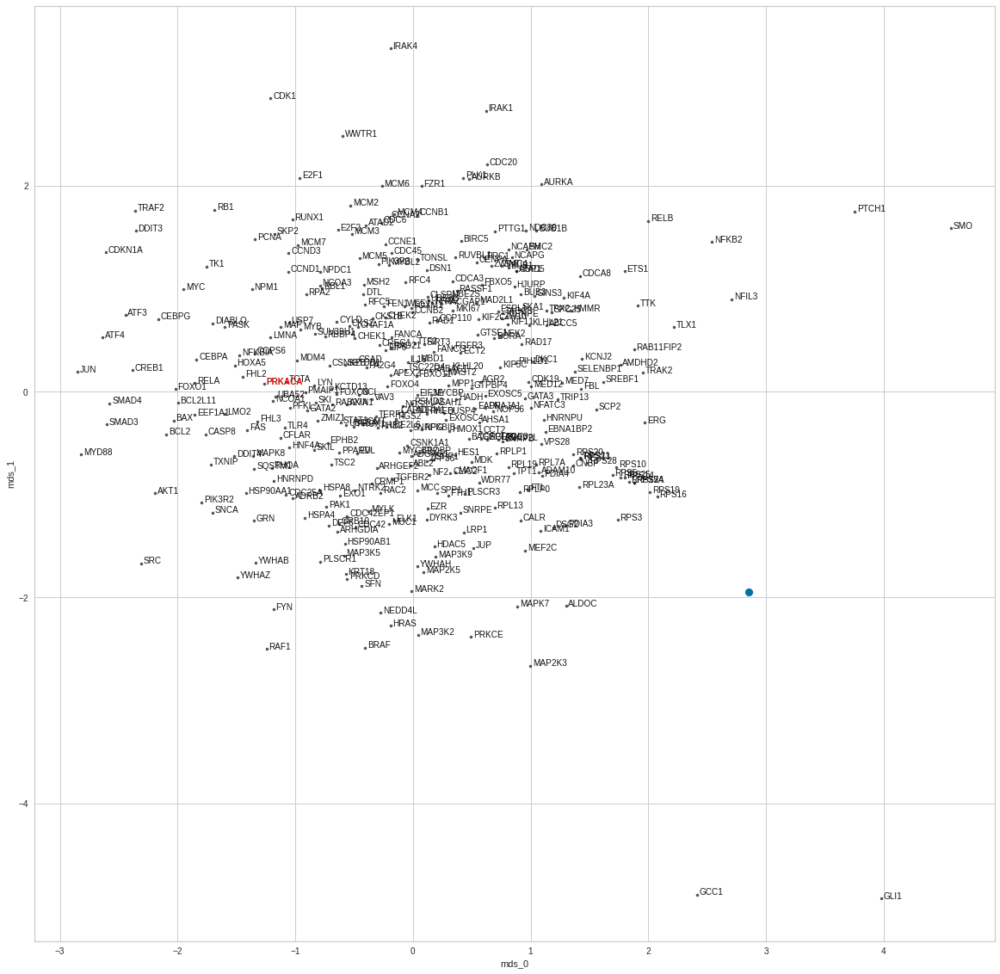

PRKCE
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0025435276895862174
train top-k accuracies: {1: 0.432432, 3: 0.648649, 5: 0.702703, 10: 0.756757, 20: 0.756757, 50: 0.810811}
train mean top-k accuracies: {1: 0.432432, 3: 0.648649, 5: 0.702703, 10: 0.756757, 20: 0.756757, 50: 0.810811}
test loss: 0.007983634248375893
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


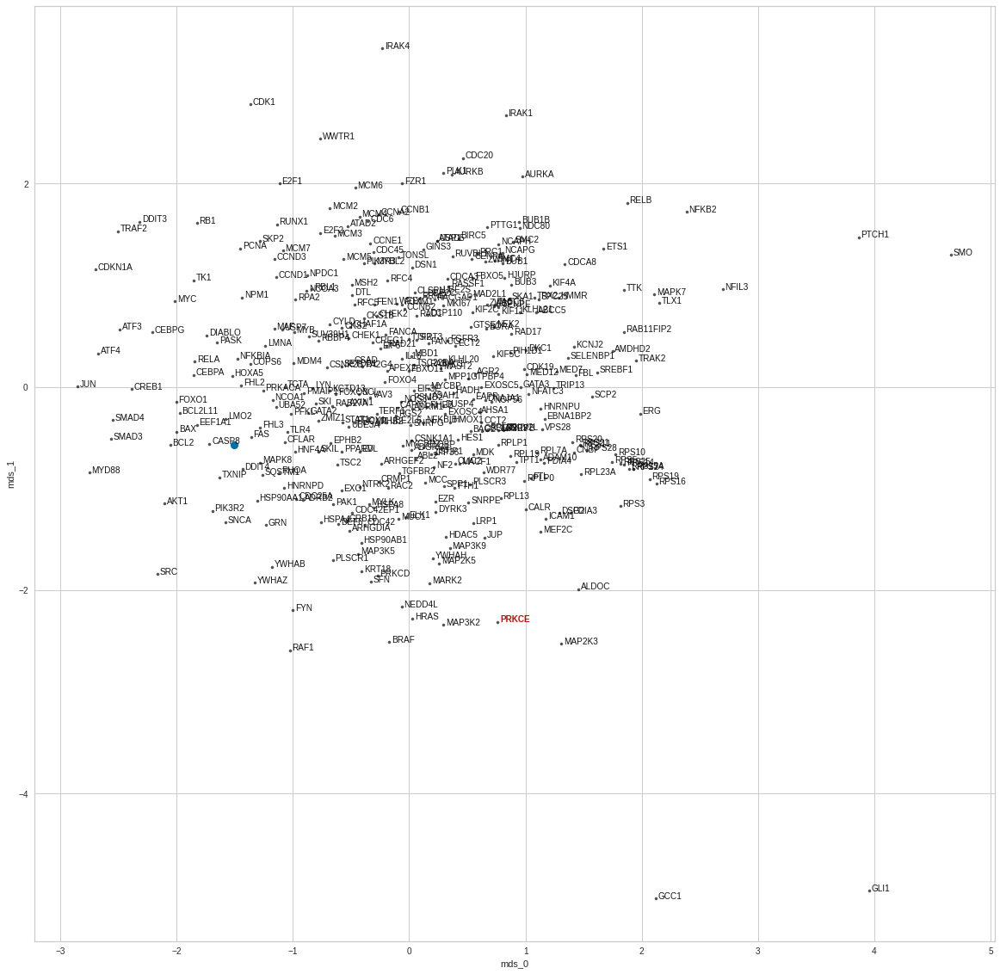

RAF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001807110258252234
train top-k accuracies: {1: 0.486486, 3: 0.675676, 5: 0.783784, 10: 0.837838, 20: 0.864865, 50: 0.945946}
train mean top-k accuracies: {1: 0.486486, 3: 0.675676, 5: 0.783784, 10: 0.837838, 20: 0.864865, 50: 0.945946}
test loss: 0.003581658471375704
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


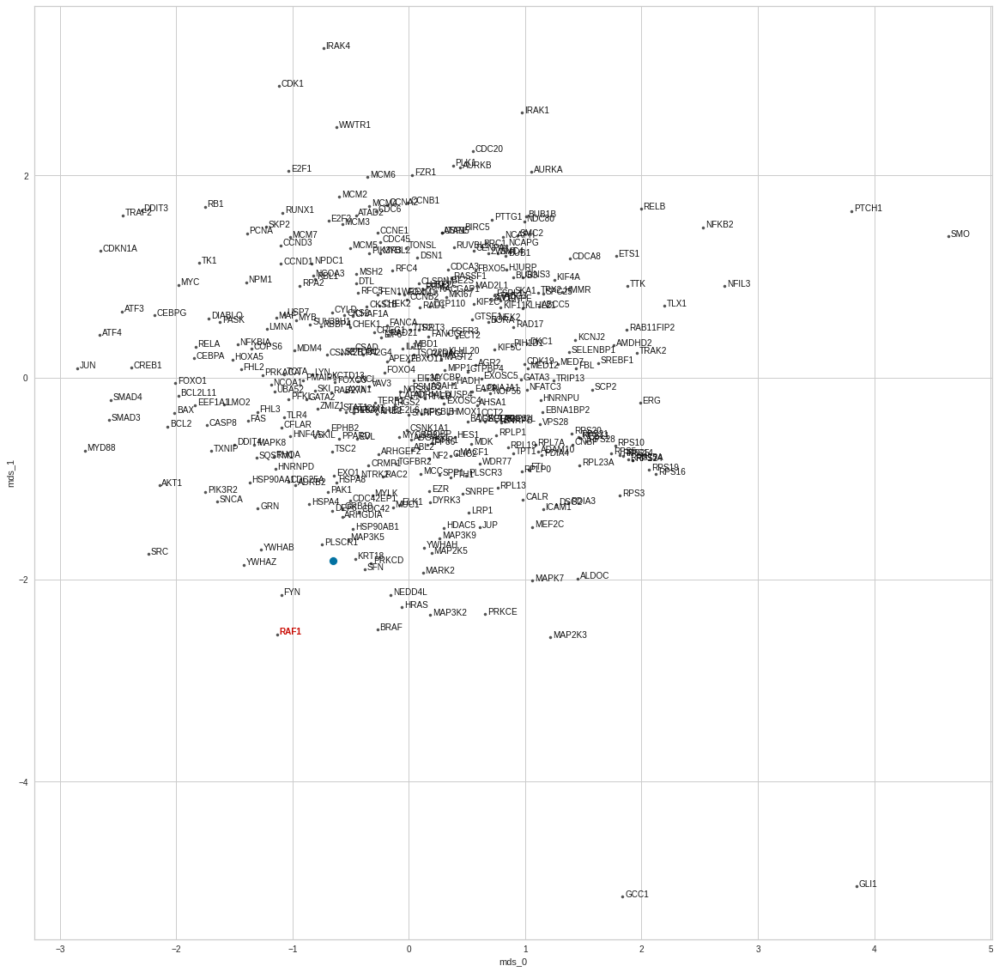

RELB
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002060850824204248
train top-k accuracies: {1: 0.513514, 3: 0.702703, 5: 0.837838, 10: 0.837838, 20: 0.864865, 50: 0.891892}
train mean top-k accuracies: {1: 0.513514, 3: 0.702703, 5: 0.837838, 10: 0.837838, 20: 0.864865, 50: 0.891892}
test loss: 0.012571770697832108
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


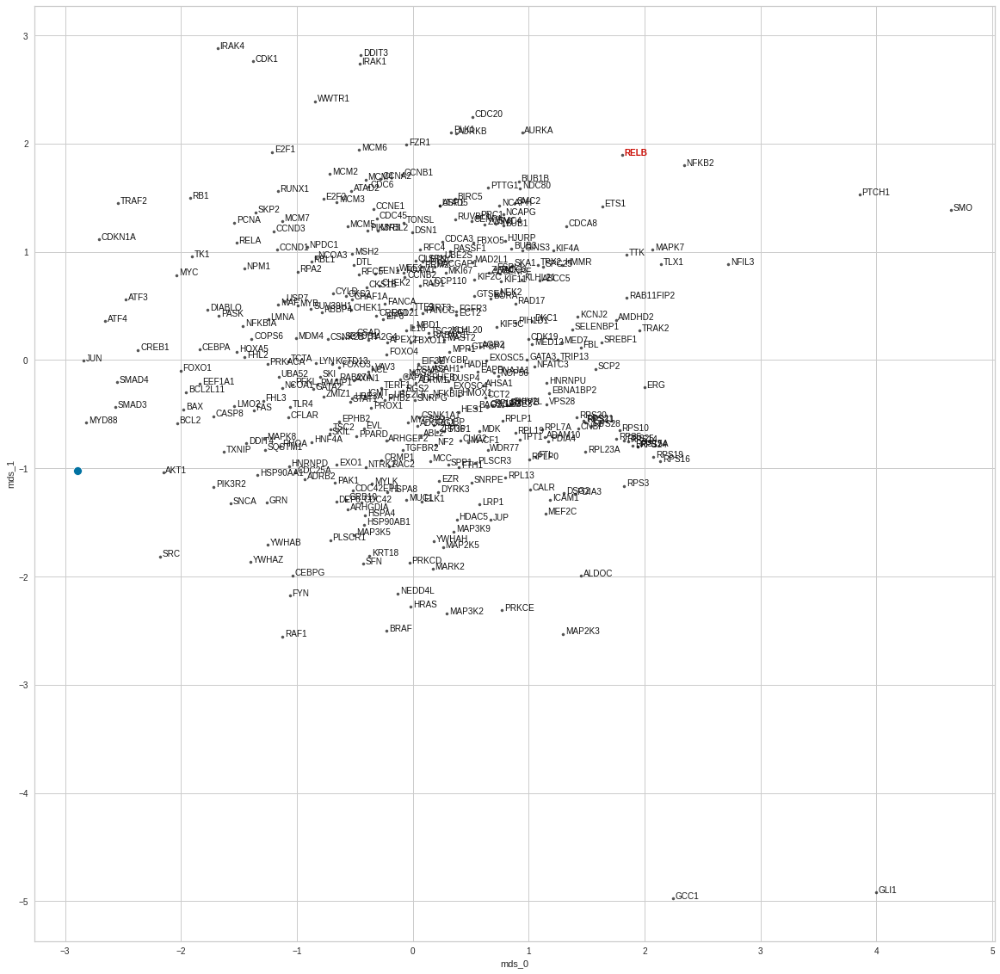

RHOA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0020629214028500624
train top-k accuracies: {1: 0.567568, 3: 0.702703, 5: 0.72973, 10: 0.810811, 20: 0.837838, 50: 0.918919}
train mean top-k accuracies: {1: 0.567568, 3: 0.702703, 5: 0.72973, 10: 0.810811, 20: 0.837838, 50: 0.918919}
test loss: 0.0033154599368572235
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


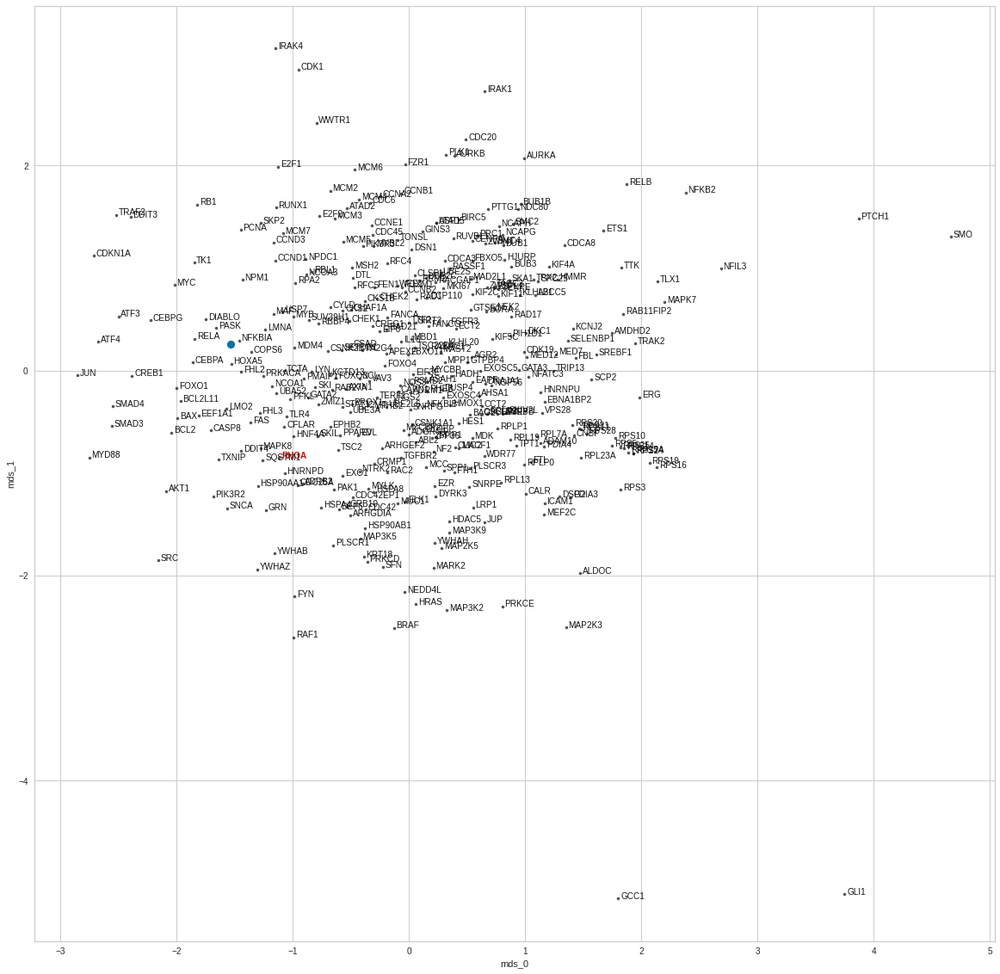

SMAD4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002561027297397723
train top-k accuracies: {1: 0.459459, 3: 0.540541, 5: 0.621622, 10: 0.675676, 20: 0.702703, 50: 0.810811}
train mean top-k accuracies: {1: 0.459459, 3: 0.540541, 5: 0.621622, 10: 0.675676, 20: 0.702703, 50: 0.810811}
test loss: 0.0057805385440588
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


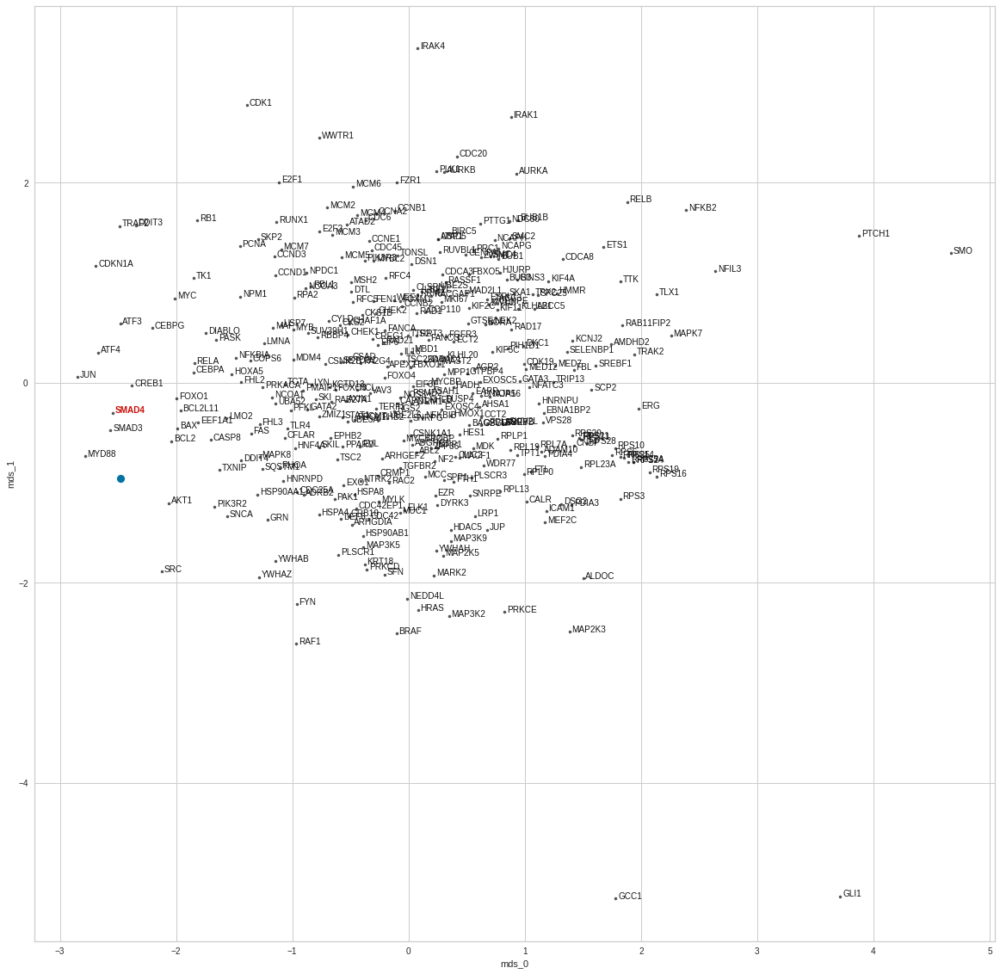

SMO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.001901205427743293
train top-k accuracies: {1: 0.567568, 3: 0.72973, 5: 0.783784, 10: 0.864865, 20: 0.918919, 50: 0.945946}
train mean top-k accuracies: {1: 0.567568, 3: 0.72973, 5: 0.783784, 10: 0.864865, 20: 0.918919, 50: 0.945946}
test loss: 0.02785668522119522
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


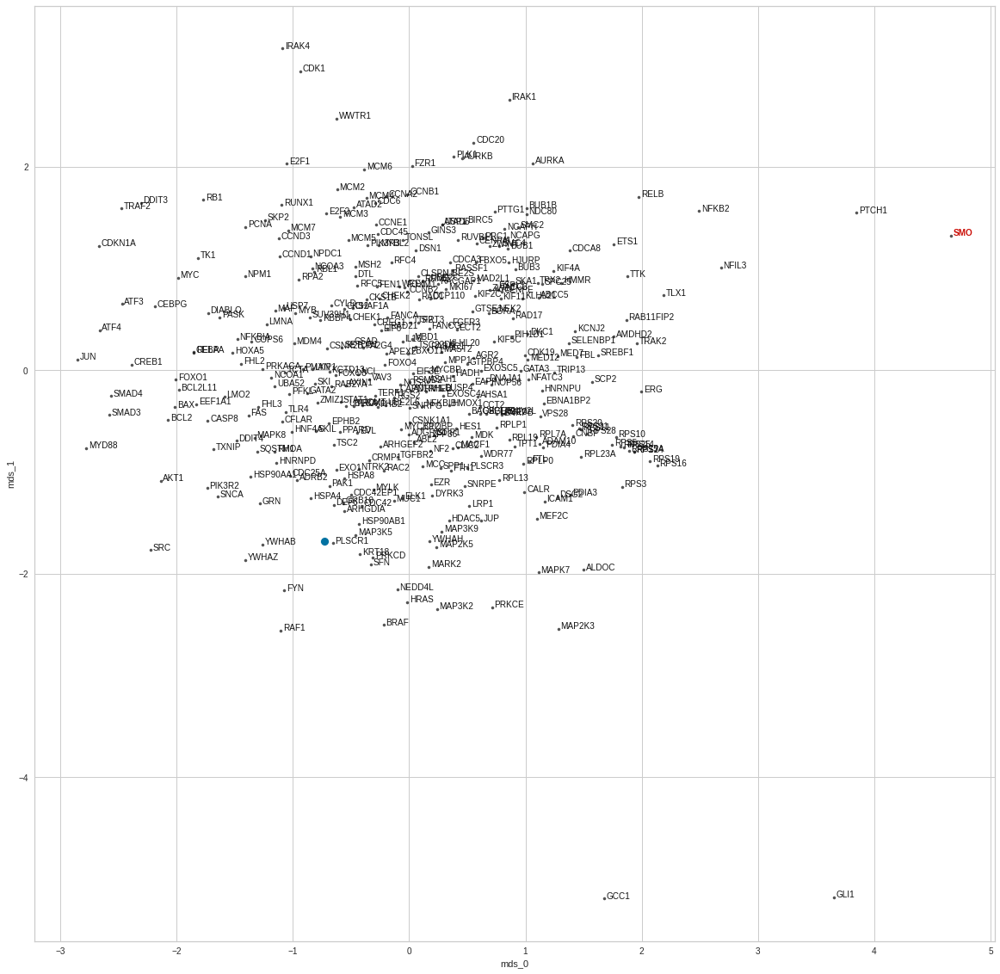

SRC
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0018879293221854478
train top-k accuracies: {1: 0.459459, 3: 0.648649, 5: 0.72973, 10: 0.837838, 20: 0.864865, 50: 0.918919}
train mean top-k accuracies: {1: 0.459459, 3: 0.648649, 5: 0.72973, 10: 0.837838, 20: 0.864865, 50: 0.918919}
test loss: 0.005253855604678392
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


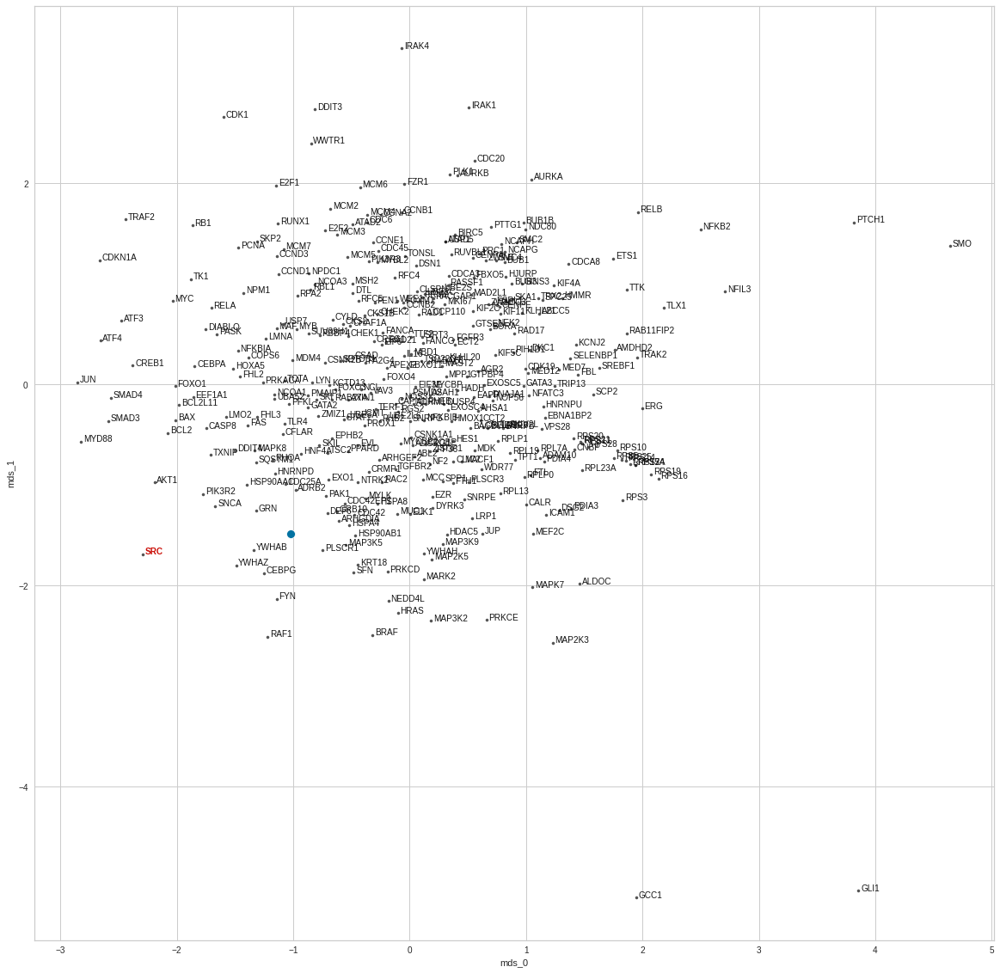

SREBF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0020270680857671273
train top-k accuracies: {1: 0.567568, 3: 0.783784, 5: 0.810811, 10: 0.837838, 20: 0.891892, 50: 0.918919}
train mean top-k accuracies: {1: 0.567568, 3: 0.783784, 5: 0.810811, 10: 0.837838, 20: 0.891892, 50: 0.918919}
test loss: 0.00314340996555984
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


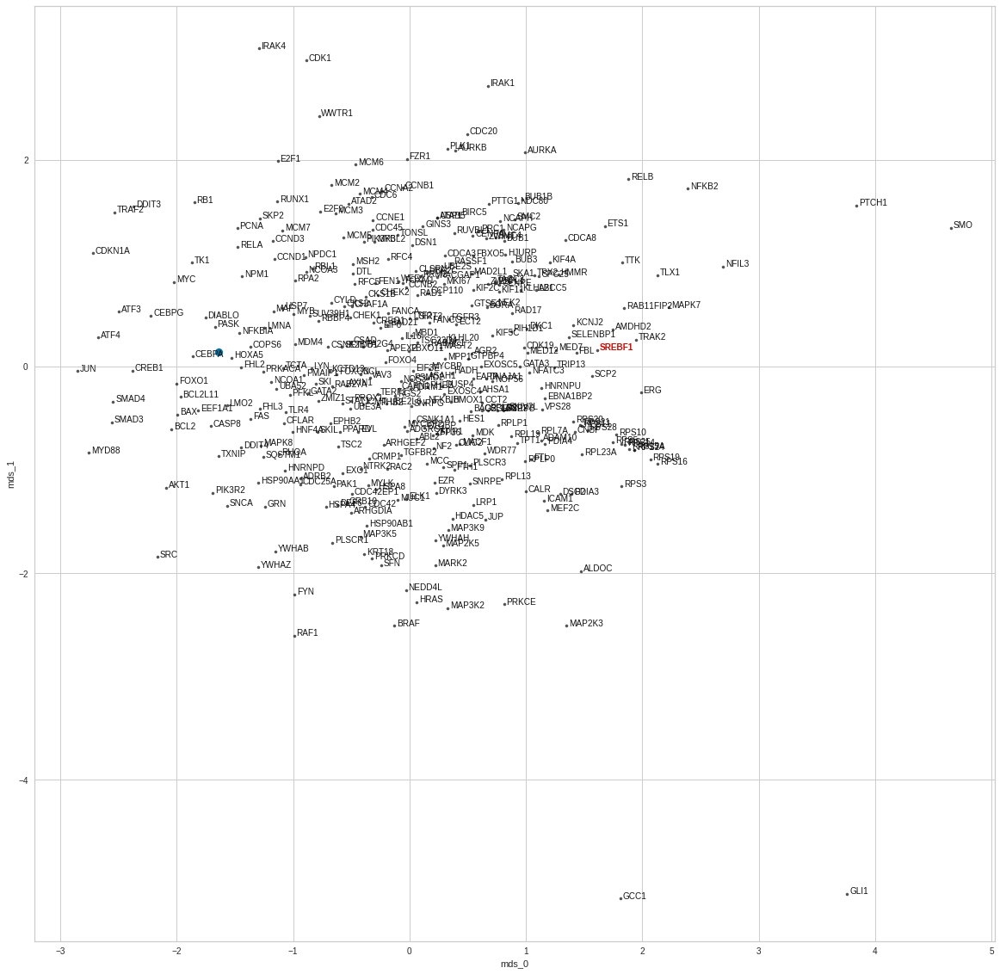

TRAF2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0017639501366411914
train top-k accuracies: {1: 0.486486, 3: 0.675676, 5: 0.72973, 10: 0.810811, 20: 0.864865, 50: 0.945946}
train mean top-k accuracies: {1: 0.486486, 3: 0.675676, 5: 0.72973, 10: 0.810811, 20: 0.864865, 50: 0.945946}
test loss: 0.007040735799819231
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


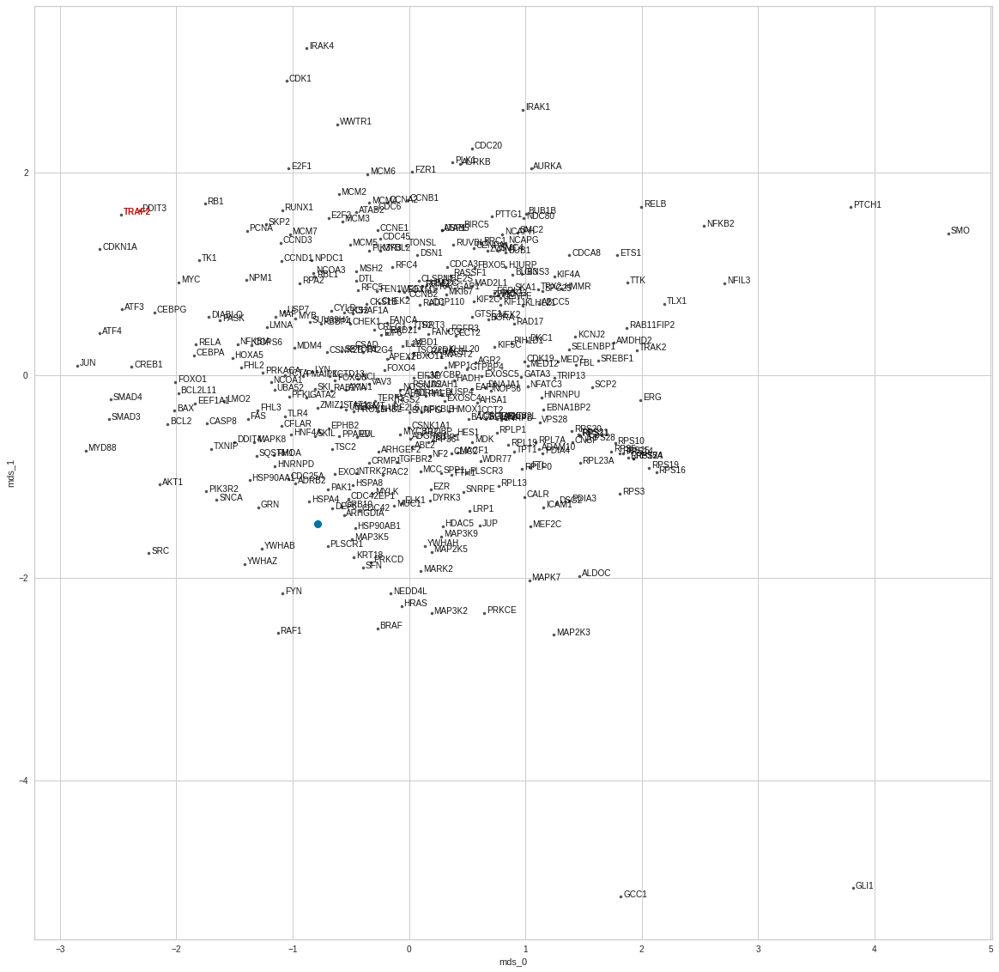

TSC2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.0021837125280620277
train top-k accuracies: {1: 0.540541, 3: 0.72973, 5: 0.783784, 10: 0.810811, 20: 0.864865, 50: 0.918919}
train mean top-k accuracies: {1: 0.540541, 3: 0.72973, 5: 0.783784, 10: 0.810811, 20: 0.864865, 50: 0.918919}
test loss: 0.01142929494380951
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


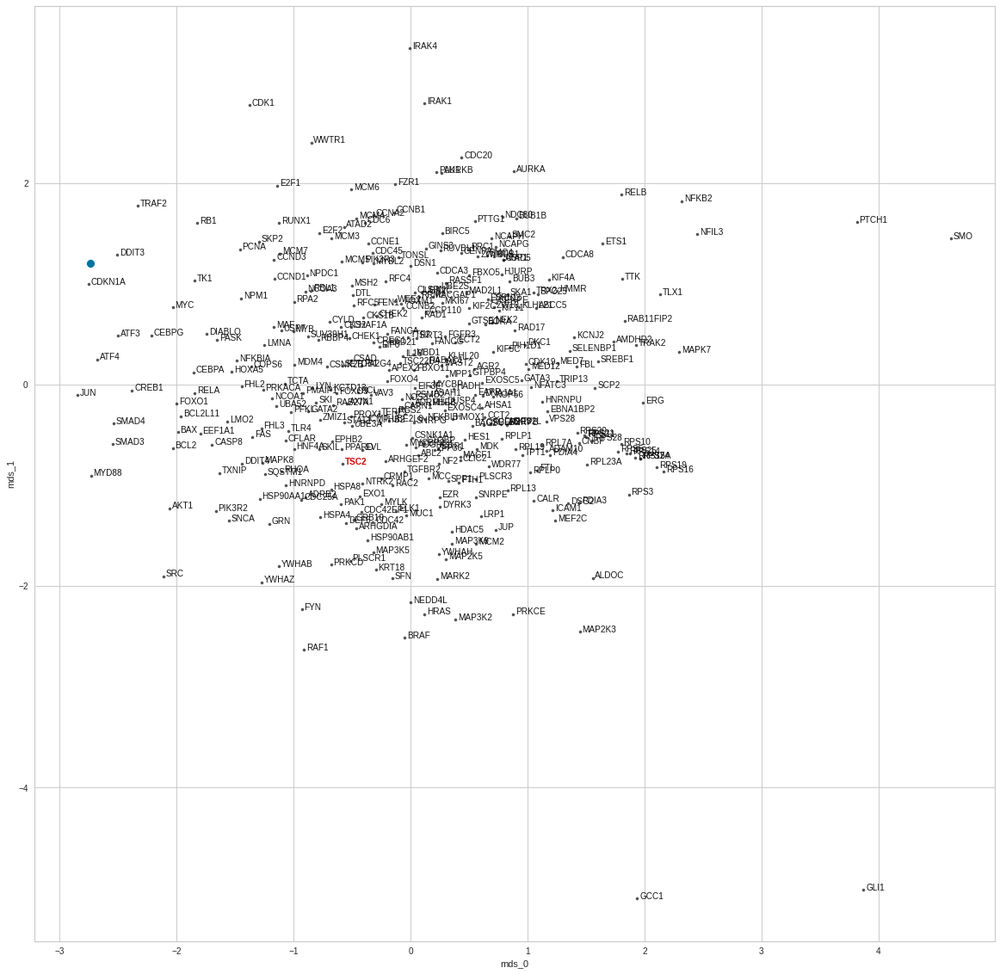

WWTR1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 0.002457791505180098
train top-k accuracies: {1: 0.378378, 3: 0.648649, 5: 0.72973, 10: 0.783784, 20: 0.837838, 50: 0.864865}
train mean top-k accuracies: {1: 0.378378, 3: 0.648649, 5: 0.72973, 10: 0.783784, 20: 0.837838, 50: 0.864865}
test loss: 0.01444319635629654
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


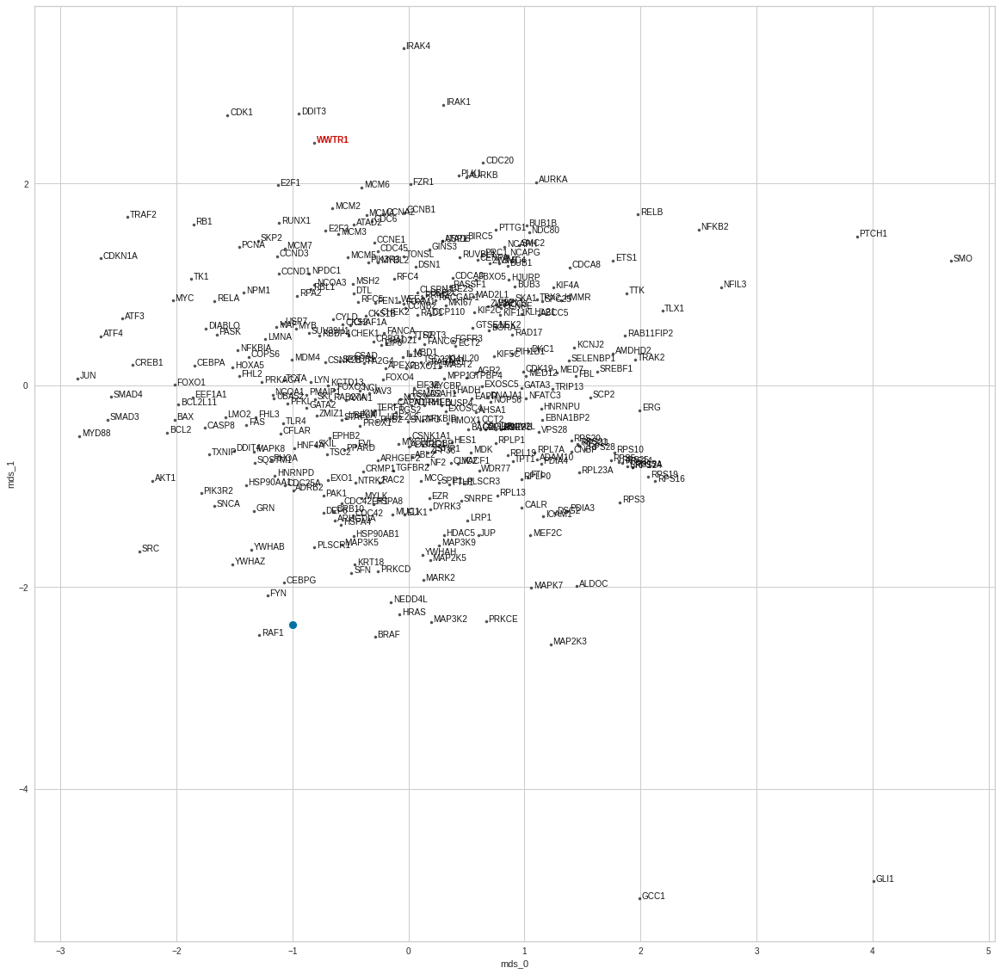

<IPython.core.display.Javascript object>

In [21]:
target_topk_accs = {}
mean_lin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=5e-3, weight_decay=1e-5)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=500,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
        use_val_data=False,
    )
    target_topk_accs[target] = topk_acc
    mean_lin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [22]:
mean_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_lin_topk_df.loc[mean_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
ATF4,0.0,1.0,1.0,1.0,1.0,1.0
CEBPA,0.0,0.0,1.0,1.0,1.0,1.0
CASP8,0.0,0.0,0.0,1.0,1.0,1.0
HRAS,0.0,0.0,0.0,1.0,1.0,1.0
MAP3K2,0.0,0.0,0.0,1.0,1.0,1.0
BCL2L11,0.0,0.0,0.0,0.0,1.0,1.0
CDC42,0.0,0.0,0.0,0.0,1.0,1.0
PIK3R2,0.0,0.0,0.0,0.0,1.0,1.0
FOXO1,0.0,0.0,0.0,0.0,0.0,1.0
MAP2K3,0.0,0.0,0.0,0.0,0.0,1.0


<IPython.core.display.Javascript object>

In [23]:
mean_lin_topk_df.describe()

,1,3,5,10,20,50
count,38.0,38.000000,38.000000,38.000000,38.000000,38.000000
mean,0.0,0.026316,0.052632,0.131579,0.210526,0.289474
std,0.0,0.162221,0.226294,0.342570,0.413155,0.459606
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.0,0.000000,0.000000,0.000000,0.000000,1.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

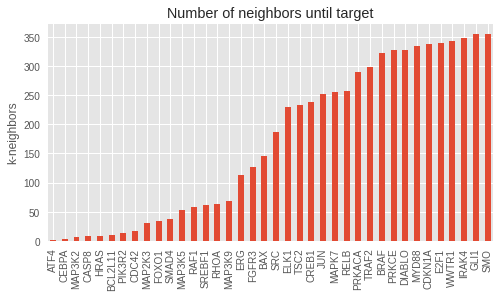

<IPython.core.display.Javascript object>

In [24]:
mpl.style.use("ggplot")
mean_lin_khits = get_knn_hit_data(mean_lin_nns)
ax = mean_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [25]:
mean_5nn_dict = get_mean_knn_dict(img_embs_fold0, k=10)
mean_5nn_dict["JUN"]

['CEBPA',
 'ERG',
 'E2F1',
 'FGFR3',
 'ELK1',
 'PRKACA',
 'RAF1',
 'BRAF',
 'CDC42',
 'SRC']

<IPython.core.display.Javascript object>

In [26]:
mean_5nn_dict = get_mean_knn_dict(node_embs, k=10)
mean_5nn_dict["JUN"]

['ATF3',
 'CEBPA',
 'CEBPG',
 'LMO2',
 'BCL2',
 'BCL2L11',
 'BAX',
 'MAPK8',
 'DDIT3',
 'ERG']

<IPython.core.display.Javascript object>

In [27]:
from scipy.spatial.distance import squareform, pdist

node_embs_dist = pd.DataFrame(
    squareform(pdist(node_embs)), index=node_embs.index, columns=node_embs.index
)

<IPython.core.display.Javascript object>

In [28]:
node_embs_dist.loc[
    ["JUN", "CEBPA", "ERG", "BRAF", "RAF1", "HRAS", "MAP3K5"],
    ["JUN", "CEBPA", "ERG", "BRAF", "RAF1", "HRAS", "MAP3K5"],
]

,JUN,CEBPA,ERG,BRAF,RAF1,HRAS,MAP3K5
JUN,0.000000,1.103902,1.944232,4.099590,3.996823,4.141320,3.298800
CEBPA,1.103902,0.000000,1.515159,3.502854,3.478069,3.491712,2.563440
ERG,1.944232,1.515159,0.000000,3.496476,3.619141,3.474537,2.798480
BRAF,4.099590,3.502854,3.496476,0.000000,1.074707,0.728249,1.450371
RAF1,3.996823,3.478069,3.619141,1.074707,0.000000,1.288182,1.650060
HRAS,4.141320,3.491712,3.474537,0.728249,1.288182,0.000000,1.593595
MAP3K5,3.298800,2.563440,2.798480,1.450371,1.650060,1.593595,0.000000


<IPython.core.display.Javascript object>

In [29]:
mean_lin_nns["JUN"][:20]

array(['YWHAB', 'RAF1', 'YWHAZ', 'MAP3K5', 'CDC25A', 'SFN', 'BRAF',
       'MAP3K2', 'HSP90AB1', 'YWHAH', 'EXO1', 'MDM4', 'ARHGDIA', 'TSC2',
       'NEDD4L', 'MAPK8', 'HRAS', 'SQSTM1', 'CDC42', 'MYCBP2'],
      dtype='<U9')

<IPython.core.display.Javascript object>

In [30]:
mean_lin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
mean_lin_nn_topk = get_topk_acc_from_nn_dict(mean_lin_nns, ks=ks)
mean_lin_result = mean_lin_nn_topk.mean()
for k in ks:
    mean_lin_results["topk_acc"].append(mean_lin_result.loc["top-{}".format(k)])
    mean_lin_results["k"].append(k)
mean_lin_results = pd.DataFrame(mean_lin_results)

<IPython.core.display.Javascript object>

---

### 2.3. Nonlinear mean prediction

We do apply the same scheme using a simple 3-layer nonlinear network.

  0%|          | 0/38 [00:00<?, ?it/s]

ATF4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 7.253304534675113e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0034931411501020193
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


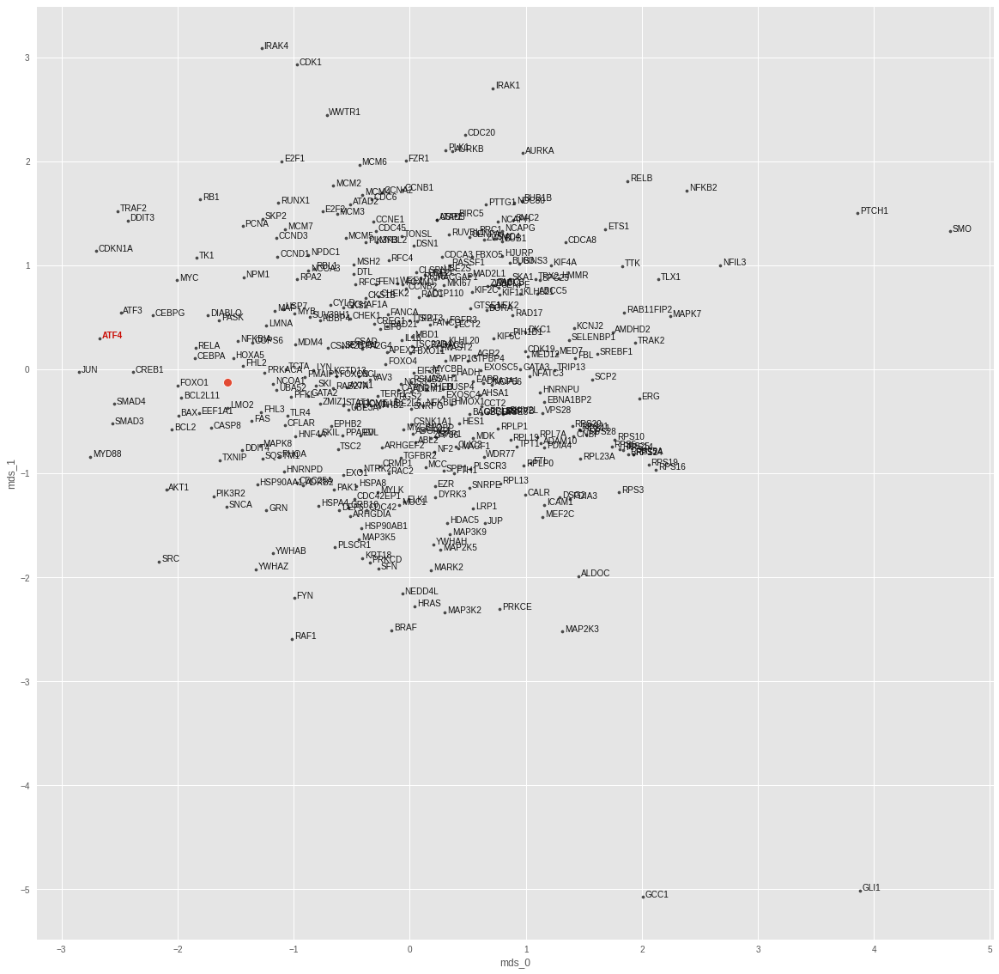

BAX
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.0556570129340036e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005203068722039461
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


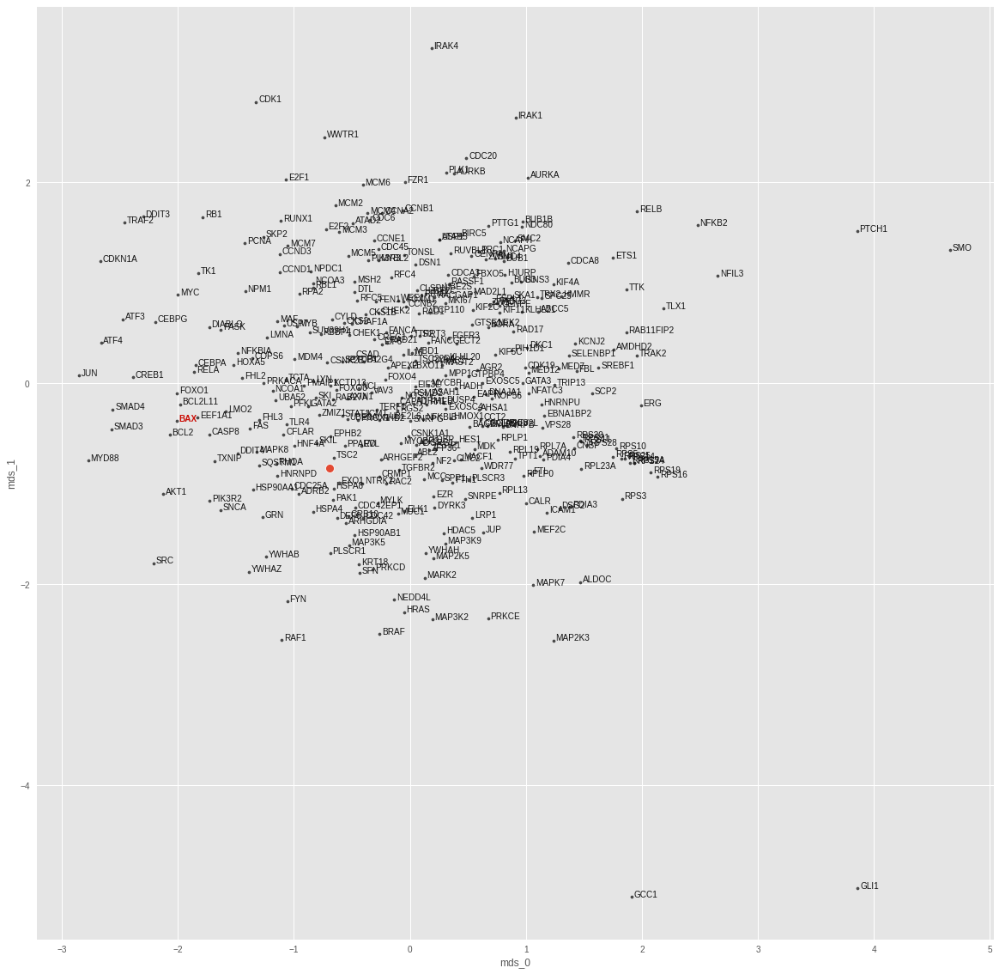

BCL2L11
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.5133854767380006e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.001061533810570836
test top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


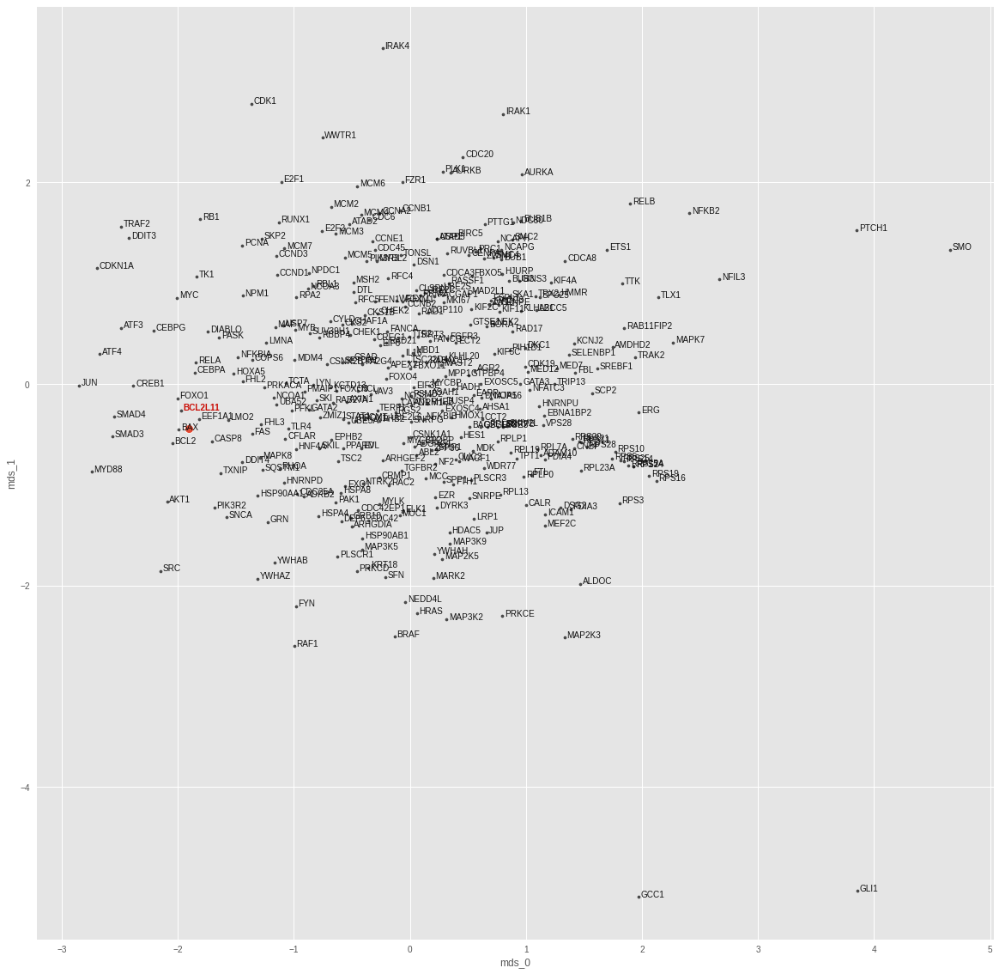

BRAF
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 8.655768913347463e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003157729748636484
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


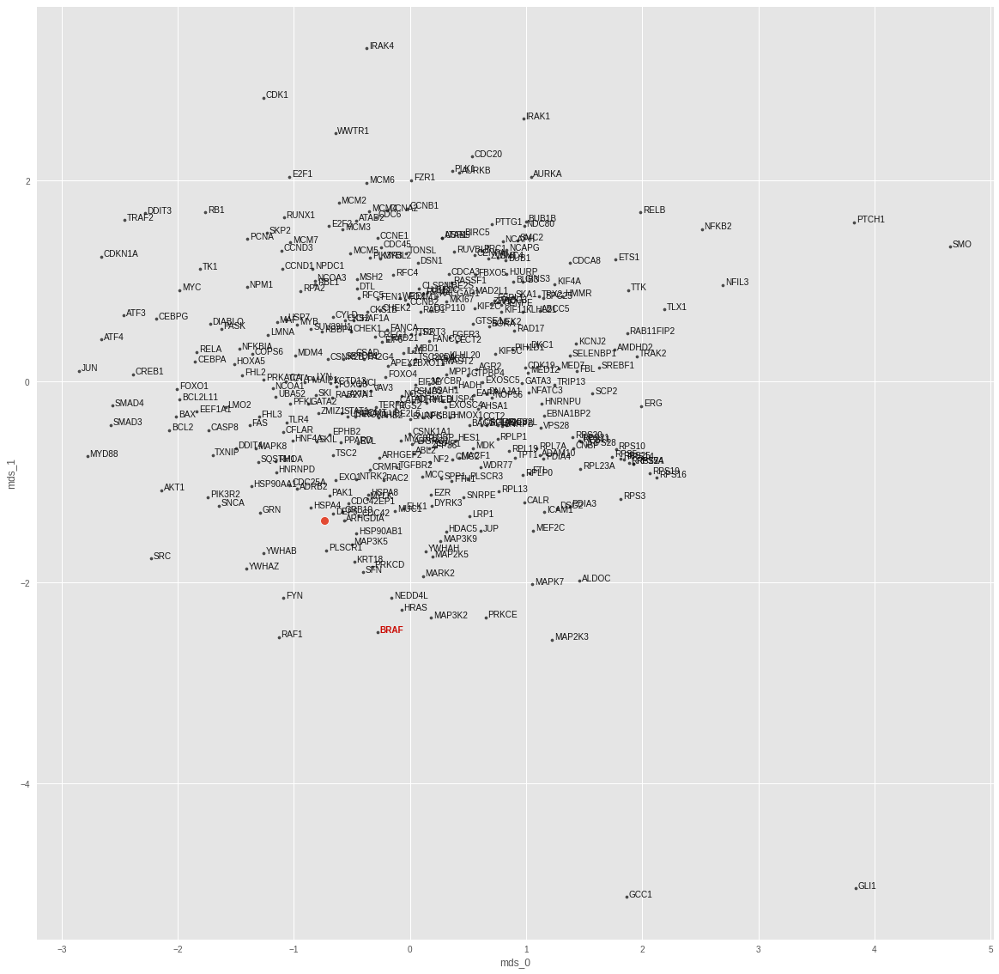

CASP8
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 6.136378844432231e-05
train top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0019107575062662363
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


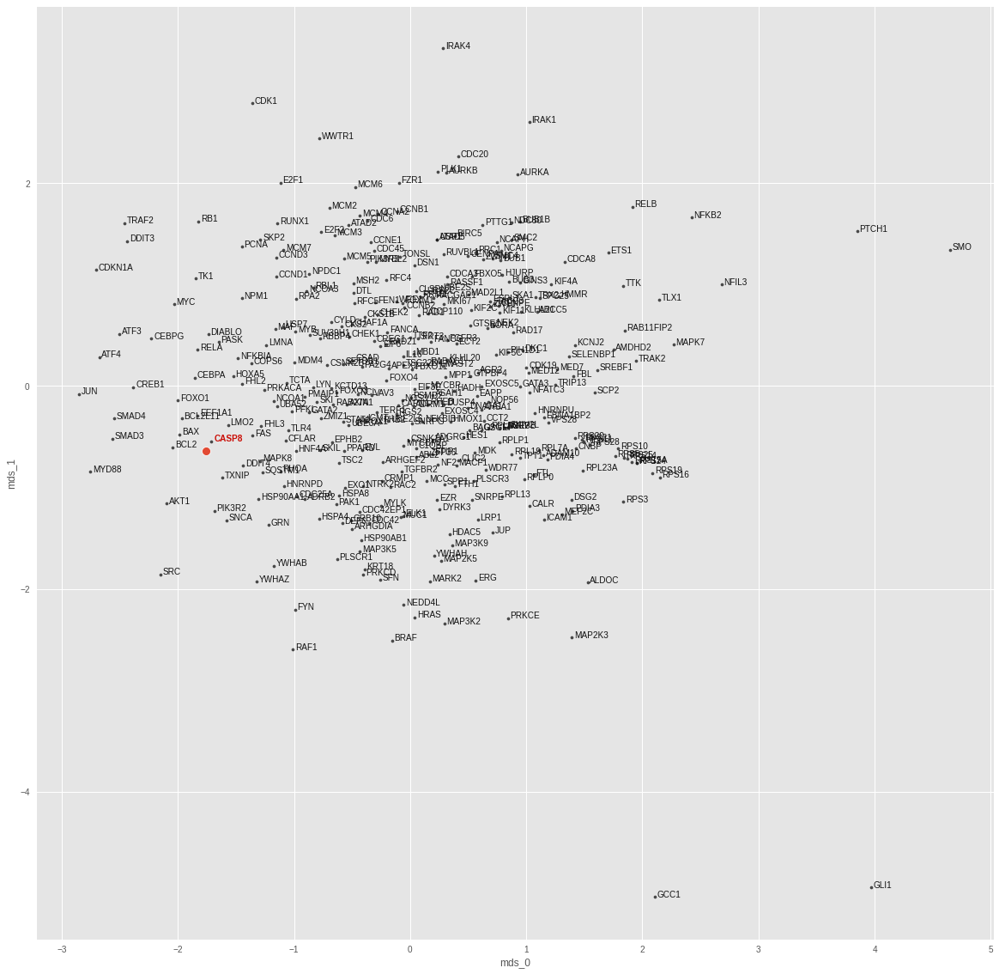

CDC42
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.1728367288675588e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013443632051348686
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


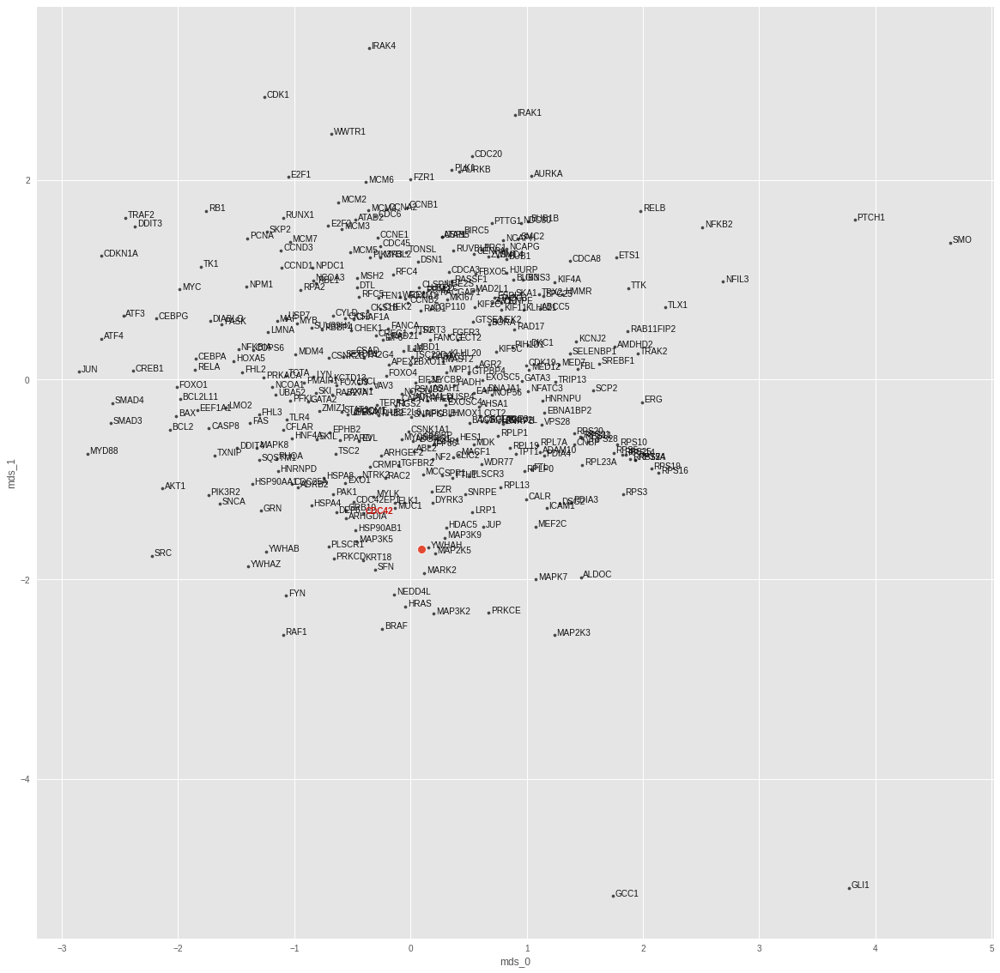

CDKN1A
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.8496162000873654e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007252377457916737
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


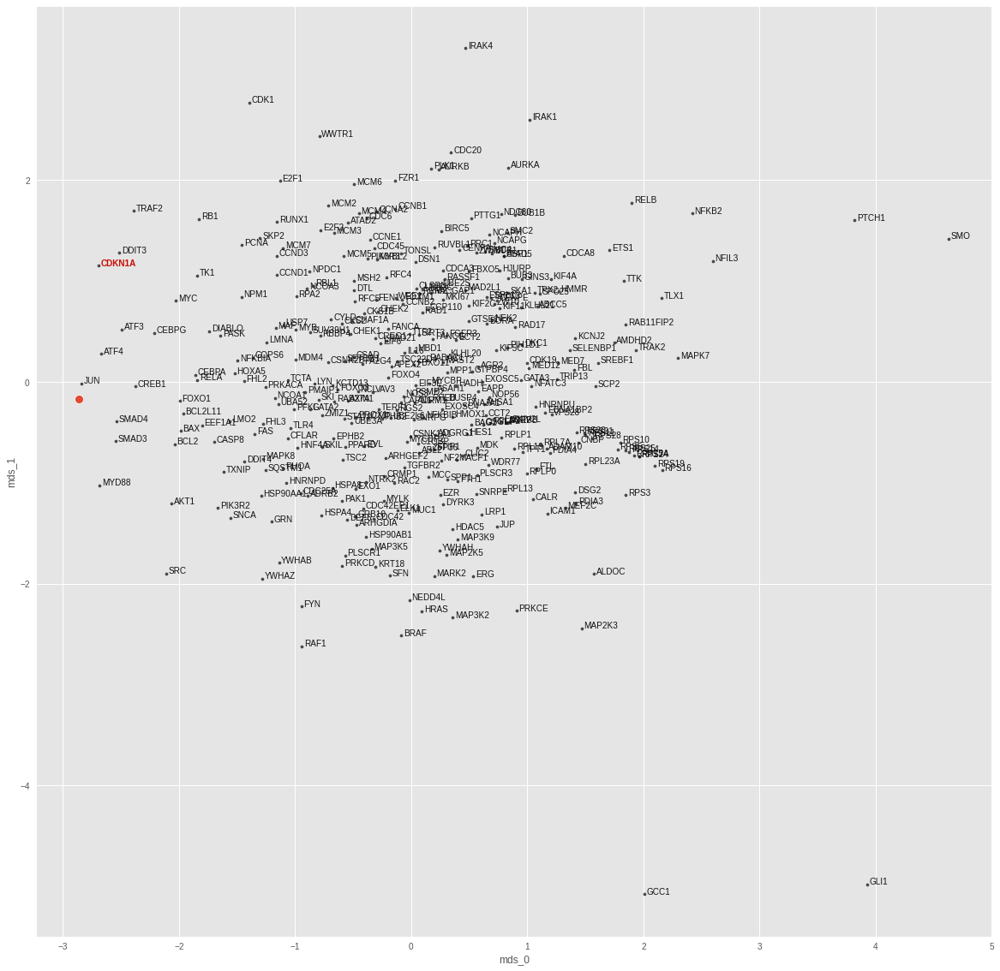

CEBPA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 5.252995084152349e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004117200151085854
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


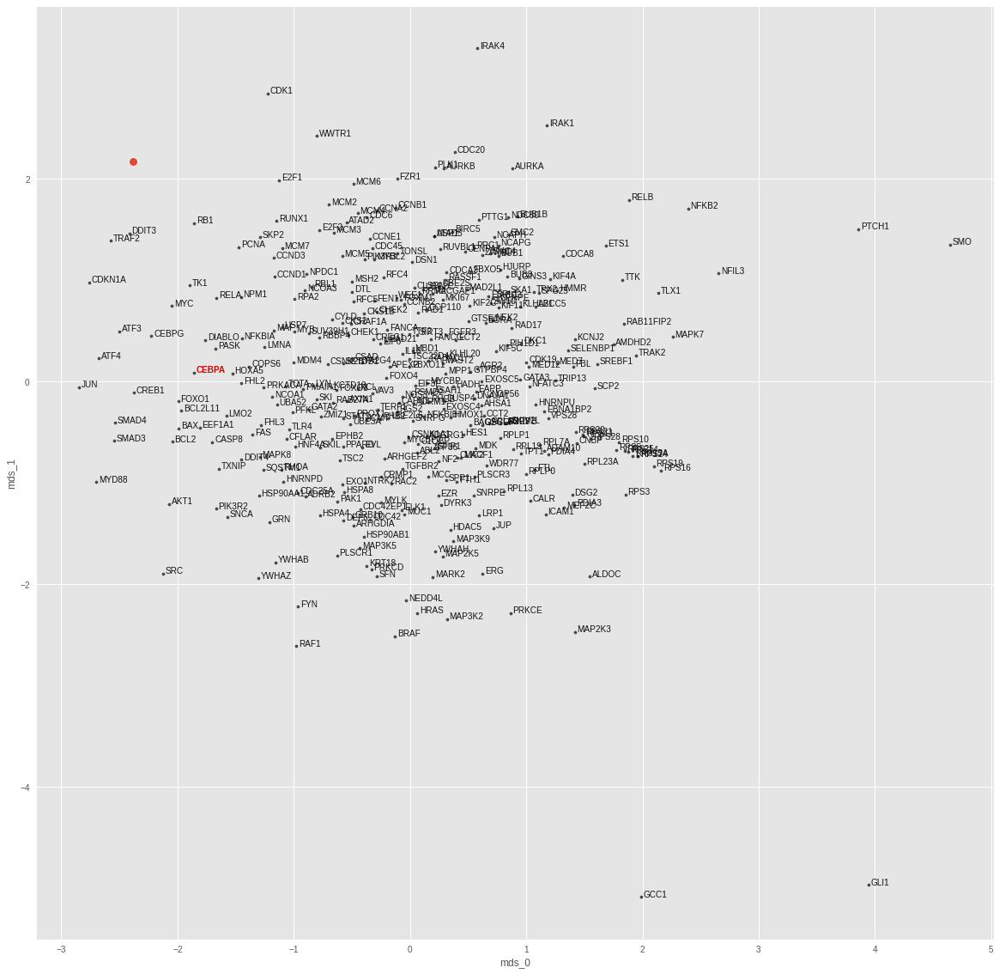

CREB1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.3618816625015383e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0026154627557843924
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


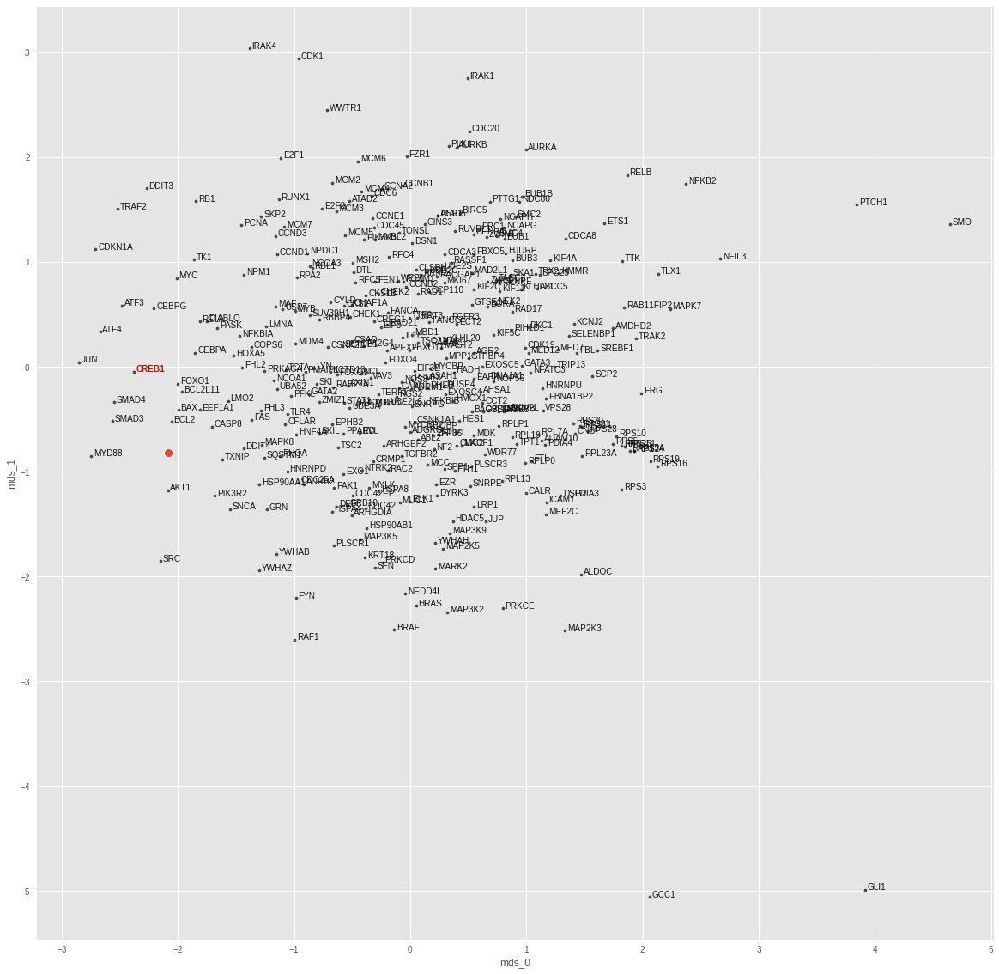

DIABLO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 9.802493976265495e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006439593154937029
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


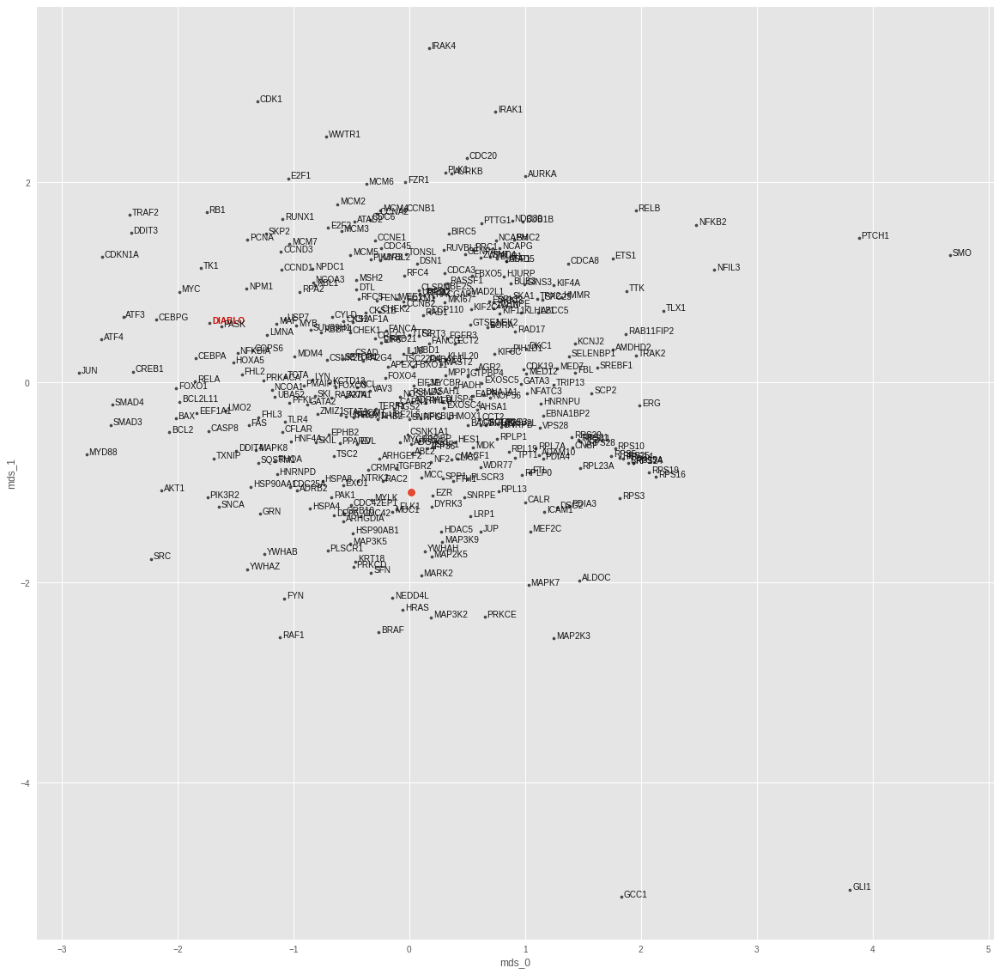

E2F1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.37208928465623e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.01193944551050663
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


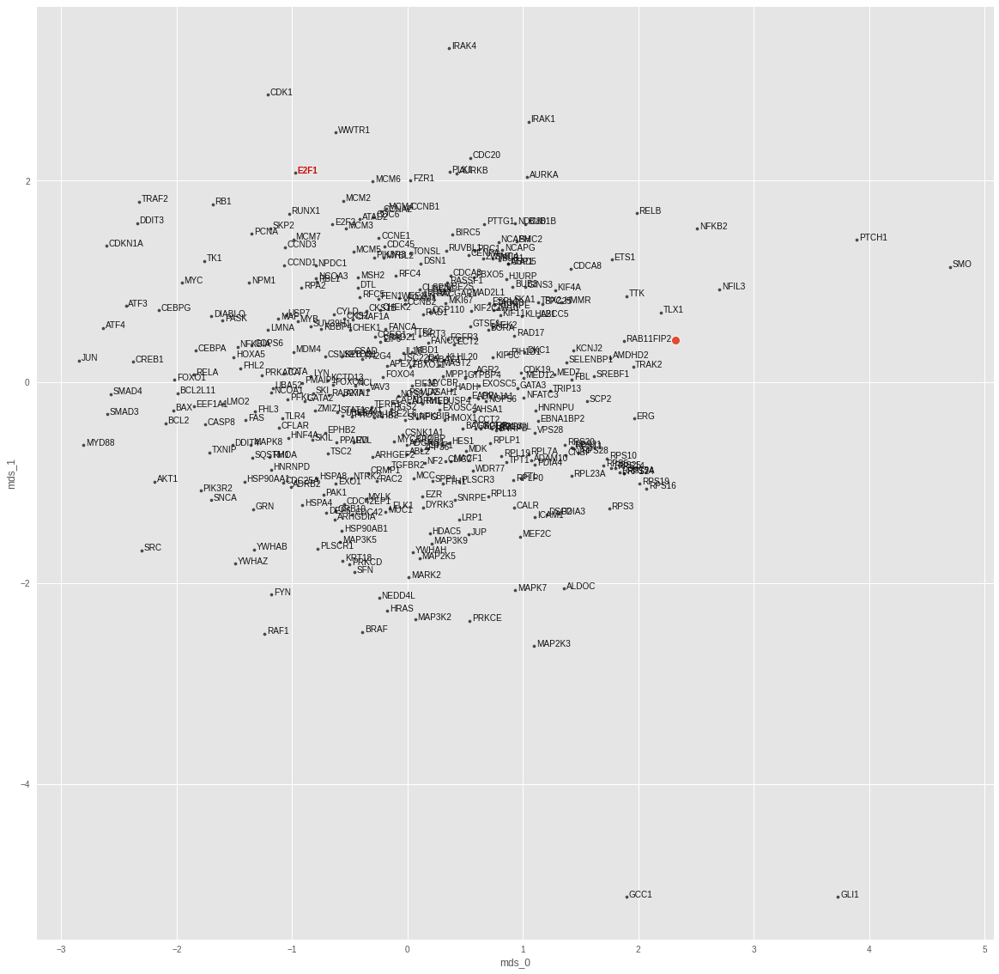

ELK1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.8729491637566605e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0036294059827923775
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


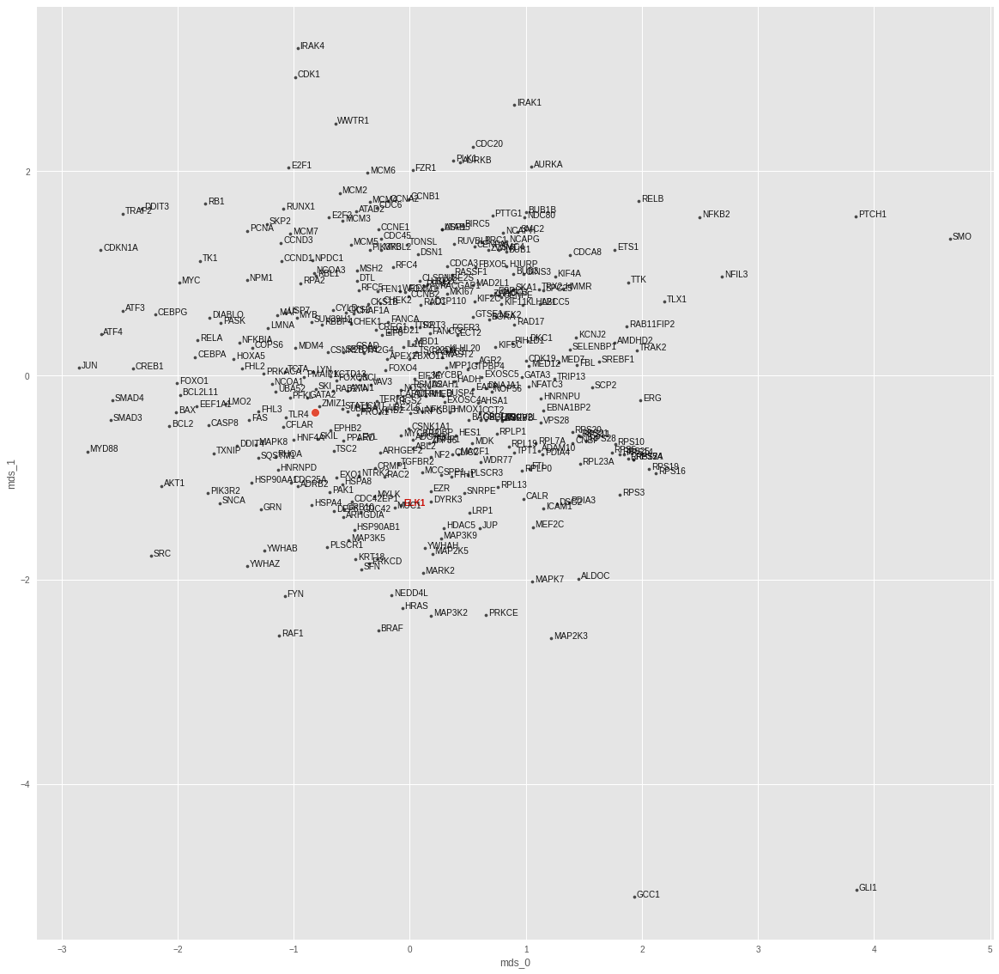

ERG
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.8600374267718165e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0034365421161055565
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


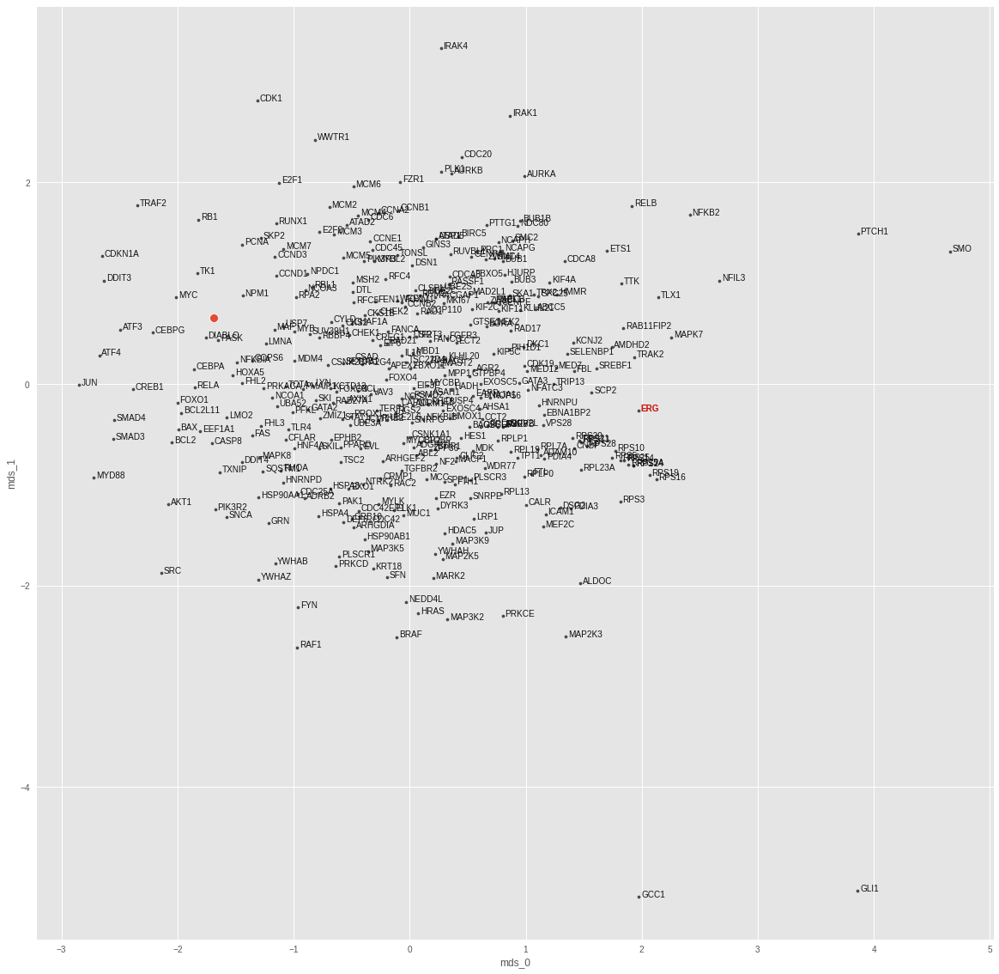

FGFR3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.9184932416710826e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003488540416583419
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


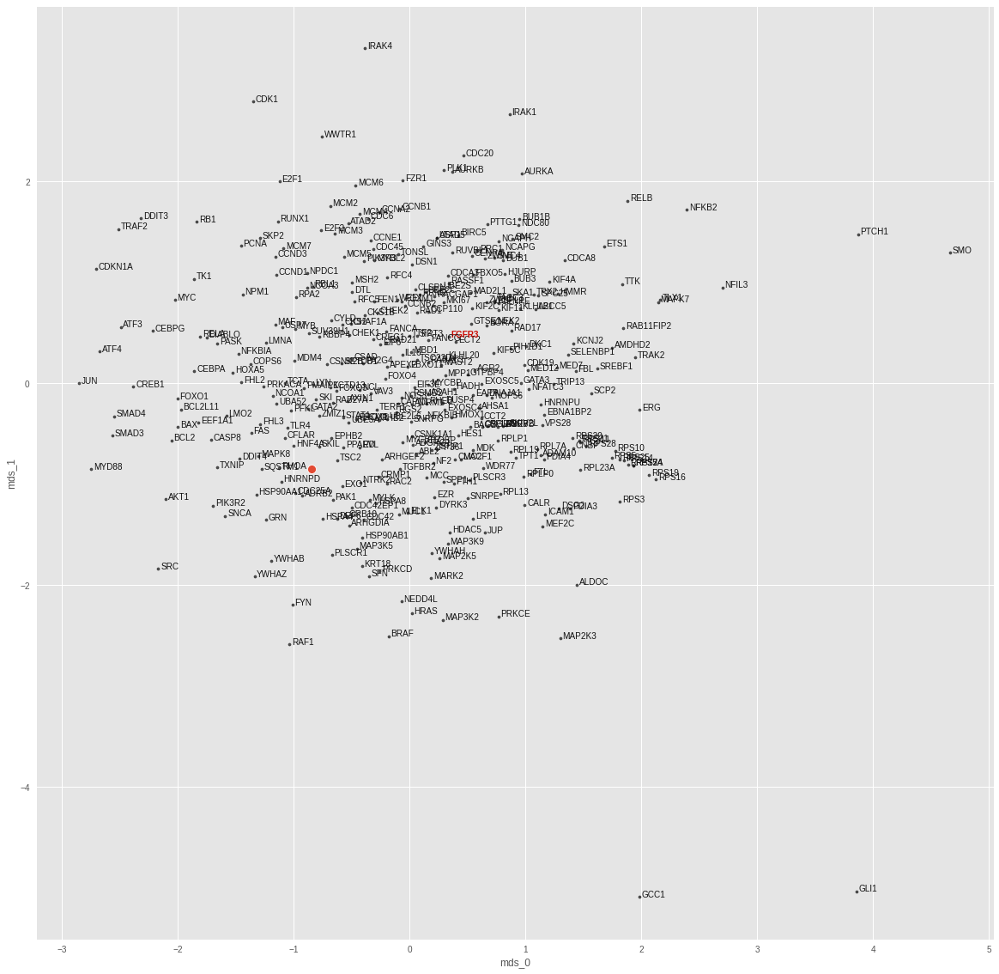

FOXO1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.593842645544666e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005783396307379007
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


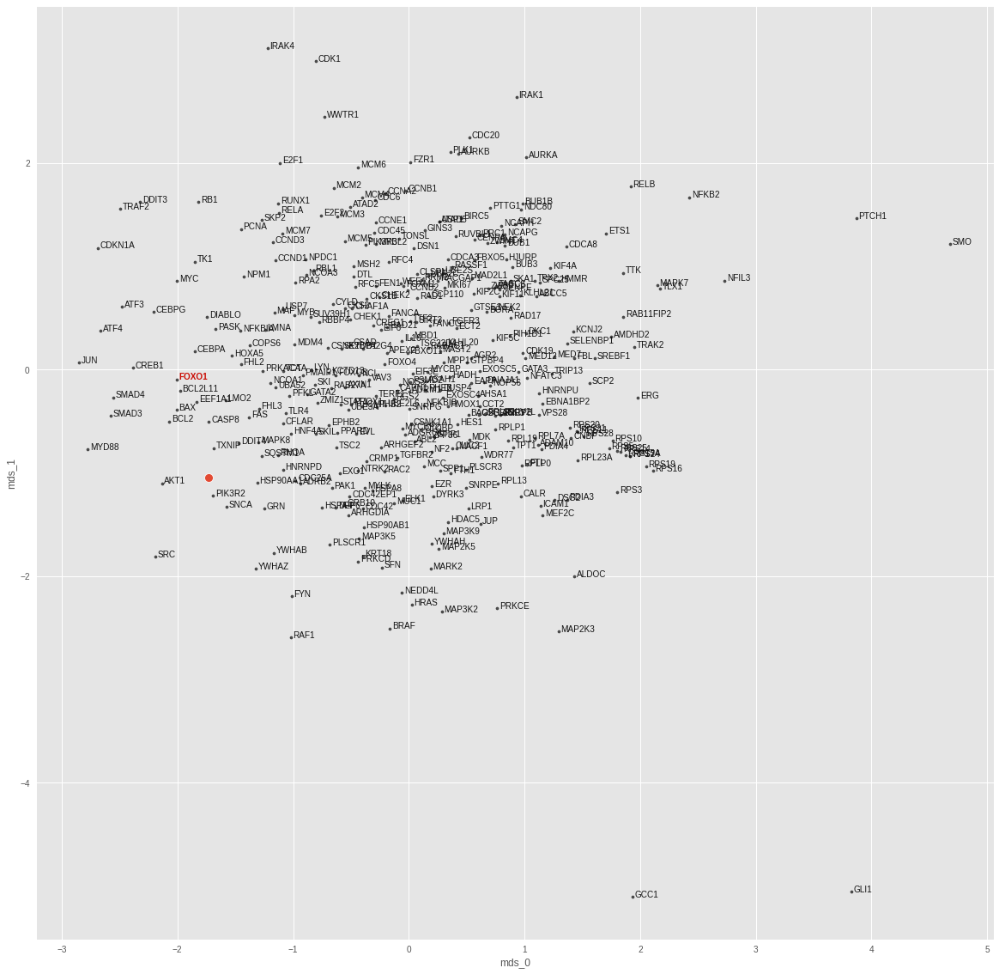

GLI1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 7.996736233483691e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.057623669505119324
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


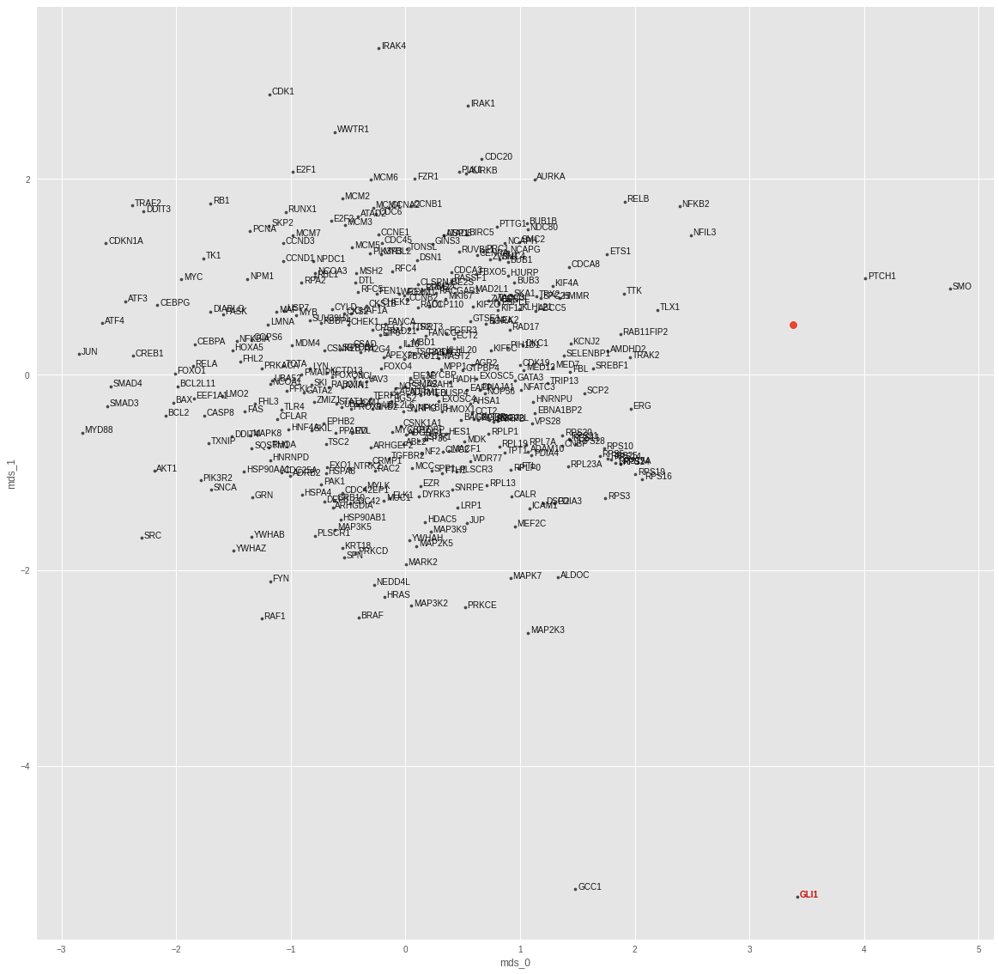

HRAS
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.142632441776899e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007255179341882467
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


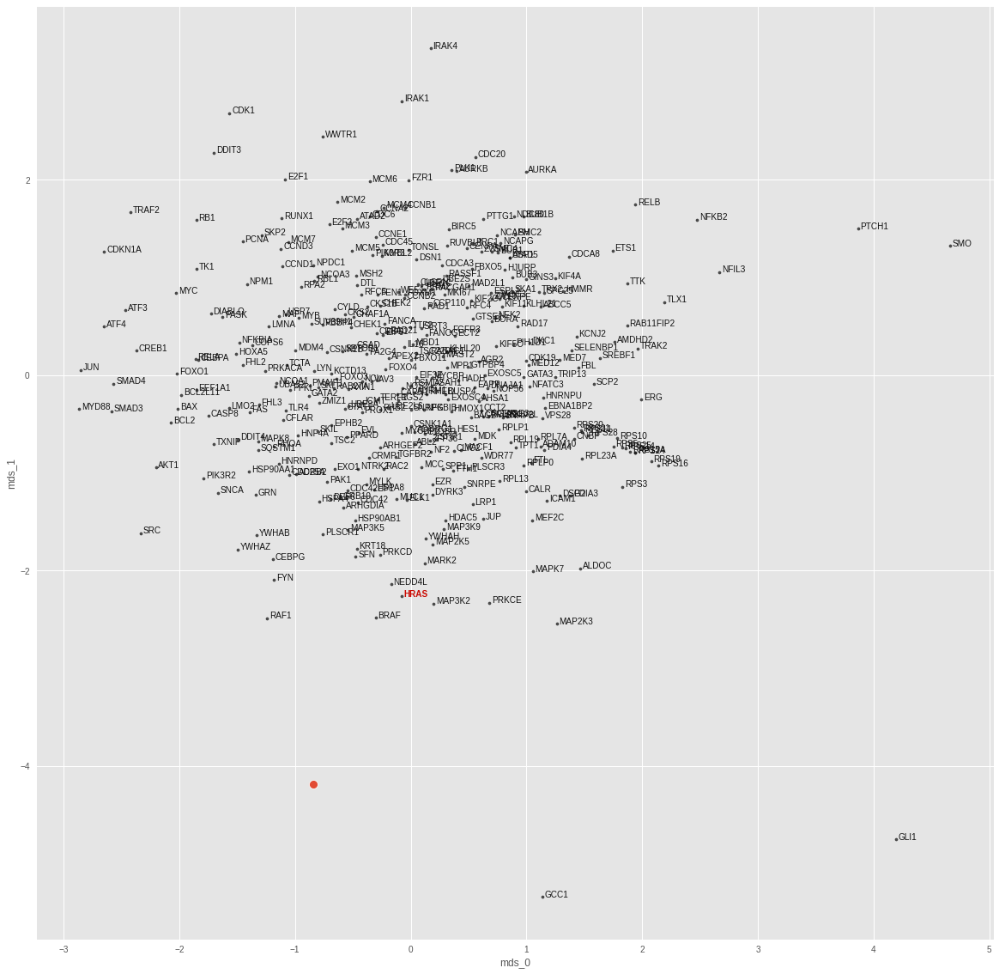

IRAK4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.7929992471842058e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.010580994188785553
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


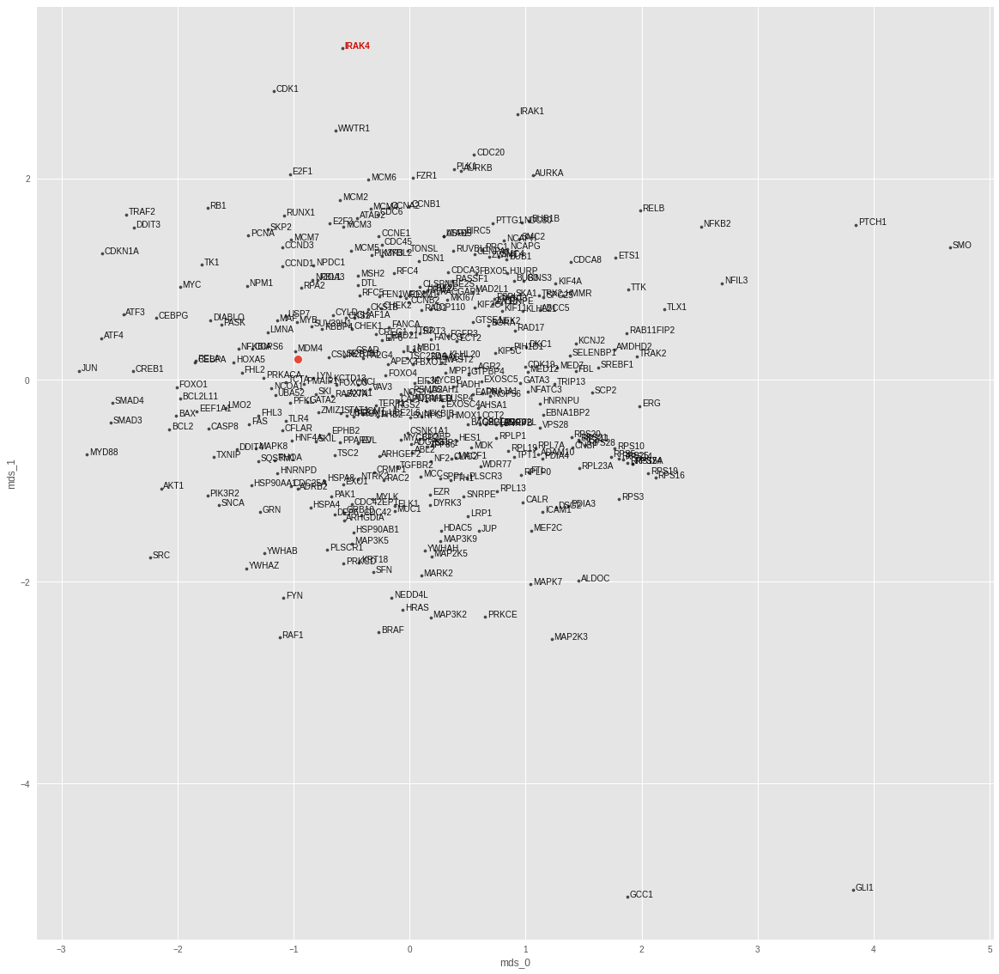

JUN
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.390715643422162e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.009333315305411816
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


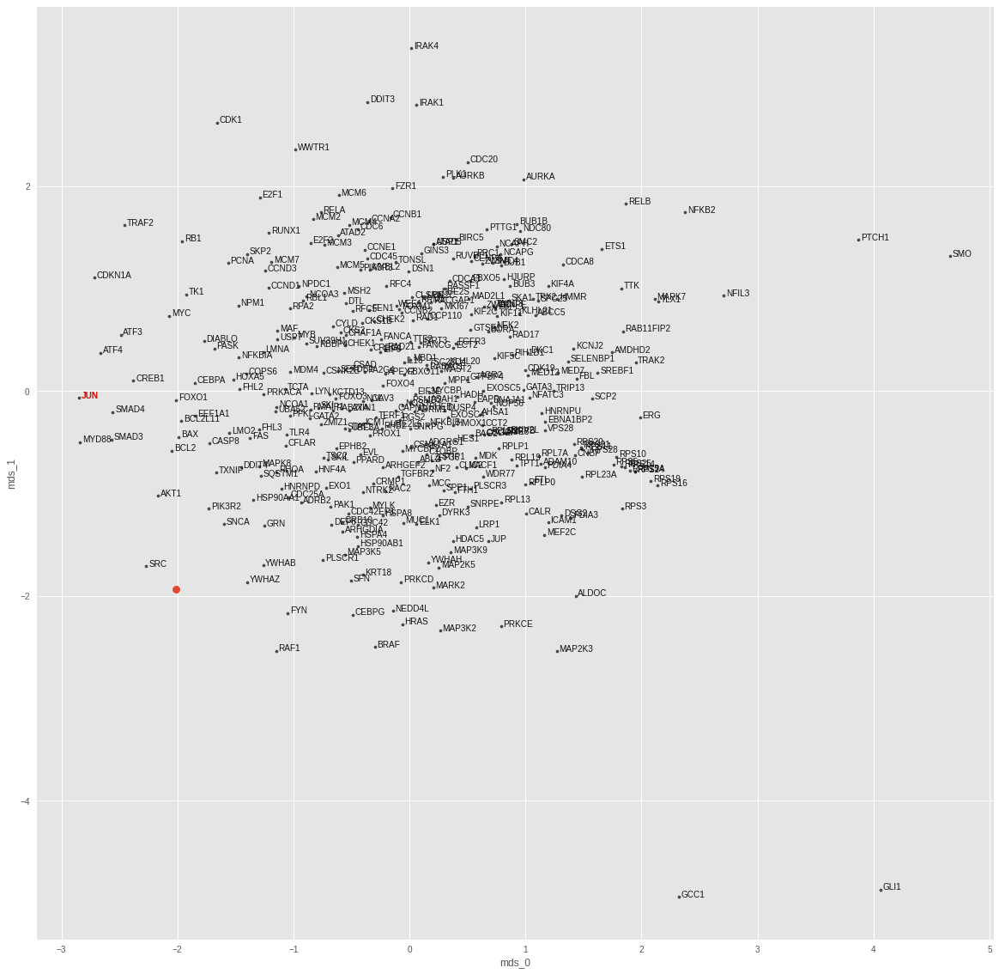

MAP2K3
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.8574863871263744e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007224729284644127
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


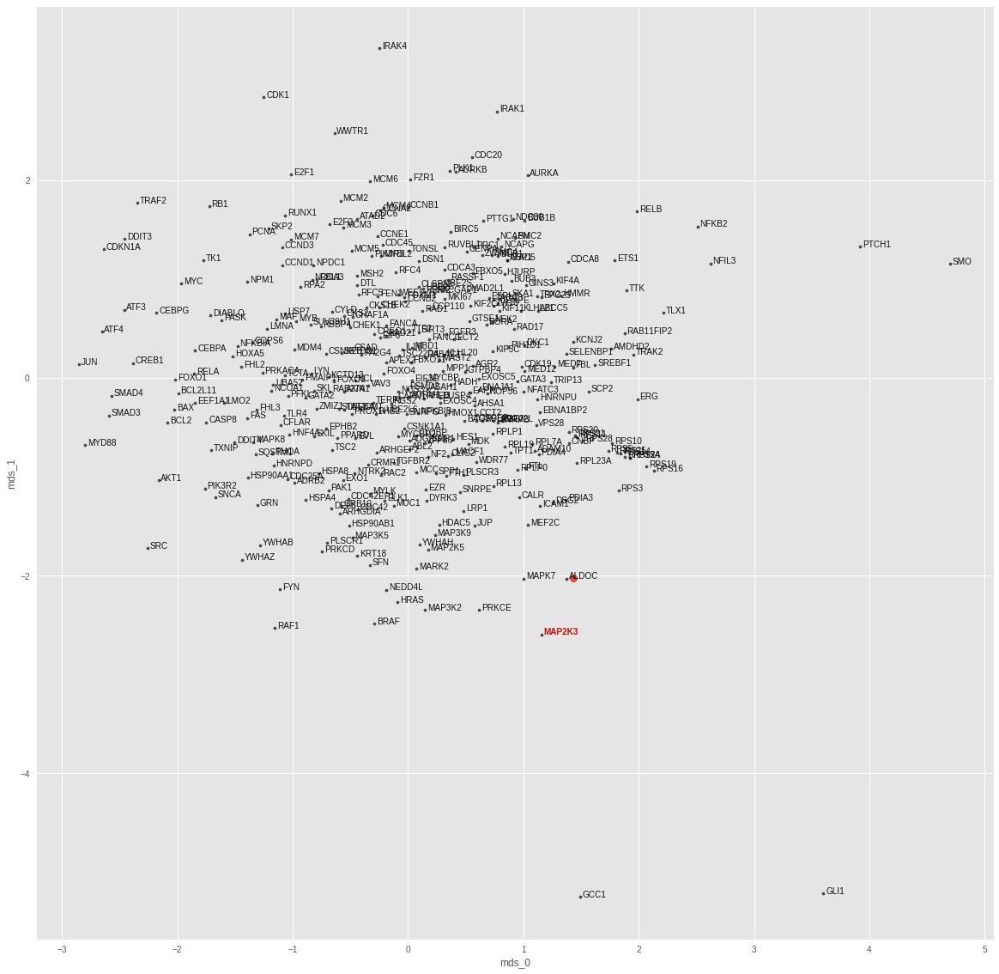

MAP3K2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.269836251208609e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0016854655696079135
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


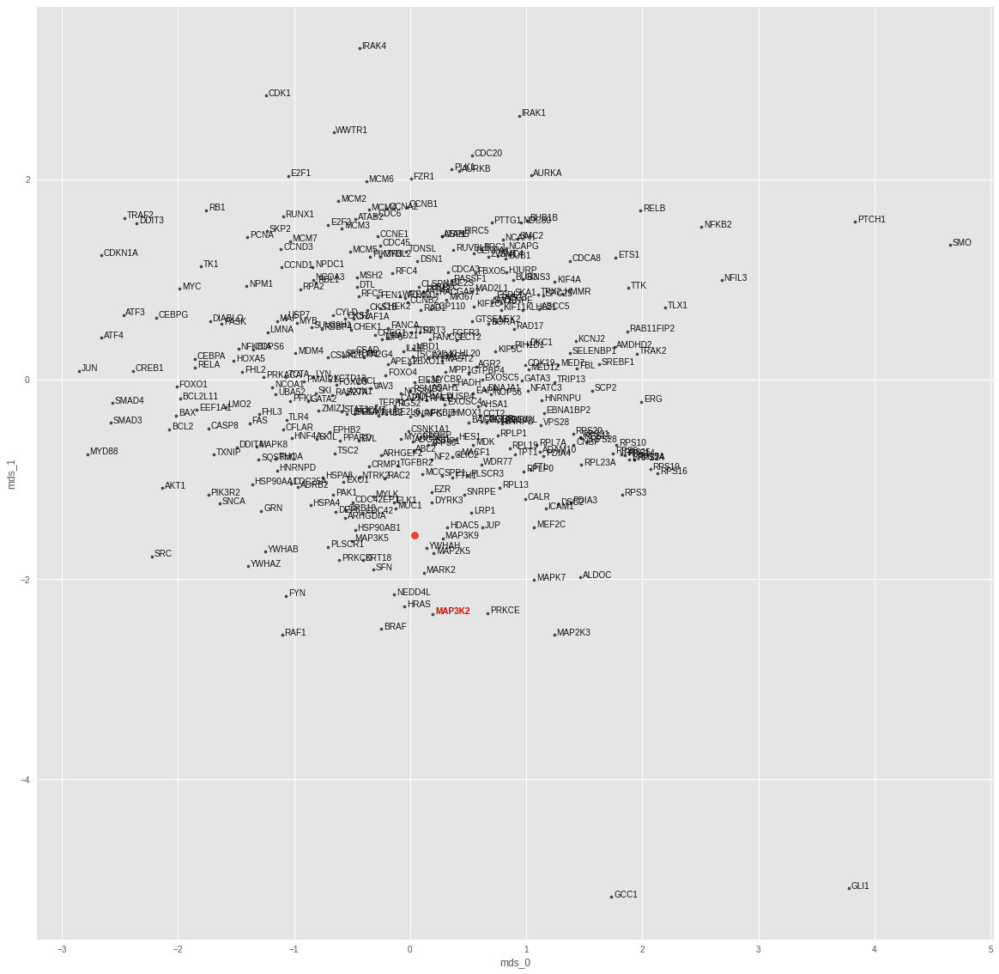

MAP3K5
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.5091439523306247e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0038695468101650476
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


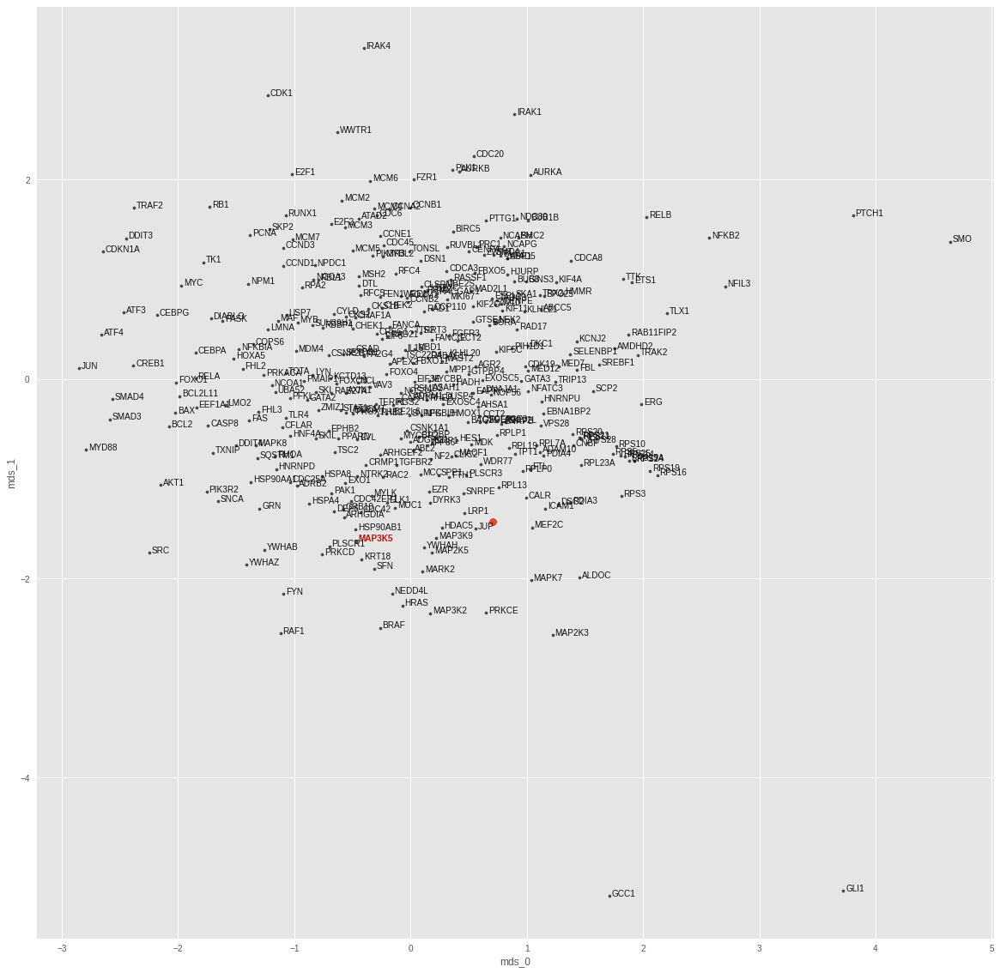

MAP3K9
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 6.138773863534192e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006238709203898907
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


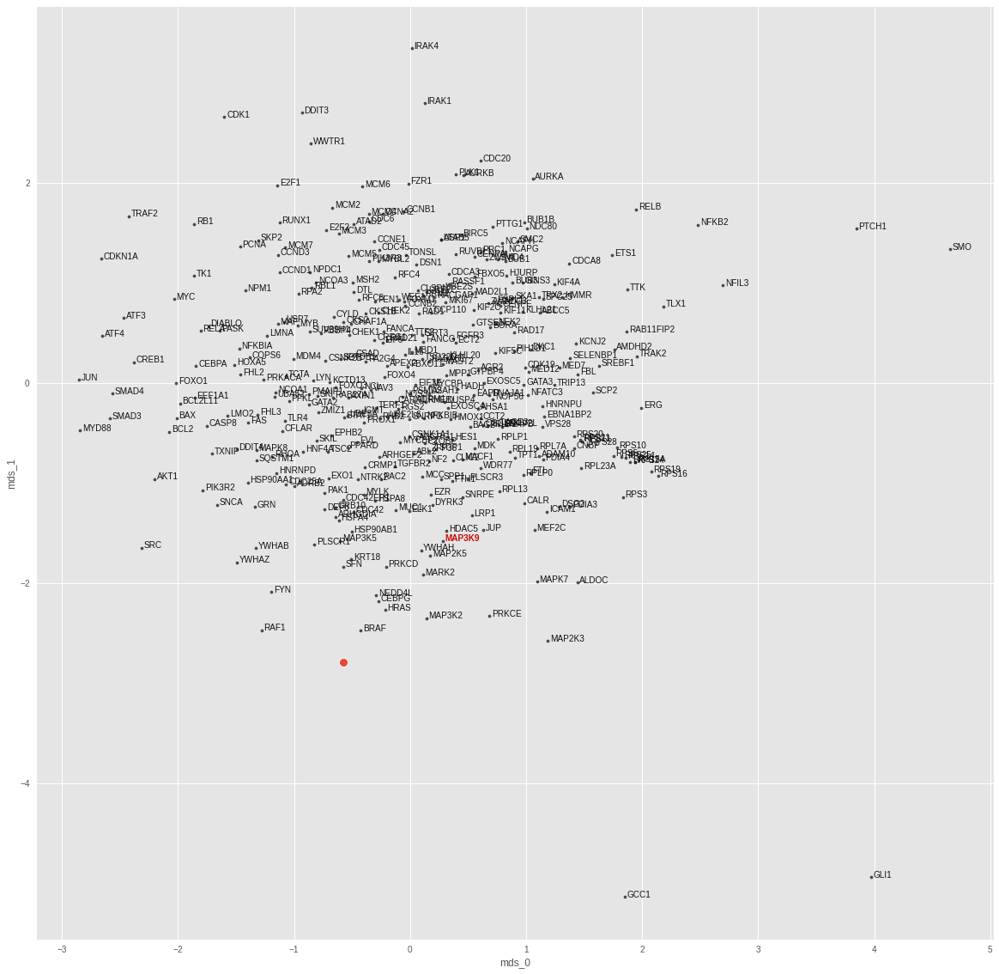

MAPK7
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.138837917489975e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.009890723042190075
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


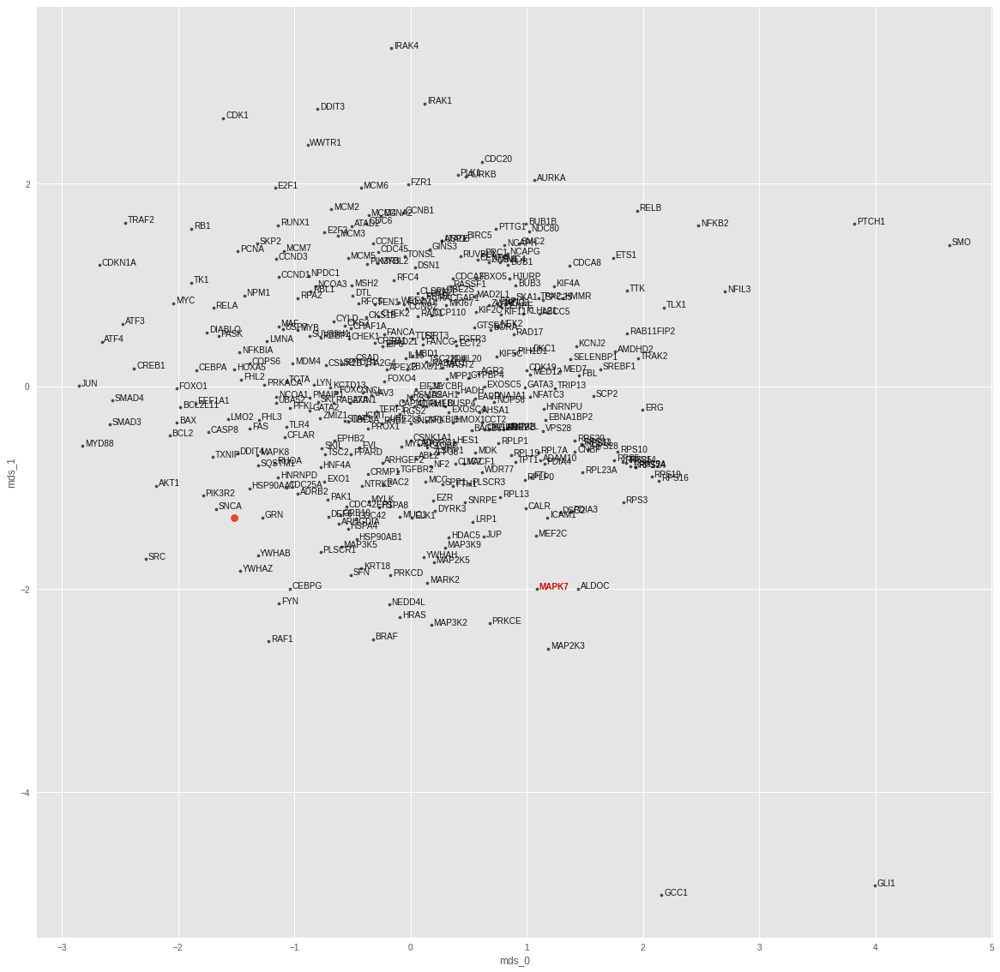

MYD88
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.643966257885237e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.008513320237398148
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


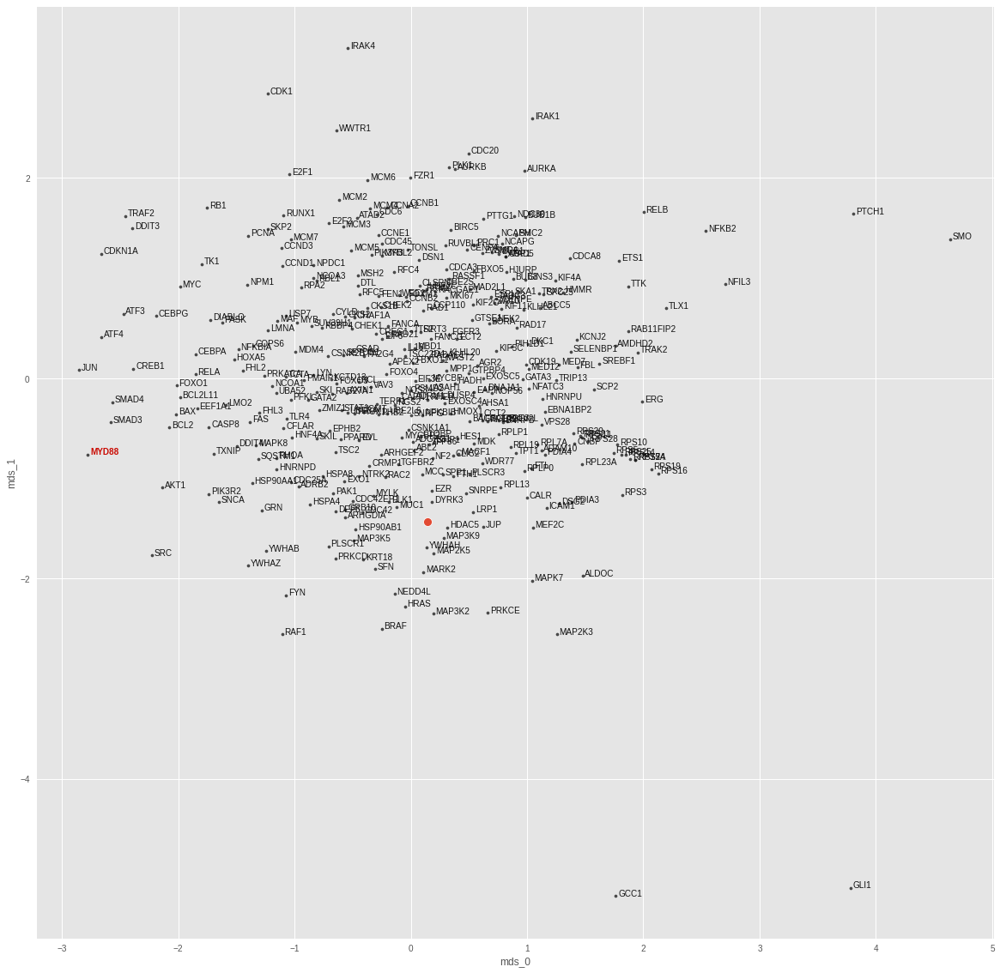

PIK3R2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.957562974490527e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0013575837947428226
test top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


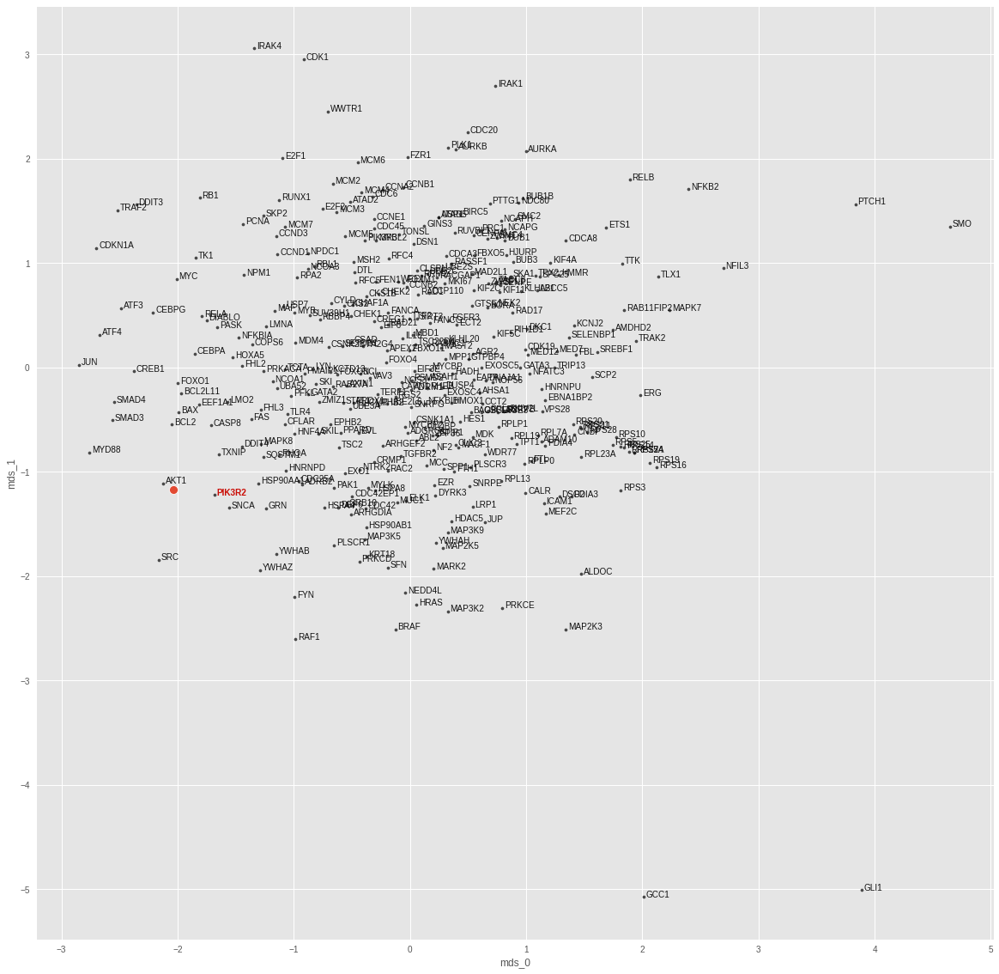

PRKACA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 7.686073823188545e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.00878800731152296
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


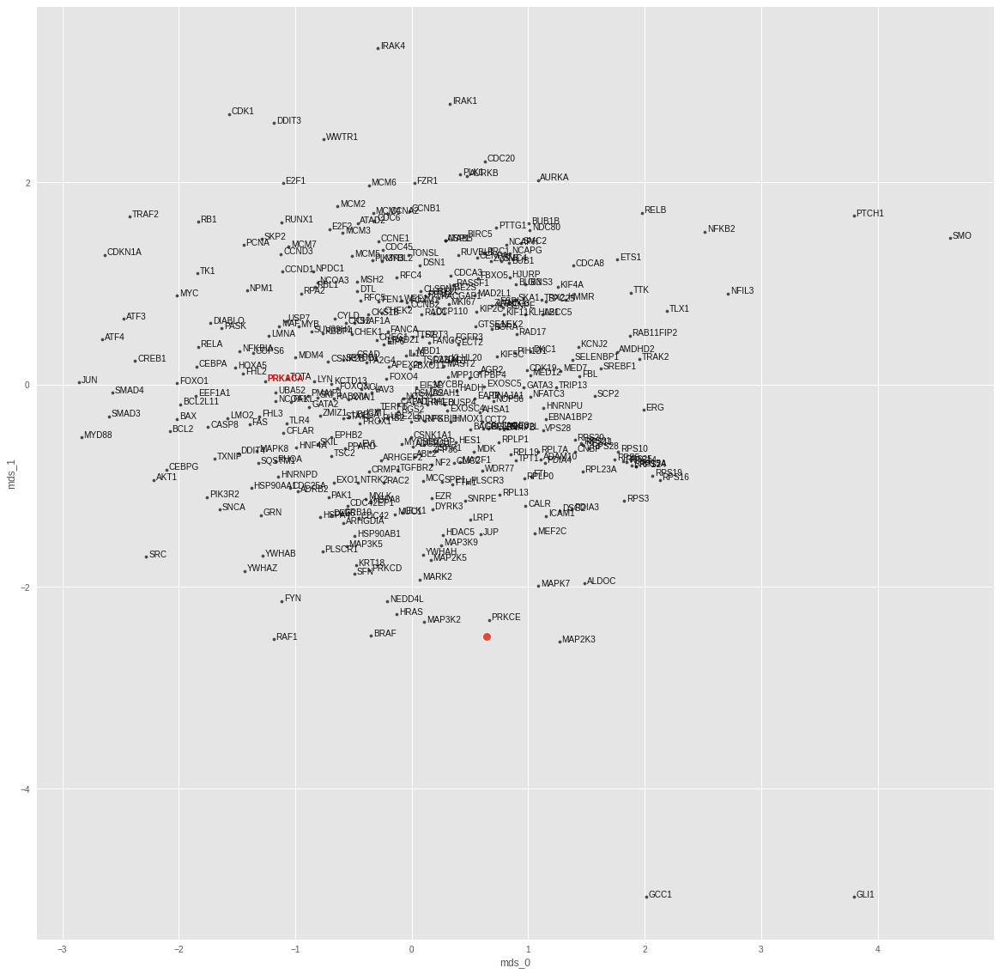

PRKCE
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.3374910499016453e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0073875123634934425
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


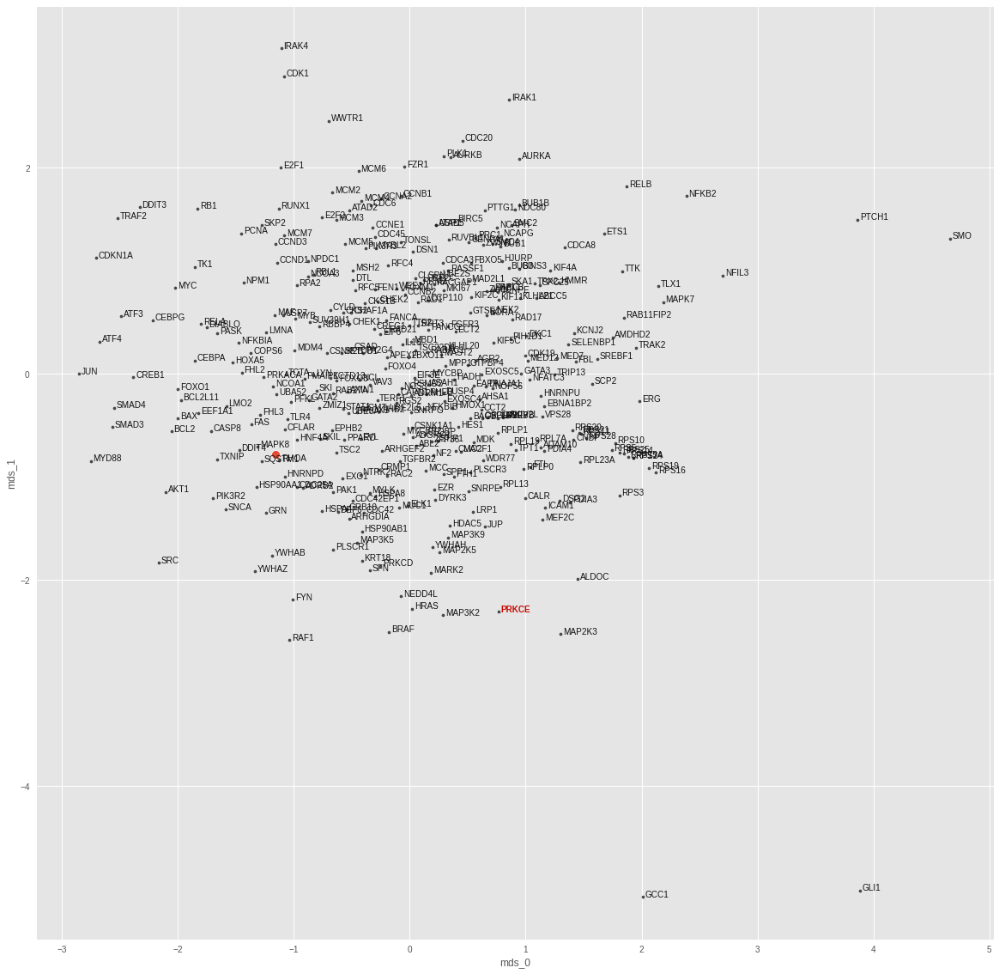

RAF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.8172783342920042e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0018035909160971642
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


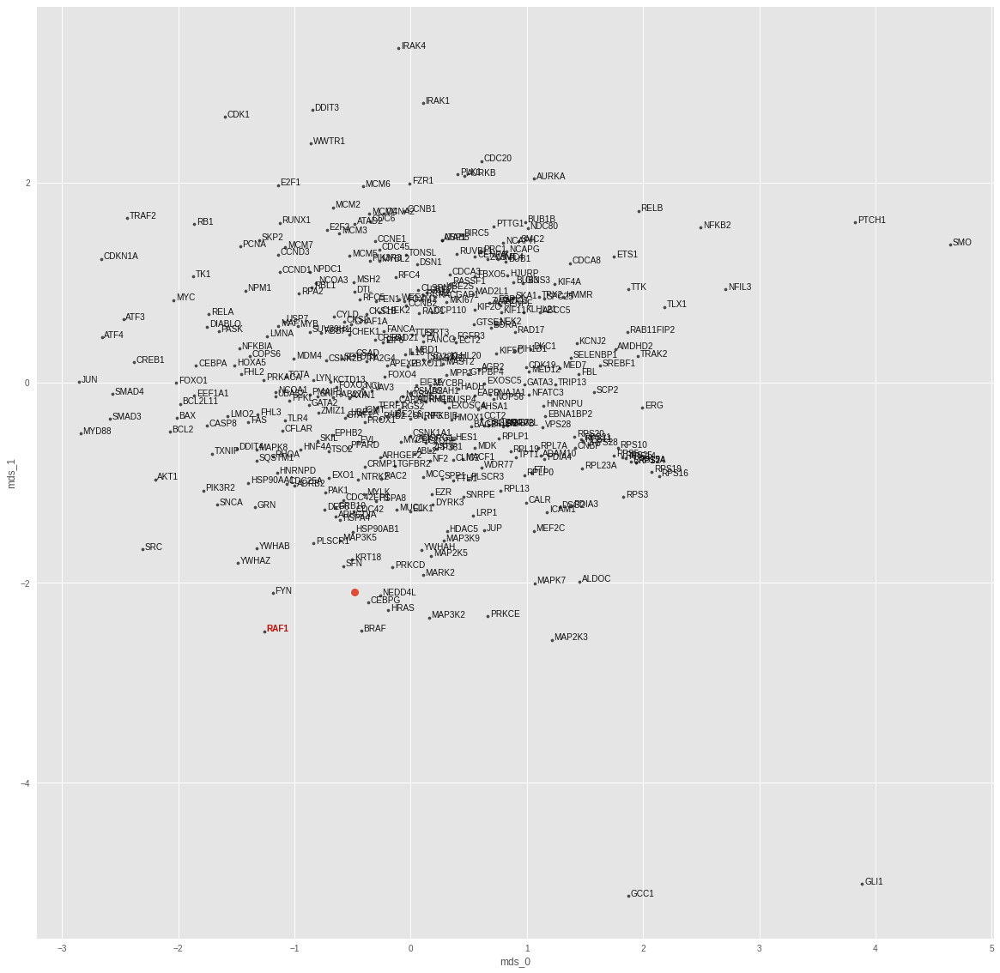

RELB
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.3212506682729991e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.012938696891069412
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


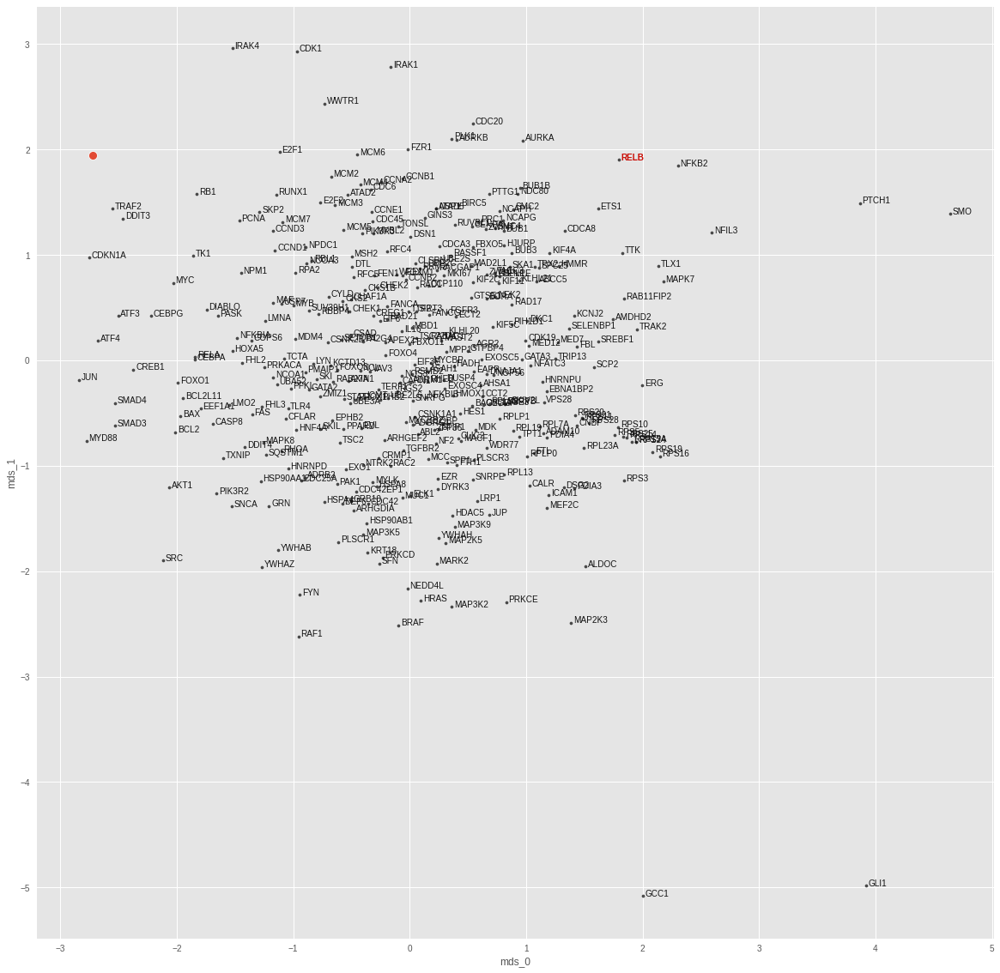

RHOA
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 3.813721431888061e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0008269252721220255
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


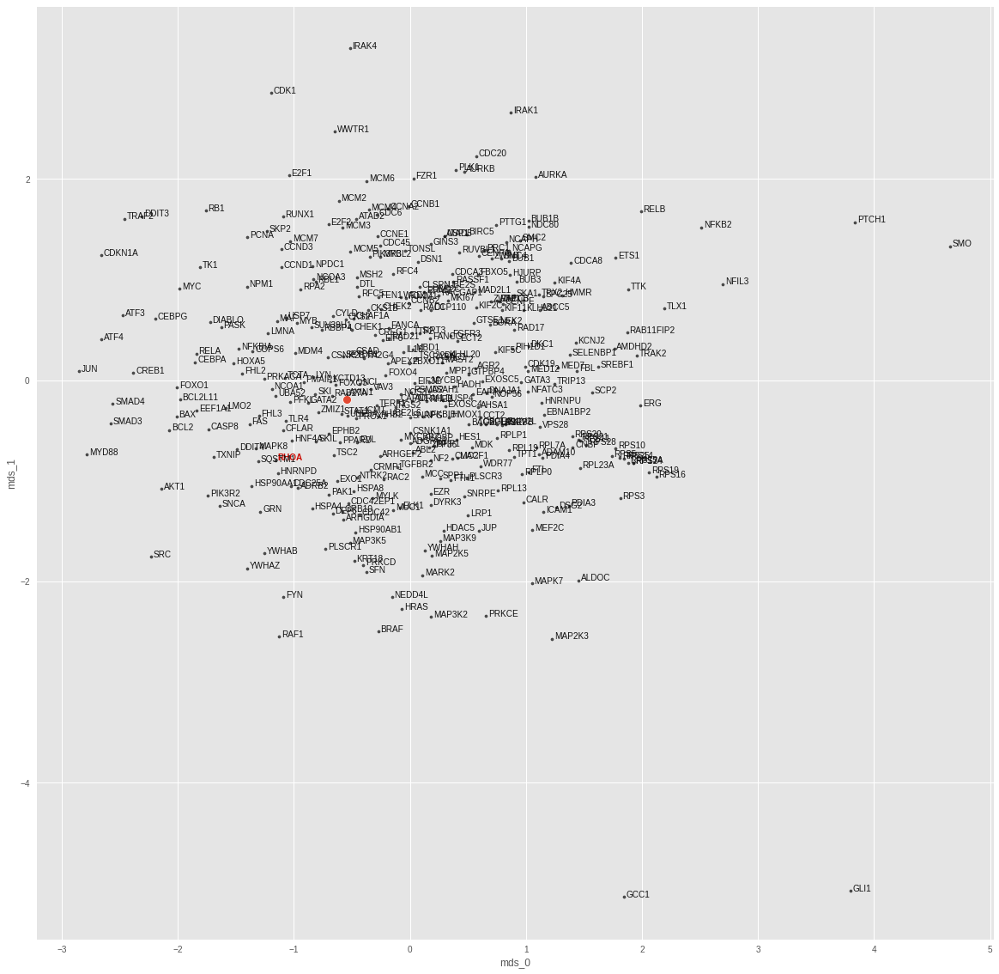

SMAD4
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 5.123746337336047e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004030381329357624
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


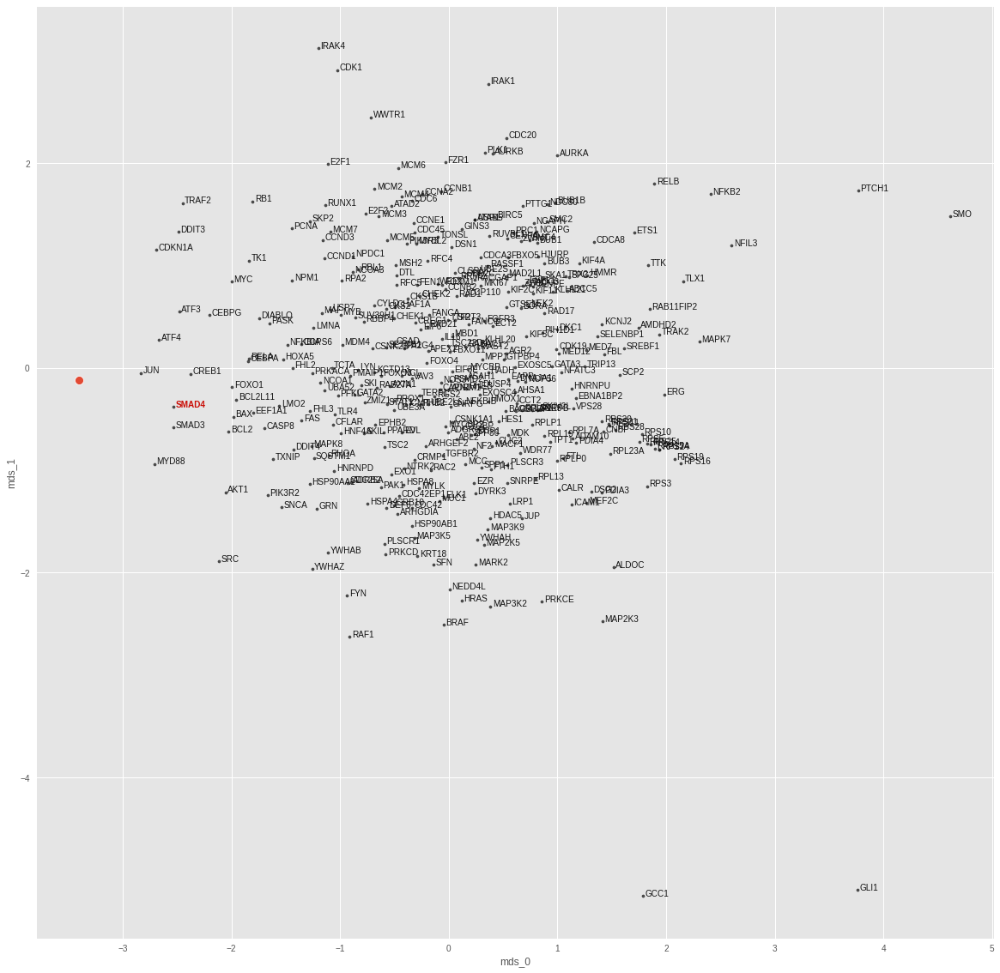

SMO
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.5122103291474019e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.020680155605077744
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


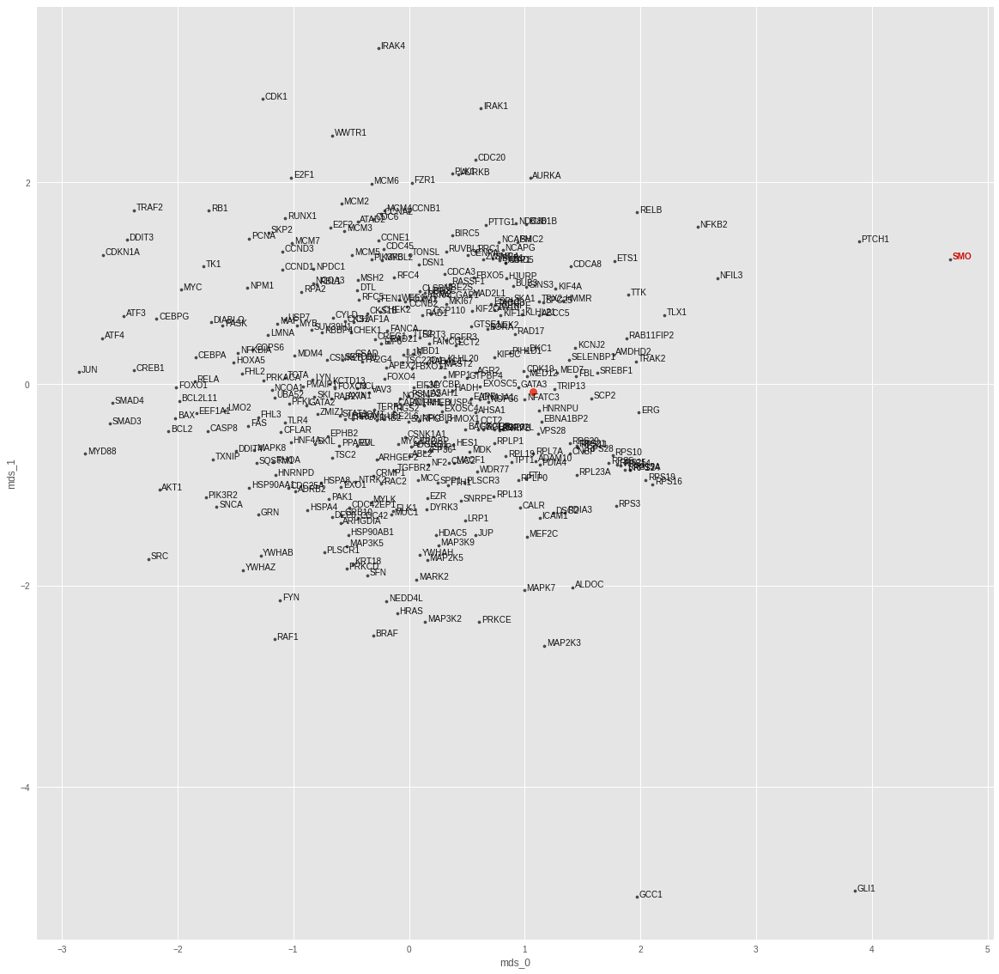

SRC
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 1.658457399202775e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.009195297956466675
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


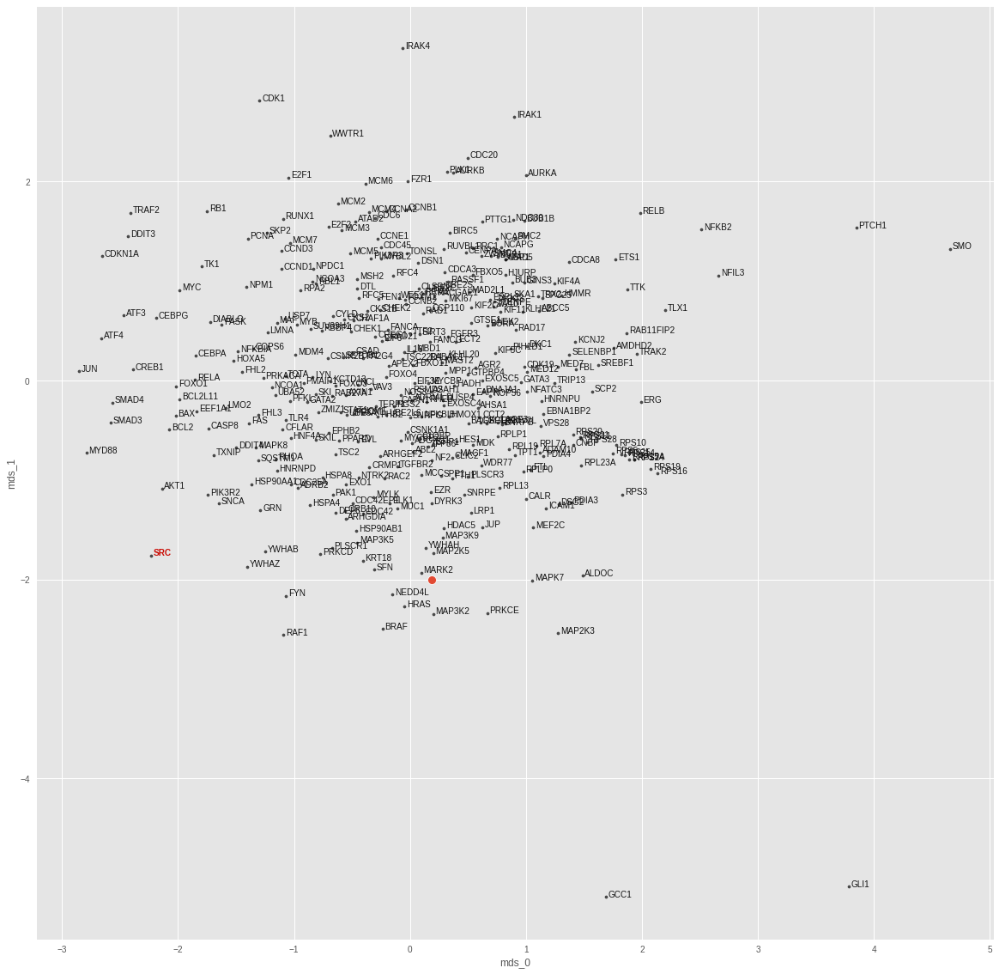

SREBF1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.3543007278286324e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004751348868012428
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


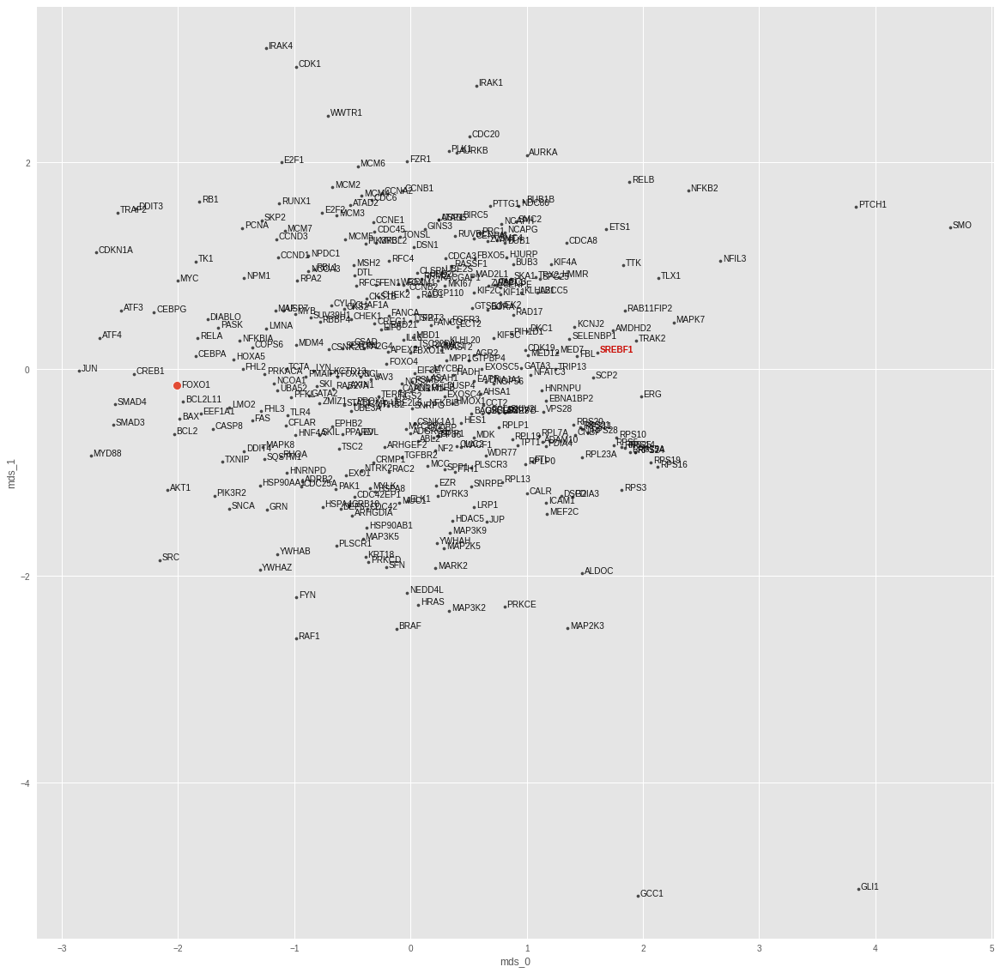

TRAF2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 2.8021235462998645e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.010038771666586399
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


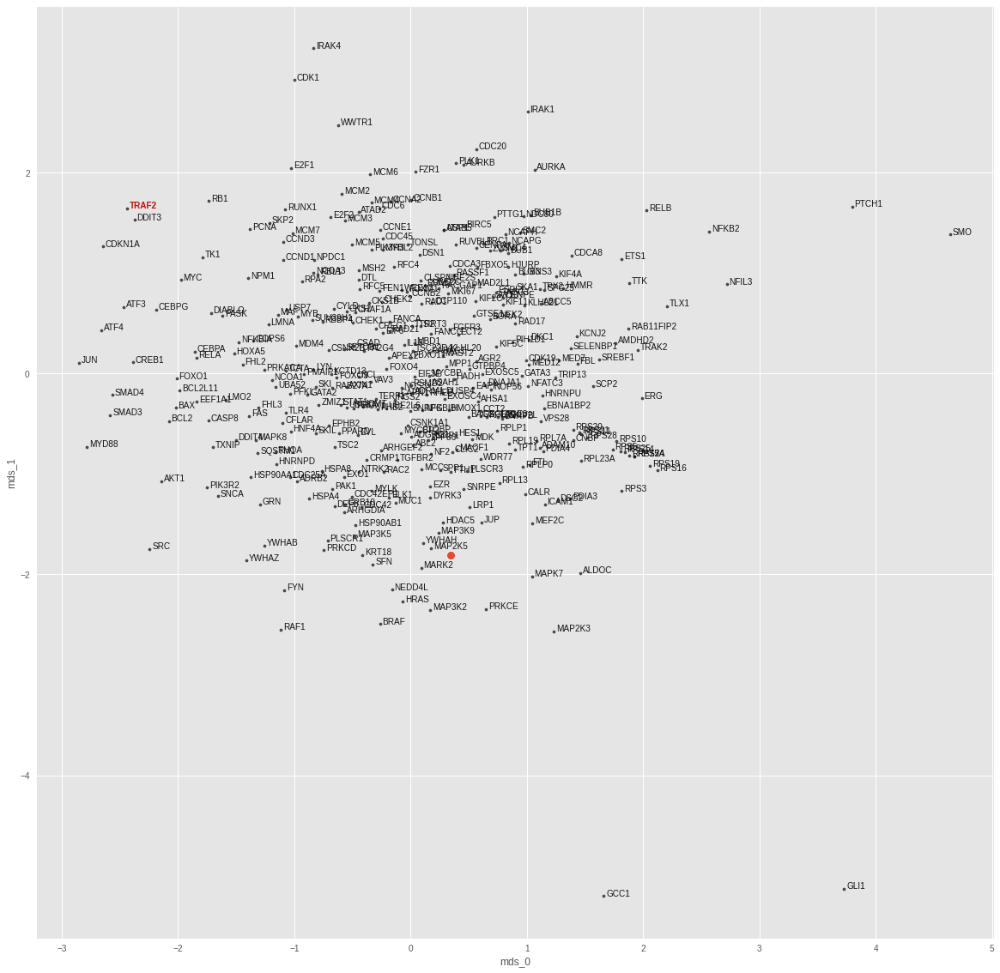

TSC2
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.543929195721363e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0039296275936067104
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


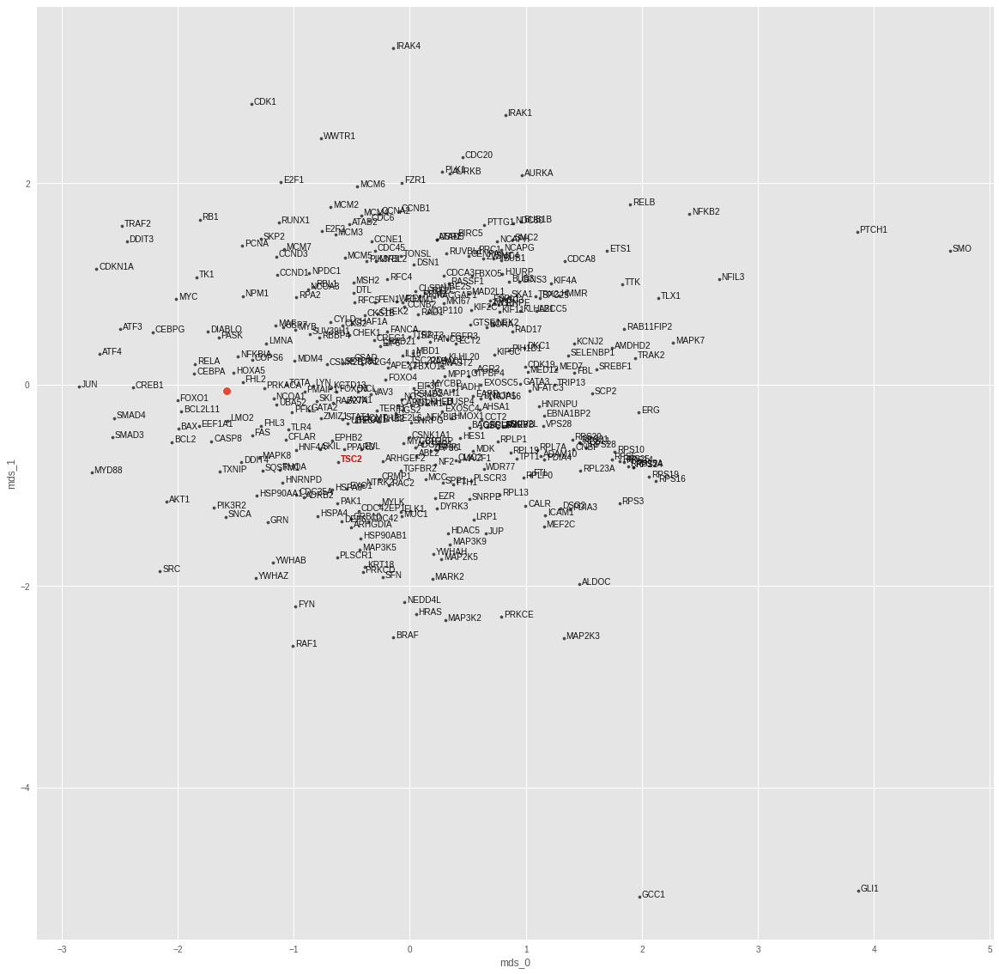

WWTR1
cuda:0


  0%|          | 0/500 [00:00<?, ?it/s]

train loss: 4.6130637103389644e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.01137888990342617
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


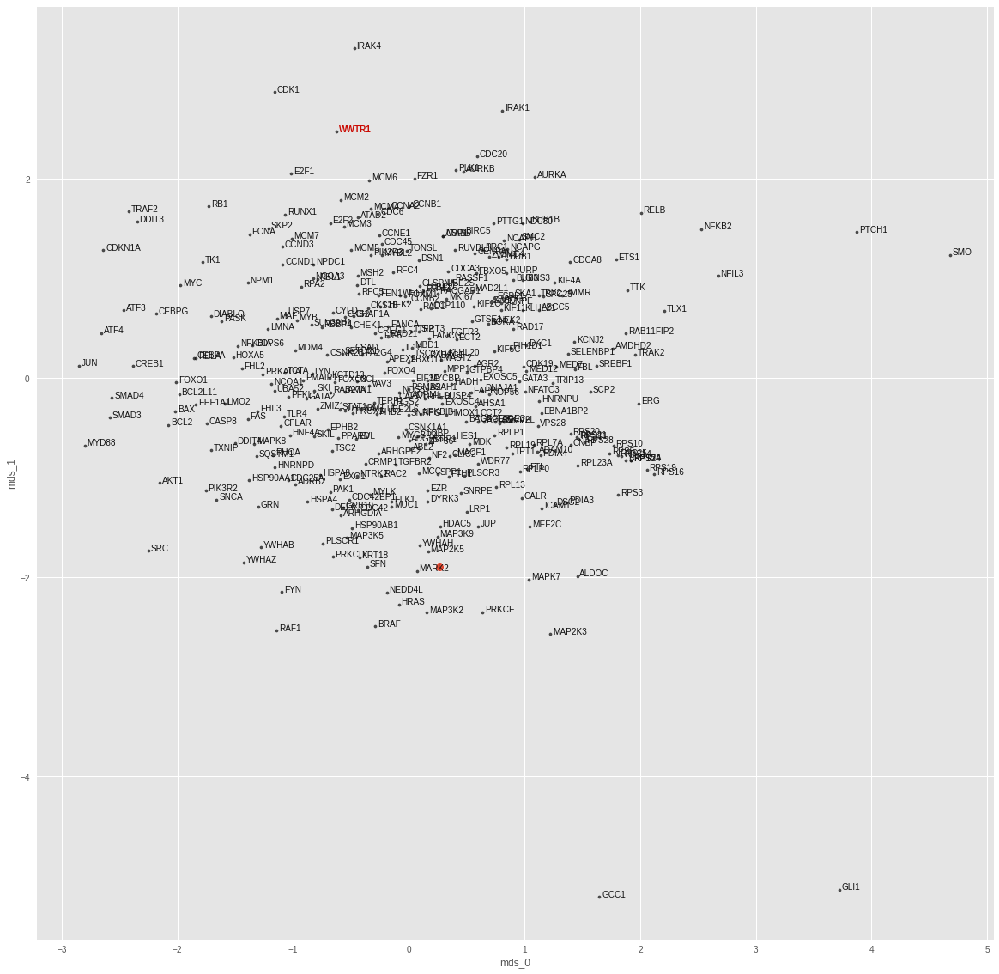

<IPython.core.display.Javascript object>

In [31]:
target_topk_accs = {}
mean_nonlin_nns = {}
for i in tqdm(range(len(data_dicts))):
    data_dict = data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, topk_acc, _, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=500,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = topk_acc
    mean_nonlin_nns[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [32]:
mean_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
mean_nonlin_topk_df.loc[mean_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
PIK3R2,1.0,1.0,1.0,1.0,1.0,1.0
BCL2L11,0.0,1.0,1.0,1.0,1.0,1.0
CEBPA,0.0,0.0,1.0,1.0,1.0,1.0
HRAS,0.0,0.0,1.0,1.0,1.0,1.0
SMAD4,0.0,0.0,1.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,1.0,1.0,1.0
CASP8,0.0,0.0,0.0,0.0,1.0,1.0
CREB1,0.0,0.0,0.0,0.0,1.0,1.0
RAF1,0.0,0.0,0.0,0.0,1.0,1.0
RHOA,0.0,0.0,0.0,0.0,1.0,1.0


<IPython.core.display.Javascript object>

In [33]:
mean_nonlin_topk_df.describe()

,1,3,5,10,20,50
count,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000
mean,0.026316,0.052632,0.131579,0.157895,0.263158,0.315789
std,0.162221,0.226294,0.342570,0.369537,0.446258,0.471069
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.000000,0.000000,0.000000,0.750000,1.000000
max,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

In [34]:
mean_nonlin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
mean_nonlin_nn_topk = get_topk_acc_from_nn_dict(mean_nonlin_nns, ks=ks)
mean_nonlin_result = mean_nonlin_nn_topk.mean()
for k in ks:
    mean_nonlin_results["topk_acc"].append(mean_nonlin_result.loc["top-{}".format(k)])
    mean_nonlin_results["k"].append(k)
mean_nonlin_results = pd.DataFrame(mean_nonlin_results)

<IPython.core.display.Javascript object>

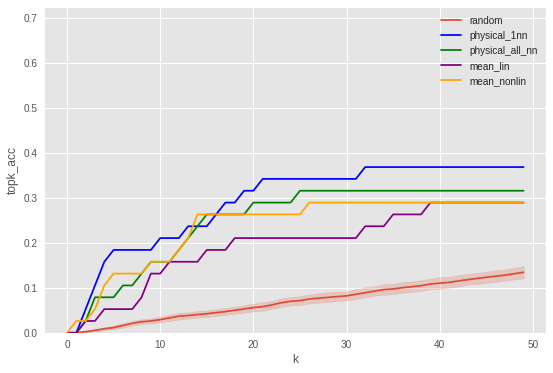

<IPython.core.display.Javascript object>

In [35]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "topk_acc"]),
    label="physical_1nn",
    color="blue",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "37", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "37", "topk_acc"]),
    label="physical_all_nn",
    color="green",
)
ax.plot(
    np.array(mean_lin_results.loc[:, "k"]),
    np.array(mean_lin_results.loc[:, "topk_acc"]),
    label="mean_lin",
    color="purple",
)
ax.plot(
    np.array(mean_nonlin_results.loc[:, "k"]),
    np.array(mean_nonlin_results.loc[:, "topk_acc"]),
    label="mean_nonlin",
    color="orange",
)
ax.legend()
ax.set_ylim([0, 0.725])
plt.show()

---

### 2.4. Structural NN centroid translation

Next, we will move away from representing the structural phenotype induced by a single gene overexpression by the population mean of the cellular embeddings. Instead we have identified four different structural phenotype clusters per condition using 4-means clustering. Using those we aim to establish the translation between the structural and regulatory space.

To this end, we will first identify the one nearest neighbor of each cluster centroid for each target that does not correspond to the same gene overexpression condition. Next, we compute the mean embedding in the regulatory space of the corresponding one-nearest neighbors for each of the four cluster centroids. Finally, we assess the local neighborhood of this latent space location in a similar setting as before.

In [36]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]

<IPython.core.display.Javascript object>

In [37]:
struct_nn_centroid_pred_dict = get_struct_nn_centroid_translation_dict(
    cl_img_embs_fold0, node_embs
)
struct_nn_centroid_topk = get_topk_acc_from_nn_dict(struct_nn_centroid_pred_dict)
struct_nn_centroid_topk.describe()

,top-0,top-1,top-2,top-3,top-4,top-5,top-6,top-7,top-8,top-9,...,top-40,top-41,top-42,top-43,top-44,top-45,top-46,top-47,top-48,top-49
count,38.0,38.0,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,...,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000,38.000000
mean,0.0,0.0,0.026316,0.052632,0.052632,0.052632,0.052632,0.052632,0.052632,0.052632,...,0.157895,0.157895,0.157895,0.157895,0.157895,0.157895,0.184211,0.184211,0.184211,0.184211
std,0.0,0.0,0.162221,0.226294,0.226294,0.226294,0.226294,0.226294,0.226294,0.226294,...,0.369537,0.369537,0.369537,0.369537,0.369537,0.369537,0.392859,0.392859,0.392859,0.392859
min,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,0.0,0.0,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

---

### 3.5. Linear 4-centroids mapping

In [38]:
cl_img_embs_fold0, cl_node_embs_fold0, labels = cl_img_node_embs_dict["fold0"]
cl_data_dicts = get_logo_data_dicts(
    data=cl_img_embs_fold0,
    labels=cl_node_embs_fold0,
    val_size=0,
    group_labels=np.array(labels),
    batch_size=32,
    balanced=False,
    scale_x=False,
    scale_y=False,
)

<IPython.core.display.Javascript object>

  0%|          | 0/38 [00:00<?, ?it/s]

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00018450073797679465
train top-k accuracies: {1: 0.936937, 3: 0.990991, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004810233600437641
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


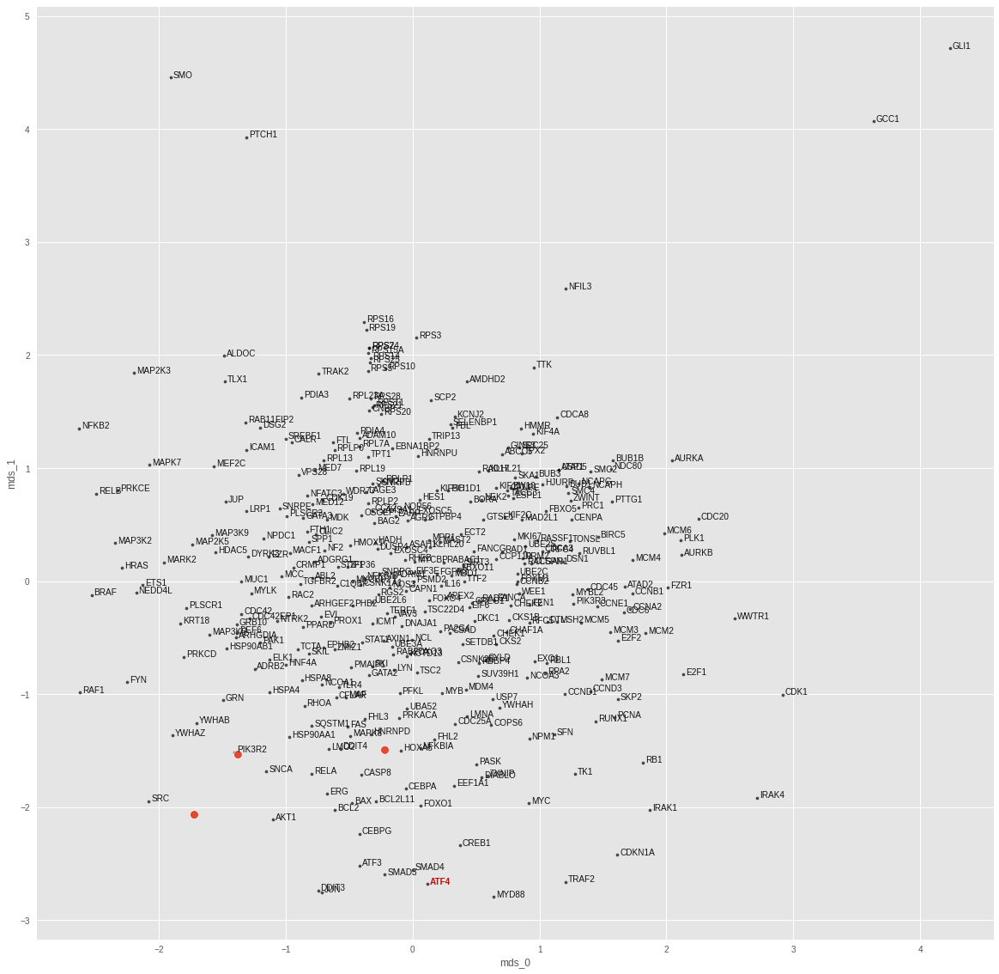

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00021471162924442338
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.990991, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.021317850798368454
test top-k accuracies: {1: 0.333333, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


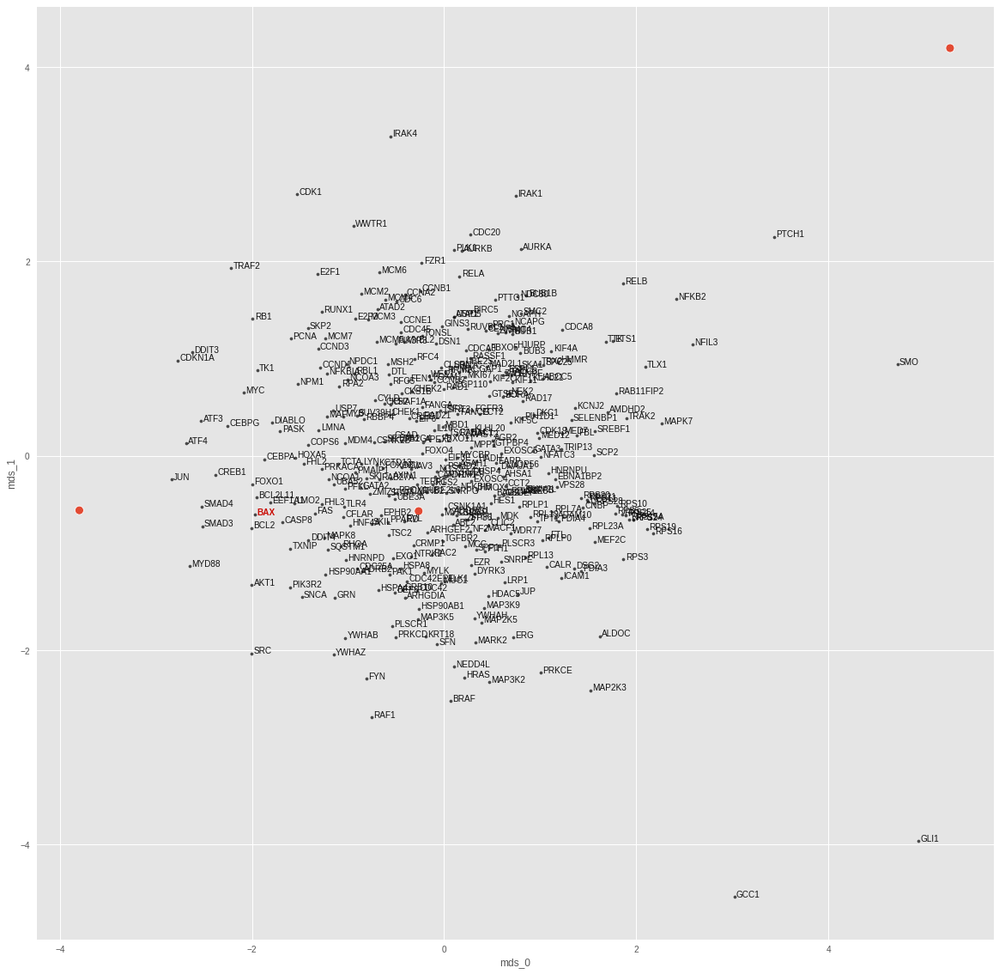

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000190825412770406
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.981982, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.016944028437137604
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


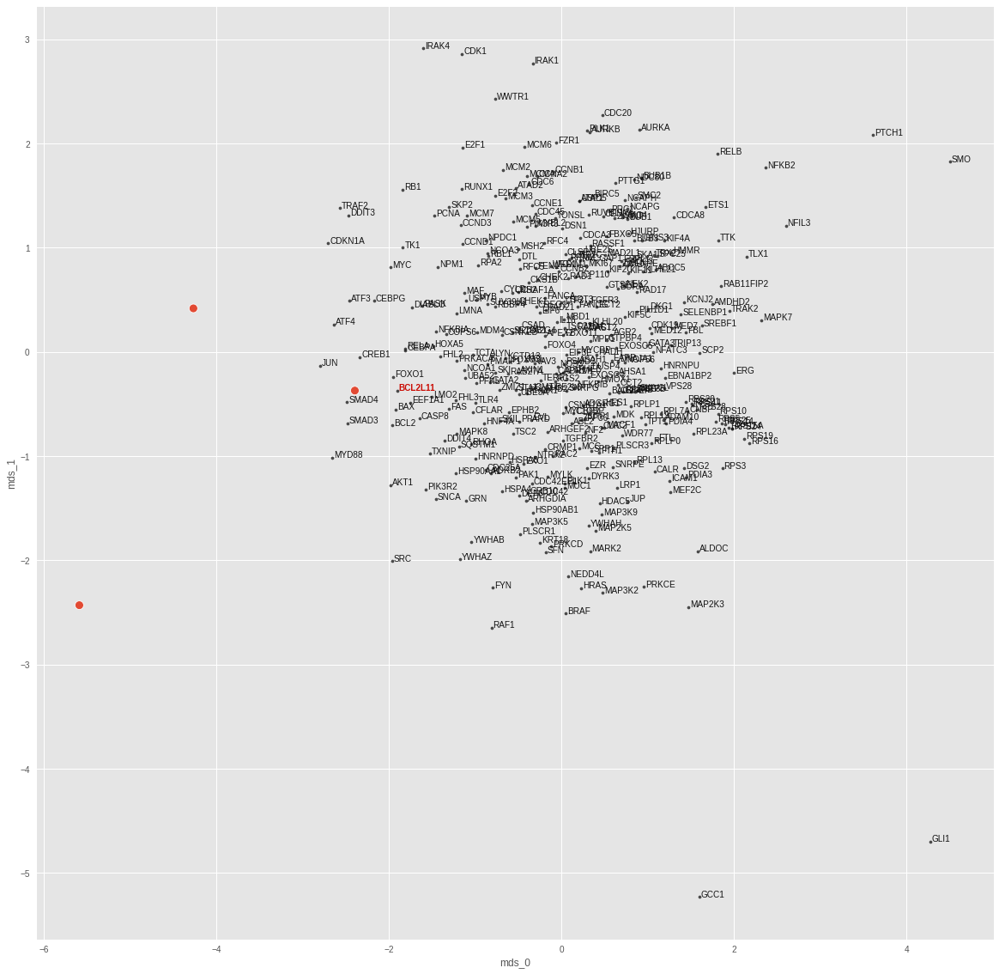

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001983107863411492
train top-k accuracies: {1: 0.954955, 3: 0.990991, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006475941278040409
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


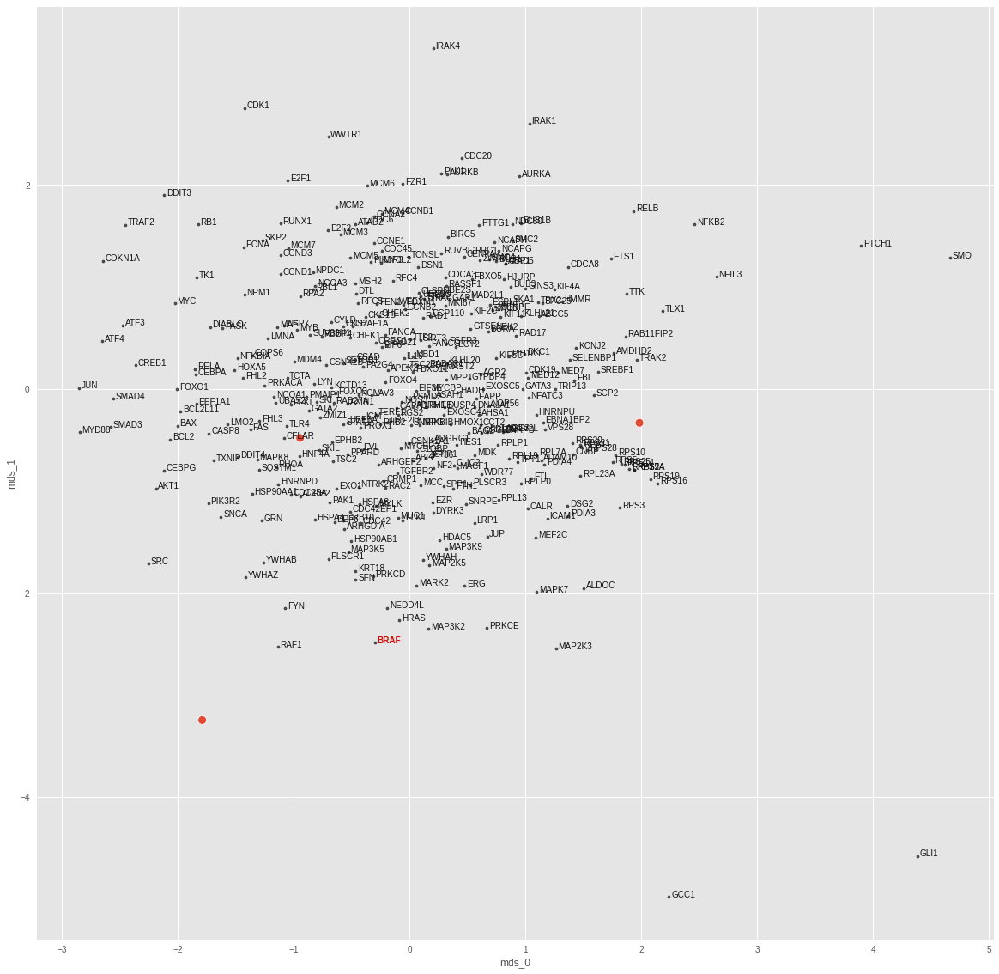

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001578187106018844
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.009164160117506981
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


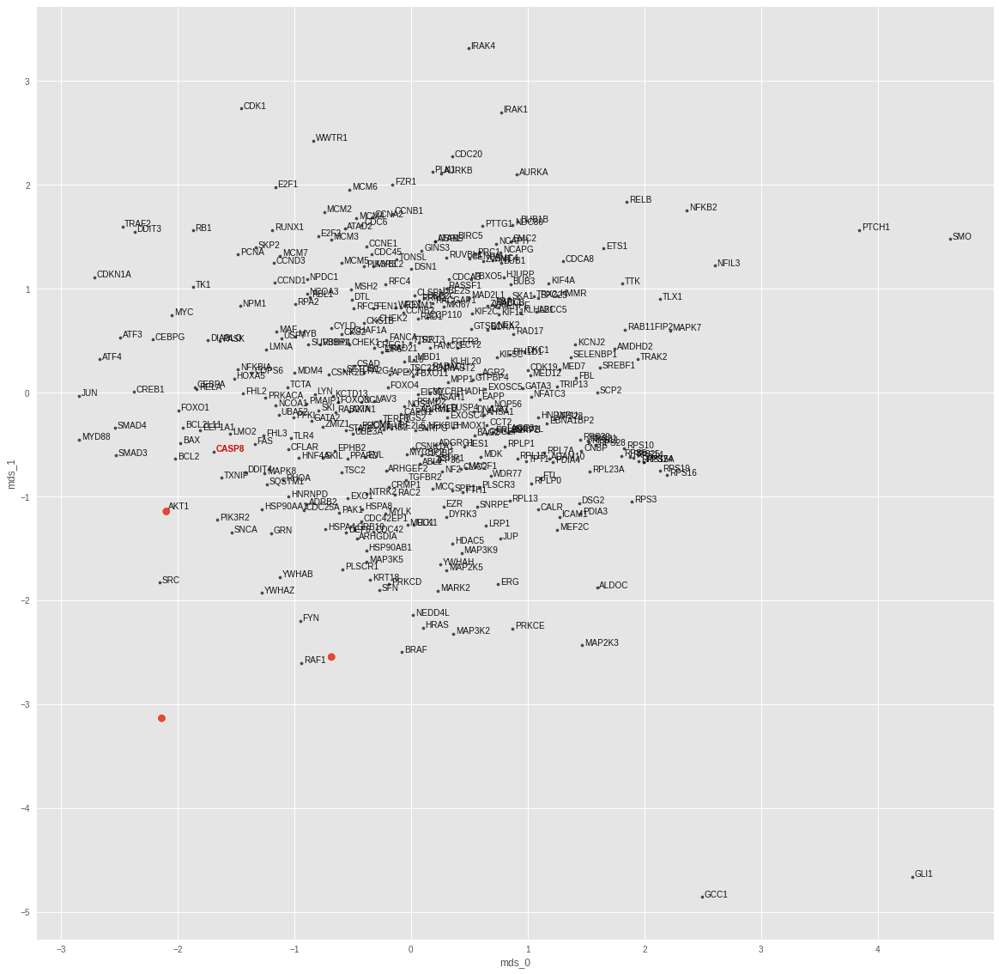

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001603650021721265
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.990991, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.018546370789408684
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


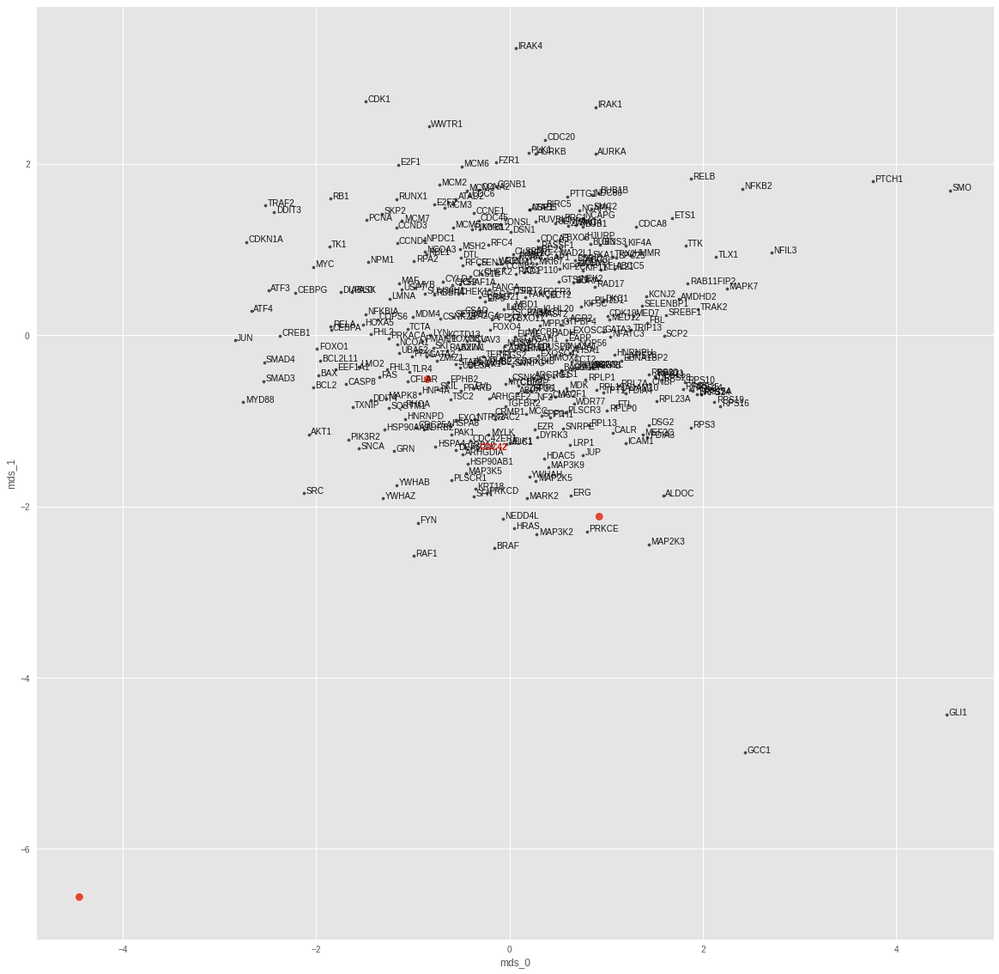

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00019207078940444835
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.015293031930923462
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


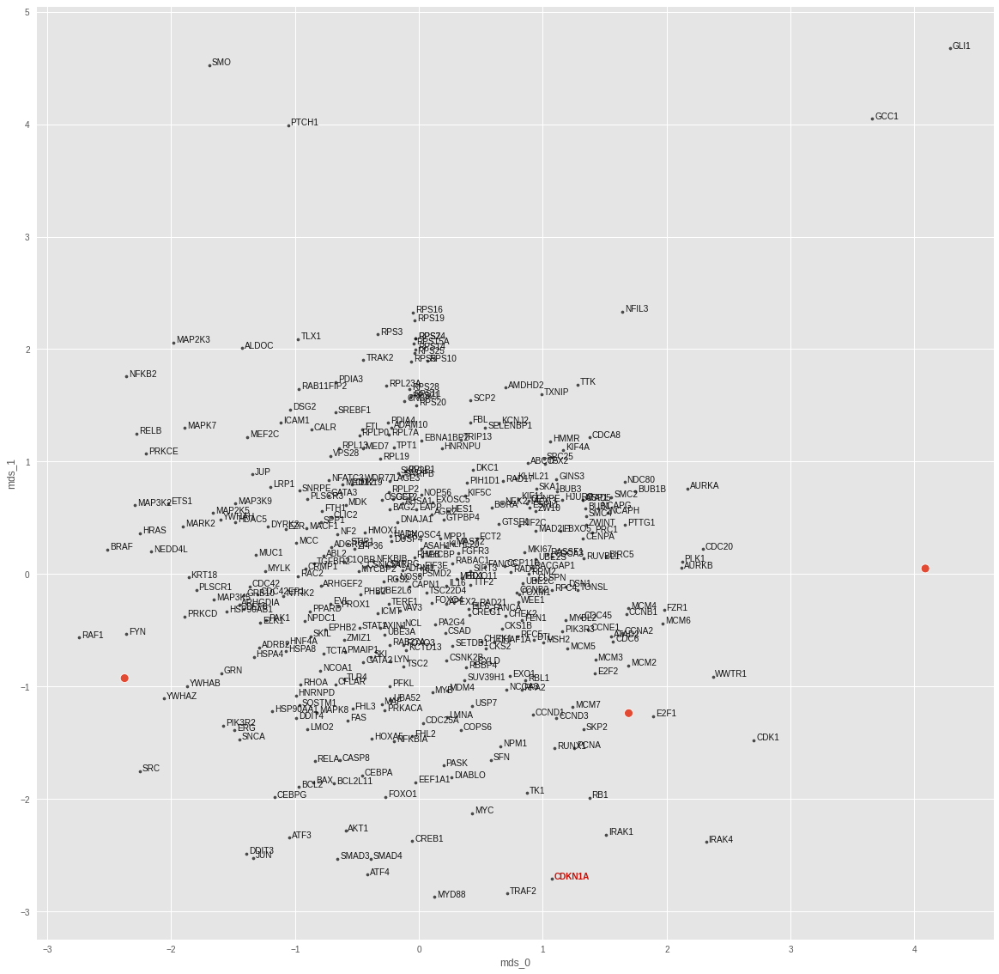

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0002132662660326926
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007824283093214035
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.666667, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


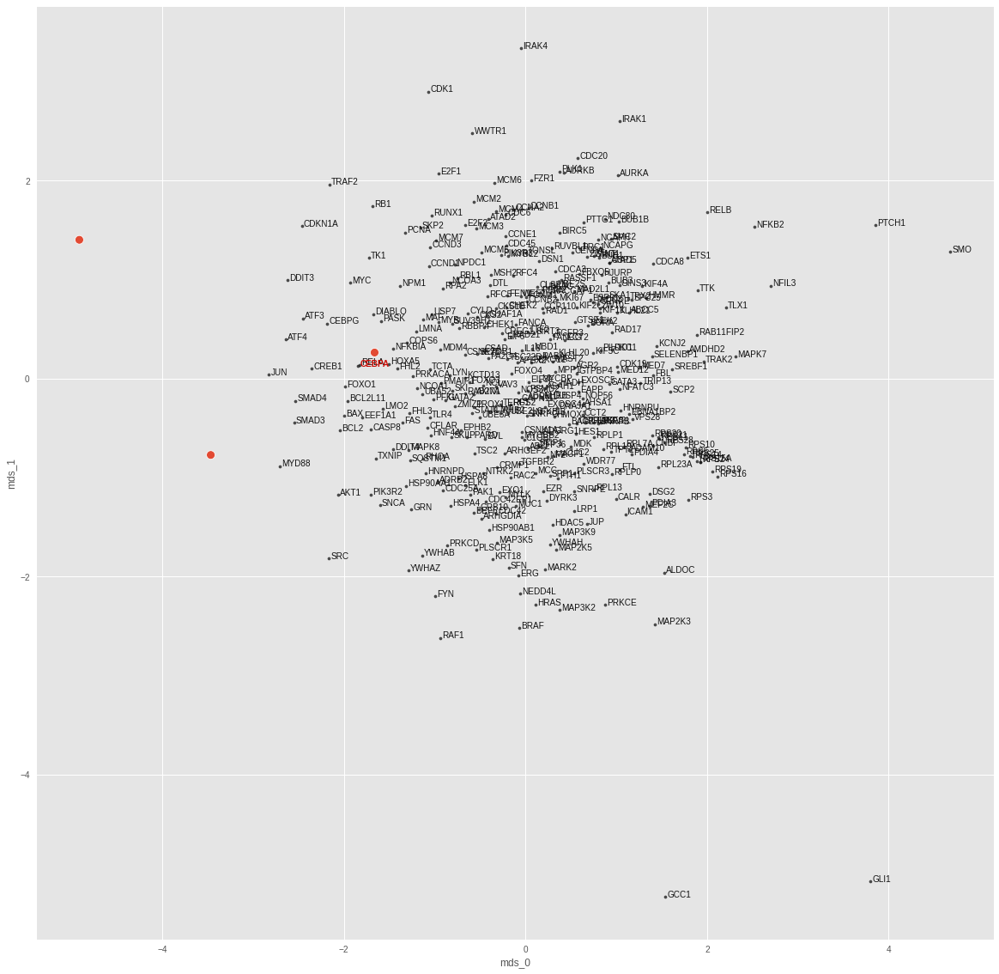

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00021123180510937696
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 0.990991, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.011257721111178398
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


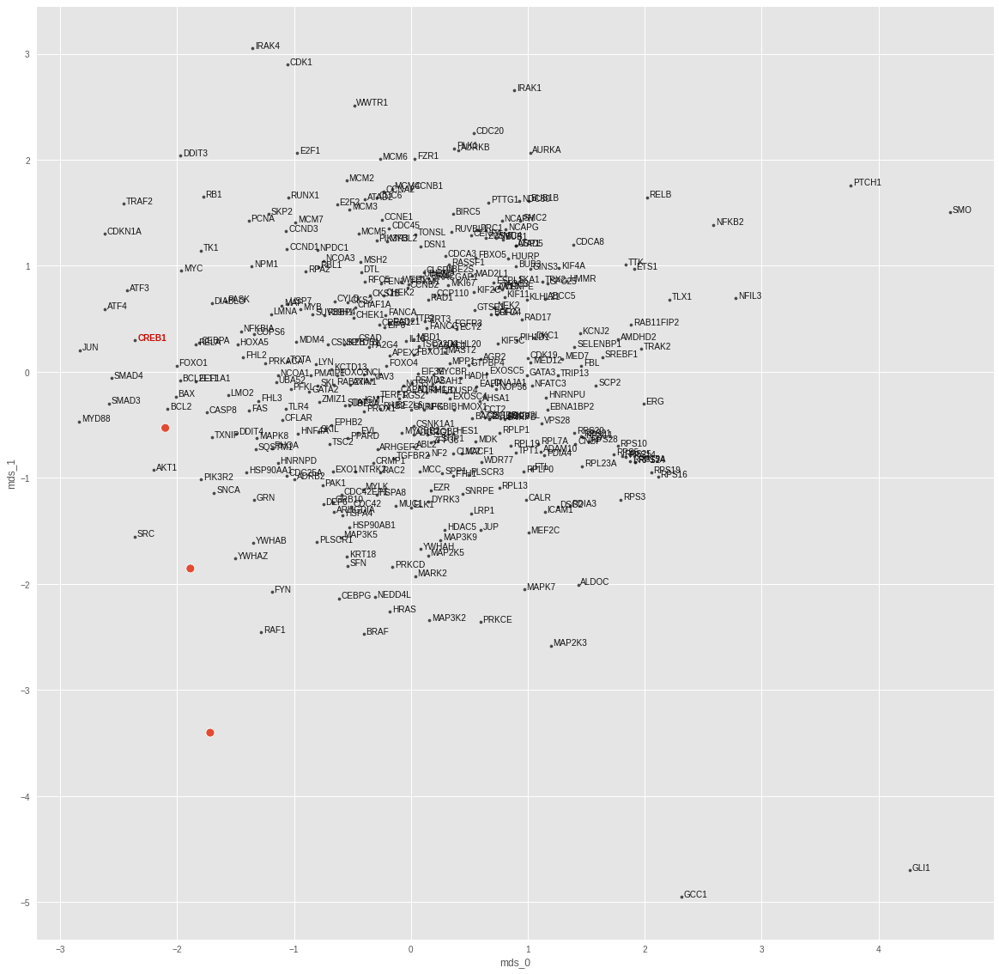

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001684605431856235
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.011312293820083141
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


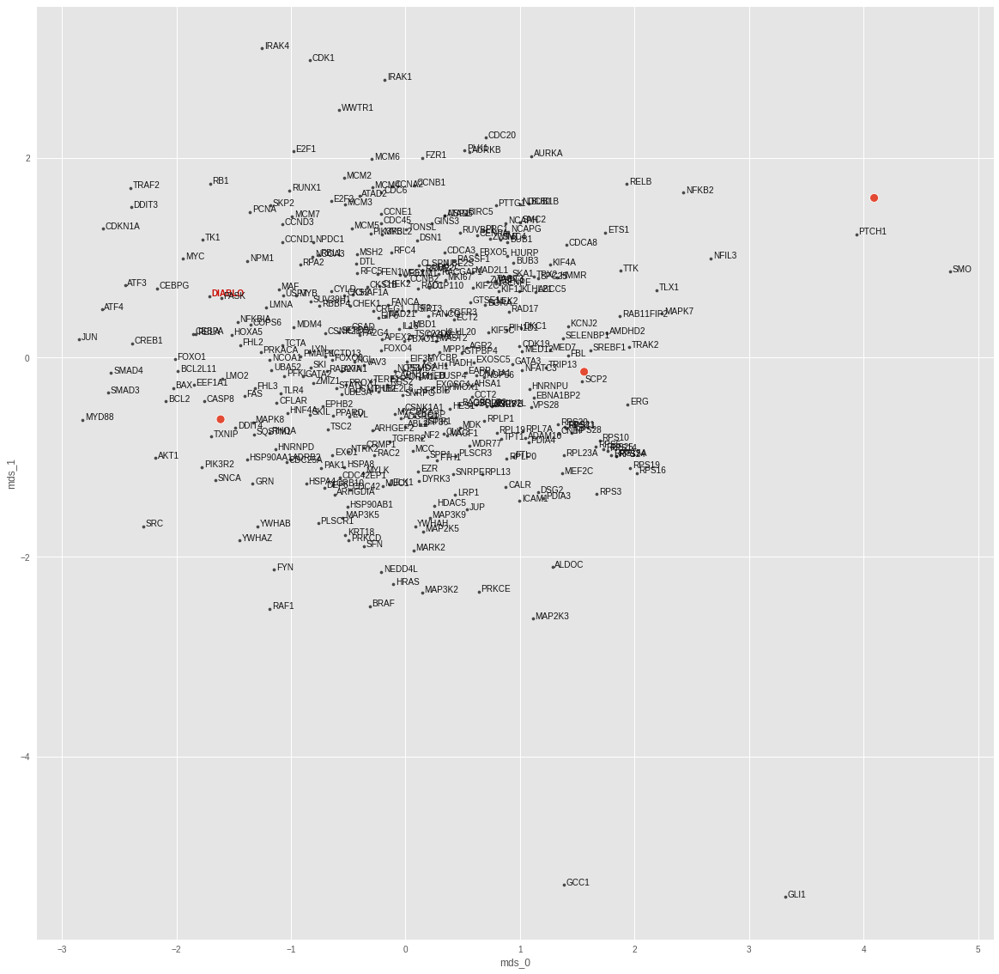

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00018073486146907248
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.010319731198251247
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


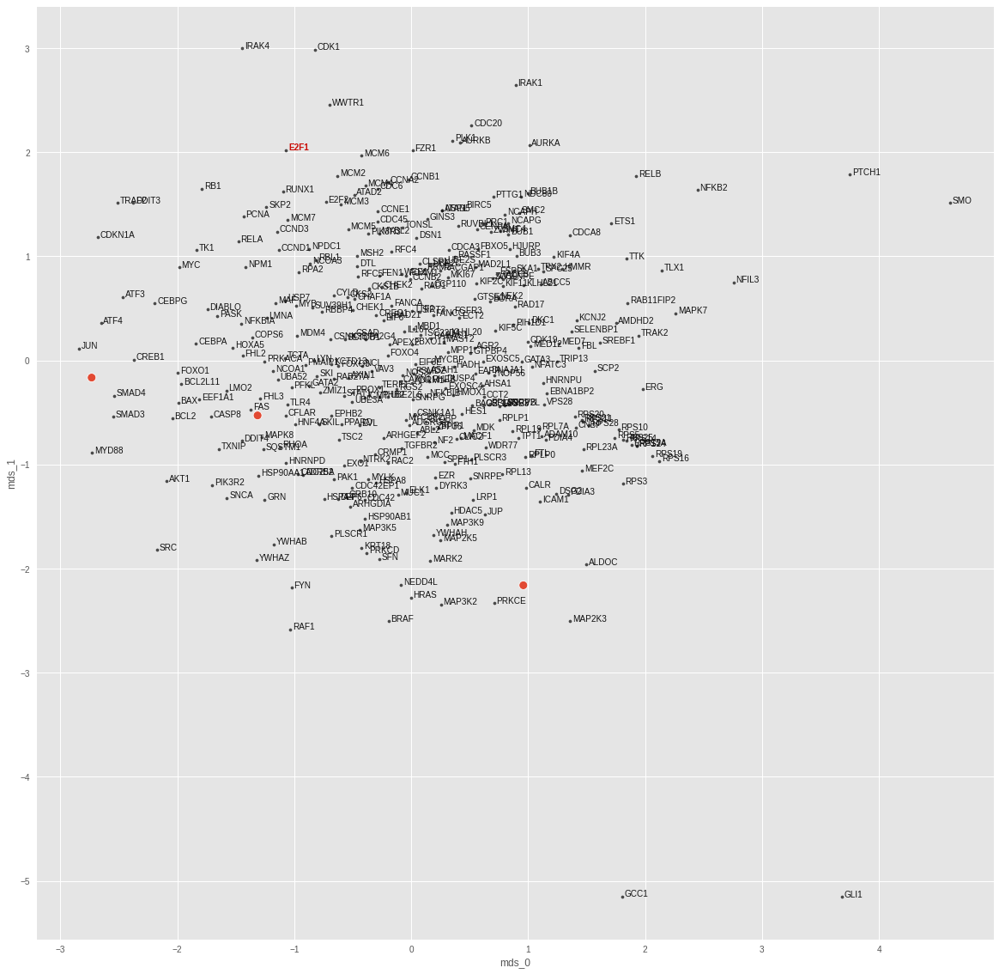

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00021383330382738127
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.018972842022776604
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


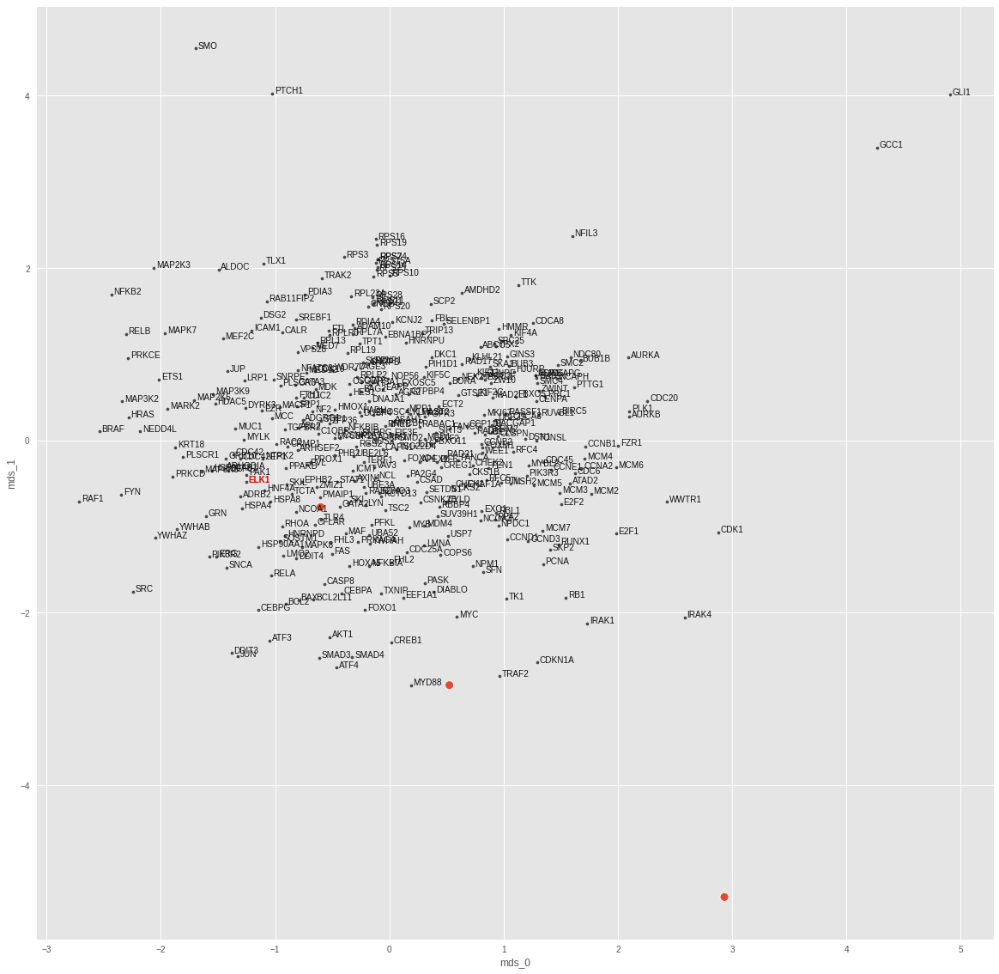

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017617723190326346
train top-k accuracies: {1: 0.936937, 3: 0.981982, 5: 0.990991, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006440272089093924
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


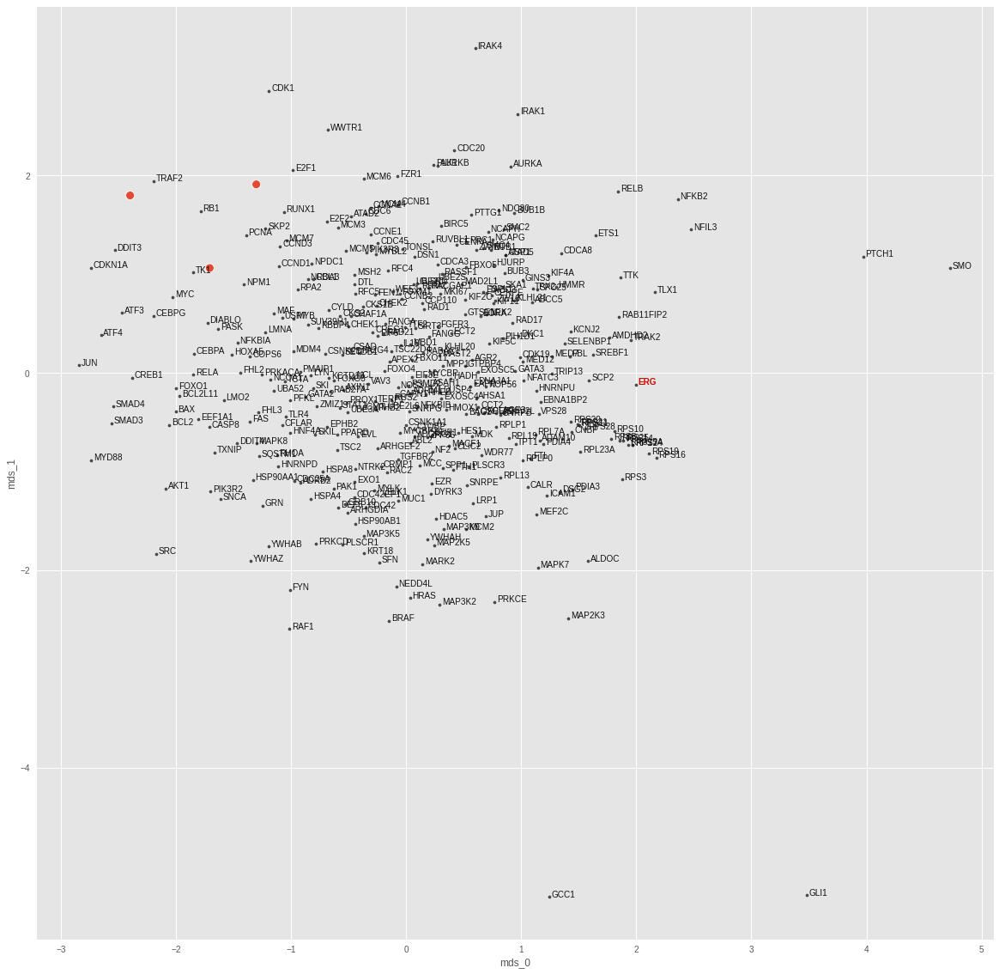

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00021777401333737716
train top-k accuracies: {1: 0.954955, 3: 0.981982, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.002838540356606245
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


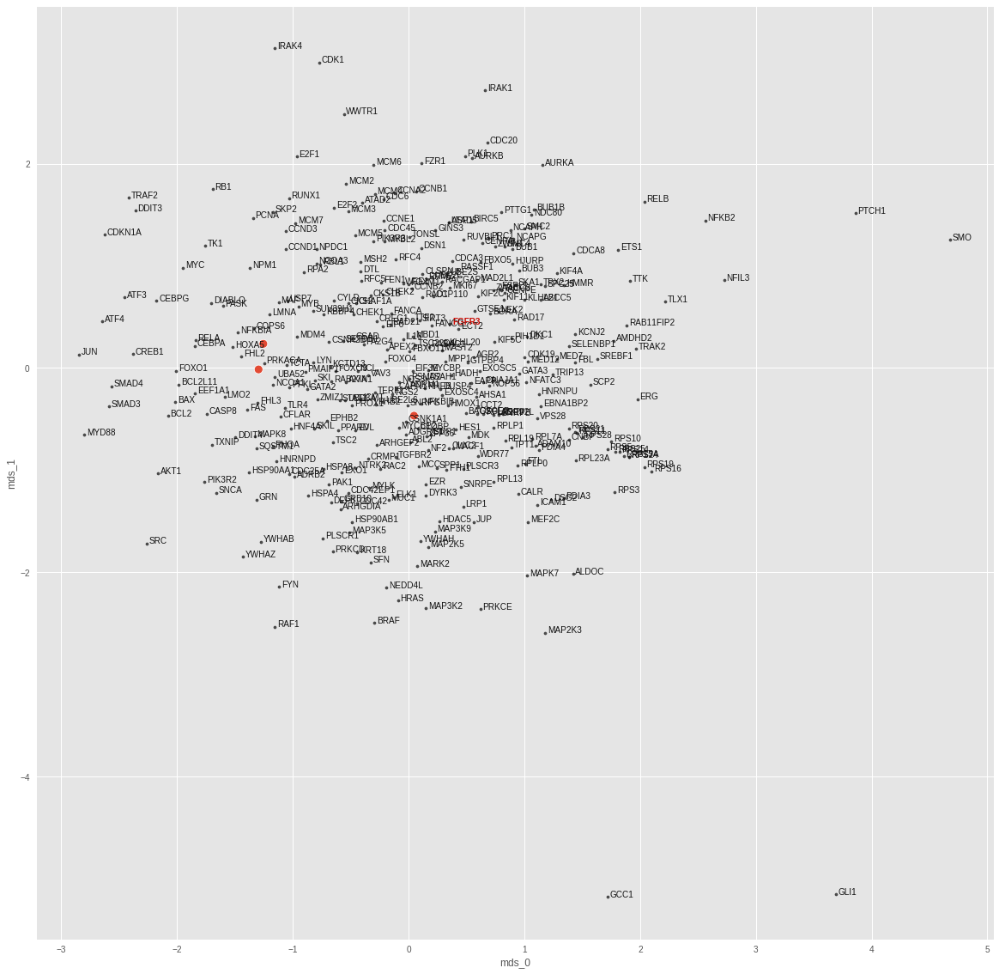

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0002197816327942099
train top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.011438335292041302
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


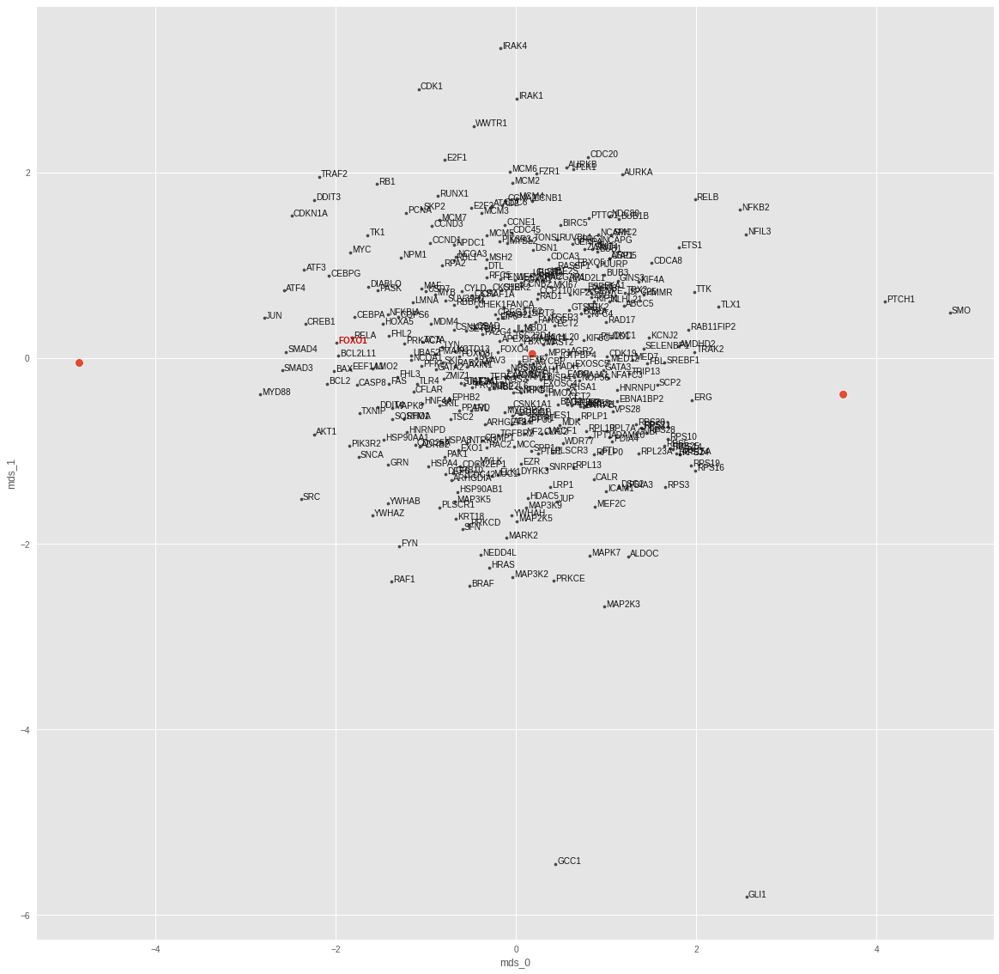

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017537363043982064
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.045352086424827576
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


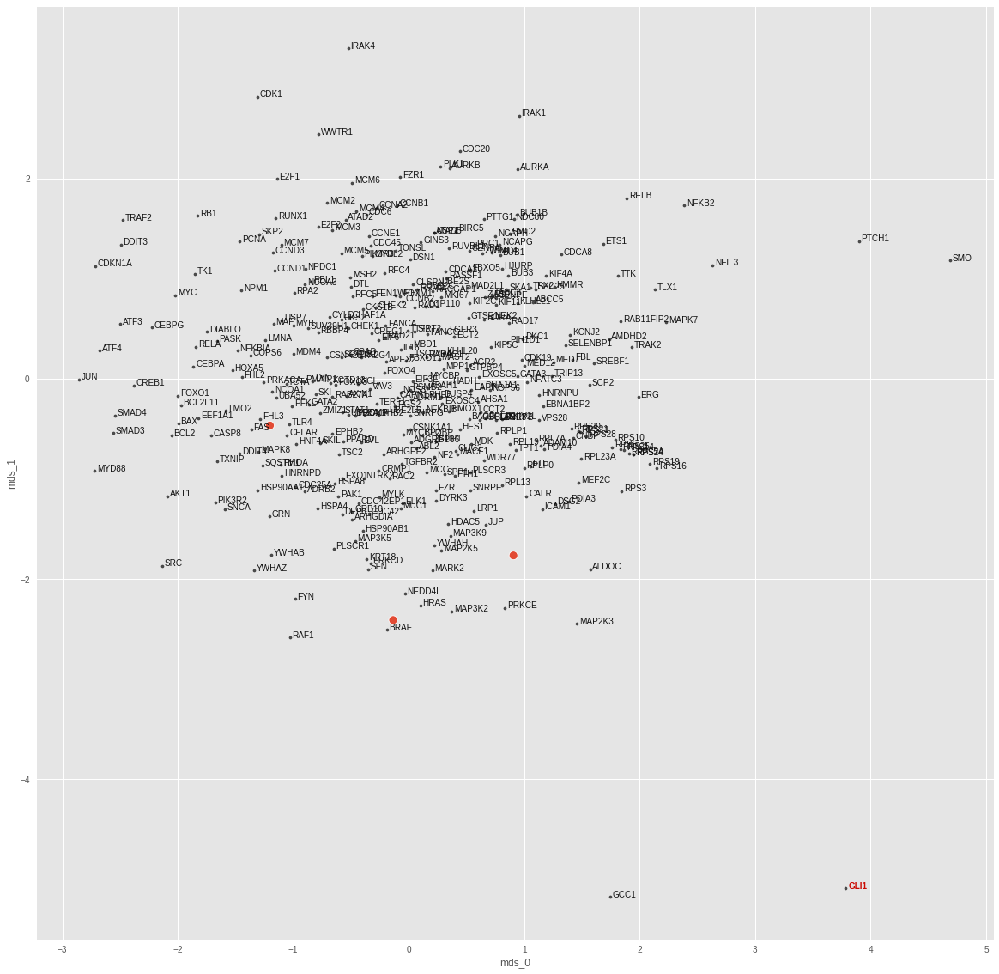

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000167621167870616
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.008693447336554527
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


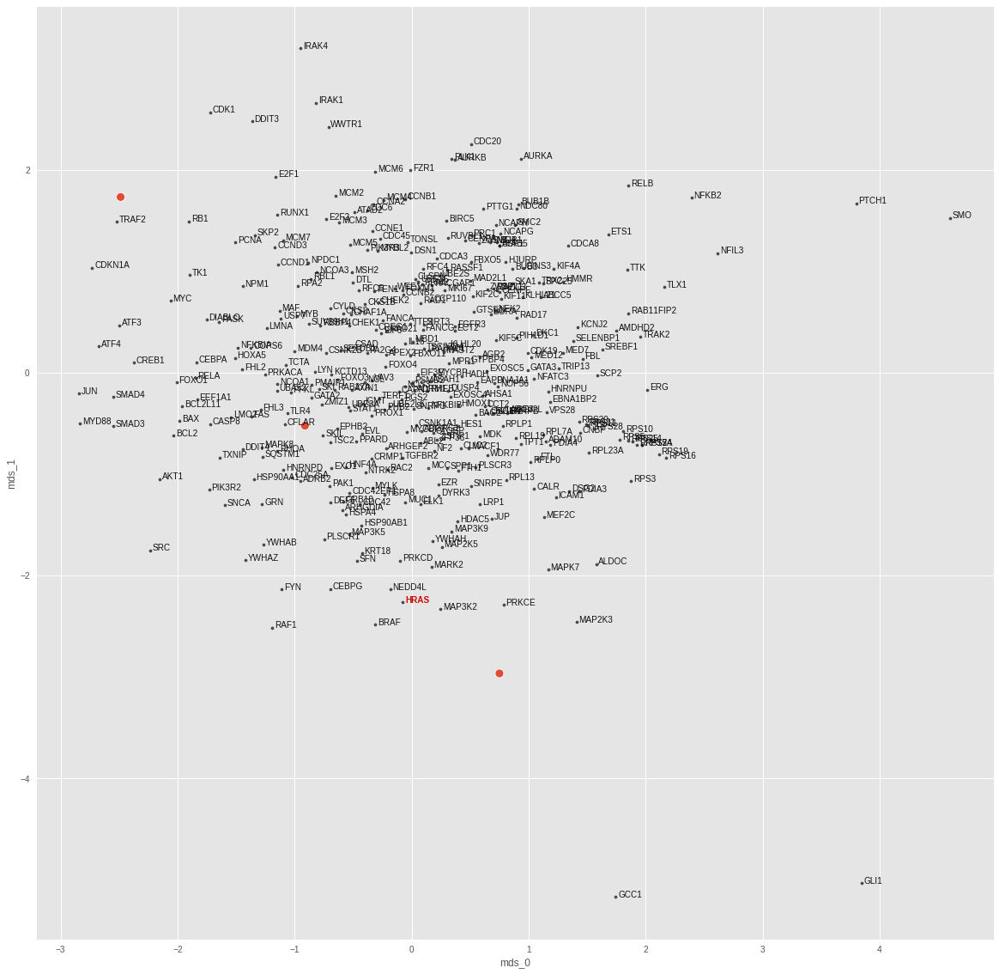

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00020968180209050073
train top-k accuracies: {1: 0.954955, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.014635945670306683
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


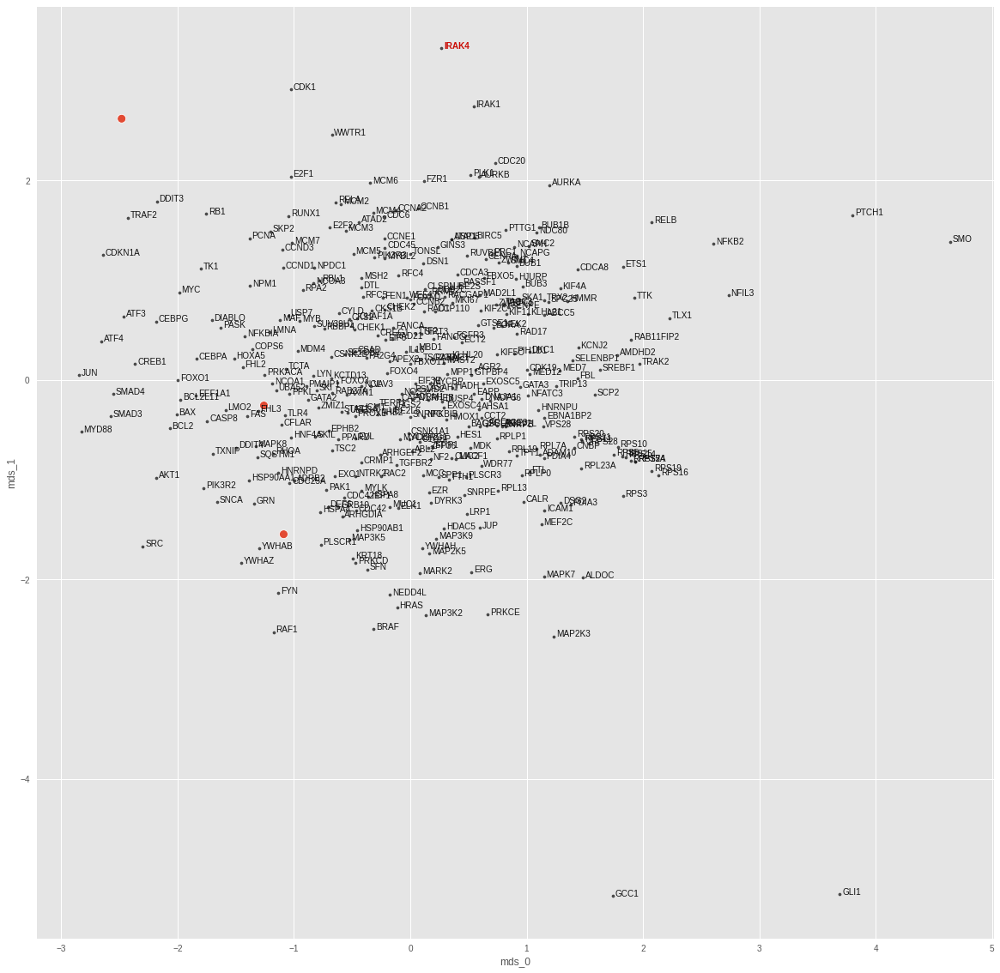

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001725081007231262
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.981982, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.019602078944444656
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


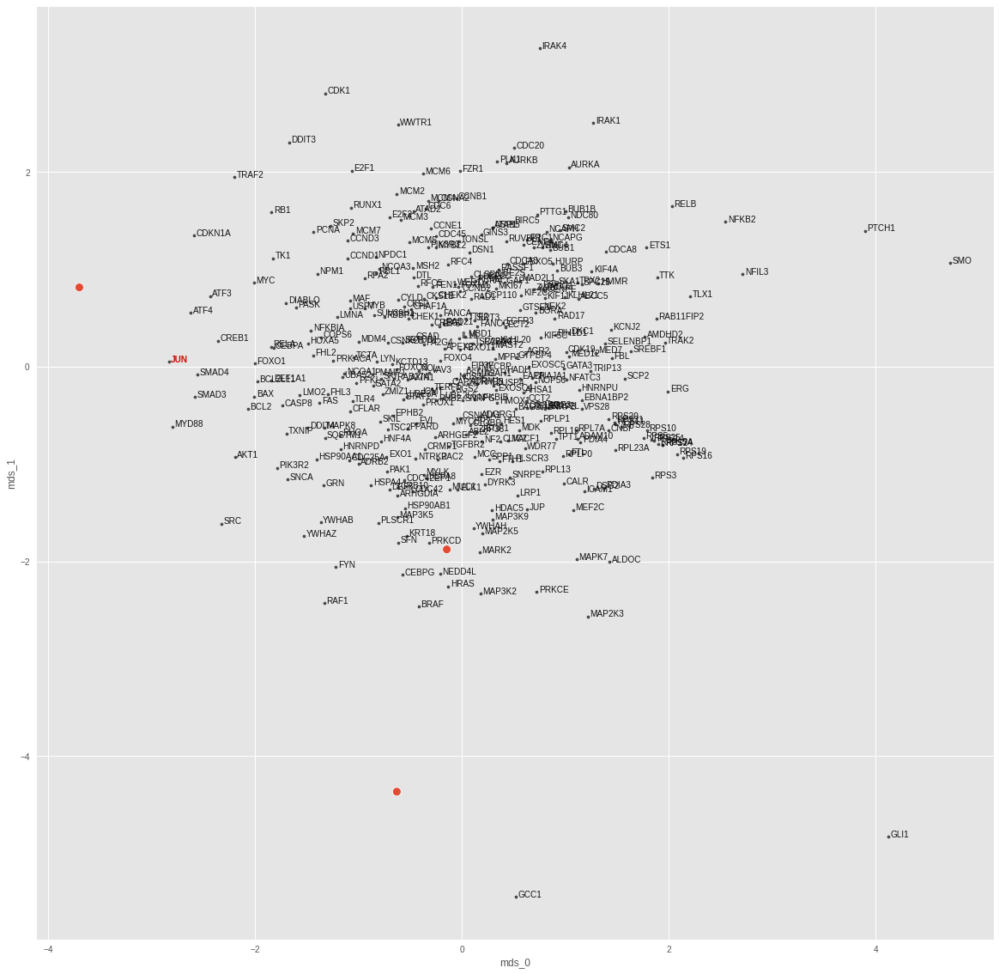

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00014844280116990007
train top-k accuracies: {1: 0.954955, 3: 0.981982, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.015762578696012497
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


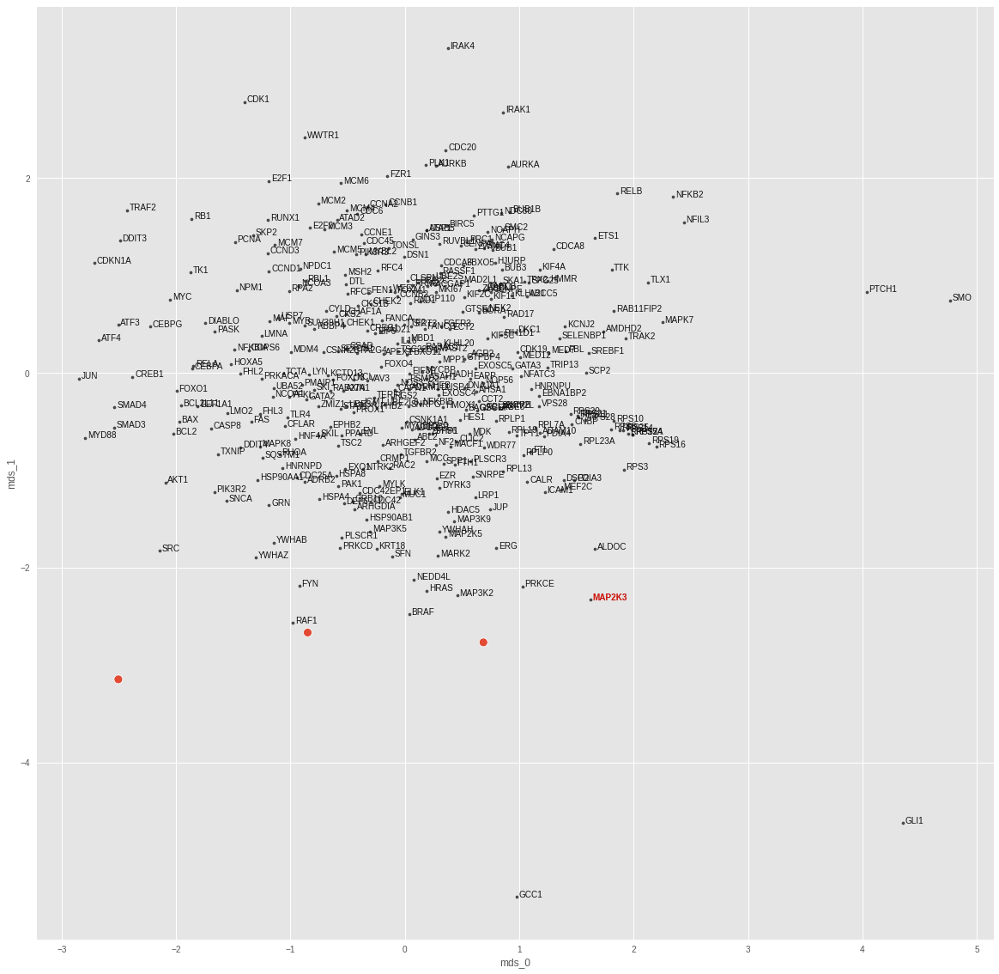

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000205822219507903
train top-k accuracies: {1: 0.936937, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.009756128303706646
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.666667, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


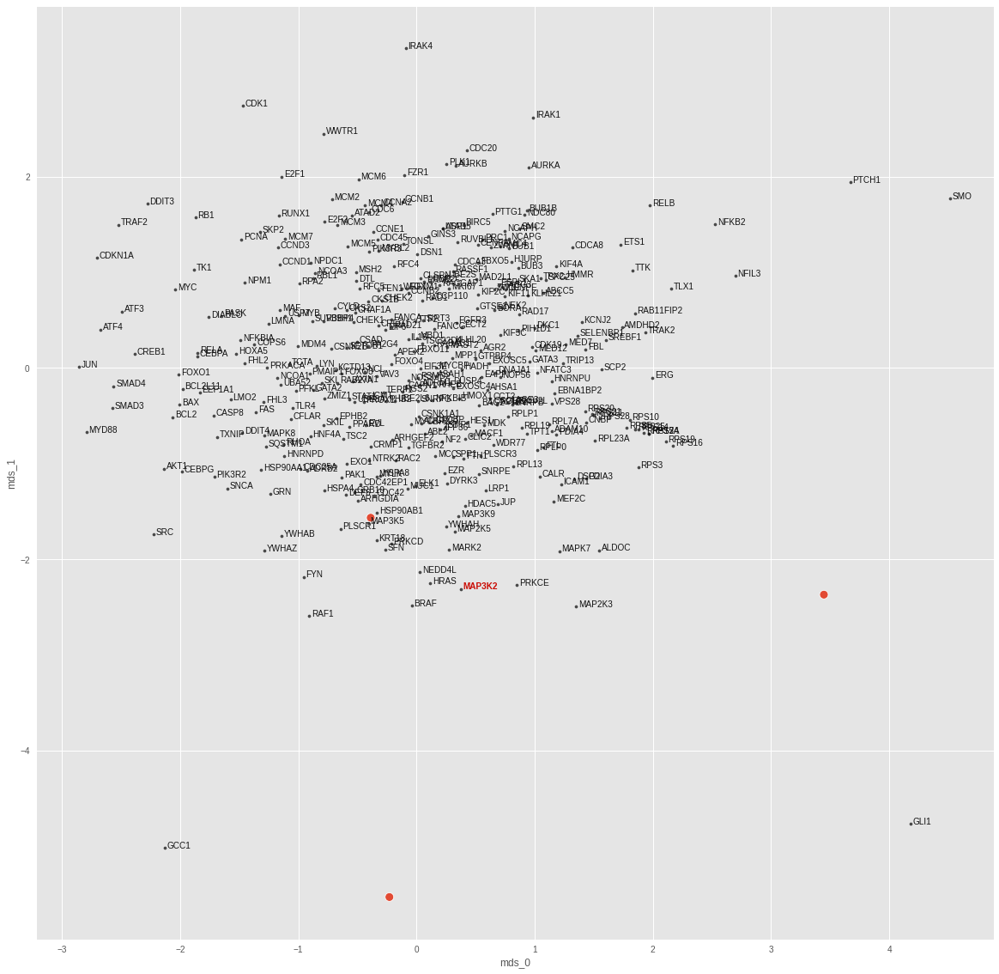

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00022998681084278064
train top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0052963001653552055
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 1.0, 20: 1.0, 50: 1.0}


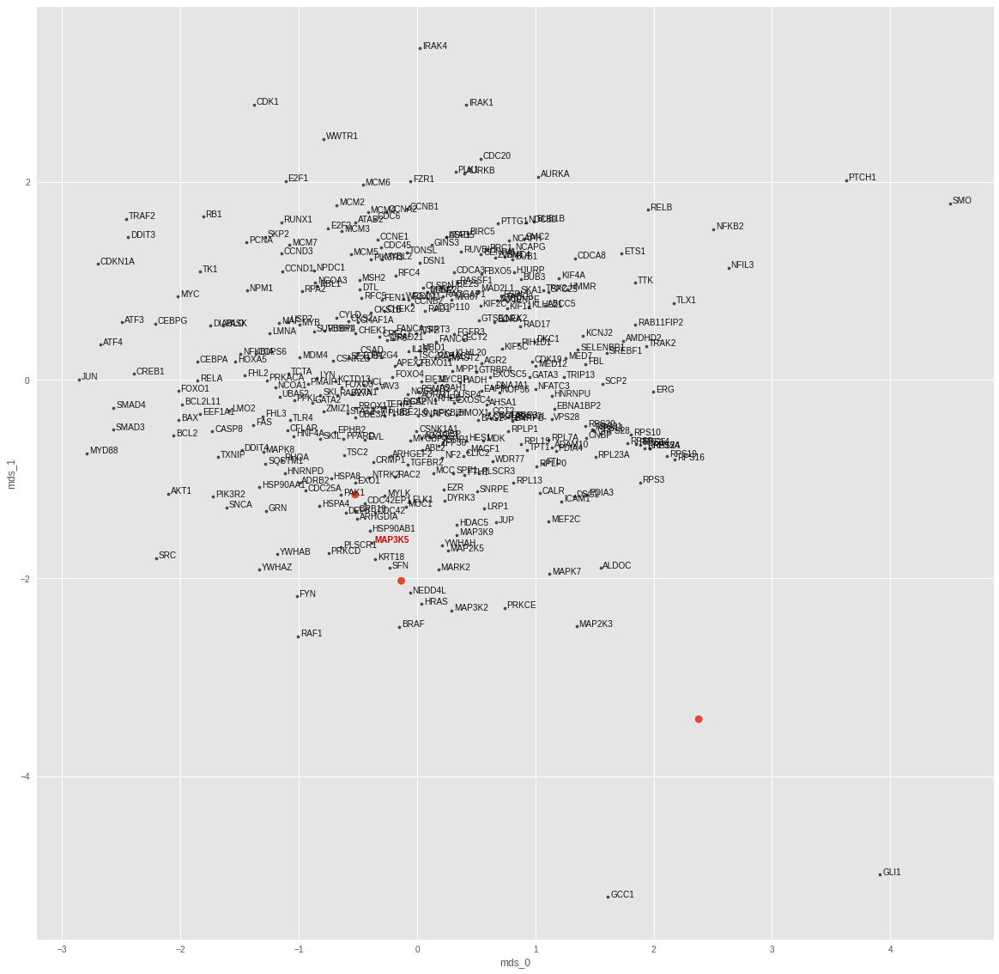

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017519522343472754
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.02058599703013897
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


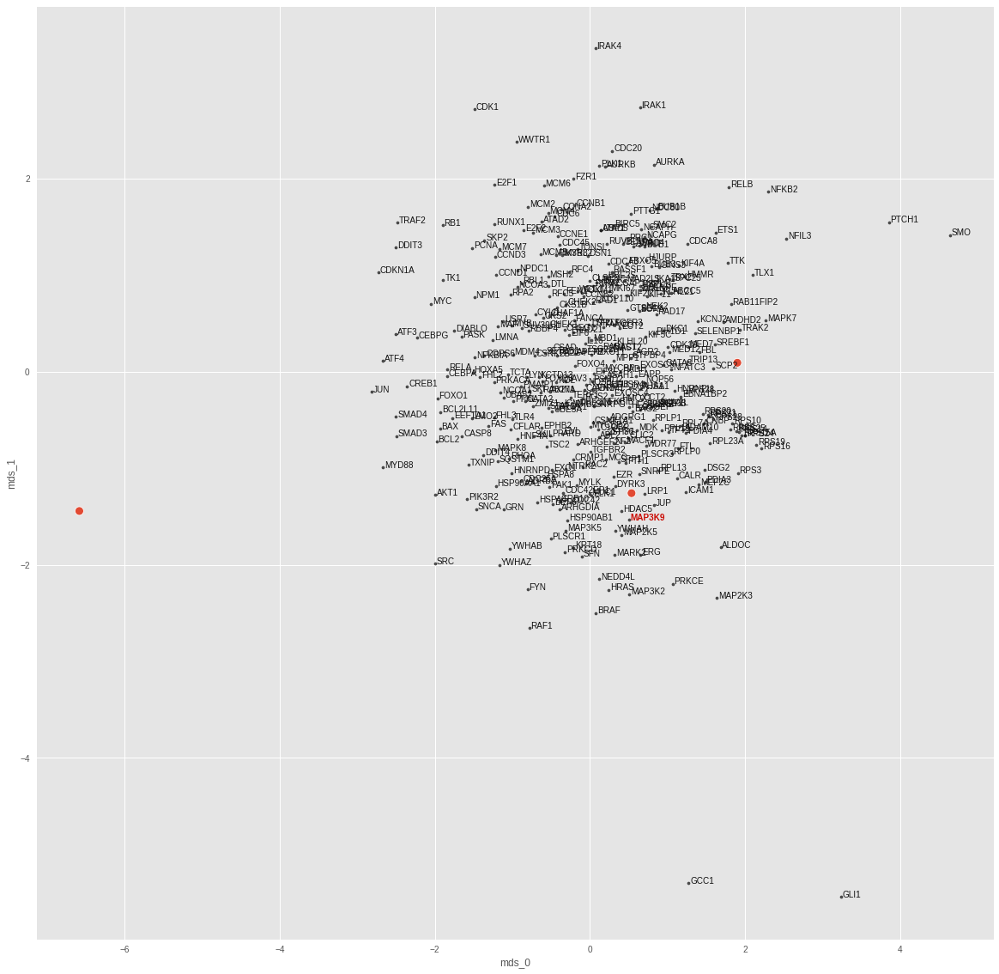

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00024426736693770564
train top-k accuracies: {1: 0.927928, 3: 0.972973, 5: 0.990991, 10: 0.990991, 20: 0.990991, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.008946328423917294
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


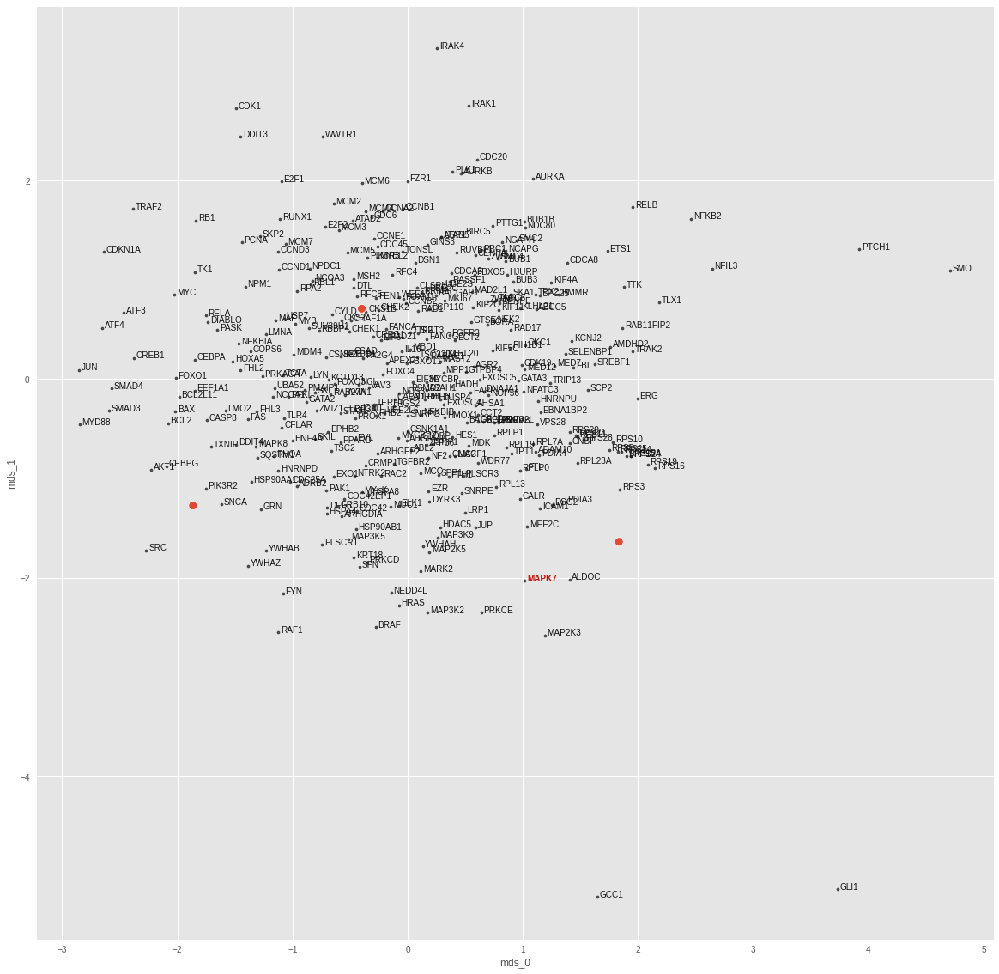

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001707232222543098
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.990991, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.014231148175895214
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


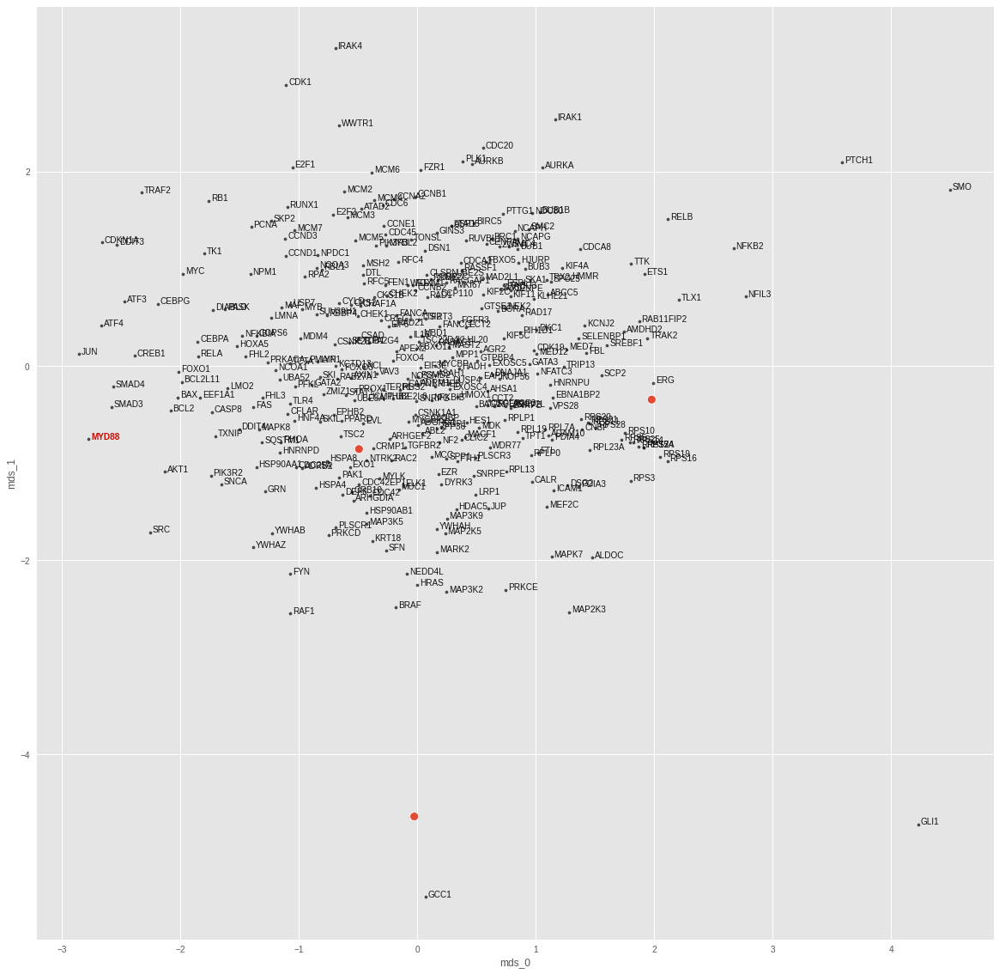

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017088220828644898
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006685062777251005
test top-k accuracies: {1: 0.333333, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


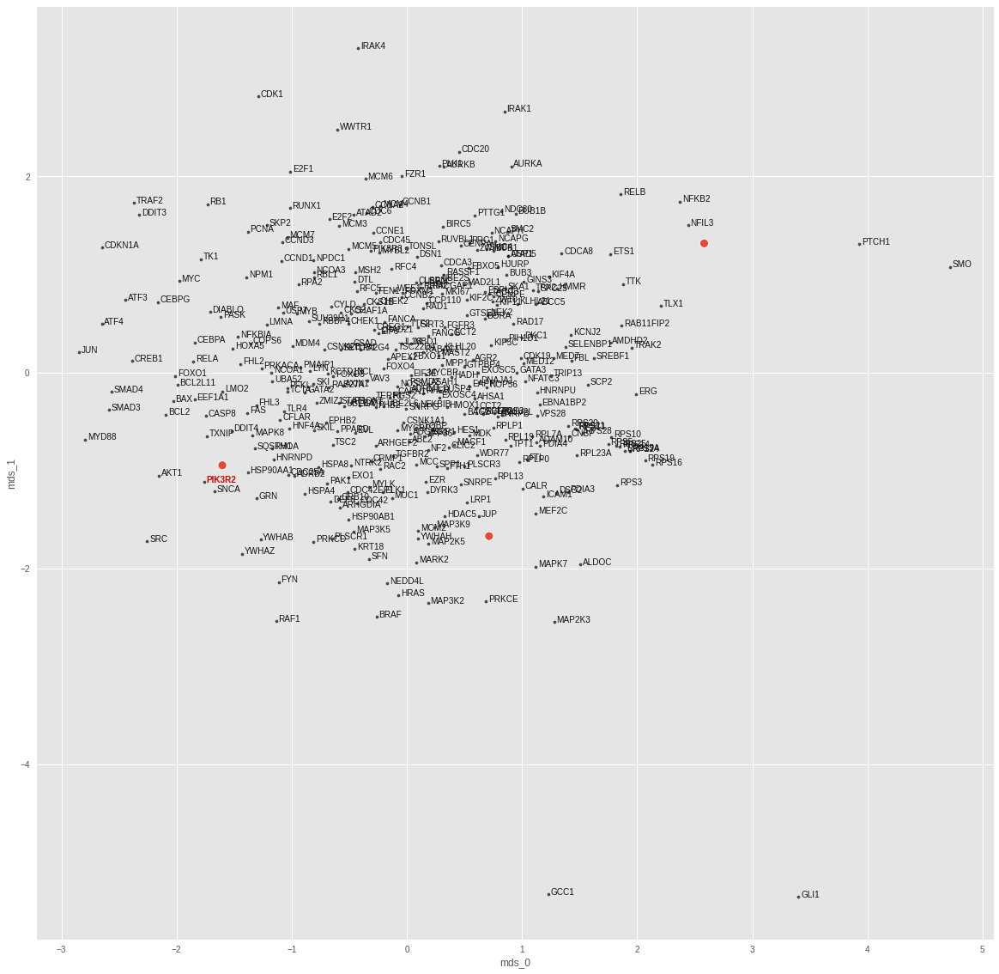

PRKACA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0002250081504514726
train top-k accuracies: {1: 0.936937, 3: 0.981982, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.009328807704150677
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


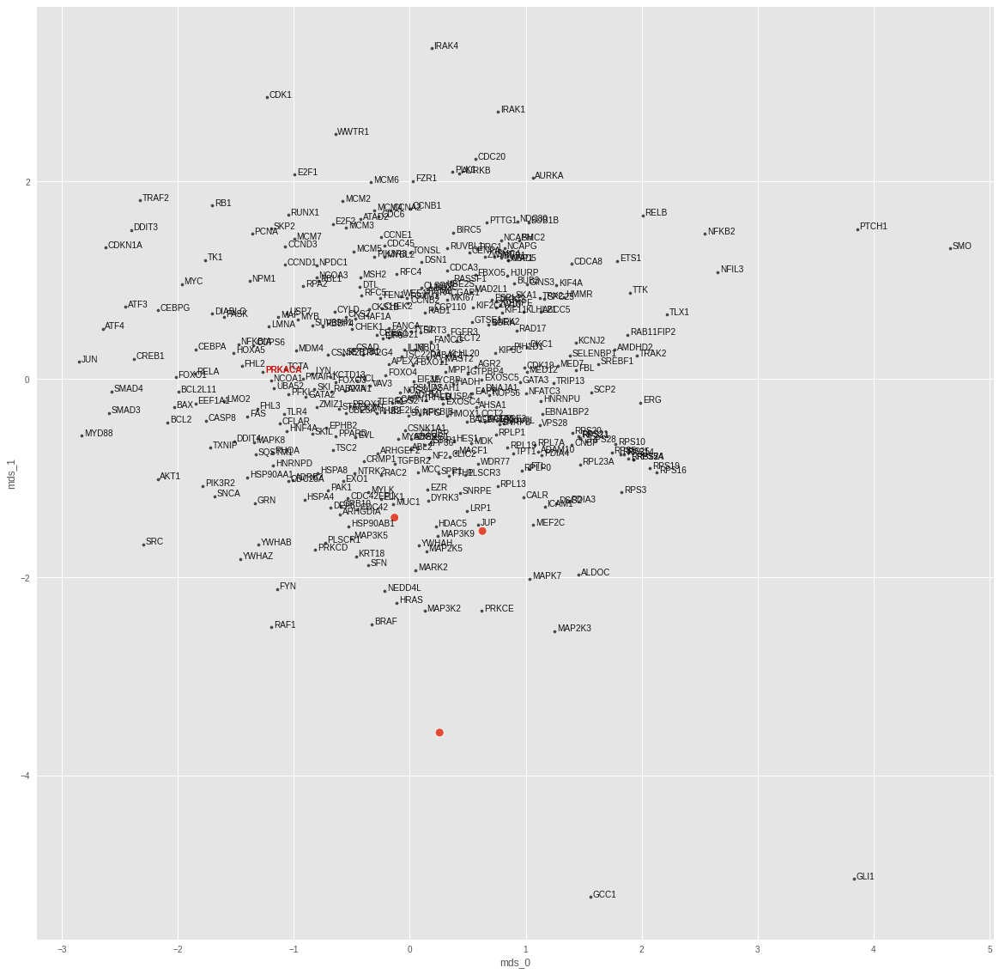

PRKCE
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00017295580887999218
train top-k accuracies: {1: 0.945946, 3: 0.990991, 5: 0.990991, 10: 0.990991, 20: 0.990991, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.011491609737277031
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


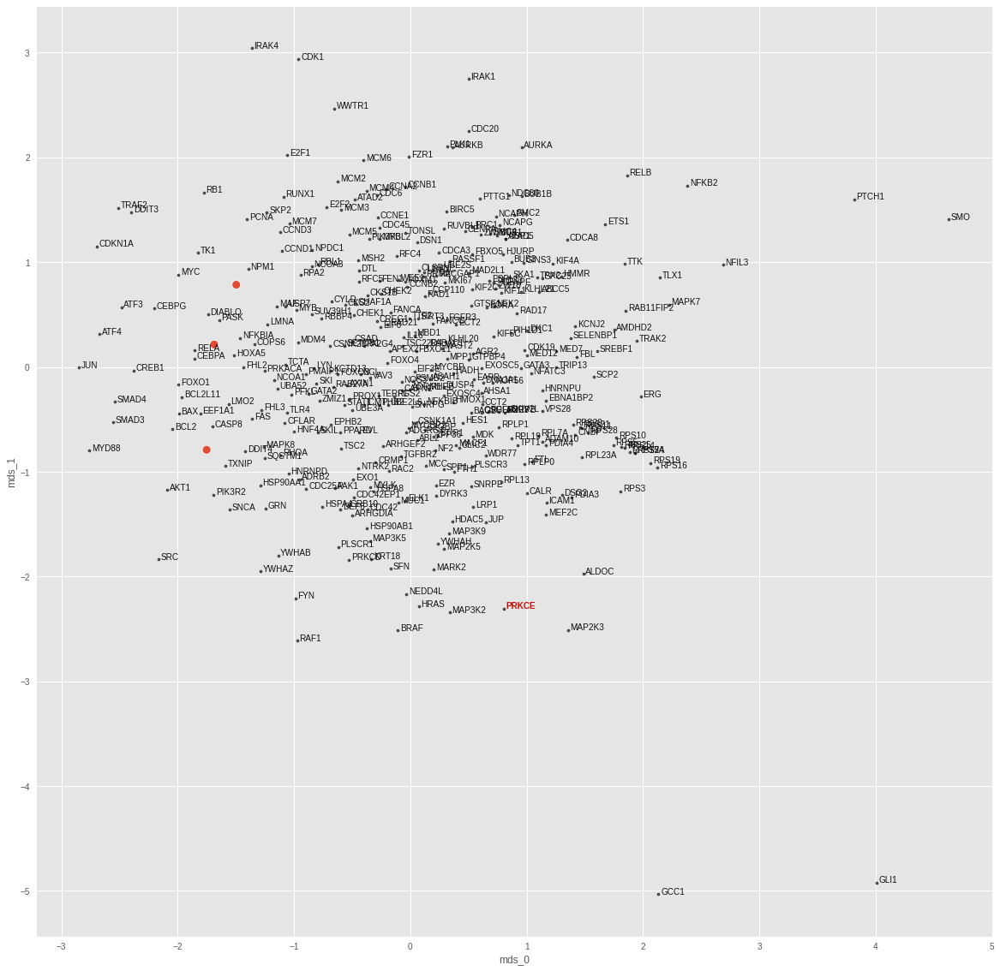

RAF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00019054475168567487
train top-k accuracies: {1: 0.936937, 3: 0.981982, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004891133401542902
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


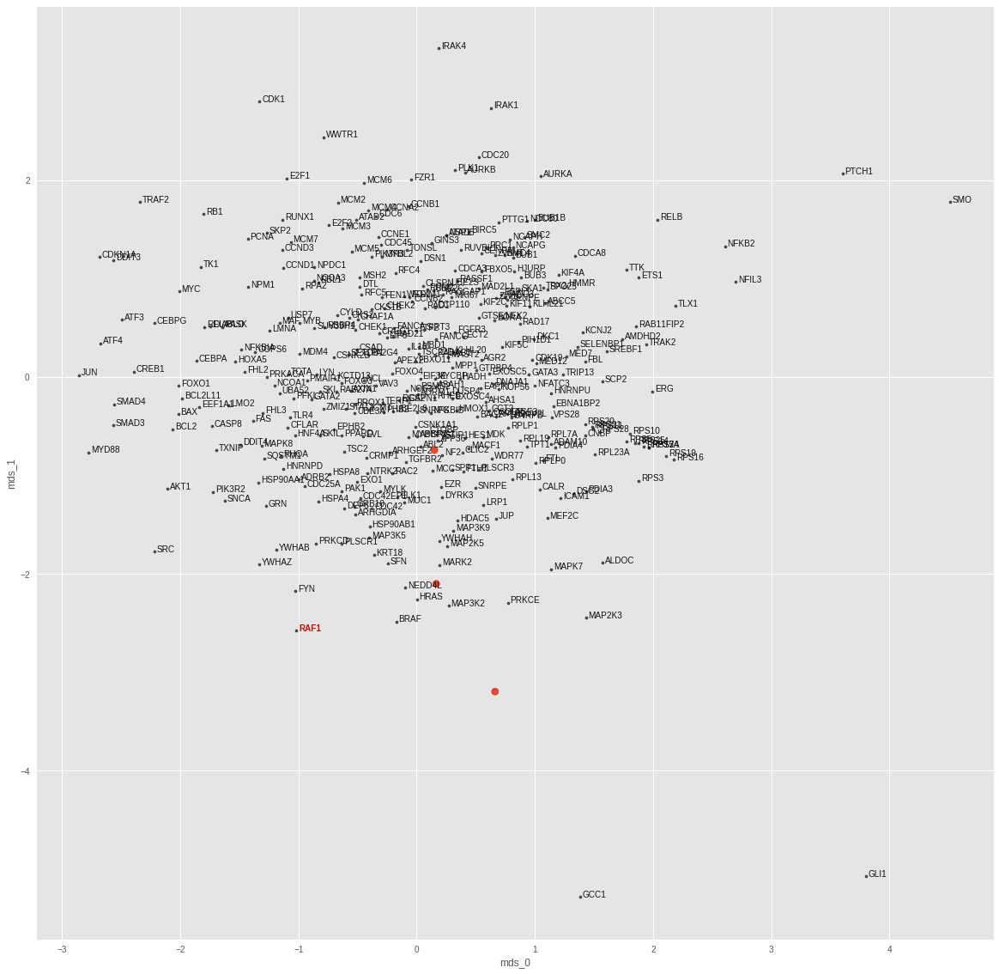

RELB
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00016380287903499462
train top-k accuracies: {1: 0.945946, 3: 0.981982, 5: 0.981982, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.02600391022861004
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


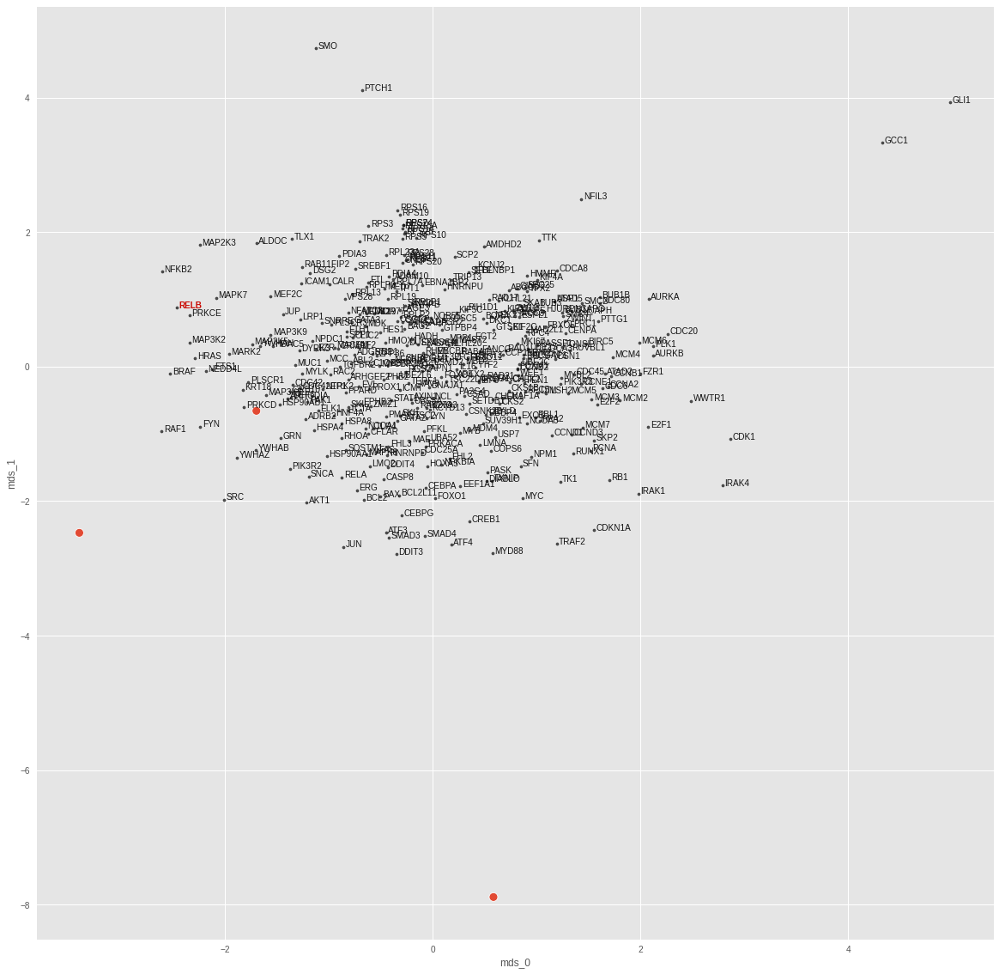

RHOA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00022057641750130265
train top-k accuracies: {1: 0.936937, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0033379800152033567
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


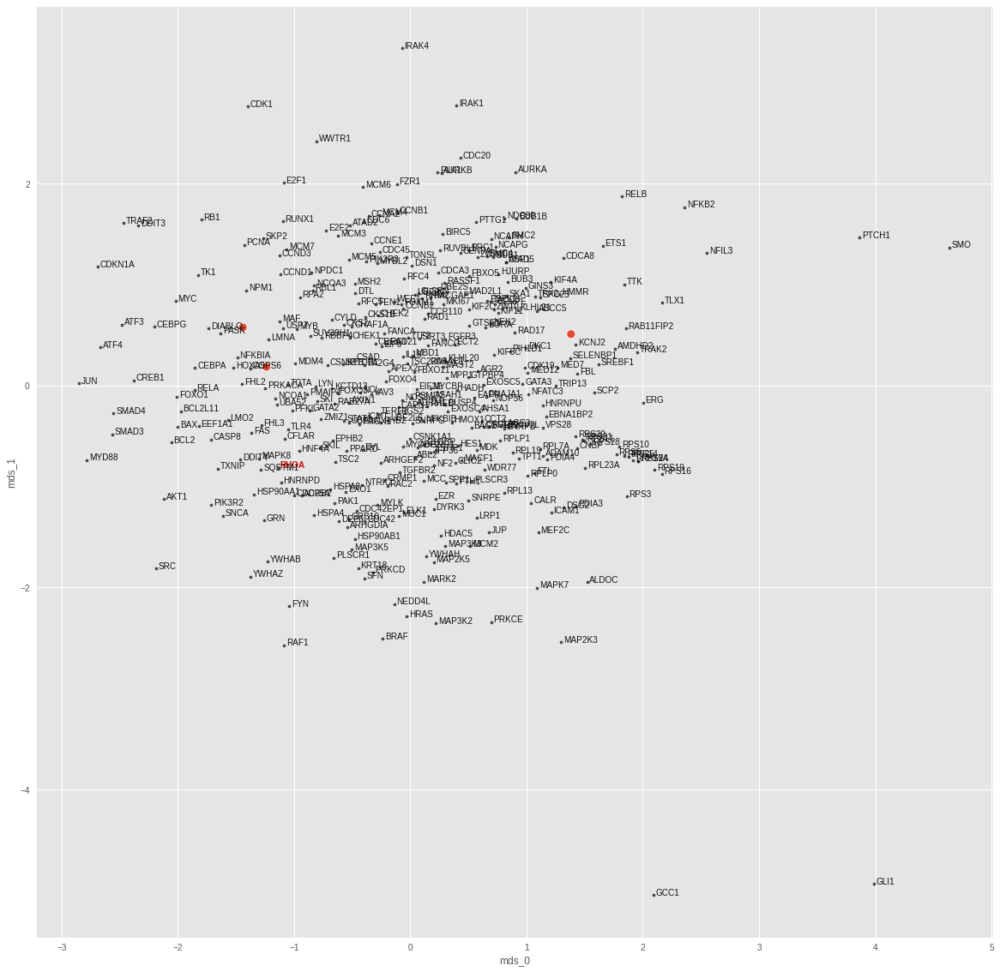

SMAD4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00020876372608498813
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 0.981982, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005002601072192192
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.666667, 20: 0.666667, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


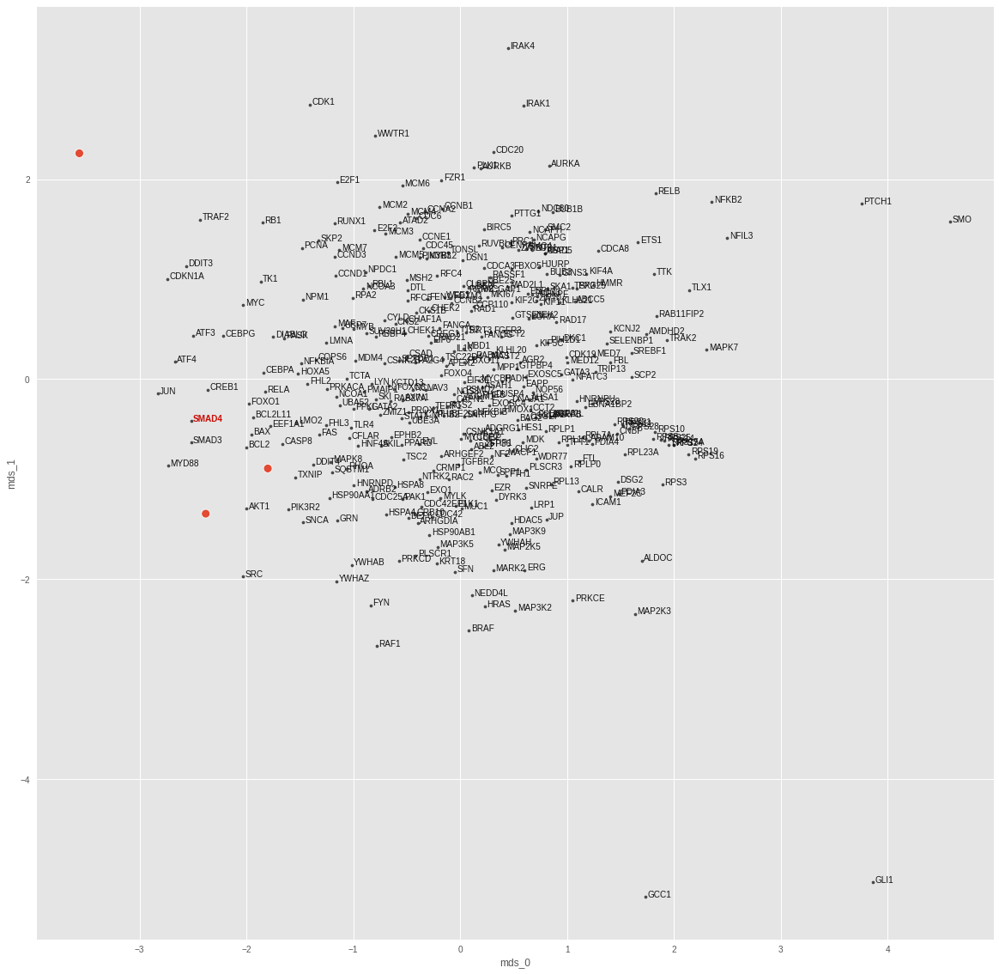

SMO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00012531744351354637
train top-k accuracies: {1: 0.963964, 3: 0.981982, 5: 0.981982, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.026414792984724045
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


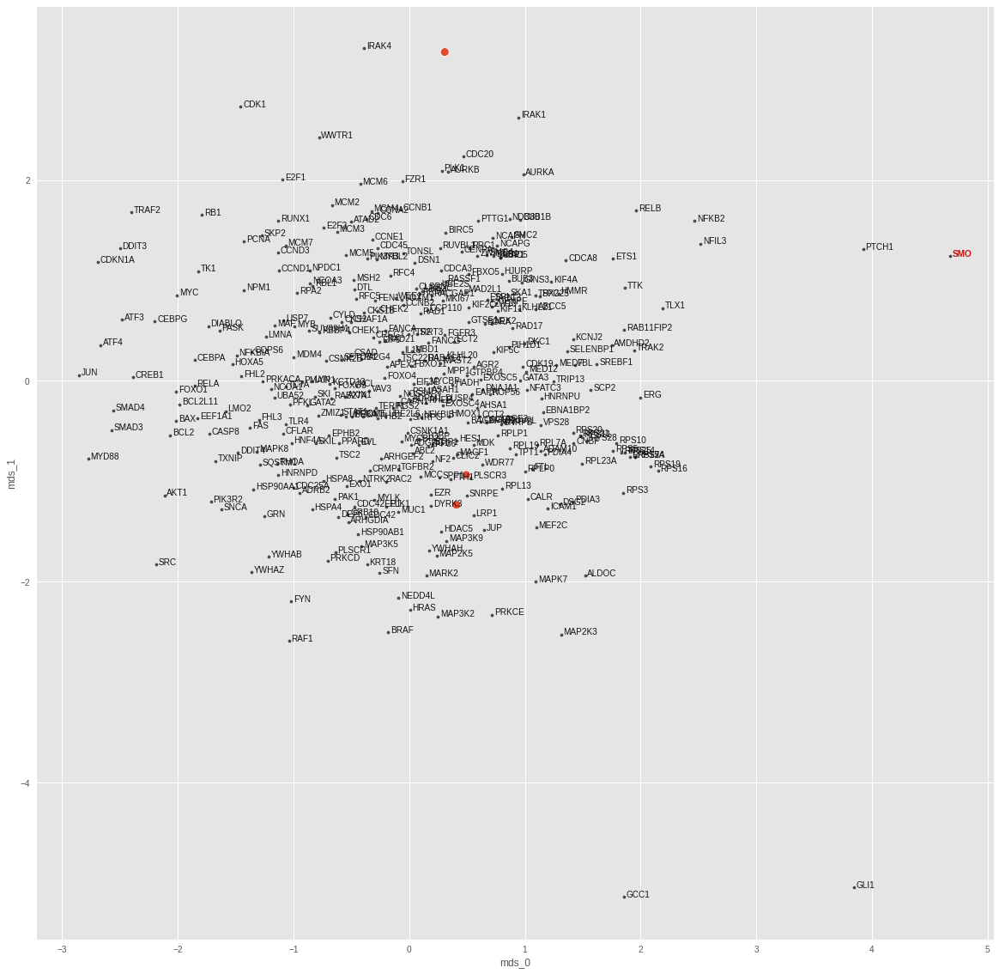

SRC
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.0001716924865881132
train top-k accuracies: {1: 0.936937, 3: 0.972973, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.012264350429177284
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


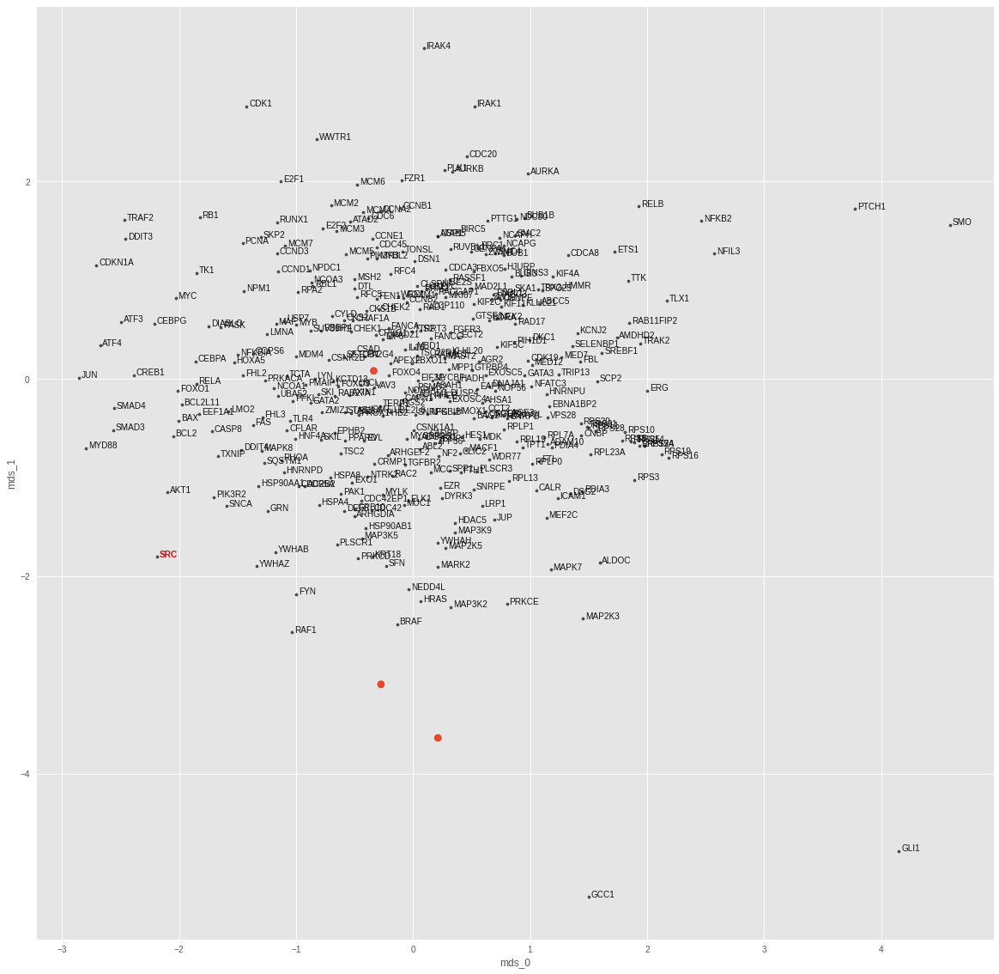

SREBF1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00018653226465716757
train top-k accuracies: {1: 0.936937, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0074927001260221004
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


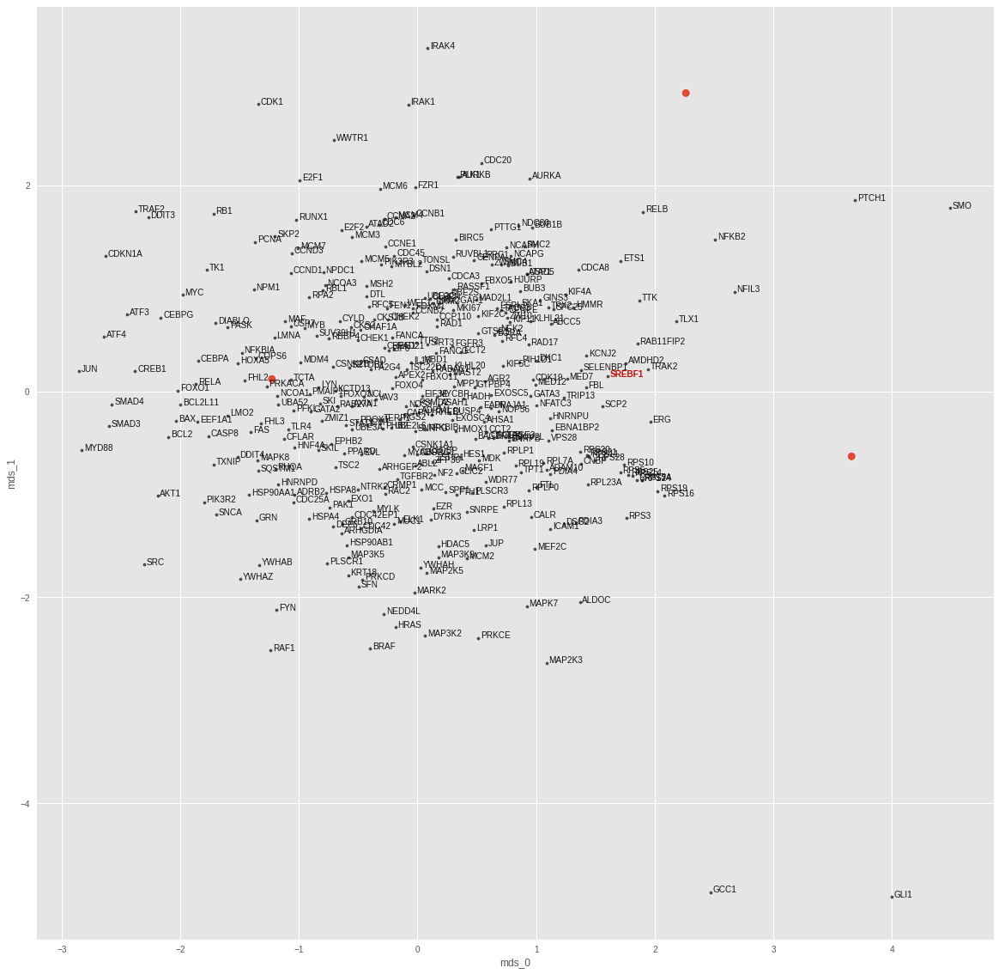

TRAF2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00020851776148570148
train top-k accuracies: {1: 0.945946, 3: 0.990991, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.918919, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.011405928060412407
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


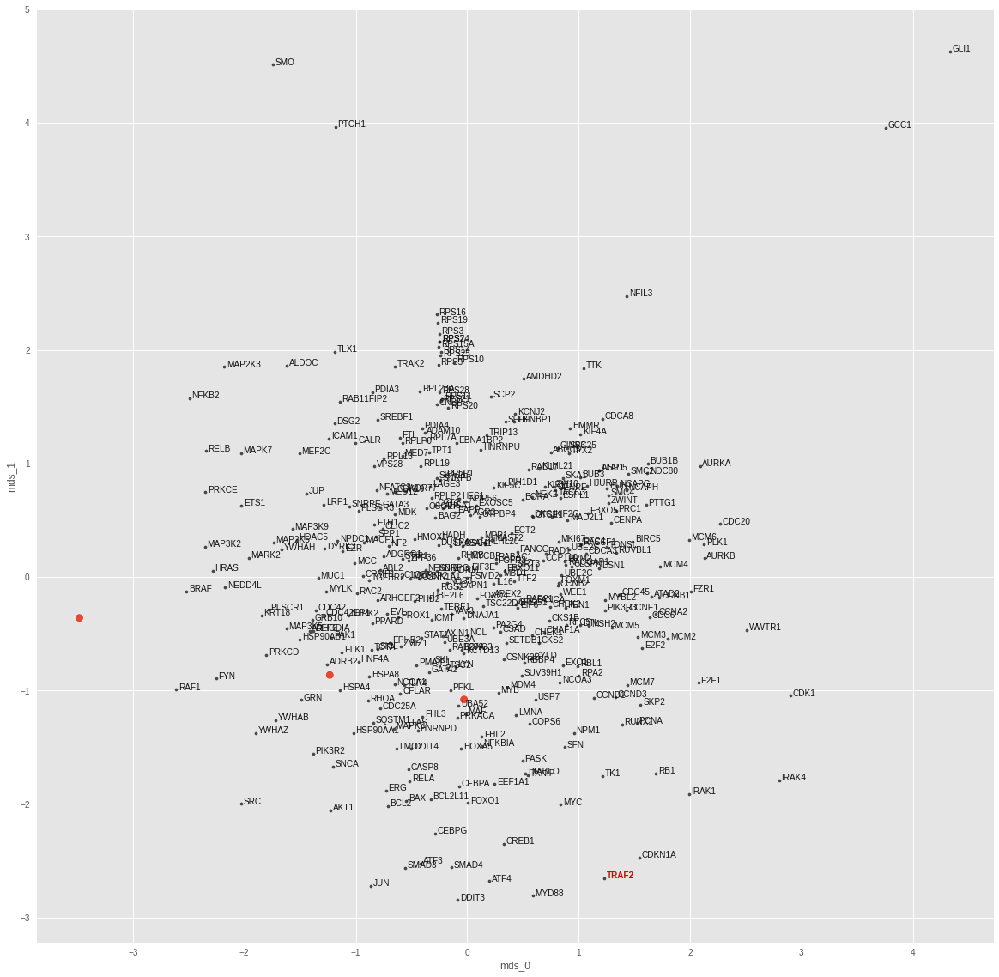

TSC2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.00016289207033460607
train top-k accuracies: {1: 0.936937, 3: 0.981982, 5: 0.990991, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.972973, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.029248427599668503
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


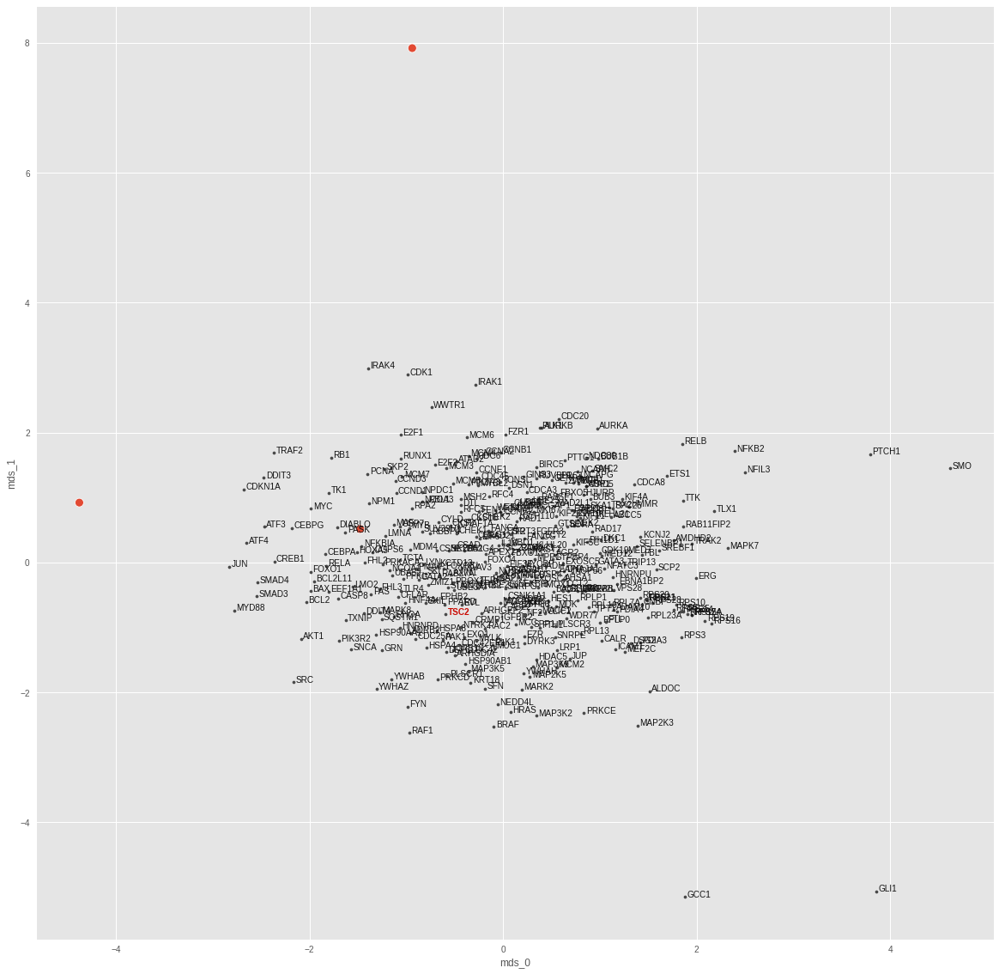

WWTR1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 0.000204671640604575
train top-k accuracies: {1: 0.945946, 3: 0.972973, 5: 0.981982, 10: 0.990991, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 0.945946, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.013411067426204681
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


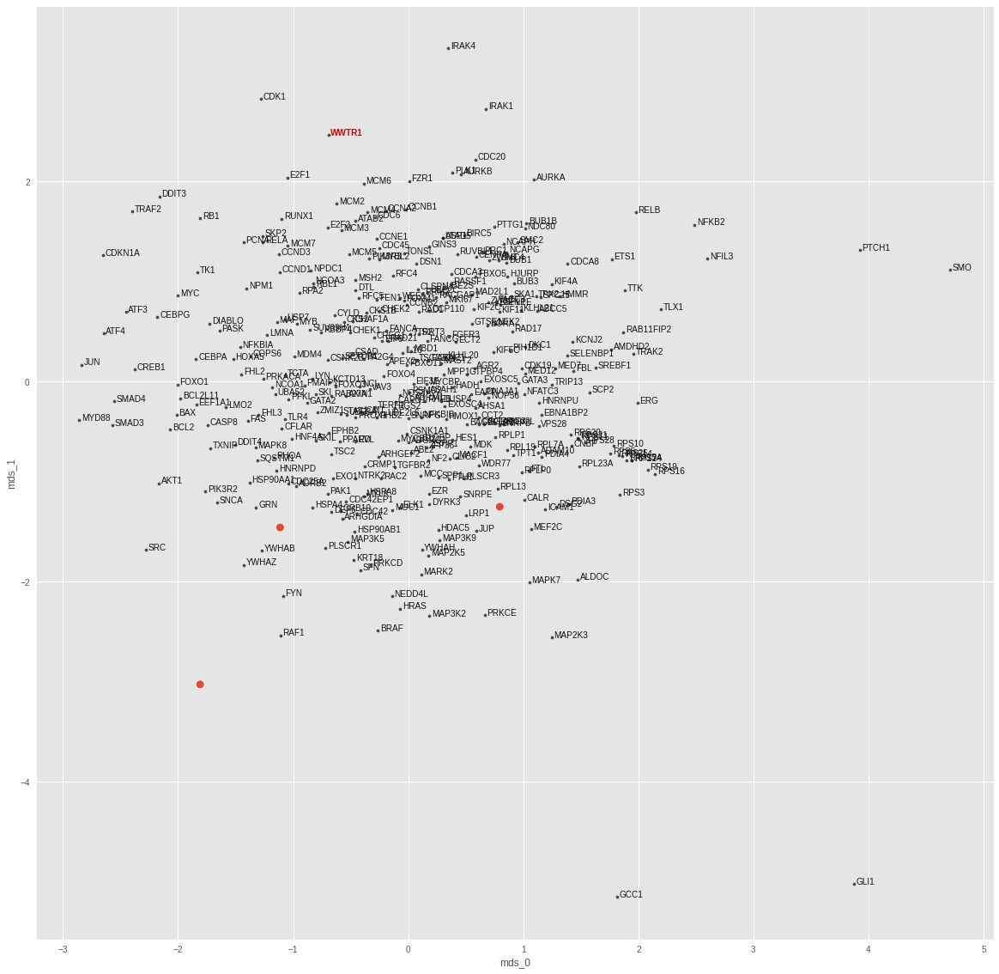

<IPython.core.display.Javascript object>

In [39]:
target_topk_accs = {}
cl_lin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(torch.nn.Linear(1024, 1024))
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    cl_lin_nns_dict[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [40]:
cl_lin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_lin_topk_df.loc[cl_lin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

,1,3,5,10,20,50
SREBF1,0.0,1.0,1.0,1.0,1.0,1.0
MAP3K2,0.0,0.0,1.0,1.0,1.0,1.0
SMAD4,0.0,0.0,1.0,1.0,1.0,1.0
CDC42,0.0,0.0,0.0,1.0,1.0,1.0
CEBPA,0.0,0.0,0.0,1.0,1.0,1.0
MAP3K5,0.0,0.0,0.0,1.0,1.0,1.0
FOXO1,0.0,0.0,0.0,0.0,1.0,1.0
BCL2L11,0.0,0.0,0.0,0.0,0.0,1.0
RAF1,0.0,0.0,0.0,0.0,0.0,1.0


<IPython.core.display.Javascript object>

In [41]:
cl_lin_topk_df.describe()

,1,3,5,10,20,50
count,38.0,38.000000,38.000000,38.000000,38.000000,38.000000
mean,0.0,0.026316,0.078947,0.157895,0.184211,0.236842
std,0.0,0.162221,0.273276,0.369537,0.392859,0.430851
min,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.0,0.000000,0.000000,0.000000,0.000000,0.000000
max,0.0,1.000000,1.000000,1.000000,1.000000,1.000000


<IPython.core.display.Javascript object>

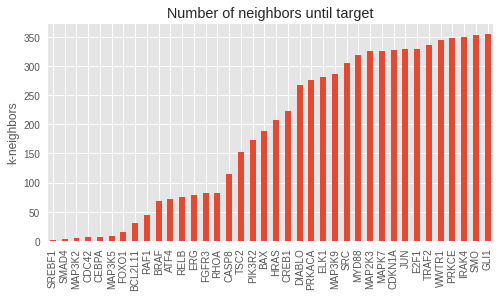

<IPython.core.display.Javascript object>

In [42]:
mpl.style.use("ggplot")
cl_lin_khits = get_knn_hit_data(cl_lin_nns_dict)
ax = cl_lin_khits.knn_hit.sort_values().plot(kind="bar", figsize=[8, 4])
ax.set_ylabel("k-neighbors")
ax.set_title("Number of neighbors until target")
plt.show()

In [43]:
cl_img_embs, _, cl_labels = cl_img_node_embs_dict["fold0"]
centroid_5nn_dict = get_centroid_knn_dict(cl_img_embs, cl_labels, k=5)
centroid_5nn_dict["ELK1"]

['MAP3K9', 'SMAD4', 'E2F1', 'PRKACA', 'ATF4']

<IPython.core.display.Javascript object>

In [44]:
cl_lin_nns_dict["ELK1"][:5]

array(['MYD88', 'PFKL', 'FAS', 'IRAK1', 'CASP8'], dtype='<U9')

<IPython.core.display.Javascript object>

In [45]:
cl_lin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
cl_lin_nn_topk = get_topk_acc_from_nn_dict(cl_lin_nns_dict, ks=ks)
cl_lin_result = cl_lin_nn_topk.mean()
for k in ks:
    cl_lin_results["topk_acc"].append(cl_lin_result.loc["top-{}".format(k)])
    cl_lin_results["k"].append(k)
cl_lin_results = pd.DataFrame(cl_lin_results)

<IPython.core.display.Javascript object>

---

### 3.6. Non-linear 4-centroids mapping

  0%|          | 0/38 [00:00<?, ?it/s]

ATF4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.544011875897382e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0038803699426352978
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


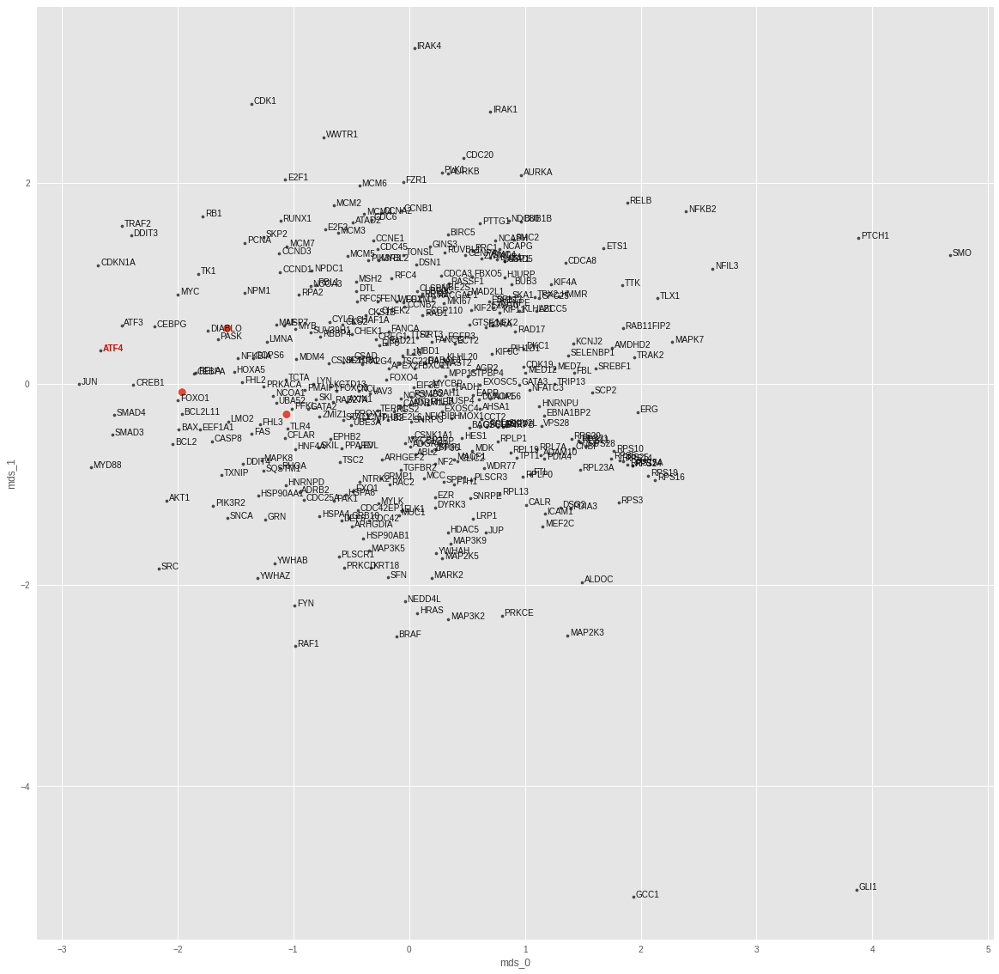

BAX
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.046680612543594e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0060691386461257935
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


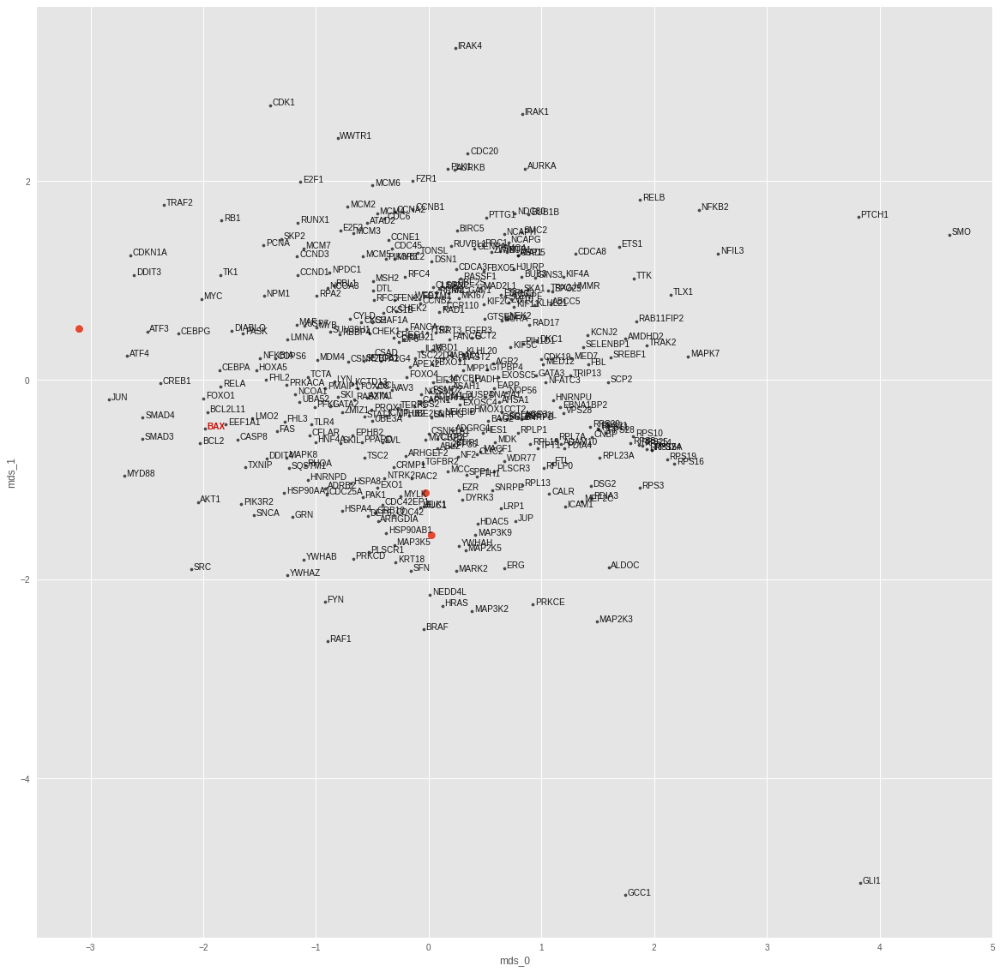

BCL2L11
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.894970996053113e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006662684492766857
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 1.0, 50: 1.0}


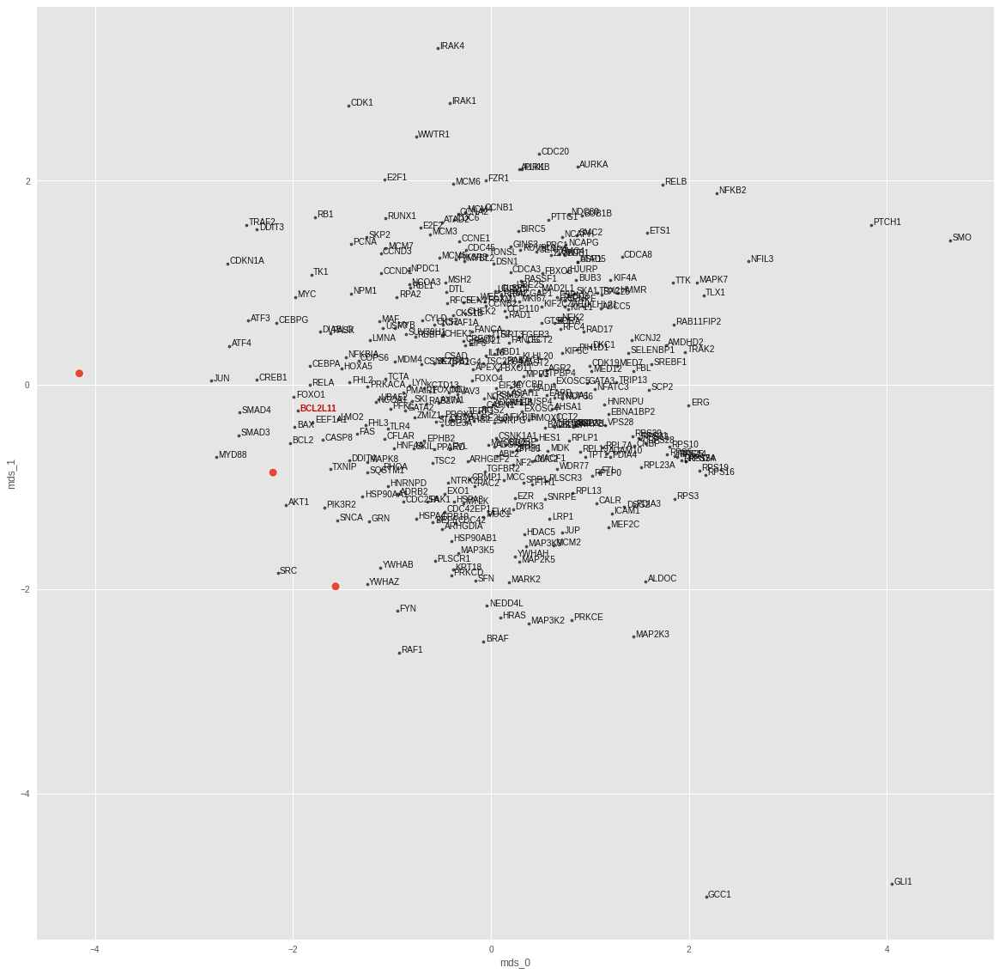

BRAF
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.385546416264481e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004022106993943453
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


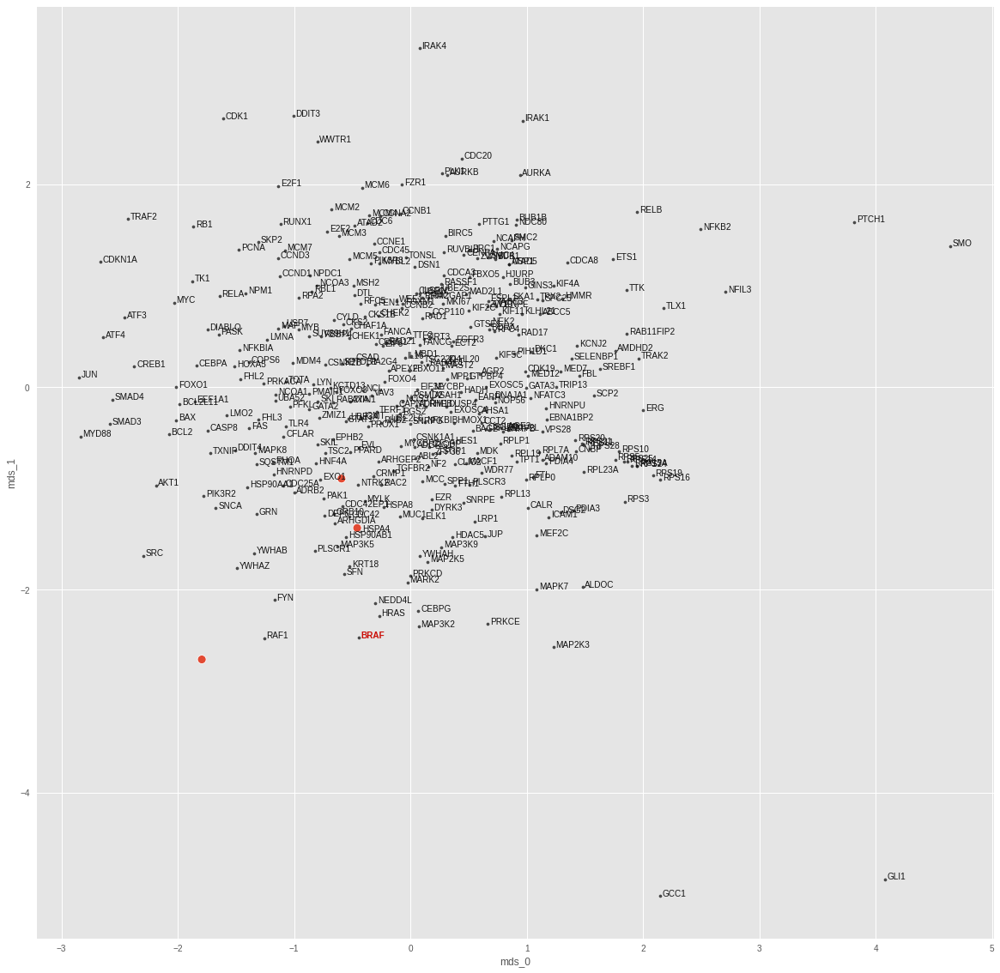

CASP8
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.882687833246163e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005649722181260586
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


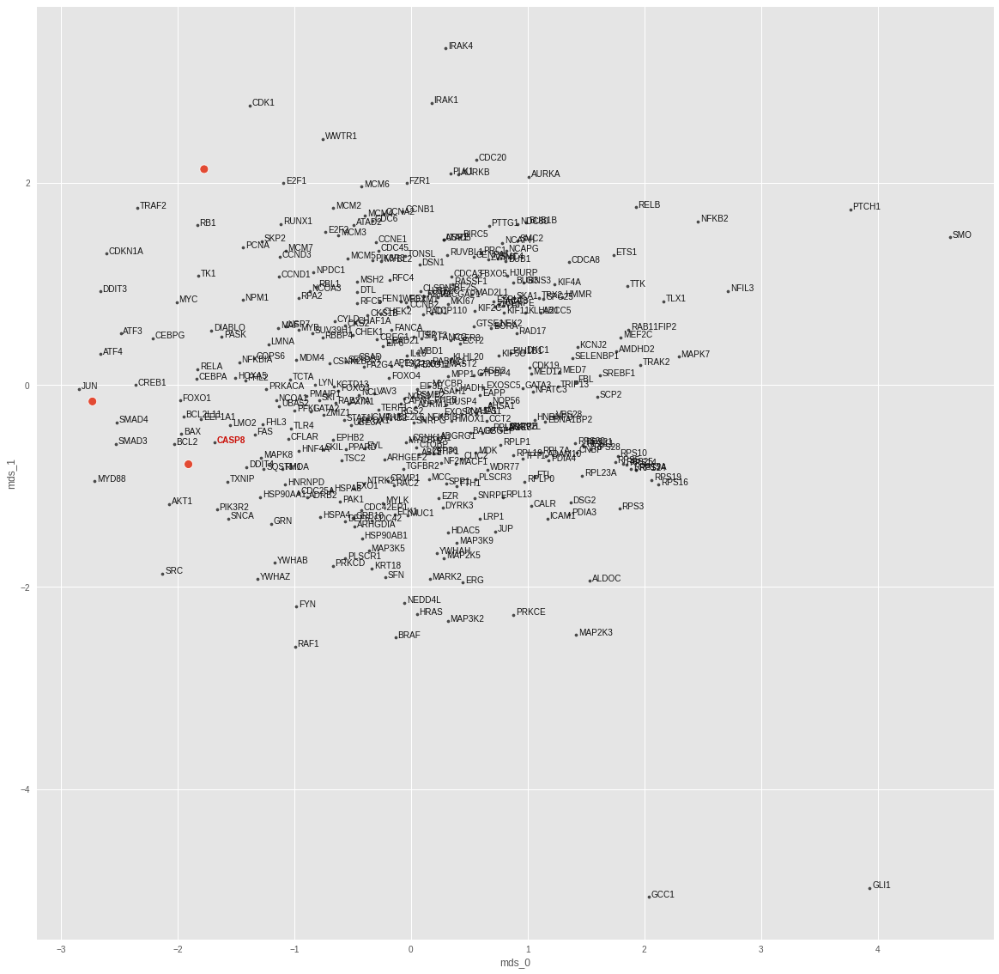

CDC42
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.18709231091916e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0053036827594041824
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.666667, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


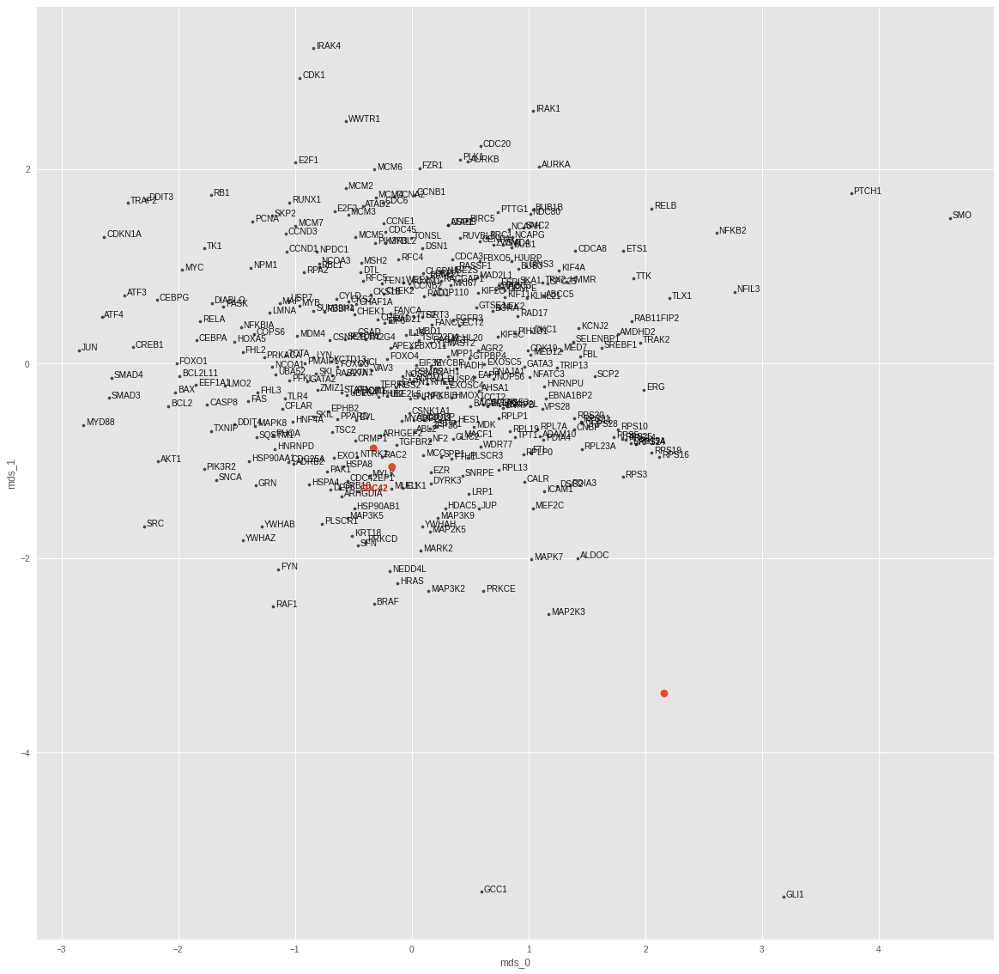

CDKN1A
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.71229778892971e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.01081475056707859
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


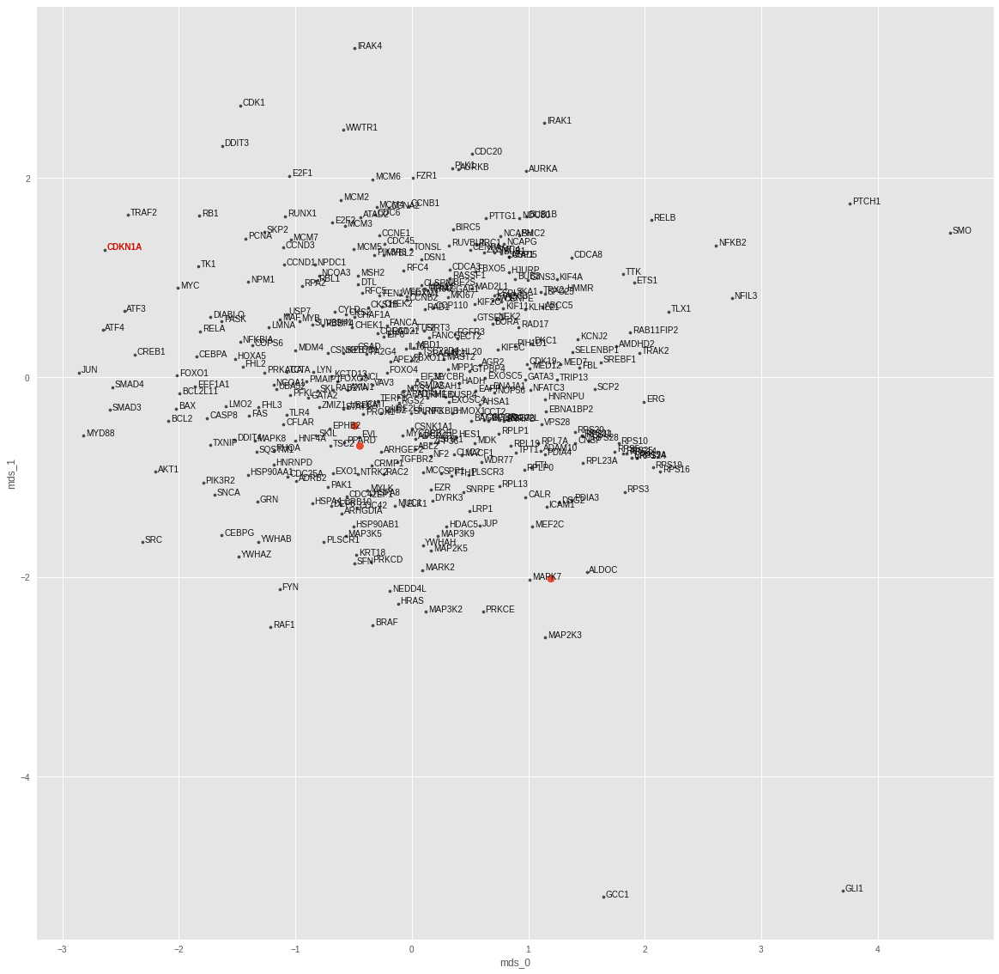

CEBPA
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.124797300527896e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0019734848756343126
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test mean top-k accuracies: {1: 0.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}


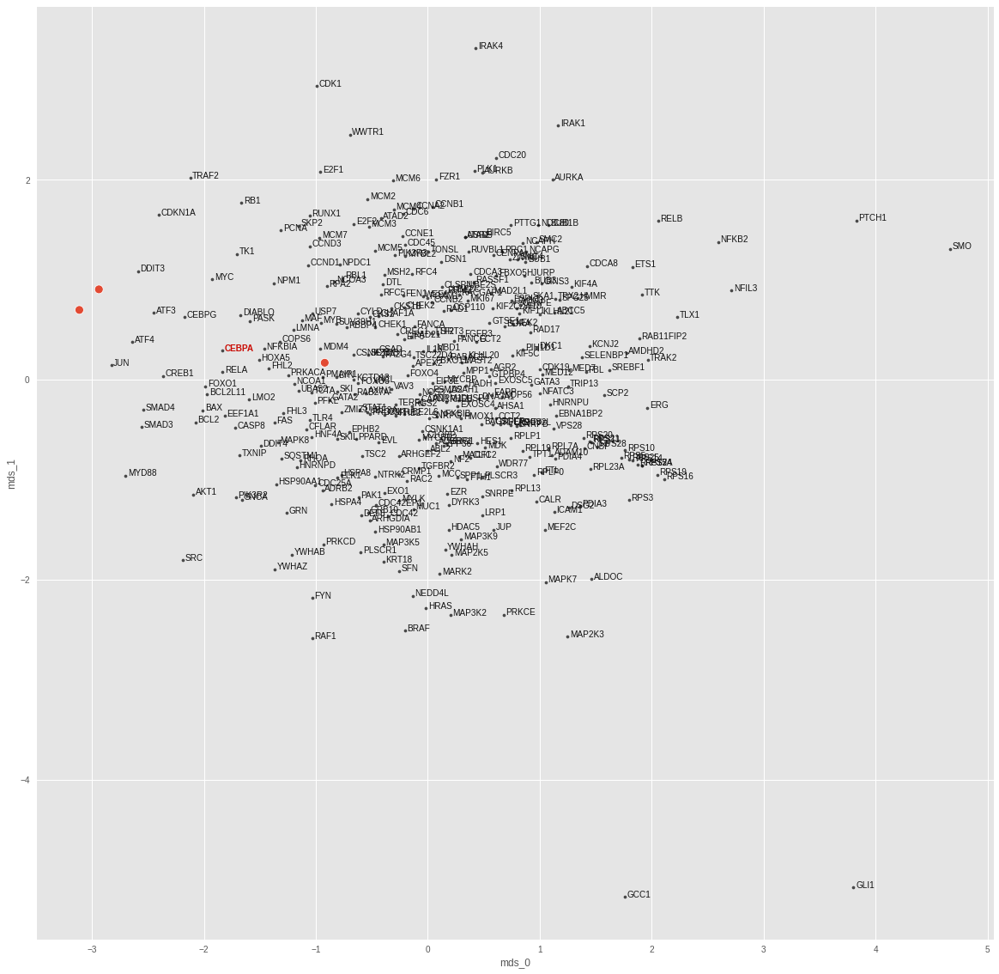

CREB1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 7.277363520925802e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0022026249207556248
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


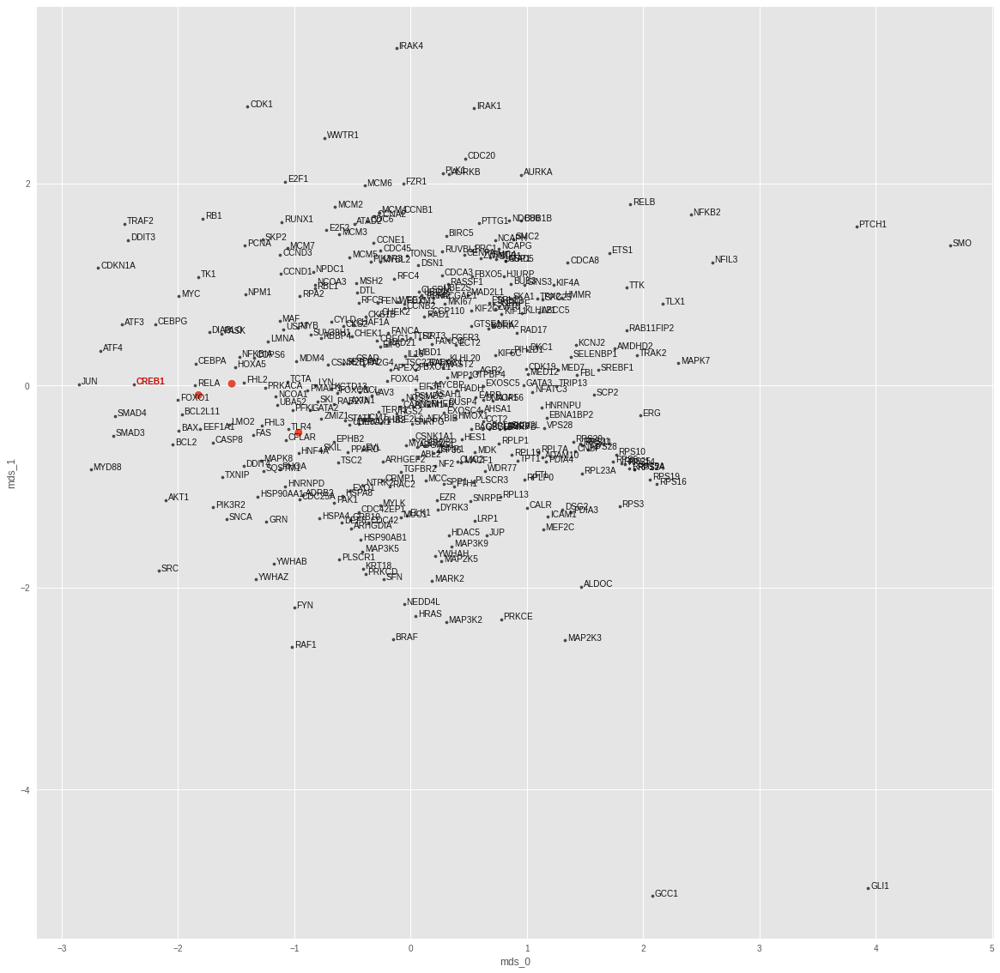

DIABLO
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.2827022449831324e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.058301299810409546
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


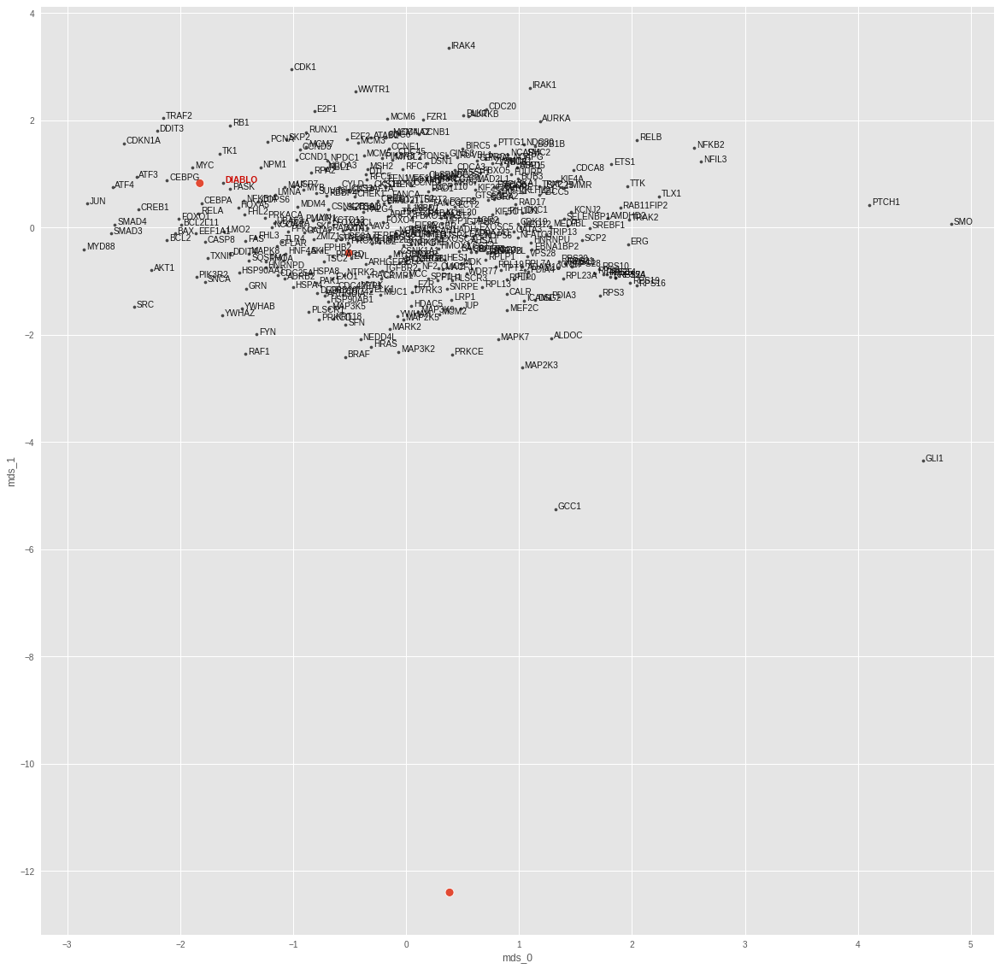

E2F1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.112902279876499e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.012950378470122814
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


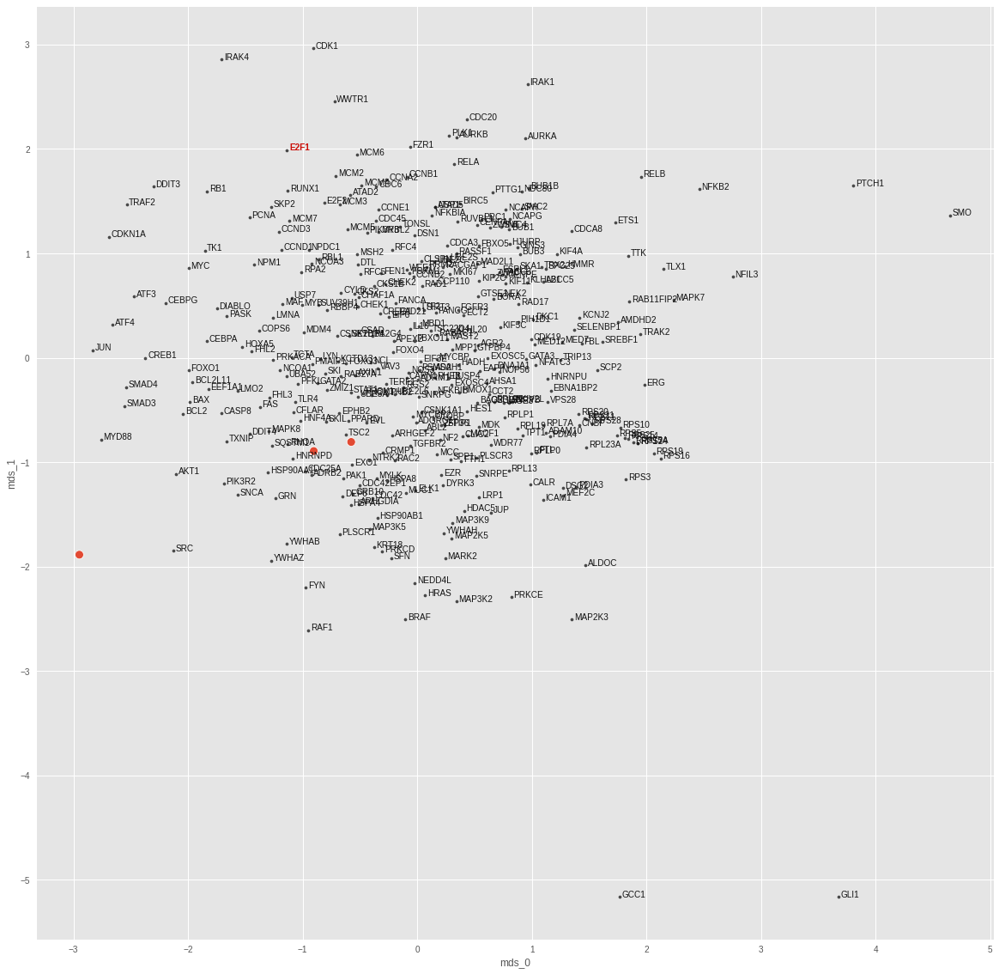

ELK1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.174598614975489e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0050033400766551495
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


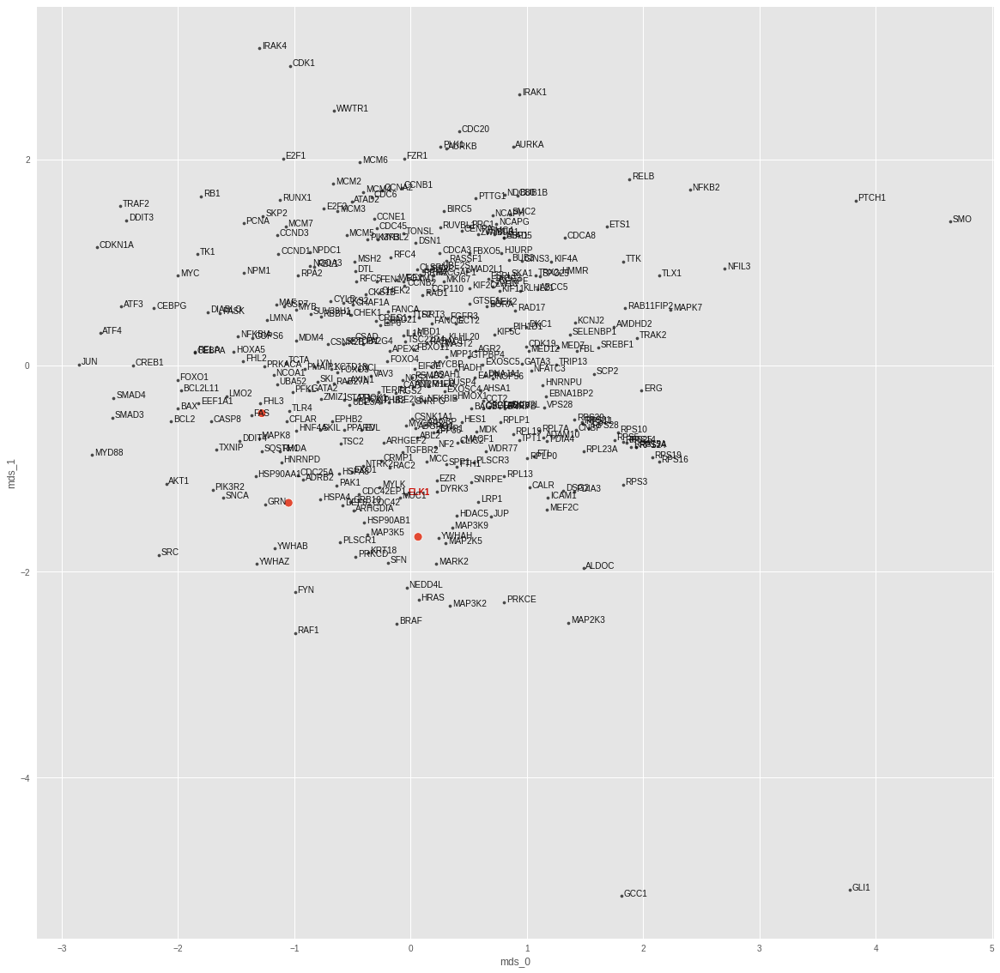

ERG
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0993883267007265e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.006087770219892263
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


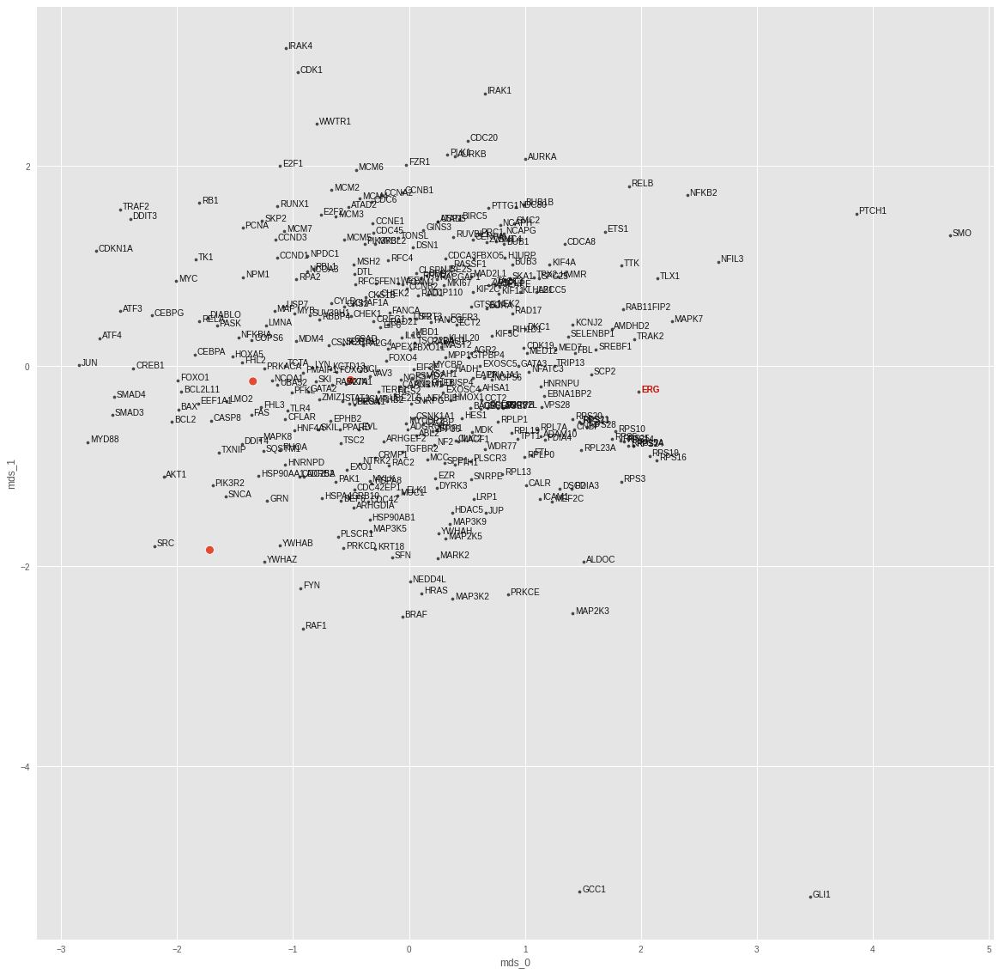

FGFR3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.032671187014785e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.003116513602435589
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


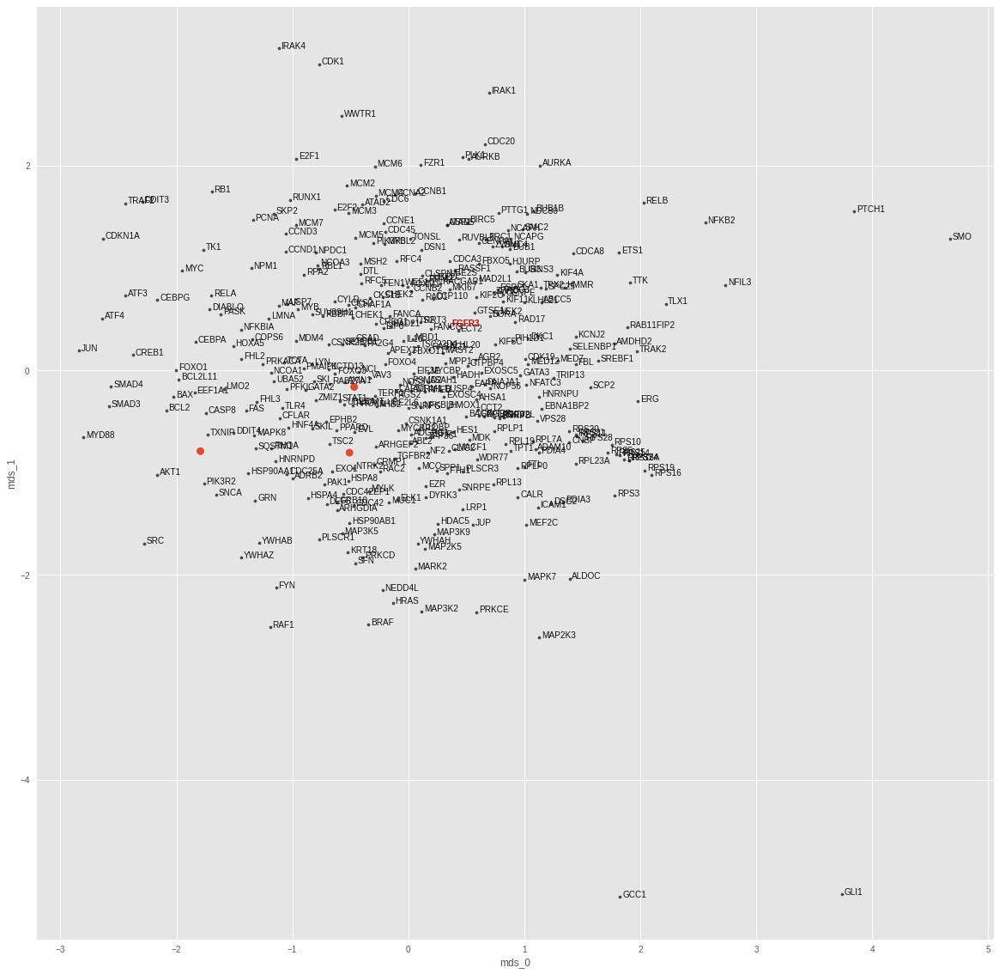

FOXO1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0283775368038363e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.010036495514214039
test top-k accuracies: {1: 0.0, 3: 0.333333, 5: 0.333333, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


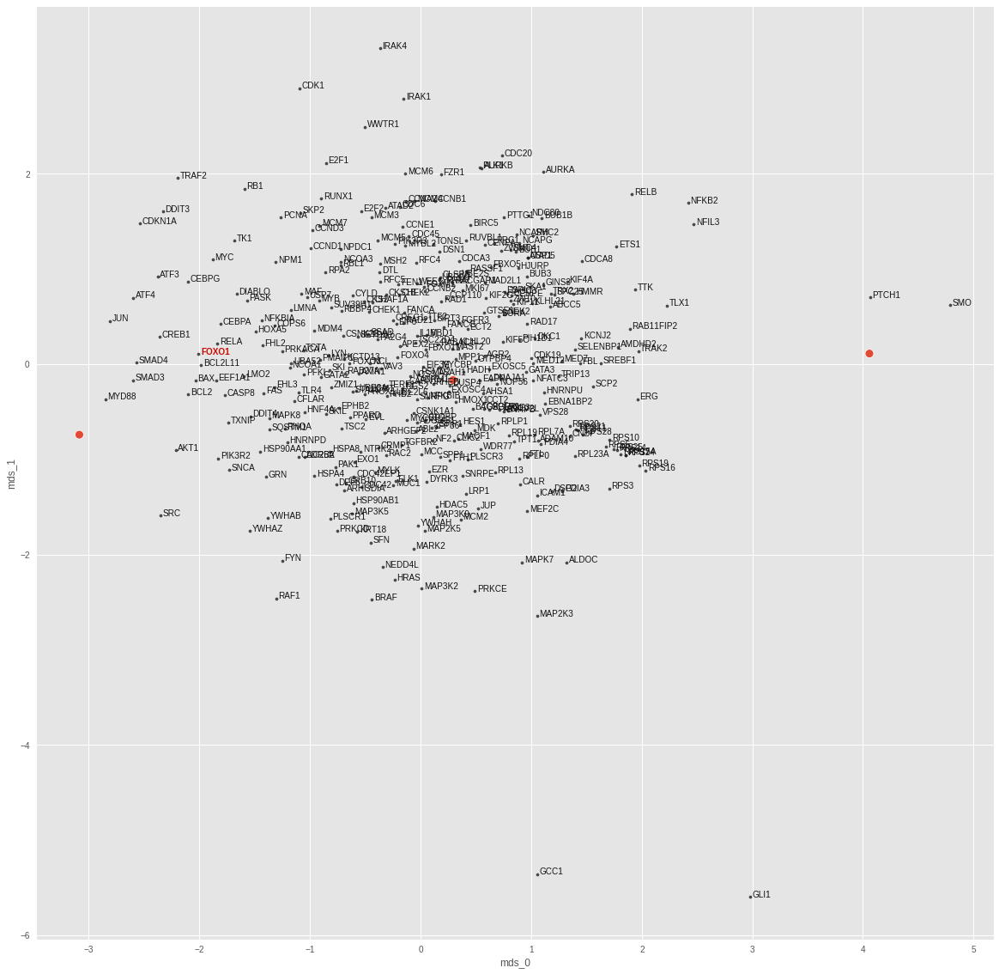

GLI1
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 9.346604668747671e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.04604046791791916
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


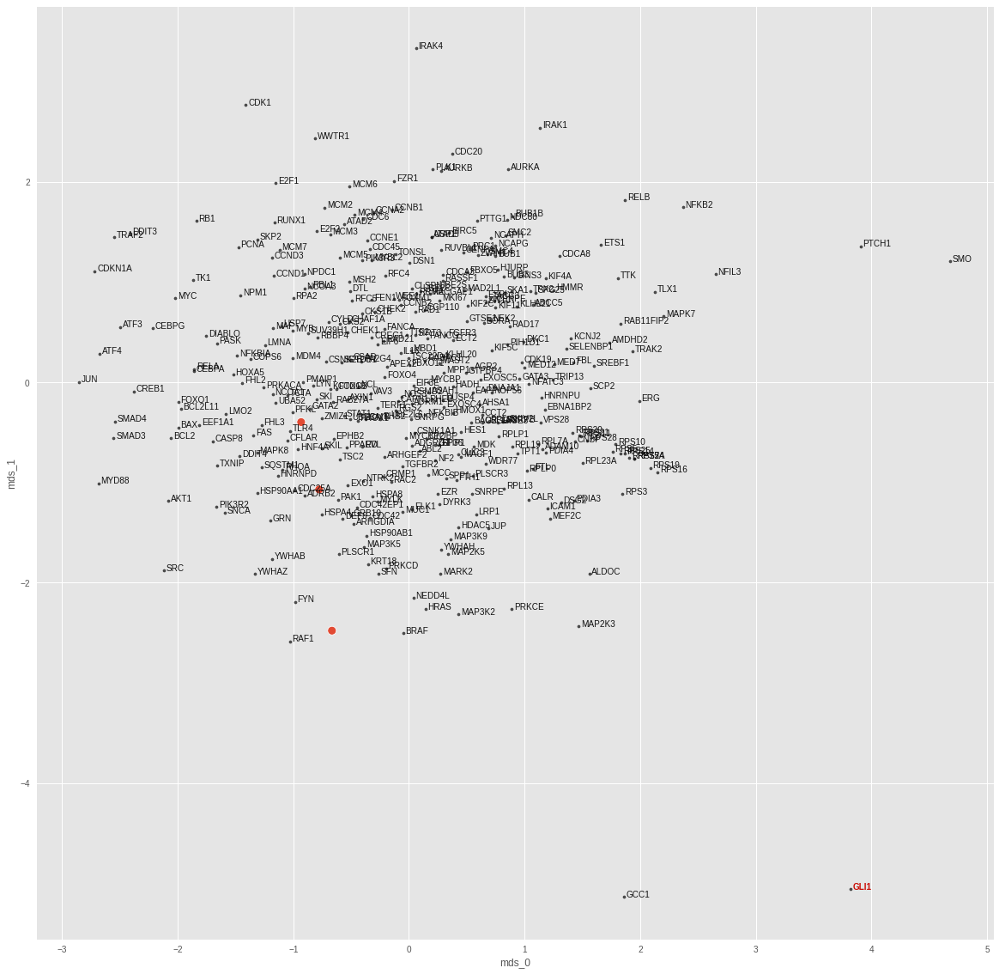

HRAS
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.7766045329128475e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032243027817457914
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


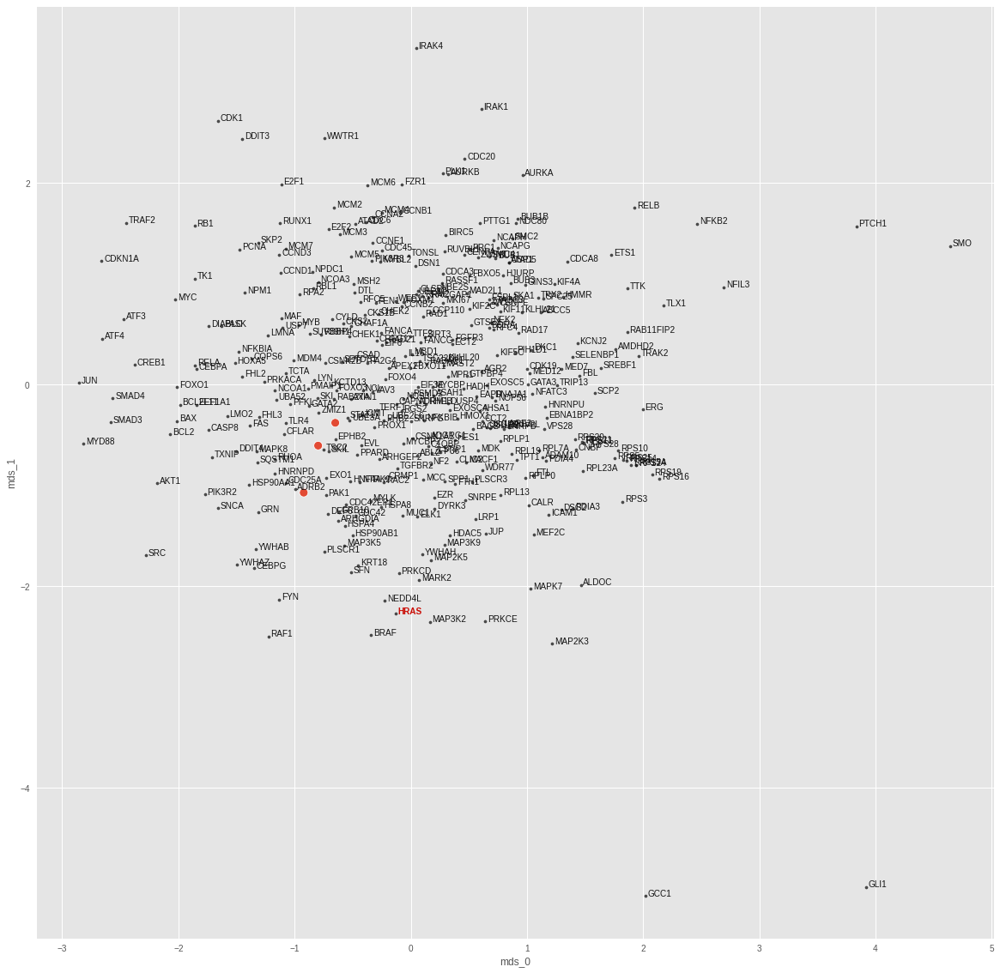

IRAK4
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 8.115285061911243e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.015191543847322464
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


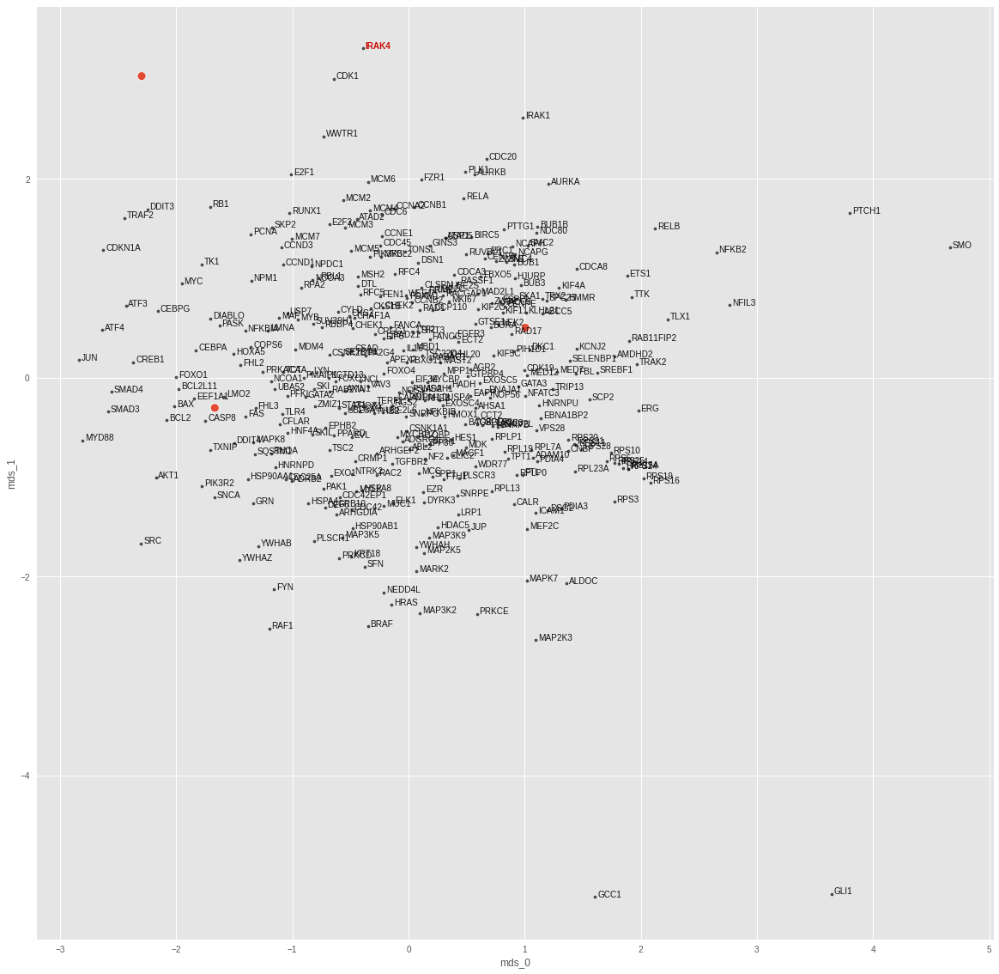

JUN
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.8800346395863443e-05
train top-k accuracies: {1: 0.990991, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007067187689244747
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


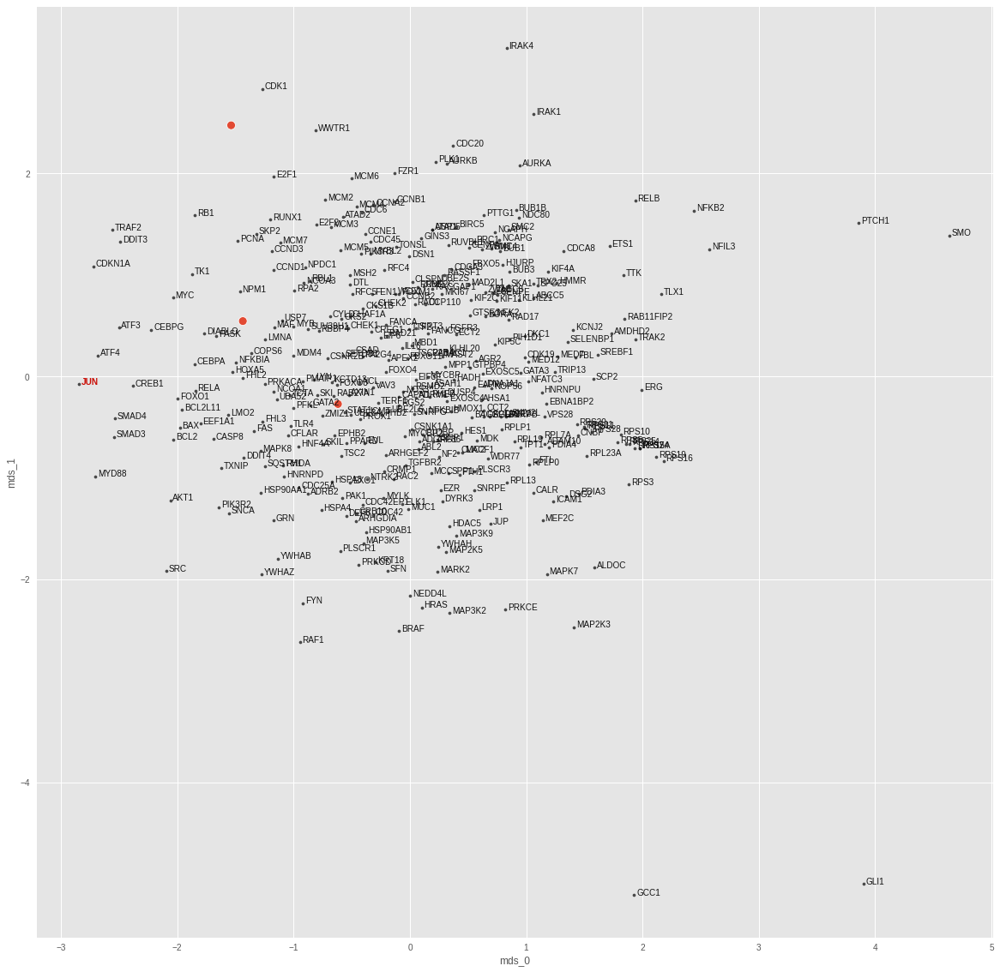

MAP2K3
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.0625717116020062e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.007903519086539745
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


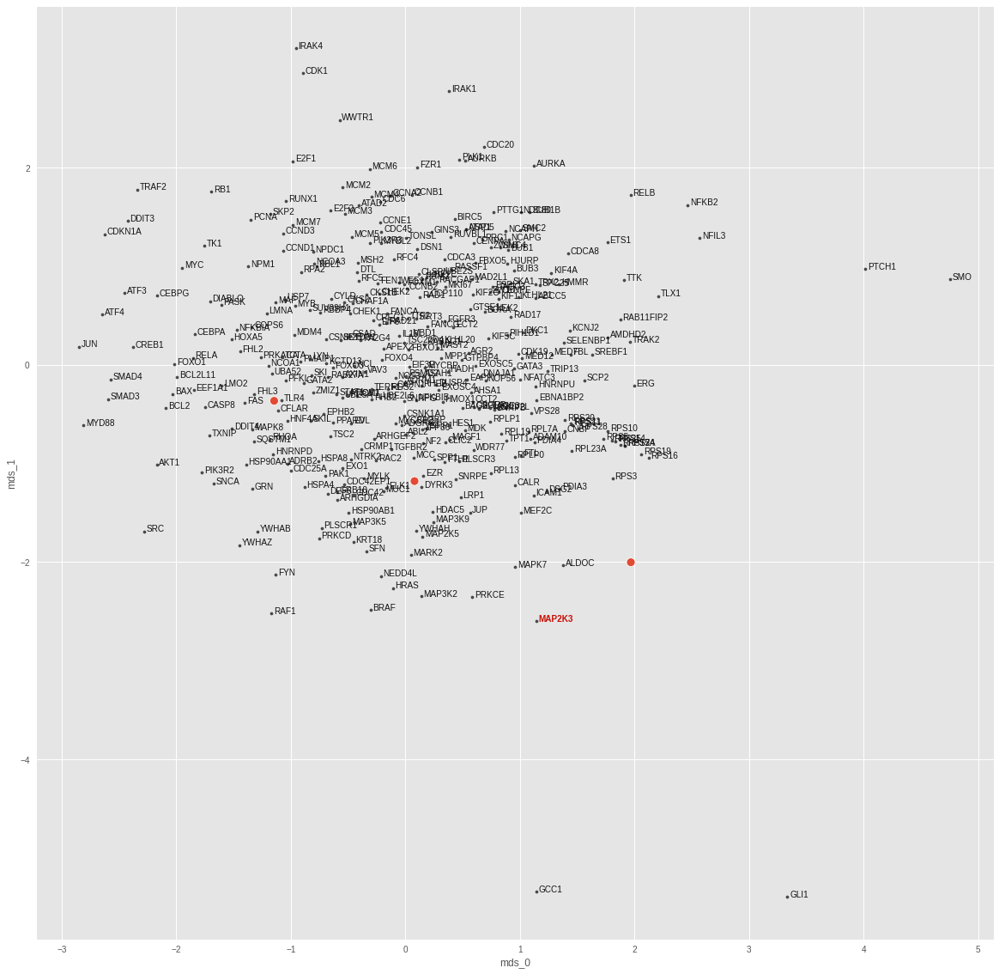

MAP3K2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 3.884795770883667e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032725378405302763
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.333333, 20: 0.333333, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


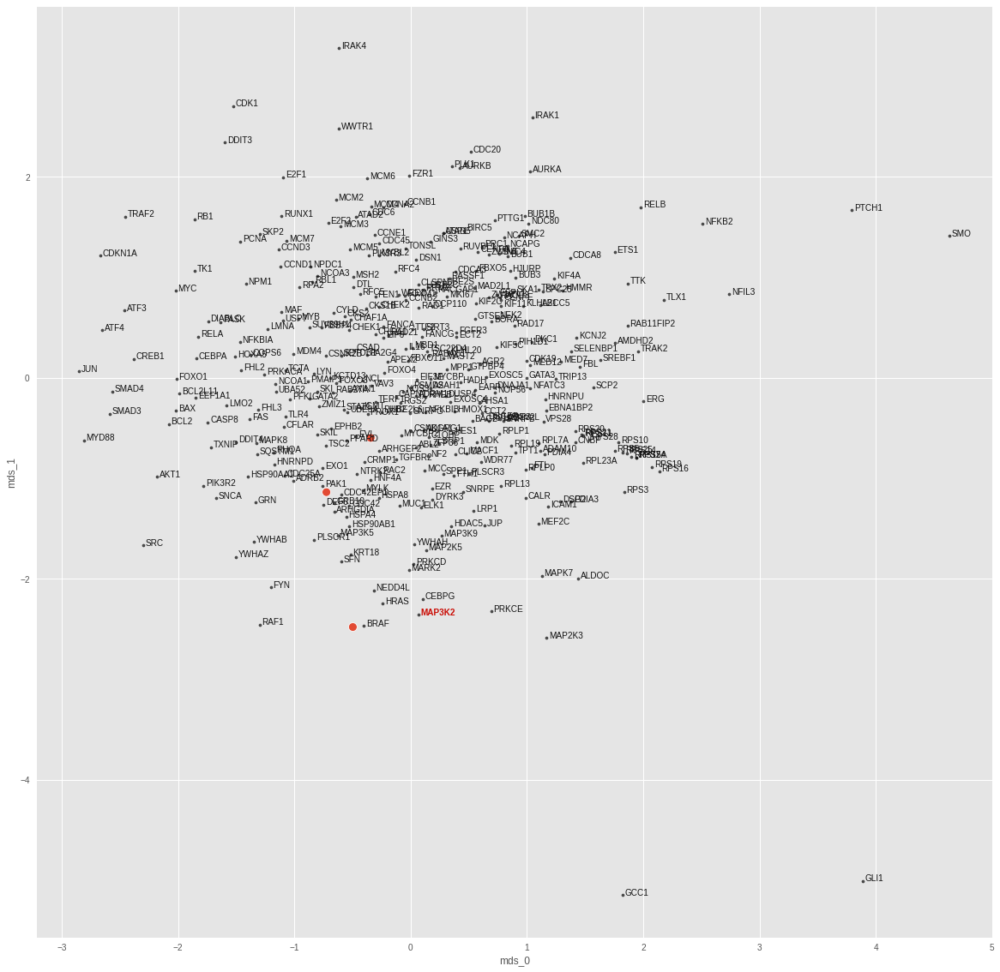

MAP3K5
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 4.152778331502361e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.004188411869108677
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.333333, 50: 0.666667}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 1.0}


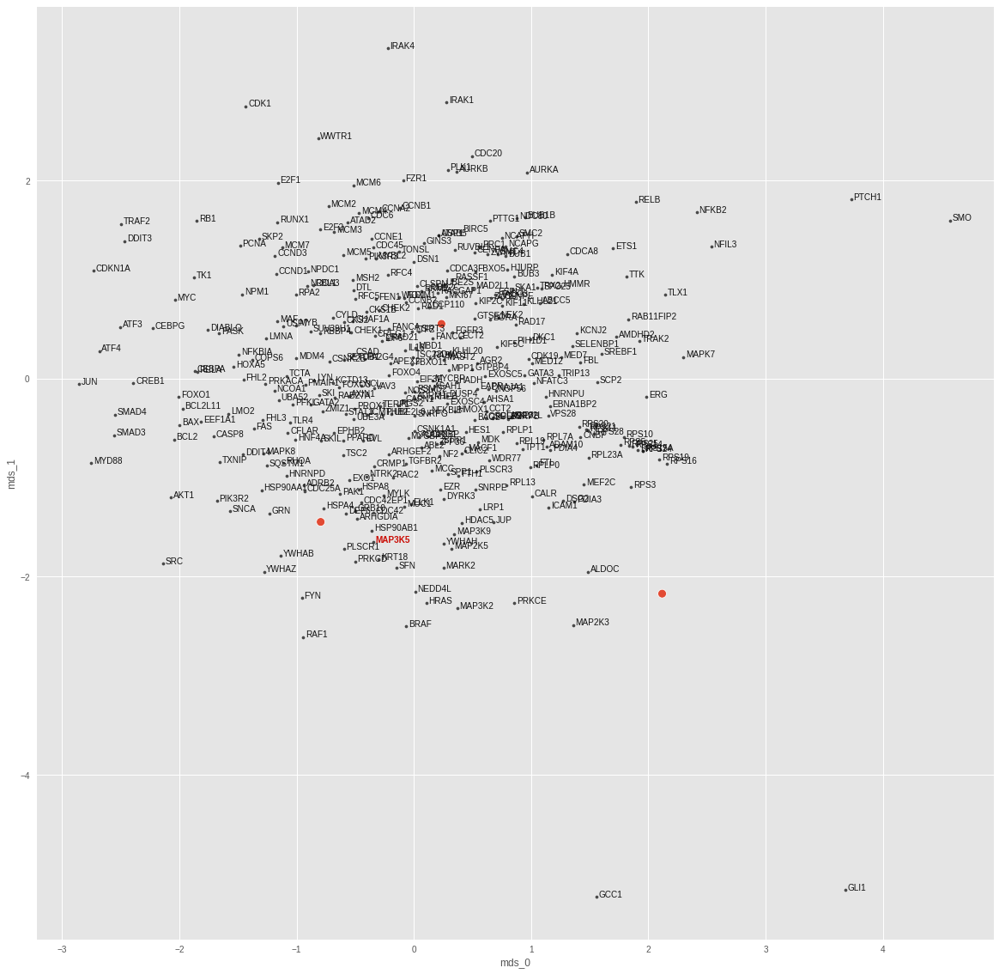

MAP3K9
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 1.3890707950767964e-05
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.0032076488714665174
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.333333}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


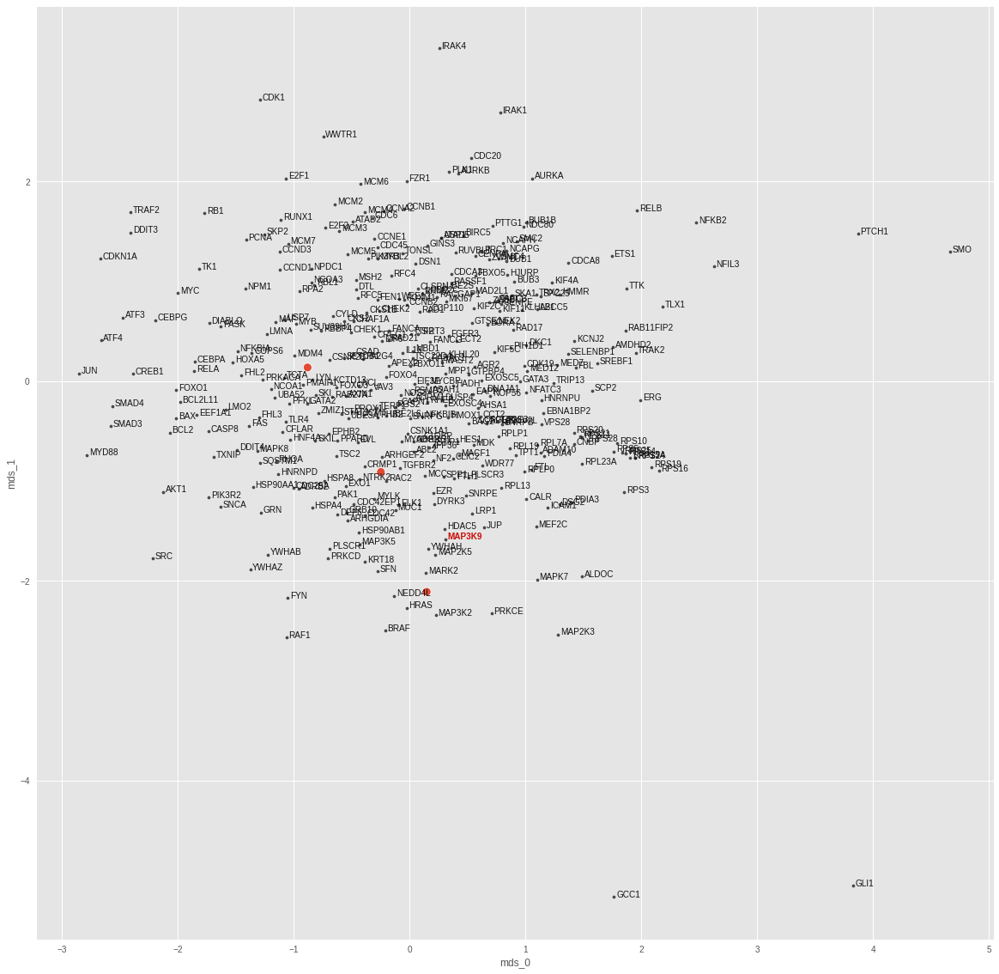

MAPK7
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.421737756075648e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.005597766488790512
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


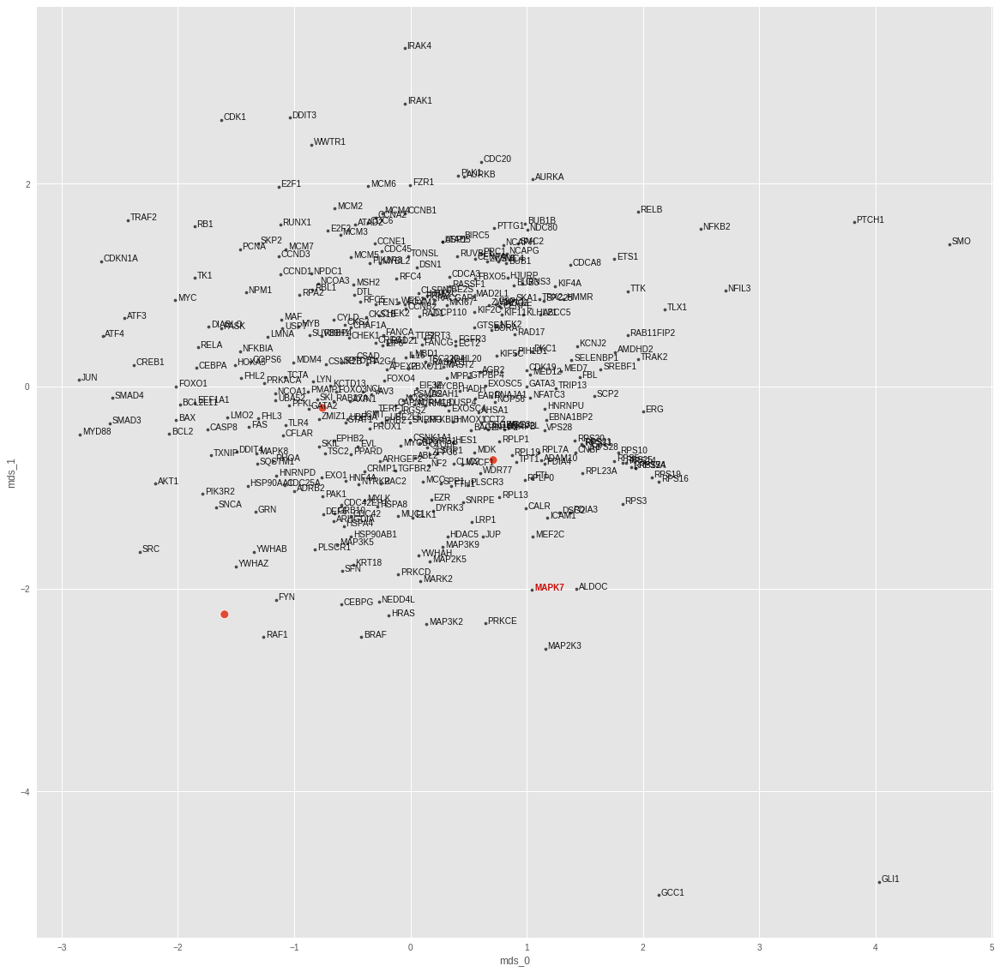

MYD88
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

train loss: 6.88588967547345e-06
train top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
train mean top-k accuracies: {1: 1.0, 3: 1.0, 5: 1.0, 10: 1.0, 20: 1.0, 50: 1.0}
test loss: 0.013800837099552155
test top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}
test mean top-k accuracies: {1: 0.0, 3: 0.0, 5: 0.0, 10: 0.0, 20: 0.0, 50: 0.0}


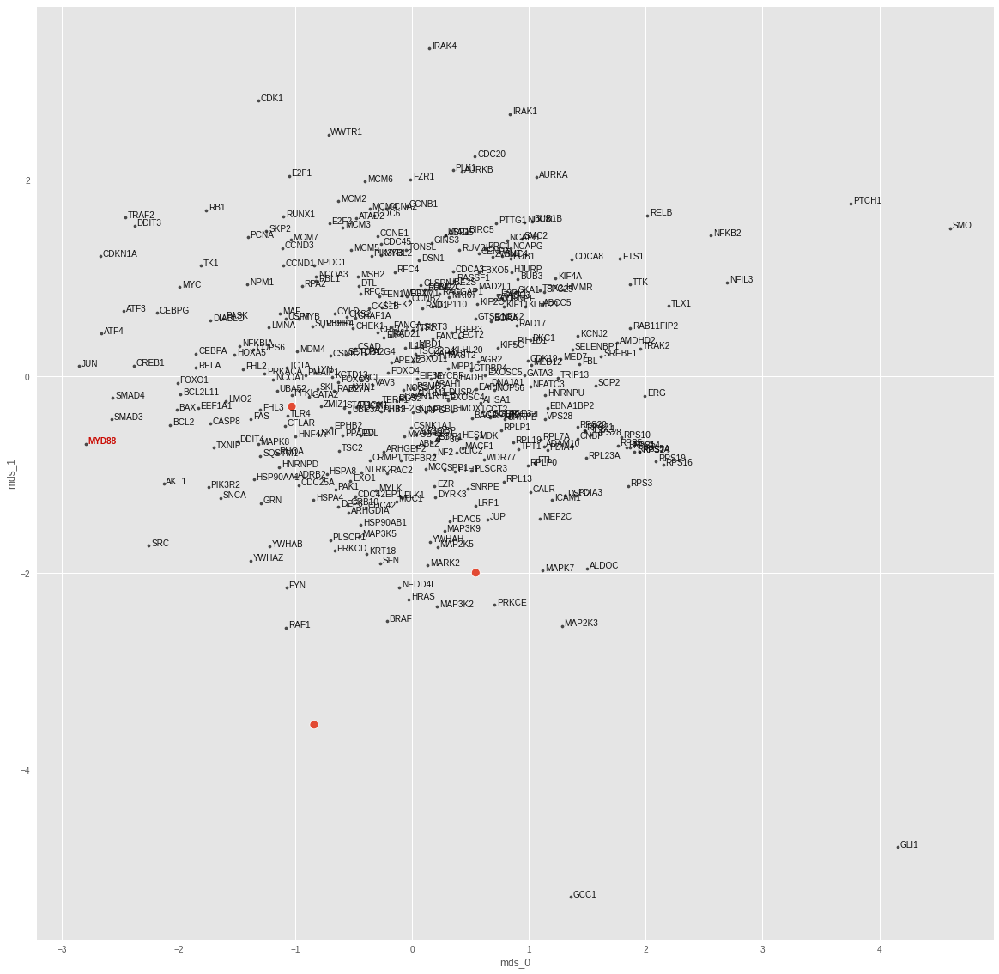

PIK3R2
cuda:0


  0%|          | 0/1000 [00:00<?, ?it/s]

KeyboardInterrupt: 

<IPython.core.display.Javascript object>

In [46]:
target_topk_accs = {}
cl_nonlin_nns_dict = {}
for i in tqdm(range(len(cl_data_dicts))):
    data_dict = cl_data_dicts[i]
    model = torch.nn.Sequential(
        torch.nn.Linear(1024, 1024),
        torch.nn.PReLU(),
        torch.nn.Linear(1024, 1024),
    )
    optimizer = Adam(model.parameters(), lr=1e-3)
    criterion = torch.nn.MSELoss()
    target = sorted(list(shared_targets))[i]
    print(target)
    fitted_model, _, mean_topk_acc, mean_knns = train_model_topk_acc(
        model=model,
        data_dict=data_dict,
        optimizer=optimizer,
        criterion=criterion,
        n_epochs=1000,
        early_stopping=1000,
        nn_clf=nn_clf,
        log_epochs=False,
    )
    target_topk_accs[target] = mean_topk_acc
    cl_nonlin_nns_dict[target] = mean_knns[0]
    fig, ax, _ = plot_translation(
        fitted_model.to("cpu"),
        data_dict["test"].dataset,
        node_embs,
        figsize=[20, 20],
        crop=False,
        highlight_target=target,
        pred_size=100,
        reg_size=10,
    )
    ax.get_legend().remove()
    plt.show()
    plt.close()

In [ ]:
cl_nonlin_topk_df = pd.DataFrame(target_topk_accs).transpose()
cl_nonlin_topk_df.loc[cl_nonlin_topk_df.loc[:, 50] > 0].sort_values(
    [1, 3, 5, 10, 20, 50], ascending=False
)

In [ ]:
cl_nonlin_topk_df.describe()

In [ ]:
cl_nonlin_results = {"topk_acc": [], "k": []}
ks = list(range(50))
cl_nonlin_nn_topk = get_topk_acc_from_nn_dict(cl_nonlin_nns_dict, ks=ks)
cl_nonlin_result = cl_nonlin_nn_topk.mean()
for k in ks:
    cl_nonlin_results["topk_acc"].append(cl_nonlin_result.loc["top-{}".format(k)])
    cl_nonlin_results["k"].append(k)
cl_nonlin_results = pd.DataFrame(cl_nonlin_results)

In [ ]:
fig, ax = plt.subplots(figsize=[9, 6])
ax = sns.lineplot(
    data=random_lin_comb_results.loc[random_lin_comb_results.n == "1"],
    x="k",
    y="topk_acc",
    ax=ax,
    label="random",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "1", "topk_acc"]),
    label="physical_1nn",
    color="blue",
)
ax.plot(
    np.array(lin_comb_results.loc[lin_comb_results.n == "37", "k"]),
    np.array(lin_comb_results.loc[lin_comb_results.n == "37", "topk_acc"]),
    label="physical_all_nn",
    color="green",
)
ax.plot(
    np.array(mean_lin_results.loc[:, "k"]),
    np.array(mean_lin_results.loc[:, "topk_acc"]),
    label="mean_lin",
    color="purple",
)
ax.plot(
    np.array(mean_nonlin_results.loc[:, "k"]),
    np.array(mean_nonlin_results.loc[:, "topk_acc"]),
    label="mean_nonlin",
    color="orange",
)
ax.plot(
    np.array(cl_lin_results.loc[:, "k"]),
    np.array(cl_lin_results.loc[:, "topk_acc"]),
    label="cl_lin",
    color="pink",
)
ax.plot(
    np.array(cl_nonlin_results.loc[:, "k"]),
    np.array(cl_nonlin_results.loc[:, "topk_acc"]),
    label="cl_nonlin",
    color="brown",
)
ax.legend()
ax.set_ylim([0, 0.725])
plt.show()